I worked on this project for a Python elective course during my doctoral studies in economics at PIMES for approximately three months. The project required the inclusion of at least one section on web scraping and data visualization. While many sections of the project were not covered in the course, particularly the libraries I utilized, there were also other course sections that were not included in the project. I selected Covid-19 as the theme for this project, and the data was scraped from the web on April 5th 2023 (the data on covid19project_andreluizcoelho.ipynb on the same repository was scraped on July 30th, 2021). Any data analyzed can be downloaded using the links provided throughout the project.

# Covid-19 

## 1. Webscraping Covid-19 Total and Death Cases

In [1]:
#importing libraries

In [2]:
from bs4 import BeautifulSoup
import requests
import pandas as pd

In [3]:
#defining the url

In [4]:
url = 'https://www.worldometers.info/coronavirus/'

In [5]:
url

'https://www.worldometers.info/coronavirus/'

In [6]:
#get request to get the raw html content

In [7]:
html_content = requests.get(url).text

'\n<!DOCTYPE html>\n<!--[if IE 8]> <html lang="en" class="ie8"> <![endif]-->\n<!--[if IE 9]> <html lang="en" class="ie9"> <![endif]-->\n<!--[if !IE]><!-->\n<html lang="en">\n<!--<![endif]-->\n\n\n\n<head>\n    <meta charset="utf-8">\n    <meta http-equiv="X-UA-Compatible" content="IE=edge">\n    <meta name="viewport" content="width=device-width, initial-scale=1">\n\n    <title>COVID - Coronavirus Statistics - Worldometer</title>\n    <meta name="description" content="Daily and weekly updated statistics tracking the number of COVID-19 cases, recovered, and deaths. Historical data with cumulative charts, graphs, and updates.">\n\n\n    \n\t<!-- Favicon -->\n\t<link rel="shortcut icon" href="/favicon/favicon.ico" type="image/x-icon">\n\t<link rel="apple-touch-icon" sizes="57x57" href="/favicon/apple-icon-57x57.png">\n\t<link rel="apple-touch-icon" sizes="60x60" href="/favicon/apple-icon-60x60.png">\n\t<link rel="apple-touch-icon" sizes="72x72" href="/favicon/apple-icon-72x72.png">\n\t<lin
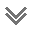

In [8]:
html_content

In [9]:
#parsing the html code for the entire site

In [10]:
soup = BeautifulSoup(html_content, 'lxml')

In [11]:
#print the parsed data of html

<!DOCTYPE html>
<!--[if IE 8]> <html lang="en" class="ie8"> <![endif]-->
<!--[if IE 9]> <html lang="en" class="ie9"> <![endif]-->
<!--[if !IE]><!-->
<html lang="en">
 <!--<![endif]-->
 <head>
  <meta charset="utf-8"/>
  <meta content="IE=edge" http-equiv="X-UA-Compatible"/>
  <meta content="width=device-width, initial-scale=1" name="viewport"/>
  <title>
   COVID - Coronavirus Statistics - Worldometer
  </title>
  <meta content="Daily and weekly updated statistics tracking the number of COVID-19 cases, recovered, and deaths. Historical data with cumulative charts, graphs, and updates." name="description"/>
  <!-- Favicon -->
  <link href="/favicon/favicon.ico" rel="shortcut icon" type="image/x-icon"/>
  <link href="/favicon/apple-icon-57x57.png" rel="apple-touch-icon" sizes="57x57"/>
  <link href="/favicon/apple-icon-60x60.png" rel="apple-touch-icon" sizes="60x60"/>
  <link href="/favicon/apple-icon-72x72.png" rel="apple-touch-icon" sizes="72x72"/>
  <link href="/favicon/apple-icon-76x
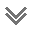

In [12]:
print(soup.prettify())

In [13]:
#picking the id of the table to scrape and extract html for only the specific table

In [14]:
covid_table = soup.find('table', attrs = {'id': 'main_table_countries_today'})

In [15]:
#head will form the columns

In [16]:
head = covid_table.thead.find_all('tr') 
#the <table> tag defines an HTML table 
#each table row is defined with a <tr> tag
#A <tr> element contains one or more <th> or <td> elements
#each table data/cell is defined with a <td> tag
#The <th> tag defines a header cell in an HTML table

In [17]:
head #headers are inside this html code

[<tr>
 <th width="1%">#</th>
 <th width="100">Country,<br/>Other</th>
 <th width="20">Total<br/>Cases</th>
 <th width="30">New<br/>Cases</th>
 <th width="30">Total<br/>Deaths</th>
 <th width="30">New<br/>Deaths</th>
 <th width="30">Total<br/>Recovered</th>
 <th width="30">New<br/>Recovered</th>
 <th width="30">Active<br/>Cases</th>
 <th width="30">Serious,<br/>Critical</th>
 <th width="30">Tot Cases/<br/>1M pop</th>
 <th width="30">Deaths/<br/>1M pop</th>
 <th width="30">Total<br/>Tests</th>
 <th width="30">Tests/<br/>
 <nobr>1M pop</nobr>
 </th>
 <th width="30">Population</th>
 <th style="display:none" width="30">Continent</th>
 <th width="30">1 Case<br/>every X ppl</th><th width="30">1 Death<br/>every X ppl</th><th width="30">1 Test<br/>every X ppl</th>
 <th width="30">New Cases/1M pop</th>
 <th width="30">New Deaths/1M pop</th>
 <th width="30">Active Cases/1M pop</th>
 </tr>]

In [18]:
#extracting headers from html to a list

In [19]:
headings = []
for th in head[0].find_all('th'):
    #removing newlines and extra spaces from left and right
    print(th.text)
    headings.append(th.text.replace('\n','').strip())
print(headings)

#
Country,Other
TotalCases
NewCases
TotalDeaths
NewDeaths
TotalRecovered
NewRecovered
ActiveCases
Serious,Critical
Tot Cases/1M pop
Deaths/1M pop
TotalTests
Tests/
1M pop

Population
Continent
1 Caseevery X ppl
1 Deathevery X ppl
1 Testevery X ppl
New Cases/1M pop
New Deaths/1M pop
Active Cases/1M pop
['#', 'Country,Other', 'TotalCases', 'NewCases', 'TotalDeaths', 'NewDeaths', 'TotalRecovered', 'NewRecovered', 'ActiveCases', 'Serious,Critical', 'Tot\xa0Cases/1M pop', 'Deaths/1M pop', 'TotalTests', 'Tests/1M pop', 'Population', 'Continent', '1 Caseevery X ppl', '1 Deathevery X ppl', '1 Testevery X ppl', 'New Cases/1M pop', 'New Deaths/1M pop', 'Active Cases/1M pop']


In [20]:
#extracting the rest of rows with tbody element

In [21]:
body = covid_table.tbody.find_all('tr')

In [22]:
body

[<tr class="total_row_world row_continent" data-continent="North America" style="display: none">
 <td></td>
 <td style="text-align:left;">
 <nobr>North America</nobr>
 </td>
 <td>125,757,735</td>
 <td>+2,930</td>
 <td>1,623,020</td>
 <td>+13</td>
 <td>121,356,872</td>
 <td>+2,821</td>
 <td>2,777,843</td>
 <td>7,061</td>
 <td></td>
 <td></td>
 <td></td>
 <td></td>
 <td></td>
 <td data-continent="North America" style="display:none;">North America</td>
 <!-- 1 Case every X -->
 <td>
 </td>
 <!-- 1 Death every X -->
 <td></td>
 <!-- 1 test every X -->
 <td></td>
 <td></td>
 <td></td>
 <td></td>
 </tr>,
 <tr class="total_row_world row_continent" data-continent="Asia" style="display: none">
 <td></td>
 <td style="text-align:left;">
 <nobr>Asia</nobr>
 </td>
 <td>215,366,500</td>
 <td>+26,242</td>
 <td>1,540,992</td>
 <td>+45</td>
 <td>199,939,630</td>
 <td>+21,591</td>
 <td>13,885,878</td>
 <td>15,557</td>
 <td></td>
 <td></td>
 <td></td>
 <td></td>
 <td></td>
 <td data-continent="Asia" styl

In [23]:
body[0] #the first row for example

<tr class="total_row_world row_continent" data-continent="North America" style="display: none">
<td></td>
<td style="text-align:left;">
<nobr>North America</nobr>
</td>
<td>125,757,735</td>
<td>+2,930</td>
<td>1,623,020</td>
<td>+13</td>
<td>121,356,872</td>
<td>+2,821</td>
<td>2,777,843</td>
<td>7,061</td>
<td></td>
<td></td>
<td></td>
<td></td>
<td></td>
<td data-continent="North America" style="display:none;">North America</td>
<!-- 1 Case every X -->
<td>
</td>
<!-- 1 Death every X -->
<td></td>
<!-- 1 test every X -->
<td></td>
<td></td>
<td></td>
<td></td>
</tr>

In [24]:
#appending the values of rows into a list, since there are lists inside a list here
#declaring empty list data that'll hold all rows data

In [25]:
data = []
for r in range(1, len(body)):
    row = [] #empty list to hold one row data
    for tr in body[r].find_all('td'):
        row.append(tr.text.replace('\n','').strip())
        #appending row data to row after removing newlines escape and triming unnecessary spaces
    data.append(row)

In [26]:
data

[['',
  'Asia',
  '215,366,500',
  '+26,242',
  '1,540,992',
  '+45',
  '199,939,630',
  '+21,591',
  '13,885,878',
  '15,557',
  '',
  '',
  '',
  '',
  '',
  'Asia',
  '',
  '',
  '',
  '',
  '',
  ''],
 ['',
  'Europe',
  '247,975,158',
  '+23,327',
  '2,031,654',
  '+125',
  '243,656,835',
  '+56,925',
  '2,286,669',
  '6,421',
  '',
  '',
  '',
  '',
  '',
  'Europe',
  '',
  '',
  '',
  '',
  '',
  ''],
 ['',
  'South America',
  '68,397,845',
  '+1,535',
  '1,352,933',
  '+1',
  '66,414,624',
  '+3,113',
  '630,288',
  '10,183',
  '',
  '',
  '',
  '',
  '',
  'South America',
  '',
  '',
  '',
  '',
  '',
  ''],
 ['',
  'Oceania',
  '14,018,297',
  '',
  '26,715',
  '',
  '13,838,930',
  '',
  '152,652',
  '61',
  '',
  '',
  '',
  '',
  '',
  'Australia/Oceania',
  '',
  '',
  '',
  '',
  '',
  ''],
 ['',
  'Africa',
  '12,812,815',
  '+285',
  '258,665',
  '',
  '12,080,928',
  '+7',
  '473,222',
  '548',
  '',
  '',
  '',
  '',
  '',
  'Africa',
  '',
  '',
  '',
  '',
  '',

In [27]:
row

['231',
 'China',
 '503,302',
 '',
 '5,272',
 '',
 '379,053',
 '',
 '118,977',
 'N/A',
 '347',
 '4',
 '160,000,000',
 '110,461',
 '1,448,471,400',
 'Asia',
 '2,878',
 '274,748',
 '9',
 '',
 '',
 '82']

In [28]:
#data contains all the rows excluding header
#row contains data for one row

In [29]:
#passing the values on the body as the data and headings as the columns 
#to a DataFrame

In [30]:
#with headings as the columns

In [31]:
df = pd.DataFrame(data, columns = headings)

In [32]:
df

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",...,TotalTests,Tests/1M pop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,,Asia,"215,366,500","+26,242","1,540,992",+45,"199,939,630","+21,591","13,885,878","15,557",...,,,,Asia,,,,,,
1,,Europe,"247,975,158","+23,327","2,031,654",+125,"243,656,835","+56,925","2,286,669","6,421",...,,,,Europe,,,,,,
2,,South America,"68,397,845","+1,535","1,352,933",+1,"66,414,624","+3,113","630,288","10,183",...,,,,South America,,,,,,
3,,Oceania,"14,018,297",,"26,715",,"13,838,930",,"152,652",61,...,,,,Australia/Oceania,,,,,,
4,,Africa,"12,812,815",+285,"258,665",,"12,080,928",+7,"473,222",548,...,,,,Africa,,,,,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
233,227,Vatican City,29,,,,29,,0,,...,,,799,Europe,28,,,,,
234,228,Western Sahara,10,,1,,9,,0,,...,,,"626,161",Africa,"62,616","626,161",,,,
235,229,MS Zaandam,9,,2,,7,,0,,...,,,,,,,,,,
236,230,Tokelau,5,,,,,,5,,...,,,"1,378",Australia/Oceania,276,,,,,"3,628"


In [33]:
df.shape

(238, 22)

In [34]:
df.head()

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",...,TotalTests,Tests/1M pop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,,Asia,"215,366,500","+26,242","1,540,992",+45,"199,939,630","+21,591","13,885,878","15,557",...,,,,Asia,,,,,,
1,,Europe,"247,975,158","+23,327","2,031,654",+125,"243,656,835","+56,925","2,286,669","6,421",...,,,,Europe,,,,,,
2,,South America,"68,397,845","+1,535","1,352,933",+1,"66,414,624","+3,113","630,288","10,183",...,,,,South America,,,,,,
3,,Oceania,"14,018,297",,"26,715",,"13,838,930",,"152,652",61,...,,,,Australia/Oceania,,,,,,
4,,Africa,"12,812,815",+285,"258,665",,"12,080,928",+7,"473,222",548,...,,,,Africa,,,,,,


In [35]:
df.head(10)

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",...,TotalTests,Tests/1M pop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,,Asia,"215,366,500","+26,242","1,540,992",+45,"199,939,630","+21,591","13,885,878","15,557",...,,,,Asia,,,,,,
1,,Europe,"247,975,158","+23,327","2,031,654",+125,"243,656,835","+56,925","2,286,669","6,421",...,,,,Europe,,,,,,
2,,South America,"68,397,845","+1,535","1,352,933",+1,"66,414,624","+3,113","630,288","10,183",...,,,,South America,,,,,,
3,,Oceania,"14,018,297",,"26,715",,"13,838,930",,"152,652",61,...,,,,Australia/Oceania,,,,,,
4,,Africa,"12,812,815",+285,"258,665",,"12,080,928",+7,"473,222",548,...,,,,Africa,,,,,,
5,,,721,,15,,706,,0,0,...,,,,,,,,,,
6,,World,"684,329,071","+54,319","6,833,994",+184,"657,288,525","+84,457","20,206,552","39,831",...,,,,All,,,,,,
7,1,USA,"106,273,691",,"1,155,668",,"104,055,782",,"1,062,241","1,895",...,"1,174,878,661","3,509,140","334,805,269",North America,3,290,0,,,"3,173"
8,2,India,"44,733,719",,"530,916",,"44,179,712",,"23,091",N/A,...,"922,033,777","655,491","1,406,631,776",Asia,31,"2,649",2,,,16
9,3,France,"39,817,657","+9,922","165,794",+58,"39,517,646","+16,280","134,217",869,...,"271,490,188","4,139,547","65,584,518",Europe,2,396,0,151,0.9,"2,046"


In [36]:
df.tail()

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",...,TotalTests,Tests/1M pop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
233,227,Vatican City,29,,,,29,,0,,...,,,799,Europe,28,,,,,
234,228,Western Sahara,10,,1,,9,,0,,...,,,"626,161",Africa,"62,616","626,161",,,,
235,229,MS Zaandam,9,,2,,7,,0,,...,,,,,,,,,,
236,230,Tokelau,5,,,,,,5,,...,,,"1,378",Australia/Oceania,276,,,,,"3,628"
237,231,China,"503,302",,"5,272",,"379,053",,"118,977",N/A,...,"160,000,000","110,461","1,448,471,400",Asia,"2,878","274,748",9,,,82


In [37]:
#to end up with the data only from today, it's needed to remove duplicates, because the data is kept up to three days on the website

In [38]:
data=df[df['#']!=''].reset_index(drop=True)

In [39]:
#the data points with # value are the contries while data points with null values for # columns are features like continents, totals, etc

In [40]:
data

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",...,TotalTests,Tests/1M pop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,1,USA,"106,273,691",,"1,155,668",,"104,055,782",,"1,062,241","1,895",...,"1,174,878,661","3,509,140","334,805,269",North America,3,290,0,,,"3,173"
1,2,India,"44,733,719",,"530,916",,"44,179,712",,"23,091",N/A,...,"922,033,777","655,491","1,406,631,776",Asia,31,"2,649",2,,,16
2,3,France,"39,817,657","+9,922","165,794",+58,"39,517,646","+16,280","134,217",869,...,"271,490,188","4,139,547","65,584,518",Europe,2,396,0,151,0.9,"2,046"
3,4,Germany,"38,363,343",,"171,169",,"38,104,500","+6,900","87,674",N/A,...,"122,332,384","1,458,359","83,883,596",Europe,2,490,1,,,"1,045"
4,5,Brazil,"37,319,254",,"700,556",,"36,249,161",,"369,537",N/A,...,"63,776,166","296,146","215,353,593",South America,6,307,3,,,"1,716"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
226,227,Vatican City,29,,,,29,,0,,...,,,799,Europe,28,,,,,
227,228,Western Sahara,10,,1,,9,,0,,...,,,"626,161",Africa,"62,616","626,161",,,,
228,229,MS Zaandam,9,,2,,7,,0,,...,,,,,,,,,,
229,230,Tokelau,5,,,,,,5,,...,,,"1,378",Australia/Oceania,276,,,,,"3,628"


In [41]:
data = data.drop_duplicates(subset = ['Country,Other'])

In [42]:
#because the worldmeter reports data for up to three days, counting today to two days back, there's a need to drop duplicates
#when duplicates are removed, the values for the last two days are removed, while today´s values are kept

In [43]:
data.head()

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",...,TotalTests,Tests/1M pop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,1,USA,"106,273,691",,"1,155,668",,"104,055,782",,"1,062,241","1,895",...,"1,174,878,661","3,509,140","334,805,269",North America,3,290,0,,,"3,173"
1,2,India,"44,733,719",,"530,916",,"44,179,712",,"23,091",N/A,...,"922,033,777","655,491","1,406,631,776",Asia,31,"2,649",2,,,16
2,3,France,"39,817,657","+9,922","165,794",+58,"39,517,646","+16,280","134,217",869,...,"271,490,188","4,139,547","65,584,518",Europe,2,396,0,151,0.9,"2,046"
3,4,Germany,"38,363,343",,"171,169",,"38,104,500","+6,900","87,674",N/A,...,"122,332,384","1,458,359","83,883,596",Europe,2,490,1,,,"1,045"
4,5,Brazil,"37,319,254",,"700,556",,"36,249,161",,"369,537",N/A,...,"63,776,166","296,146","215,353,593",South America,6,307,3,,,"1,716"


In [44]:
#if some columns are wished to be dropped, as the ones below

In [45]:
cols = ['#', 
        'Tot\xa0Cases/1M pop',
        'Deaths/1M pop',
        'Tests/1M pop', 
        '1 Caseevery X ppl',
        '1 Deathevery X ppl',
        '1 Testevery X ppl']

In [46]:
cols

['#',
 'Tot\xa0Cases/1M pop',
 'Deaths/1M pop',
 'Tests/1M pop',
 '1 Caseevery X ppl',
 '1 Deathevery X ppl',
 '1 Testevery X ppl']

In [47]:
data_final = data.drop(cols, axis=1)

In [48]:
data_final.head()

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"106,273,691",,"1,155,668",,"104,055,782",,"1,062,241","1,895","1,174,878,661","334,805,269",North America,,,"3,173"
1,India,"44,733,719",,"530,916",,"44,179,712",,"23,091",N/A,"922,033,777","1,406,631,776",Asia,,,16
2,France,"39,817,657","+9,922","165,794",+58,"39,517,646","+16,280","134,217",869,"271,490,188","65,584,518",Europe,151,0.9,"2,046"
3,Germany,"38,363,343",,"171,169",,"38,104,500","+6,900","87,674",N/A,"122,332,384","83,883,596",Europe,,,"1,045"
4,Brazil,"37,319,254",,"700,556",,"36,249,161",,"369,537",N/A,"63,776,166","215,353,593",South America,,,"1,716"


In [49]:
data_final.tail()

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
226,Vatican City,29,,,,29,,0,,,799,Europe,,,
227,Western Sahara,10,,1,,9,,0,,,"626,161",Africa,,,
228,MS Zaandam,9,,2,,7,,0,,,,,,,
229,Tokelau,5,,,,,,5,,,"1,378",Australia/Oceania,,,"3,628"
230,China,"503,302",,"5,272",,"379,053",,"118,977",N/A,"160,000,000","1,448,471,400",Asia,,,82


In [50]:
data_final

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"106,273,691",,"1,155,668",,"104,055,782",,"1,062,241","1,895","1,174,878,661","334,805,269",North America,,,"3,173"
1,India,"44,733,719",,"530,916",,"44,179,712",,"23,091",N/A,"922,033,777","1,406,631,776",Asia,,,16
2,France,"39,817,657","+9,922","165,794",+58,"39,517,646","+16,280","134,217",869,"271,490,188","65,584,518",Europe,151,0.9,"2,046"
3,Germany,"38,363,343",,"171,169",,"38,104,500","+6,900","87,674",N/A,"122,332,384","83,883,596",Europe,,,"1,045"
4,Brazil,"37,319,254",,"700,556",,"36,249,161",,"369,537",N/A,"63,776,166","215,353,593",South America,,,"1,716"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
226,Vatican City,29,,,,29,,0,,,799,Europe,,,
227,Western Sahara,10,,1,,9,,0,,,"626,161",Africa,,,
228,MS Zaandam,9,,2,,7,,0,,,,,,,
229,Tokelau,5,,,,,,5,,,"1,378",Australia/Oceania,,,"3,628"


In [51]:
pd.set_option('display.max_rows', None)

In [52]:
data_final

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"106,273,691",,"1,155,668",,"104,055,782",,"1,062,241","1,895","1,174,878,661","334,805,269",North America,,,"3,173"
1,India,"44,733,719",,"530,916",,"44,179,712",,"23,091",N/A,"922,033,777","1,406,631,776",Asia,,,16
2,France,"39,817,657","+9,922","165,794",+58,"39,517,646","+16,280","134,217",869,"271,490,188","65,584,518",Europe,151,0.9,"2,046"
3,Germany,"38,363,343",,"171,169",,"38,104,500","+6,900","87,674",N/A,"122,332,384","83,883,596",Europe,,,"1,045"
4,Brazil,"37,319,254",,"700,556",,"36,249,161",,"369,537",N/A,"63,776,166","215,353,593",South America,,,"1,716"
5,Japan,"33,491,480","+9,500","74,002",+21,"21,722,070",+328,"11,695,408",56,"98,452,116","125,584,838",Asia,76,0.2,"93,128"
6,S. Korea,"30,871,740","+14,465","34,296",+7,"30,655,934","+8,987","181,510",126,"15,804,065","51,329,899",Asia,282,0.1,"3,536"
7,Italy,"25,695,311",,"189,089",,"25,372,554",,"133,668",84,"270,012,027","60,262,770",Europe,,,"2,218"
8,UK,"24,448,729",,"209,396",,"24,217,438","+4,283","21,895",N/A,"522,526,476","68,497,907",Europe,,,320
9,Russia,"22,679,739","+8,636","397,420",+36,"22,049,429","+11,807","232,890",N/A,"273,400,000","145,805,947",Europe,59,0.2,"1,597"


In [53]:
pd.set_option('display.max_rows', 100)

In [54]:
data_final

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"106,273,691",,"1,155,668",,"104,055,782",,"1,062,241","1,895","1,174,878,661","334,805,269",North America,,,"3,173"
1,India,"44,733,719",,"530,916",,"44,179,712",,"23,091",N/A,"922,033,777","1,406,631,776",Asia,,,16
2,France,"39,817,657","+9,922","165,794",+58,"39,517,646","+16,280","134,217",869,"271,490,188","65,584,518",Europe,151,0.9,"2,046"
3,Germany,"38,363,343",,"171,169",,"38,104,500","+6,900","87,674",N/A,"122,332,384","83,883,596",Europe,,,"1,045"
4,Brazil,"37,319,254",,"700,556",,"36,249,161",,"369,537",N/A,"63,776,166","215,353,593",South America,,,"1,716"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
226,Vatican City,29,,,,29,,0,,,799,Europe,,,
227,Western Sahara,10,,1,,9,,0,,,"626,161",Africa,,,
228,MS Zaandam,9,,2,,7,,0,,,,,,,
229,Tokelau,5,,,,,,5,,,"1,378",Australia/Oceania,,,"3,628"


In [55]:
data_final.to_excel('covidcasesdeaths_April5th2023.xlsx', index=False) #index=False saves the file without the first "Unnamed: 0" column, otherwise, there's the need to drop this column every time after openning the file

### Continue on part 2 Covid-19 Vaccines

# 2. Covid-19 Vaccines

In [1]:
import pandas as pd 

In [2]:
url = 'https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/vaccinations/vaccinations.csv'

In [3]:
df = pd.read_csv(url)

In [4]:
df

,location,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,total_boosters_per_hundred,daily_vaccinations_per_million,daily_people_vaccinated,daily_people_vaccinated_per_hundred
0,Afghanistan,AFG,2021-02-22,0.0,0.0,NaN,NaN,NaN,NaN,0.00,0.00,NaN,NaN,NaN,NaN,NaN
1,Afghanistan,AFG,2021-02-23,NaN,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,NaN,33.0,1367.0,0.003
2,Afghanistan,AFG,2021-02-24,NaN,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,NaN,33.0,1367.0,0.003
3,Afghanistan,AFG,2021-02-25,NaN,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,NaN,33.0,1367.0,0.003
4,Afghanistan,AFG,2021-02-26,NaN,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,NaN,33.0,1367.0,0.003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
163458,Zimbabwe,ZWE,2022-10-05,12219760.0,6436704.0,4750104.0,1032952.0,NaN,2076.0,74.87,39.44,29.11,6.33,127.0,638.0,0.004
163459,Zimbabwe,ZWE,2022-10-06,NaN,NaN,NaN,NaN,NaN,1714.0,NaN,NaN,NaN,NaN,105.0,563.0,0.003
163460,Zimbabwe,ZWE,2022-10-07,NaN,NaN,NaN,NaN,NaN,1529.0,NaN,NaN,NaN,NaN,94.0,462.0,0.003
163461,Zimbabwe,ZWE,2022-10-08,NaN,NaN,NaN,NaN,NaN,1344.0,NaN,NaN,NaN,NaN,82.0,361.0,0.002


In [5]:
df = df.groupby('location')['total_vaccinations', 'iso_code', 'date', 'people_vaccinated', 'people_fully_vaccinated', 'daily_vaccinations_raw', 'daily_vaccinations', 'total_vaccinations_per_hundred', 'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred', 'daily_vaccinations_per_million'].max().reset_index()

<ipython-input-5-9874b3798ab9>:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  df = df.groupby('location')['total_vaccinations', 'iso_code', 'date', 'people_vaccinated', 'people_fully_vaccinated', 'daily_vaccinations_raw', 'daily_vaccinations', 'total_vaccinations_per_hundred', 'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred', 'daily_vaccinations_per_million'].max().reset_index()


In [6]:
df.head()

,location,total_vaccinations,iso_code,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
0,Afghanistan,16586584.0,AFG,2023-04-02,14526772.0,13815117.0,36587.0,218908.0,40.33,35.32,33.59,5323.0
1,Africa,795123796.0,OWID_AFR,2023-04-02,517915154.0,429535865.0,4248978.0,4180515.0,55.73,36.30,30.11,2930.0
2,Albania,3070468.0,ALB,2023-03-19,1347054.0,1276432.0,23655.0,17565.0,108.03,47.39,44.91,6180.0
3,Algeria,15267442.0,DZA,2022-09-04,7840131.0,6481186.0,147230.0,256927.0,34.00,17.46,14.43,5722.0
4,Andorra,156957.0,AND,2023-02-26,57904.0,53492.0,2829.0,1762.0,196.58,72.52,67.00,22068.0


In [7]:
pd.set_option('display.max_rows', None)

In [8]:
df

,location,total_vaccinations,iso_code,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
0,Afghanistan,1.658658e+07,AFG,2023-04-02,1.452677e+07,1.381512e+07,36587.0,218908.0,40.33,35.32,33.59,5323.0
1,Africa,7.951238e+08,OWID_AFR,2023-04-02,5.179152e+08,4.295359e+08,4248978.0,4180515.0,55.73,36.30,30.11,2930.0
2,Albania,3.070468e+06,ALB,2023-03-19,1.347054e+06,1.276432e+06,23655.0,17565.0,108.03,47.39,44.91,6180.0
3,Algeria,1.526744e+07,DZA,2022-09-04,7.840131e+06,6.481186e+06,147230.0,256927.0,34.00,17.46,14.43,5722.0
4,Andorra,1.569570e+05,AND,2023-02-26,5.790400e+04,5.349200e+04,2829.0,1762.0,196.58,72.52,67.00,22068.0
5,Angola,2.486784e+07,AGO,2023-03-26,1.551080e+07,8.631439e+06,NaN,183173.0,69.88,43.58,24.25,5147.0
6,Anguilla,2.460400e+04,AIA,2023-03-17,1.085400e+04,1.038000e+04,1421.0,331.0,154.97,68.36,65.38,20848.0
7,Antigua and Barbuda,1.365120e+05,ATG,2022-09-16,6.429000e+04,6.238400e+04,2221.0,1278.0,145.58,68.56,66.53,13629.0
8,Argentina,1.152440e+08,ARG,2023-04-04,4.148408e+07,3.486510e+07,572171.0,453116.0,253.23,91.15,76.61,9956.0
9,Armenia,2.153341e+06,ARM,2023-03-05,1.130844e+06,9.867620e+05,NaN,17910.0,77.45,40.67,35.49,6441.0


In [9]:
pd.set_option('display.max_rows', 100)

In [10]:
df.to_excel('covidvaccinationsApril5th2023.xlsx', index = False)

### Continue on part 3 Countries Indicators

# 3. Countries Indicators

## 3.1 Human Development Index

The HDI data can be downloaded [here](https://hdr.undp.org/data-center/human-development-index#/indicies/HDI), and for direct download [here](https://hdr.undp.org/sites/default/files/2021-22_HDR/HDR21-22_Statistical_Annex_HDI_Table.xlsx)

![](https://hdr.undp.org/sites/default/files/styles/original/public/images/2022-03/hdiRoadMap.png?itok=_Q5mwWs0)

In [1]:
import pandas as pd

In [2]:
hdiranking2021 = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/Ajusting the Final Project from 31-07-2021 now April 4th 2023/HDR21-22_Statistical_Annex_HDI_Table.xlsx', sheet_name='Table 1')

In [3]:
hdiranking2021 

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,SDG3,NaN,SDG4.3,NaN,SDG4.4,NaN,SDG8.5,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,Human Development Index (HDI),NaN,Life expectancy at birth,NaN,Expected years of schooling,NaN,Mean years of schooling,NaN,Gross national income (GNI) per capita,NaN,GNI per capita rank minus HDI rank,NaN,HDI rank
4,HDI rank,Country,Value,NaN,(years),NaN,(years),NaN,(years),NaN,(2017 PPP $),NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
271,NaN,Column 2: UNDESA (2022a).,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
272,NaN,"Column 3: CEDLAS and World Bank (2022), ICF Ma...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
273,NaN,"Column 4: Barro and Lee (2018), ICF Macro Demo...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
274,NaN,"Column 5: IMF (2022), UNDESA (2022b), United N...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
hdiranking2021.shape

(276, 15)

In [5]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns',None)

In [6]:
hdiranking2021

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,SDG3,NaN,SDG4.3,NaN,SDG4.4,NaN,SDG8.5,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,Human Development Index (HDI),NaN,Life expectancy at birth,NaN,Expected years of schooling,NaN,Mean years of schooling,NaN,Gross national income (GNI) per capita,NaN,GNI per capita rank minus HDI rank,NaN,HDI rank
4,HDI rank,Country,Value,NaN,(years),NaN,(years),NaN,(years),NaN,(2017 PPP $),NaN,NaN,NaN,NaN
5,NaN,NaN,2021,NaN,2021,NaN,2021,a,2021,a,2021,NaN,2021,b,2020
6,NaN,VERY HIGH HUMAN DEVELOPMENT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,1,Switzerland,0.962,NaN,83.9872,NaN,16.500299,NaN,13.85966,NaN,66933.00454,NaN,5,NaN,3
8,2,Norway,0.961,NaN,83.2339,NaN,18.1852,c,13.00363,NaN,64660.10622,NaN,6,NaN,1
9,3,Iceland,0.959,NaN,82.6782,NaN,19.163059,c,13.76717,NaN,55782.04981,NaN,11,NaN,2


In [7]:
hdiranking2021.drop(hdiranking2021.index[0:3], inplace = True)

In [8]:
hdiranking2021

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14
3,NaN,NaN,Human Development Index (HDI),NaN,Life expectancy at birth,NaN,Expected years of schooling,NaN,Mean years of schooling,NaN,Gross national income (GNI) per capita,NaN,GNI per capita rank minus HDI rank,NaN,HDI rank
4,HDI rank,Country,Value,NaN,(years),NaN,(years),NaN,(years),NaN,(2017 PPP $),NaN,NaN,NaN,NaN
5,NaN,NaN,2021,NaN,2021,NaN,2021,a,2021,a,2021,NaN,2021,b,2020
6,NaN,VERY HIGH HUMAN DEVELOPMENT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,1,Switzerland,0.962,NaN,83.9872,NaN,16.500299,NaN,13.85966,NaN,66933.00454,NaN,5,NaN,3
8,2,Norway,0.961,NaN,83.2339,NaN,18.1852,c,13.00363,NaN,64660.10622,NaN,6,NaN,1
9,3,Iceland,0.959,NaN,82.6782,NaN,19.163059,c,13.76717,NaN,55782.04981,NaN,11,NaN,2
10,4,"Hong Kong, China (SAR)",0.952,NaN,85.4734,d,17.27817,NaN,12.22621,NaN,62606.8454,NaN,6,NaN,4
11,5,Australia,0.951,NaN,84.5265,NaN,21.05459,c,12.72682,NaN,49238.43335,NaN,18,NaN,5
12,6,Denmark,0.948,NaN,81.3753,NaN,18.7148,c,12.96049,NaN,60364.78595,NaN,6,NaN,5


In [9]:
hdiranking2021.drop(hdiranking2021.index[196:], inplace = True)

In [10]:
hdiranking2021

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14
3,NaN,NaN,Human Development Index (HDI),NaN,Life expectancy at birth,NaN,Expected years of schooling,NaN,Mean years of schooling,NaN,Gross national income (GNI) per capita,NaN,GNI per capita rank minus HDI rank,NaN,HDI rank
4,HDI rank,Country,Value,NaN,(years),NaN,(years),NaN,(years),NaN,(2017 PPP $),NaN,NaN,NaN,NaN
5,NaN,NaN,2021,NaN,2021,NaN,2021,a,2021,a,2021,NaN,2021,b,2020
6,NaN,VERY HIGH HUMAN DEVELOPMENT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,1,Switzerland,0.962,NaN,83.9872,NaN,16.500299,NaN,13.85966,NaN,66933.00454,NaN,5,NaN,3
8,2,Norway,0.961,NaN,83.2339,NaN,18.1852,c,13.00363,NaN,64660.10622,NaN,6,NaN,1
9,3,Iceland,0.959,NaN,82.6782,NaN,19.163059,c,13.76717,NaN,55782.04981,NaN,11,NaN,2
10,4,"Hong Kong, China (SAR)",0.952,NaN,85.4734,d,17.27817,NaN,12.22621,NaN,62606.8454,NaN,6,NaN,4
11,5,Australia,0.951,NaN,84.5265,NaN,21.05459,c,12.72682,NaN,49238.43335,NaN,18,NaN,5
12,6,Denmark,0.948,NaN,81.3753,NaN,18.7148,c,12.96049,NaN,60364.78595,NaN,6,NaN,5


In [11]:
hdiranking2021.drop(['Unnamed: 3','Unnamed: 5','Unnamed: 7','Unnamed: 9'], axis=1, inplace = True) 

In [12]:
hdiranking2021

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 4,Unnamed: 6,Unnamed: 8,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14
3,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,NaN,GNI per capita rank minus HDI rank,NaN,HDI rank
4,HDI rank,Country,Value,(years),(years),(years),(2017 PPP $),NaN,NaN,NaN,NaN
5,NaN,NaN,2021,2021,2021,2021,2021,NaN,2021,b,2020
6,NaN,VERY HIGH HUMAN DEVELOPMENT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454,NaN,5,NaN,3
8,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622,NaN,6,NaN,1
9,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981,NaN,11,NaN,2
10,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454,NaN,6,NaN,4
11,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335,NaN,18,NaN,5
12,6,Denmark,0.948,81.3753,18.7148,12.96049,60364.78595,NaN,6,NaN,5


In [13]:
hdiranking2021.drop(hdiranking2021.columns[7:],axis=1, inplace = True)

In [14]:
hdiranking2021

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 4,Unnamed: 6,Unnamed: 8,Unnamed: 10
3,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
4,HDI rank,Country,Value,(years),(years),(years),(2017 PPP $)
5,NaN,NaN,2021,2021,2021,2021,2021
6,NaN,VERY HIGH HUMAN DEVELOPMENT,NaN,NaN,NaN,NaN,NaN
7,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454
8,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622
9,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981
10,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454
11,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335
12,6,Denmark,0.948,81.3753,18.7148,12.96049,60364.78595


In [15]:
hdiranking2021.reset_index(drop=True, inplace=True)

In [16]:
hdiranking2021

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 4,Unnamed: 6,Unnamed: 8,Unnamed: 10
0,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
1,HDI rank,Country,Value,(years),(years),(years),(2017 PPP $)
2,NaN,NaN,2021,2021,2021,2021,2021
3,NaN,VERY HIGH HUMAN DEVELOPMENT,NaN,NaN,NaN,NaN,NaN
4,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454
5,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622
6,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981
7,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454
8,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335
9,6,Denmark,0.948,81.3753,18.7148,12.96049,60364.78595


In [17]:
hdiranking2021.drop(hdiranking2021.index[[3,70,120,165]], axis=0, inplace = True)

In [18]:
hdiranking2021

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 4,Unnamed: 6,Unnamed: 8,Unnamed: 10
0,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
1,HDI rank,Country,Value,(years),(years),(years),(2017 PPP $)
2,NaN,NaN,2021,2021,2021,2021,2021
4,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454
5,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622
6,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981
7,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454
8,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335
9,6,Denmark,0.948,81.3753,18.7148,12.96049,60364.78595
10,7,Sweden,0.947,82.9833,19.41853,12.60972,54489.37401


In [19]:
hdiranking2021.reset_index(drop=True, inplace=True)

In [20]:
hdiranking2021

,Back,Table 1. Human Development Index and its components,Unnamed: 2,Unnamed: 4,Unnamed: 6,Unnamed: 8,Unnamed: 10
0,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
1,HDI rank,Country,Value,(years),(years),(years),(2017 PPP $)
2,NaN,NaN,2021,2021,2021,2021,2021
3,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454
4,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622
5,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981
6,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454
7,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335
8,6,Denmark,0.948,81.3753,18.7148,12.96049,60364.78595
9,7,Sweden,0.947,82.9833,19.41853,12.60972,54489.37401


In [21]:
hdiranking2021.rename(columns=hdiranking2021.iloc[0], inplace = True)

In [22]:
hdiranking2021

,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
1,HDI rank,Country,Value,(years),(years),(years),(2017 PPP $)
2,NaN,NaN,2021,2021,2021,2021,2021
3,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454
4,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622
5,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981
6,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454
7,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335
8,6,Denmark,0.948,81.3753,18.7148,12.96049,60364.78595
9,7,Sweden,0.947,82.9833,19.41853,12.60972,54489.37401


In [23]:
hdiranking2021.drop(hdiranking2021.index[0:3], inplace = True)

In [24]:
hdiranking2021

,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
3,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454
4,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622
5,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981
6,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454
7,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335
8,6,Denmark,0.948,81.3753,18.7148,12.96049,60364.78595
9,7,Sweden,0.947,82.9833,19.41853,12.60972,54489.37401
10,8,Ireland,0.945,81.9976,18.945221,11.582223,76168.98443
11,9,Germany,0.942,80.6301,17.010139,14.090967,54534.21682
12,10,Netherlands,0.941,81.6873,18.693165,12.58163,55979.411


In [25]:
hdiranking2021.reset_index(drop=True, inplace=True)

In [26]:
hdiranking2021

,NaN,NaN,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454
1,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622
2,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981
3,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454
4,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335
5,6,Denmark,0.948,81.3753,18.7148,12.96049,60364.78595
6,7,Sweden,0.947,82.9833,19.41853,12.60972,54489.37401
7,8,Ireland,0.945,81.9976,18.945221,11.582223,76168.98443
8,9,Germany,0.942,80.6301,17.010139,14.090967,54534.21682
9,10,Netherlands,0.941,81.6873,18.693165,12.58163,55979.411


In [27]:
hdiranking2021.set_axis(['HDI rank', 'Country', 'Human Development Index (HDI)','Life expectancy at birth','Expected years of schooling','Mean years of schooling', 'Gross national income (GNI) per capita'], axis=1, inplace = True)

In [28]:
hdiranking2021

,HDI rank,Country,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454
1,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622
2,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981
3,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454
4,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335
5,6,Denmark,0.948,81.3753,18.7148,12.96049,60364.78595
6,7,Sweden,0.947,82.9833,19.41853,12.60972,54489.37401
7,8,Ireland,0.945,81.9976,18.945221,11.582223,76168.98443
8,9,Germany,0.942,80.6301,17.010139,14.090967,54534.21682
9,10,Netherlands,0.941,81.6873,18.693165,12.58163,55979.411


In [29]:
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 100)

In [30]:
hdiranking2021

,HDI rank,Country,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454
1,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622
2,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981
3,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454
4,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335
...,...,...,...,...,...,...,...
184,185,Mozambique,0.446,59.3247,10.219152,3.197642,1198.073924
185,186,Mali,0.428,58.9414,7.423038,2.31,2132.629443
186,187,Burundi,0.426,61.6627,10.722722,3.129267,731.786709
187,188,Central African Republic,0.404,53.8947,8.040172,4.334,966.058611


I need the country's iso code 3 to merge with the other data, if merging by Country name many information will be lost

In [31]:
print(hdiranking2021['Country'].tolist())

['Switzerland', 'Norway', 'Iceland', 'Hong Kong, China (SAR)', 'Australia', 'Denmark', 'Sweden', 'Ireland', 'Germany', 'Netherlands', 'Finland', 'Singapore', 'Belgium', 'New Zealand', 'Canada', 'Liechtenstein', 'Luxembourg', 'United Kingdom', 'Japan', 'Korea (Republic of)', 'United States', 'Israel', 'Malta', 'Slovenia', 'Austria', 'United Arab Emirates', 'Spain', 'France', 'Cyprus', 'Italy', 'Estonia', 'Czechia', 'Greece', 'Poland', 'Bahrain', 'Lithuania', 'Saudi Arabia', 'Portugal', 'Latvia', 'Andorra', 'Croatia', 'Chile', 'Qatar', 'San Marino', 'Slovakia', 'Hungary', 'Argentina', 'Türkiye', 'Montenegro', 'Kuwait', 'Brunei Darussalam', 'Russian Federation', 'Romania', 'Oman', 'Bahamas', 'Kazakhstan', 'Trinidad and Tobago', 'Costa Rica', 'Uruguay', 'Belarus', 'Panama', 'Malaysia', 'Georgia', 'Mauritius', 'Serbia', 'Thailand', 'Albania', 'Bulgaria', 'Grenada', 'Barbados', 'Antigua and Barbuda', 'Seychelles', 'Sri Lanka', 'Bosnia and Herzegovina', 'Saint Kitts and Nevis', 'Iran (Islamic

In [32]:
#pip install country-converter

In [33]:
import country_converter as coco
some_names = ['Switzerland', 'Norway', 'Iceland', 'Hong Kong, China (SAR)', 'Australia', 'Denmark', 'Sweden', 'Ireland', 'Germany', 'Netherlands', 'Finland', 'Singapore', 'Belgium', 'New Zealand', 'Canada', 'Liechtenstein', 'Luxembourg', 'United Kingdom', 'Japan', 'Korea (Republic of)', 'United States', 'Israel', 'Malta', 'Slovenia', 'Austria', 'United Arab Emirates', 'Spain', 'France', 'Cyprus', 'Italy', 'Estonia', 'Czechia', 'Greece', 'Poland', 'Bahrain', 'Lithuania', 'Saudi Arabia', 'Portugal', 'Latvia', 'Andorra', 'Croatia', 'Chile', 'Qatar', 'San Marino', 'Slovakia', 'Hungary', 'Argentina', 'Türkiye', 'Montenegro', 'Kuwait', 'Brunei Darussalam', 'Russian Federation', 'Romania', 'Oman', 'Bahamas', 'Kazakhstan', 'Trinidad and Tobago', 'Costa Rica', 'Uruguay', 'Belarus', 'Panama', 'Malaysia', 'Georgia', 'Mauritius', 'Serbia', 'Thailand', 'Albania', 'Bulgaria', 'Grenada', 'Barbados', 'Antigua and Barbuda', 'Seychelles', 'Sri Lanka', 'Bosnia and Herzegovina', 'Saint Kitts and Nevis', 'Iran (Islamic Republic of)', 'Ukraine', 'North Macedonia', 'China', 'Dominican Republic', 'Moldova (Republic of)', 'Palau', 'Cuba', 'Peru', 'Armenia', 'Mexico', 'Brazil', 'Colombia', 'Saint Vincent and the Grenadines', 'Maldives', 'Algeria', 'Azerbaijan', 'Tonga', 'Turkmenistan', 'Ecuador', 'Mongolia', 'Egypt', 'Tunisia', 'Fiji', 'Suriname', 'Uzbekistan', 'Dominica', 'Jordan', 'Libya', 'Paraguay', 'Palestine, State of', 'Saint Lucia', 'Guyana', 'South Africa', 'Jamaica', 'Samoa', 'Gabon', 'Lebanon', 'Indonesia', 'Viet Nam', 'Philippines', 'Botswana', 'Bolivia (Plurinational State of)', 'Kyrgyzstan', 'Venezuela (Bolivarian Republic of)', 'Iraq', 'Tajikistan', 'Belize', 'Morocco', 'El Salvador', 'Nicaragua', 'Bhutan', 'Cabo Verde', 'Bangladesh', 'Tuvalu', 'Marshall Islands', 'India', 'Ghana', 'Micronesia (Federated States of)', 'Guatemala', 'Kiribati', 'Honduras', 'Sao Tome and Principe', 'Namibia', "Lao People's Democratic Republic", 'Timor-Leste', 'Vanuatu', 'Nepal', 'Eswatini (Kingdom of)', 'Equatorial Guinea', 'Cambodia', 'Zimbabwe', 'Angola', 'Myanmar', 'Syrian Arab Republic', 'Cameroon', 'Kenya', 'Congo', 'Zambia', 'Solomon Islands', 'Comoros', 'Papua New Guinea', 'Mauritania', "Côte d'Ivoire", 'Tanzania (United Republic of)', 'Pakistan', 'Togo', 'Haiti', 'Nigeria', 'Rwanda', 'Benin', 'Uganda', 'Lesotho', 'Malawi', 'Senegal', 'Djibouti', 'Sudan', 'Madagascar', 'Gambia', 'Ethiopia', 'Eritrea', 'Guinea-Bissau', 'Liberia', 'Congo (Democratic Republic of the)', 'Afghanistan', 'Sierra Leone', 'Guinea', 'Yemen', 'Burkina Faso', 'Mozambique', 'Mali', 'Burundi', 'Central African Republic', 'Niger']
standard_names = coco.convert(names=some_names, to='ISO3')
print(standard_names)

['CHE', 'NOR', 'ISL', 'HKG', 'AUS', 'DNK', 'SWE', 'IRL', 'DEU', 'NLD', 'FIN', 'SGP', 'BEL', 'NZL', 'CAN', 'LIE', 'LUX', 'GBR', 'JPN', 'KOR', 'USA', 'ISR', 'MLT', 'SVN', 'AUT', 'ARE', 'ESP', 'FRA', 'CYP', 'ITA', 'EST', 'CZE', 'GRC', 'POL', 'BHR', 'LTU', 'SAU', 'PRT', 'LVA', 'AND', 'HRV', 'CHL', 'QAT', 'SMR', 'SVK', 'HUN', 'ARG', 'TUR', 'MNE', 'KWT', 'BRN', 'RUS', 'ROU', 'OMN', 'BHS', 'KAZ', 'TTO', 'CRI', 'URY', 'BLR', 'PAN', 'MYS', 'GEO', 'MUS', 'SRB', 'THA', 'ALB', 'BGR', 'GRD', 'BRB', 'ATG', 'SYC', 'LKA', 'BIH', 'KNA', 'IRN', 'UKR', 'MKD', 'CHN', 'DOM', 'MDA', 'PLW', 'CUB', 'PER', 'ARM', 'MEX', 'BRA', 'COL', 'VCT', 'MDV', 'DZA', 'AZE', 'TON', 'TKM', 'ECU', 'MNG', 'EGY', 'TUN', 'FJI', 'SUR', 'UZB', 'DMA', 'JOR', 'LBY', 'PRY', 'PSE', 'LCA', 'GUY', 'ZAF', 'JAM', 'WSM', 'GAB', 'LBN', 'IDN', 'VNM', 'PHL', 'BWA', 'BOL', 'KGZ', 'VEN', 'IRQ', 'TJK', 'BLZ', 'MAR', 'SLV', 'NIC', 'BTN', 'CPV', 'BGD', 'TUV', 'MHL', 'IND', 'GHA', 'FSM', 'GTM', 'KIR', 'HND', 'STP', 'NAM', 'LAO', 'TLS', 'VUT', 'NPL'

In [34]:
isocode3 = ['CHE', 'NOR', 'ISL', 'HKG', 'AUS', 'DNK', 'SWE', 'IRL', 'DEU', 'NLD', 'FIN', 'SGP', 'BEL', 'NZL', 'CAN', 'LIE', 'LUX', 'GBR', 'JPN', 'KOR', 'USA', 'ISR', 'MLT', 'SVN', 'AUT', 'ARE', 'ESP', 'FRA', 'CYP', 'ITA', 'EST', 'CZE', 'GRC', 'POL', 'BHR', 'LTU', 'SAU', 'PRT', 'LVA', 'AND', 'HRV', 'CHL', 'QAT', 'SMR', 'SVK', 'HUN', 'ARG', 'TUR', 'MNE', 'KWT', 'BRN', 'RUS', 'ROU', 'OMN', 'BHS', 'KAZ', 'TTO', 'CRI', 'URY', 'BLR', 'PAN', 'MYS', 'GEO', 'MUS', 'SRB', 'THA', 'ALB', 'BGR', 'GRD', 'BRB', 'ATG', 'SYC', 'LKA', 'BIH', 'KNA', 'IRN', 'UKR', 'MKD', 'CHN', 'DOM', 'MDA', 'PLW', 'CUB', 'PER', 'ARM', 'MEX', 'BRA', 'COL', 'VCT', 'MDV', 'DZA', 'AZE', 'TON', 'TKM', 'ECU', 'MNG', 'EGY', 'TUN', 'FJI', 'SUR', 'UZB', 'DMA', 'JOR', 'LBY', 'PRY', 'PSE', 'LCA', 'GUY', 'ZAF', 'JAM', 'WSM', 'GAB', 'LBN', 'IDN', 'VNM', 'PHL', 'BWA', 'BOL', 'KGZ', 'VEN', 'IRQ', 'TJK', 'BLZ', 'MAR', 'SLV', 'NIC', 'BTN', 'CPV', 'BGD', 'TUV', 'MHL', 'IND', 'GHA', 'FSM', 'GTM', 'KIR', 'HND', 'STP', 'NAM', 'LAO', 'TLS', 'VUT', 'NPL', 'SWZ', 'GNQ', 'KHM', 'ZWE', 'AGO', 'MMR', 'SYR', 'CMR', 'KEN', 'COG', 'ZMB', 'SLB', 'COM', 'PNG', 'MRT', 'CIV', 'TZA', 'PAK', 'TGO', 'HTI', 'NGA', 'RWA', 'BEN', 'UGA', 'LSO', 'MWI', 'SEN', 'DJI', 'SDN', 'MDG', 'GMB', 'ETH', 'ERI', 'GNB', 'LBR', 'COD', 'AFG', 'SLE', 'GIN', 'YEM', 'BFA', 'MOZ', 'MLI', 'BDI', 'CAF', 'NER']

In [35]:
isocode3

['CHE',
 'NOR',
 'ISL',
 'HKG',
 'AUS',
 'DNK',
 'SWE',
 'IRL',
 'DEU',
 'NLD',
 'FIN',
 'SGP',
 'BEL',
 'NZL',
 'CAN',
 'LIE',
 'LUX',
 'GBR',
 'JPN',
 'KOR',
 'USA',
 'ISR',
 'MLT',
 'SVN',
 'AUT',
 'ARE',
 'ESP',
 'FRA',
 'CYP',
 'ITA',
 'EST',
 'CZE',
 'GRC',
 'POL',
 'BHR',
 'LTU',
 'SAU',
 'PRT',
 'LVA',
 'AND',
 'HRV',
 'CHL',
 'QAT',
 'SMR',
 'SVK',
 'HUN',
 'ARG',
 'TUR',
 'MNE',
 'KWT',
 'BRN',
 'RUS',
 'ROU',
 'OMN',
 'BHS',
 'KAZ',
 'TTO',
 'CRI',
 'URY',
 'BLR',
 'PAN',
 'MYS',
 'GEO',
 'MUS',
 'SRB',
 'THA',
 'ALB',
 'BGR',
 'GRD',
 'BRB',
 'ATG',
 'SYC',
 'LKA',
 'BIH',
 'KNA',
 'IRN',
 'UKR',
 'MKD',
 'CHN',
 'DOM',
 'MDA',
 'PLW',
 'CUB',
 'PER',
 'ARM',
 'MEX',
 'BRA',
 'COL',
 'VCT',
 'MDV',
 'DZA',
 'AZE',
 'TON',
 'TKM',
 'ECU',
 'MNG',
 'EGY',
 'TUN',
 'FJI',
 'SUR',
 'UZB',
 'DMA',
 'JOR',
 'LBY',
 'PRY',
 'PSE',
 'LCA',
 'GUY',
 'ZAF',
 'JAM',
 'WSM',
 'GAB',
 'LBN',
 'IDN',
 'VNM',
 'PHL',
 'BWA',
 'BOL',
 'KGZ',
 'VEN',
 'IRQ',
 'TJK',
 'BLZ',
 'MAR',
 'SLV',


In [36]:
dfisocode3 = pd.DataFrame(isocode3)

In [37]:
dfisocode3

,0
0,CHE
1,NOR
2,ISL
3,HKG
4,AUS
...,...
184,MOZ
185,MLI
186,BDI
187,CAF


In [38]:
dfisocode3.rename({0:"Country Code"}, axis = 'columns', inplace=True)  

In [39]:
dfisocode3

,Country Code
0,CHE
1,NOR
2,ISL
3,HKG
4,AUS
...,...
184,MOZ
185,MLI
186,BDI
187,CAF


In [40]:
dfisocode3.join(hdiranking2021)

,Country Code,HDI rank,Country,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,CHE,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454
1,NOR,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622
2,ISL,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981
3,HKG,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454
4,AUS,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335
...,...,...,...,...,...,...,...,...
184,MOZ,185,Mozambique,0.446,59.3247,10.219152,3.197642,1198.073924
185,MLI,186,Mali,0.428,58.9414,7.423038,2.31,2132.629443
186,BDI,187,Burundi,0.426,61.6627,10.722722,3.129267,731.786709
187,CAF,188,Central African Republic,0.404,53.8947,8.040172,4.334,966.058611


In [41]:
pd.set_option('display.max_rows', None)

In [42]:
dfisocode3.join(hdiranking2021)

,Country Code,HDI rank,Country,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,CHE,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454
1,NOR,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622
2,ISL,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981
3,HKG,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454
4,AUS,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335
5,DNK,6,Denmark,0.948,81.3753,18.7148,12.96049,60364.78595
6,SWE,7,Sweden,0.947,82.9833,19.41853,12.60972,54489.37401
7,IRL,8,Ireland,0.945,81.9976,18.945221,11.582223,76168.98443
8,DEU,9,Germany,0.942,80.6301,17.010139,14.090967,54534.21682
9,NLD,10,Netherlands,0.941,81.6873,18.693165,12.58163,55979.411


In [43]:
hdiranking2021 = dfisocode3.join(hdiranking2021)

In [44]:
hdiranking2021

,Country Code,HDI rank,Country,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,CHE,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454
1,NOR,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622
2,ISL,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981
3,HKG,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454
4,AUS,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335
5,DNK,6,Denmark,0.948,81.3753,18.7148,12.96049,60364.78595
6,SWE,7,Sweden,0.947,82.9833,19.41853,12.60972,54489.37401
7,IRL,8,Ireland,0.945,81.9976,18.945221,11.582223,76168.98443
8,DEU,9,Germany,0.942,80.6301,17.010139,14.090967,54534.21682
9,NLD,10,Netherlands,0.941,81.6873,18.693165,12.58163,55979.411


In [45]:
pd.set_option('display.max_rows', 100)

In [46]:
hdiranking2021

,Country Code,HDI rank,Country,Human Development Index (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,CHE,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454
1,NOR,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622
2,ISL,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981
3,HKG,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454
4,AUS,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335
...,...,...,...,...,...,...,...,...
184,MOZ,185,Mozambique,0.446,59.3247,10.219152,3.197642,1198.073924
185,MLI,186,Mali,0.428,58.9414,7.423038,2.31,2132.629443
186,BDI,187,Burundi,0.426,61.6627,10.722722,3.129267,731.786709
187,CAF,188,Central African Republic,0.404,53.8947,8.040172,4.334,966.058611


In [47]:
hdiranking2021.rename({'Human Development Index (HDI)':'Human Development Index 2021 (HDI)'}, axis = 'columns', inplace = True)

In [48]:
hdiranking2021

,Country Code,HDI rank,Country,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,CHE,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454
1,NOR,2,Norway,0.961,83.2339,18.1852,13.00363,64660.10622
2,ISL,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981
3,HKG,4,"Hong Kong, China (SAR)",0.952,85.4734,17.27817,12.22621,62606.8454
4,AUS,5,Australia,0.951,84.5265,21.05459,12.72682,49238.43335
...,...,...,...,...,...,...,...,...
184,MOZ,185,Mozambique,0.446,59.3247,10.219152,3.197642,1198.073924
185,MLI,186,Mali,0.428,58.9414,7.423038,2.31,2132.629443
186,BDI,187,Burundi,0.426,61.6627,10.722722,3.129267,731.786709
187,CAF,188,Central African Republic,0.404,53.8947,8.040172,4.334,966.058611


In [49]:
hdiranking2021.to_excel('hdiranking2021.xlsx', index = False)

## 3.2 World Bank Data

### 3.2.1 Growth Domestic Product (GDP) per capita

The GDP per capita data can be downloaded [here](https://data.worldbank.org/indicator/NY.GDP.PCAP.CD), and for direct [download](https://api.worldbank.org/v2/en/indicator/NY.GDP.PCAP.CD?downloadformat=excel)

In [50]:
gdppercapita2021 = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/Ajusting the Final Project from 31-07-2021 now April 4th 2023/API_NY.GDP.PCAP.CD_DS2_en_excel_v2_5358450.xls', sheet_name = 'Data')

In [51]:
gdppercapita2021

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.000000,1961.000000,1962.000000,1963.000000,1964.000000,1965.000000,1966.000000,1967.000000,1968.000000,1969.000000,1970.000000,1971.000000,1972.000000,1973.000000,1974.000000,1975.000000,1976.000000,1977.000000,1978.000000,1979.000000,1980.000000,1981.000000,1982.000000,1983.000000,1984.000000,1985.000000,1986.000000,1987.000000,1988.000000,1989.000000,1990.000000,1991.000000,1992.000000,1993.000000,1994.000000,1995.000000,1996.000000,1997.000000,1998.000000,1999.000000,2000.000000,2001.000000,2002.000000,2003.000000,2004.000000,2005.000000,2006.000000,2007.000000,2008.000000,2009.000000,2010.000000,2011.000000,2012.000000,2013.000000,2014.000000,2015.000000,2016.000000,2017.000000,2018.000000,2019.000000,2020.000000,2021.000000
3,Aruba,ABW,GDP per capita (current US$),NY.GDP.PCAP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6283.001443,7567.253642,9274.514156,10767.396220,11638.733706,12850.215712,13657.670644,14970.152342,16675.278488,17140.433369,17375.225306,18713.425388,19742.316739,19833.826746,21023.157513,20913.299497,21377.095185,22050.830932,24104.646177,24975.673257,25833.445623,27665.426465,29011.559245,25739.137251,24452.928363,26044.435933,25609.955724,26515.678080,26942.307976,28421.386493,28451.273745,29326.708058,30220.594523,31650.760537,24487.863560,29342.100858
4,Africa Eastern and Southern,AFE,GDP per capita (current US$),NY.GDP.PCAP.CD,162.913034,162.551683,172.002460,199.189238,179.387799,198.230368,209.414665,211.707060,224.239783,249.589133,260.121084,278.761746,293.085816,370.427050,444.732866,459.911751,444.090565,489.863381,530.390720,600.391212,738.898741,732.943419,681.673765,692.008640,615.431958,508.712032,552.554967,654.337932,697.241123,722.451704,817.175973,858.326597,728.790195,704.766483,697.206380,762.869083,739.493175,757.877635,696.397559,669.713866,707.015752,628.225242,626.580853,812.973645,985.563259,1120.484333,1226.223569,1369.855328,1428.382728,1411.622460,1643.605569,1792.907505,1759.182395,1730.394686,1719.183721,1538.552268,1443.692371,1628.586788,1564.734340,1512.270553,1363.540741,1549.772730
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
264,Kosovo,XKX,GDP per capita (current US$),NY.GDP.PCAP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

In [52]:
gdppercapita2021.shape

(269, 66)

In [53]:
gdppercapita2021.head()

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.000000,1961.000000,1962.00000,1963.000000,1964.000000,1965.000000,1966.000000,1967.00000,1968.000000,1969.000000,1970.000000,1971.000000,1972.000000,1973.00000,1974.000000,1975.000000,1976.000000,1977.000000,1978.00000,1979.000000,1980.000000,1981.000000,1982.000000,1983.00000,1984.000000,1985.000000,1986.000000,1987.000000,1988.000000,1989.000000,1990.000000,1991.000000,1992.000000,1993.000000,1994.000000,1995.000000,1996.000000,1997.000000,1998.000000,1999.000000,2000.000000,2001.000000,2002.000000,2003.000000,2004.000000,2005.000000,2006.000000,2007.000000,2008.000000,2009.000000,2010.000000,2011.000000,2012.000000,2013.000000,2014.000000,2015.000000,2016.000000,2017.000000,2018.000000,2019.000000,2020.000000,2021.000000
3,Aruba,ABW,GDP per capita (current US$),NY.GDP.PCAP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6283.001443,7567.253642,9274.514156,10767.396220,11638.733706,12850.215712,13657.670644,14970.152342,16675.278488,17140.433369,17375.225306,18713.425388,19742.316739,19833.826746,21023.157513,20913.299497,21377.095185,22050.830932,24104.646177,24975.673257,25833.445623,27665.426465,29011.559245,25739.137251,24452.928363,26044.435933,25609.955724,26515.678080,26942.307976,28421.386493,28451.273745,29326.708058,30220.594523,31650.760537,24487.863560,29342.100858
4,Africa Eastern and Southern,AFE,GDP per capita (current US$),NY.GDP.PCAP.CD,162.913034,162.551683,172.00246,199.189238,179.387799,198.230368,209.414665,211.70706,224.239783,249.589133,260.121084,278.761746,293.085816,370.42705,444.732866,459.911751,444.090565,489.863381,530.39072,600.391212,738.898741,732.943419,681.673765,692.00864,615.431958,508.712032,552.554967,654.337932,697.241123,722.451704,817.175973,858.326597,728.790195,704.766483,697.206380,762.869083,739.493175,757.877635,696.397559,669.713866,707.015752,628.225242,626.580853,812.973645,985.563259,1120.484333,1226.223569,1369.855328,1428.382728,1411.622460,1643.605569,1792.907505,1759.182395,1730.394686,1719.183721,1538.552268,1443.692371,1628.586788,1564.734340,1512.270553,1363.540741,1549.772730


In [54]:
gdppercapita2021.tail()

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65
264,Kosovo,XKX,GDP per capita (current US$),NY.GDP.PCAP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2965.449915,2847.555339,3009.559334,3540.891789,3410.859780,3704.784221,3902.676013,3520.766449,3759.560246,4009.380987,4384.048892,4416.108358,4310.811183,5269.783901
265,"Yemen, Rep.",YEM,GDP per capita (current US$),NY.GDP.PCAP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,422.210702,426.772737,447.814364,358.170121,267.942533,264.466191,348.234729,399.712718,359.217055,421.821225,518.148673,515.139982,543.960981,583.391150,669.103362,785.451113,867.782937,956.230635,1153.536232,1045.805408,1249.063085,1284.617635,1349.990295,1497.747941,1557.601406,1488.416482,1069.817122,893.716573,701.714878,NaN,NaN,NaN
266,South Africa,ZAF,GDP per capita (current US$),NY.GDP.PCAP.CD,529.561923,543.042224,560.699395,601.599951,642.688431,681.131112,718.118179,775.152812,813.508497,887.246703,948.591794,1016.483484,1034.491821,1364.205868,1650.482891,1664.480557,1554.002408,1666.495218,1846.851738,2196.698510,3034.661390,3080.833219,2769.096638,3019.098685,2590.014602,1909.739723,2103.192019,2672.689100,2780.586818,2794.395679,3160.878365,3304.846330,3519.018571,3461.378400,3547.949750,3904.308092,3654.969254,3731.400789,3336.429991,3267.930610,3241.674475,2867.466168,2708.435410,4095.710230,5268.272867,5893.213024,6139.626045,6662.029690,6251.894833,6444.167068,8059.587017,8737.079774,8173.869138,7441.230854,6965.137897,6204.929901,5735.066787,6734.475153,7048.522211,6688.787271,5741.643129,7055.044776
267,Zambia,ZMB,GDP per capita (current US$),NY.GDP.PCAP.CD,228.567399,216.274674,208.562685,209.453362,236.941713,296.022427,334.672528,350.653425,398.557506,472.640293,426.302188,383.416149,422.389758,487.550695,651.870654,531.035173,540.726702,474.462346,521.830783,598.815658,669.441746,656.664543,655.868847,511.249707,422.227812,341.176320,241.177866,319.920444,509.110090,533.772646,427.406453,428.766821,394.078398,395.752714,431.502778,438.393360,404.090461,471.171404,377.456332,353.833049,364.031294,401.736210,399.098624,452.283811,556.047143,720.446505,1065.596417,1133.436158,1393.519491,1150.941746,1469.361450,1644.456831,1729.647471,1840.320553,1724.576220,1307.909649,1249.923143,1495.752138,1475.204538,1268.120941,956.831364,1137.343633
268,Zimbabwe,ZWE,GDP per capita (current US$),NY.GDP.PCAP.CD,276.643363,279.332656,275.966139,277.532515,282.376856,294.893605,279.337779,295.056449,302.802871,346.538920,362.144147,406.217503,483.969974,579.296418,674.539030,716.949515,686.721730,676.329202,664.432526,777.883009,947.367135,1067.254520,1094.292590,957.775232,756.334491,648.668036,692.139958,726.620730,816.699473,841.563226,868.490175,832.687969,634.447359,608.046610,634.582617,646.829560,765.165124,750.683909,554.361484,585.331799,565.284390,569.003209,529.186883,474.302201,477.399491,470.783761,441.498797,425.036842,351.839101,762.297957,937.840338,1082.615774,1290.193956,1408.367810,1407.034293,1410.329174,1421.787789,119

In [55]:
gdppercapita2021['Unnamed: 64'].isna().sum()

16

In [56]:
gdppercapita2021['Unnamed: 65'].isna().sum()

23

In [57]:
gdppercapita2021['Unnamed: 63'].isna().sum()

13

In [58]:
gdppercapita2021['Unnamed: 62'].isna().sum()

11

In [59]:
gdppercapita2021regiongroup = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/Ajusting the Final Project from 31-07-2021 now April 4th 2023/API_NY.GDP.PCAP.CD_DS2_en_excel_v2_5358450.xls', sheet_name = 'Metadata - Countries')

In [60]:
gdppercapita2021regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFE,NaN,NaN,"26 countries, stretching from the Red Sea in t...",Africa Eastern and Southern
2,AFG,South Asia,Low income,The reporting period for national accounts dat...,Afghanistan
3,AFW,NaN,NaN,"22 countries, stretching from the westernmost ...",Africa Western and Central
4,AGO,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola
...,...,...,...,...,...
260,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
261,YEM,Middle East & North Africa,Low income,The World Bank systematically assesses the app...,"Yemen, Rep."
262,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
263,ZMB,Sub-Saharan Africa,Low income,National accounts data were rebased to reflect...,Zambia


In [61]:
gdppercapita2021.head()

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.000000,1961.000000,1962.00000,1963.000000,1964.000000,1965.000000,1966.000000,1967.00000,1968.000000,1969.000000,1970.000000,1971.000000,1972.000000,1973.00000,1974.000000,1975.000000,1976.000000,1977.000000,1978.00000,1979.000000,1980.000000,1981.000000,1982.000000,1983.00000,1984.000000,1985.000000,1986.000000,1987.000000,1988.000000,1989.000000,1990.000000,1991.000000,1992.000000,1993.000000,1994.000000,1995.000000,1996.000000,1997.000000,1998.000000,1999.000000,2000.000000,2001.000000,2002.000000,2003.000000,2004.000000,2005.000000,2006.000000,2007.000000,2008.000000,2009.000000,2010.000000,2011.000000,2012.000000,2013.000000,2014.000000,2015.000000,2016.000000,2017.000000,2018.000000,2019.000000,2020.000000,2021.000000
3,Aruba,ABW,GDP per capita (current US$),NY.GDP.PCAP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6283.001443,7567.253642,9274.514156,10767.396220,11638.733706,12850.215712,13657.670644,14970.152342,16675.278488,17140.433369,17375.225306,18713.425388,19742.316739,19833.826746,21023.157513,20913.299497,21377.095185,22050.830932,24104.646177,24975.673257,25833.445623,27665.426465,29011.559245,25739.137251,24452.928363,26044.435933,25609.955724,26515.678080,26942.307976,28421.386493,28451.273745,29326.708058,30220.594523,31650.760537,24487.863560,29342.100858
4,Africa Eastern and Southern,AFE,GDP per capita (current US$),NY.GDP.PCAP.CD,162.913034,162.551683,172.00246,199.189238,179.387799,198.230368,209.414665,211.70706,224.239783,249.589133,260.121084,278.761746,293.085816,370.42705,444.732866,459.911751,444.090565,489.863381,530.39072,600.391212,738.898741,732.943419,681.673765,692.00864,615.431958,508.712032,552.554967,654.337932,697.241123,722.451704,817.175973,858.326597,728.790195,704.766483,697.206380,762.869083,739.493175,757.877635,696.397559,669.713866,707.015752,628.225242,626.580853,812.973645,985.563259,1120.484333,1226.223569,1369.855328,1428.382728,1411.622460,1643.605569,1792.907505,1759.182395,1730.394686,1719.183721,1538.552268,1443.692371,1628.586788,1564.734340,1512.270553,1363.540741,1549.772730


In [62]:
gdppercapita2021.drop(gdppercapita2021.columns[2:65],axis=1)

,Data Source,World Development Indicators,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN
1,NaN,NaN,NaN
2,Country Name,Country Code,2021.000000
3,Aruba,ABW,29342.100858
4,Africa Eastern and Southern,AFE,1549.772730
...,...,...,...
264,Kosovo,XKX,5269.783901
265,"Yemen, Rep.",YEM,NaN
266,South Africa,ZAF,7055.044776
267,Zambia,ZMB,1137.343633


In [63]:
gdppercapita2021.drop(gdppercapita2021.columns[2:65],axis=1, inplace = True)

In [64]:
gdppercapita2021.drop(gdppercapita2021.index[0:2], inplace = True)

In [65]:
gdppercapita2021.rename(columns=gdppercapita2021.iloc[0], inplace = True)

In [66]:
gdppercapita2021

,Country Name,Country Code,2021.0
2,Country Name,Country Code,2021.000000
3,Aruba,ABW,29342.100858
4,Africa Eastern and Southern,AFE,1549.772730
5,Afghanistan,AFG,368.754614
6,Africa Western and Central,AFW,1757.030626
...,...,...,...
264,Kosovo,XKX,5269.783901
265,"Yemen, Rep.",YEM,NaN
266,South Africa,ZAF,7055.044776
267,Zambia,ZMB,1137.343633


In [67]:
gdppercapita2021.rename({2021.0:'GDP per capita 2021 (US$)'}, axis = 'columns', inplace=True)

In [68]:
gdppercapita2021

,Country Name,Country Code,GDP per capita 2021 (US$)
2,Country Name,Country Code,2021.000000
3,Aruba,ABW,29342.100858
4,Africa Eastern and Southern,AFE,1549.772730
5,Afghanistan,AFG,368.754614
6,Africa Western and Central,AFW,1757.030626
...,...,...,...
264,Kosovo,XKX,5269.783901
265,"Yemen, Rep.",YEM,NaN
266,South Africa,ZAF,7055.044776
267,Zambia,ZMB,1137.343633


In [69]:
gdppercapita2021.reset_index(drop=True,inplace=True)

In [70]:
pd.set_option('display.max_rows', None)

In [71]:
gdppercapita2021

,Country Name,Country Code,GDP per capita 2021 (US$)
0,Country Name,Country Code,2021.000000
1,Aruba,ABW,29342.100858
2,Africa Eastern and Southern,AFE,1549.772730
3,Afghanistan,AFG,368.754614
4,Africa Western and Central,AFW,1757.030626
5,Angola,AGO,1953.533757
6,Albania,ALB,6492.872012
7,Andorra,AND,42137.327271
8,Arab World,ARB,6271.319001
9,United Arab Emirates,ARE,44315.554183


In [72]:
gdppercapita2021 = gdppercapita2021.dropna()

In [73]:
gdppercapita2021 = gdppercapita2021[1:]

In [74]:
gdppercapita2021

,Country Name,Country Code,GDP per capita 2021 (US$)
1,Aruba,ABW,29342.100858
2,Africa Eastern and Southern,AFE,1549.772730
3,Afghanistan,AFG,368.754614
4,Africa Western and Central,AFW,1757.030626
5,Angola,AGO,1953.533757
6,Albania,ALB,6492.872012
7,Andorra,AND,42137.327271
8,Arab World,ARB,6271.319001
9,United Arab Emirates,ARE,44315.554183
10,Argentina,ARG,10636.120196


In [75]:
gdppercapita2021.reset_index(drop=True,inplace=True)

In [76]:
gdppercapita2021

,Country Name,Country Code,GDP per capita 2021 (US$)
0,Aruba,ABW,29342.100858
1,Africa Eastern and Southern,AFE,1549.772730
2,Afghanistan,AFG,368.754614
3,Africa Western and Central,AFW,1757.030626
4,Angola,AGO,1953.533757
5,Albania,ALB,6492.872012
6,Andorra,AND,42137.327271
7,Arab World,ARB,6271.319001
8,United Arab Emirates,ARE,44315.554183
9,Argentina,ARG,10636.120196


In [77]:
gdppercapita2021regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFE,NaN,NaN,"26 countries, stretching from the Red Sea in t...",Africa Eastern and Southern
2,AFG,South Asia,Low income,The reporting period for national accounts dat...,Afghanistan
3,AFW,NaN,NaN,"22 countries, stretching from the westernmost ...",Africa Western and Central
4,AGO,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola
5,ALB,Europe & Central Asia,Upper middle income,NaN,Albania
6,AND,Europe & Central Asia,High income,NaN,Andorra
7,ARB,NaN,NaN,Arab World aggregate. Arab World is composed o...,Arab World
8,ARE,Middle East & North Africa,High income,NaN,United Arab Emirates
9,ARG,Latin America & Caribbean,Upper middle income,The World Bank systematically assesses the app...,Argentina


In [78]:
gdppercapita2021 = gdppercapita2021.merge(gdppercapita2021regiongroup, how='inner',on='Country Code', indicator=True)

In [79]:
gdppercapita2021

,Country Name,Country Code,GDP per capita 2021 (US$),Region,IncomeGroup,SpecialNotes,TableName,_merge
0,Aruba,ABW,29342.100858,Latin America & Caribbean,High income,NaN,Aruba,both
1,Africa Eastern and Southern,AFE,1549.772730,NaN,NaN,"26 countries, stretching from the Red Sea in t...",Africa Eastern and Southern,both
2,Afghanistan,AFG,368.754614,South Asia,Low income,The reporting period for national accounts dat...,Afghanistan,both
3,Africa Western and Central,AFW,1757.030626,NaN,NaN,"22 countries, stretching from the westernmost ...",Africa Western and Central,both
4,Angola,AGO,1953.533757,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola,both
5,Albania,ALB,6492.872012,Europe & Central Asia,Upper middle income,NaN,Albania,both
6,Andorra,AND,42137.327271,Europe & Central Asia,High income,NaN,Andorra,both
7,Arab World,ARB,6271.319001,NaN,NaN,Arab World aggregate. Arab World is composed o...,Arab World,both
8,United Arab Emirates,ARE,44315.554183,Middle East & North Africa,High income,NaN,United Arab Emirates,both
9,Argentina,ARG,10636.120196,Latin America & Caribbean,Upper middle income,The World Bank systematically assesses the app...,Argentina,both


In [80]:
gdppercapita2021.drop(['SpecialNotes', 'TableName', '_merge'], axis = 1, inplace = True)

In [81]:
gdppercapita2021 = gdppercapita2021.dropna()

In [82]:
gdppercapita2021.reset_index(drop=True, inplace=True)

In [83]:
gdppercapita2021

,Country Name,Country Code,GDP per capita 2021 (US$),Region,IncomeGroup
0,Aruba,ABW,29342.100858,Latin America & Caribbean,High income
1,Afghanistan,AFG,368.754614,South Asia,Low income
2,Angola,AGO,1953.533757,Sub-Saharan Africa,Lower middle income
3,Albania,ALB,6492.872012,Europe & Central Asia,Upper middle income
4,Andorra,AND,42137.327271,Europe & Central Asia,High income
5,United Arab Emirates,ARE,44315.554183,Middle East & North Africa,High income
6,Argentina,ARG,10636.120196,Latin America & Caribbean,Upper middle income
7,Armenia,ARM,4966.513471,Europe & Central Asia,Upper middle income
8,American Samoa,ASM,15743.310758,East Asia & Pacific,Upper middle income
9,Antigua and Barbuda,ATG,15781.395702,Latin America & Caribbean,High income


In [84]:
pd.set_option('display.max_rows', 100)

In [85]:
gdppercapita2021.to_excel('gdppercapita2021.xlsx', index = False)

### 3.2.2 Growth Domestic Product (GDP) 

The GDP data can be downloaded [here](https://data.worldbank.org/indicator/NY.GDP.MKTP.CD), and for direct [download](https://api.worldbank.org/v2/en/indicator/NY.GDP.MKTP.CD?downloadformat=excel)

In [86]:
gdp2021 = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/Ajusting the Final Project from 31-07-2021 now April 4th 2023/API_NY.GDP.MKTP.CD_DS2_en_excel_v2_5358382.xls', sheet_name = 'Data')

In [87]:
gdp2021

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1.960000e+03,1.961000e+03,1.962000e+03,1.963000e+03,1.964000e+03,1.965000e+03,1.966000e+03,1.967000e+03,1.968000e+03,1.969000e+03,1.970000e+03,1.971000e+03,1.972000e+03,1.973000e+03,1.974000e+03,1.975000e+03,1.976000e+03,1.977000e+03,1.978000e+03,1.979000e+03,1.980000e+03,1.981000e+03,1.982000e+03,1.983000e+03,1.984000e+03,1.985000e+03,1.986000e+03,1.987000e+03,1.988000e+03,1.989000e+03,1.990000e+03,1.991000e+03,1.992000e+03,1.993000e+03,1.994000e+03,1.995000e+03,1.996000e+03,1.997000e+03,1.998000e+03,1.999000e+03,2.000000e+03,2.001000e+03,2.002000e+03,2.003000e+03,2.004000e+03,2.005000e+03,2.006000e+03,2.007000e+03,2.008000e+03,2.009000e+03,2.010000e+03,2.011000e+03,2.012000e+03,2.013000e+03,2.014000e+03,2.015000e+03,2.016000e+03,2.017000e+03,2.018000e+03,2.019000e+03,2.020000e+03,2.021000e+03
3,Aruba,ABW,GDP (current US$),NY.GDP.MKTP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.055866e+08,4.877095e+08,5.966480e+08,6.955307e+08,7.648045e+08,8.720670e+08,9.586592e+08,1.083240e+09,1.245810e+09,1.320670e+09,1.379888e+09,1.531844e+09,1.665363e+09,1.722905e+09,1.873184e+09,1.896648e+09,1.962011e+09,2.044134e+09,2.254749e+09,2.359777e+09,2.469832e+09,2.677654e+09,2.843017e+09,2.553631e+09,2.453631e+09,2.637989e+09,2.615084e+09,2.727933e+09,2.791061e+09,2.963128e+09,2.983799e+09,3.092179e+09,3.202235e+09,3.368970e+09,2.610039e+09,3.126019e+09
4,Africa Eastern and Southern,AFE,GDP (current US$),NY.GDP.MKTP.CD,2.129152e+10,2.180944e+10,2.370806e+10,2.821128e+10,2.611994e+10,2.968348e+10,3.224054e+10,3.351603e+10,3.652309e+10,4.183018e+10,4.486458e+10,4.948110e+10,5.351720e+10,6.960386e+10,8.606157e+10,9.165319e+10,9.112857e+10,1.034204e+11,1.153501e+11,1.346773e+11,1.706619e+11,1.743947e+11,1.672737e+11,1.749258e+11,1.601410e+11,1.363033e+11,1.525250e+11,1.861529e+11,2.041488e+11,2.175482e+11,2.532352e+11,2.734149e+11,2.382659e+11,2.365373e+11,2.401307e+11,2.696487e+11,2.684255e+11,2.821974e+11,2.658258e+11,2.621838e+11,2.839379e+11,2.588300e+11,2.648815e+11,3.526741e+11,4.388531e+11,5.122337e+11,5.757224e+11,6.608270e+11,7.081192e+11,7.190953e+11,8.603612e+11,9.642130e+11,9.720022e+11,9.826771e+11,1.003403e+12,9.231439e+11,8.898593e+11,1.030482e+12,1.016697e+12,1.009052e+12,9.341791e+11,1.089454e+12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
264,Kosovo,XKX

In [88]:
gdp2021regiongroup = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/Ajusting the Final Project from 31-07-2021 now April 4th 2023/API_NY.GDP.MKTP.CD_DS2_en_excel_v2_5358382.xls', sheet_name = 'Metadata - Countries')

In [89]:
gdp2021regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFE,NaN,NaN,"26 countries, stretching from the Red Sea in t...",Africa Eastern and Southern
2,AFG,South Asia,Low income,The reporting period for national accounts dat...,Afghanistan
3,AFW,NaN,NaN,"22 countries, stretching from the westernmost ...",Africa Western and Central
4,AGO,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola
...,...,...,...,...,...
260,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
261,YEM,Middle East & North Africa,Low income,The World Bank systematically assesses the app...,"Yemen, Rep."
262,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
263,ZMB,Sub-Saharan Africa,Low income,National accounts data were rebased to reflect...,Zambia


In [90]:
gdp2021

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1.960000e+03,1.961000e+03,1.962000e+03,1.963000e+03,1.964000e+03,1.965000e+03,1.966000e+03,1.967000e+03,1.968000e+03,1.969000e+03,1.970000e+03,1.971000e+03,1.972000e+03,1.973000e+03,1.974000e+03,1.975000e+03,1.976000e+03,1.977000e+03,1.978000e+03,1.979000e+03,1.980000e+03,1.981000e+03,1.982000e+03,1.983000e+03,1.984000e+03,1.985000e+03,1.986000e+03,1.987000e+03,1.988000e+03,1.989000e+03,1.990000e+03,1.991000e+03,1.992000e+03,1.993000e+03,1.994000e+03,1.995000e+03,1.996000e+03,1.997000e+03,1.998000e+03,1.999000e+03,2.000000e+03,2.001000e+03,2.002000e+03,2.003000e+03,2.004000e+03,2.005000e+03,2.006000e+03,2.007000e+03,2.008000e+03,2.009000e+03,2.010000e+03,2.011000e+03,2.012000e+03,2.013000e+03,2.014000e+03,2.015000e+03,2.016000e+03,2.017000e+03,2.018000e+03,2.019000e+03,2.020000e+03,2.021000e+03
3,Aruba,ABW,GDP (current US$),NY.GDP.MKTP.CD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.055866e+08,4.877095e+08,5.966480e+08,6.955307e+08,7.648045e+08,8.720670e+08,9.586592e+08,1.083240e+09,1.245810e+09,1.320670e+09,1.379888e+09,1.531844e+09,1.665363e+09,1.722905e+09,1.873184e+09,1.896648e+09,1.962011e+09,2.044134e+09,2.254749e+09,2.359777e+09,2.469832e+09,2.677654e+09,2.843017e+09,2.553631e+09,2.453631e+09,2.637989e+09,2.615084e+09,2.727933e+09,2.791061e+09,2.963128e+09,2.983799e+09,3.092179e+09,3.202235e+09,3.368970e+09,2.610039e+09,3.126019e+09
4,Africa Eastern and Southern,AFE,GDP (current US$),NY.GDP.MKTP.CD,2.129152e+10,2.180944e+10,2.370806e+10,2.821128e+10,2.611994e+10,2.968348e+10,3.224054e+10,3.351603e+10,3.652309e+10,4.183018e+10,4.486458e+10,4.948110e+10,5.351720e+10,6.960386e+10,8.606157e+10,9.165319e+10,9.112857e+10,1.034204e+11,1.153501e+11,1.346773e+11,1.706619e+11,1.743947e+11,1.672737e+11,1.749258e+11,1.601410e+11,1.363033e+11,1.525250e+11,1.861529e+11,2.041488e+11,2.175482e+11,2.532352e+11,2.734149e+11,2.382659e+11,2.365373e+11,2.401307e+11,2.696487e+11,2.684255e+11,2.821974e+11,2.658258e+11,2.621838e+11,2.839379e+11,2.588300e+11,2.648815e+11,3.526741e+11,4.388531e+11,5.122337e+11,5.757224e+11,6.608270e+11,7.081192e+11,7.190953e+11,8.603612e+11,9.642130e+11,9.720022e+11,9.826771e+11,1.003403e+12,9.231439e+11,8.898593e+11,1.030482e+12,1.016697e+12,1.009052e+12,9.341791e+11,1.089454e+12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
264,Kosovo,XKX

In [91]:
gdp2021.drop(gdp2021.columns[2:65],axis=1)

,Data Source,World Development Indicators,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN
1,NaN,NaN,NaN
2,Country Name,Country Code,2.021000e+03
3,Aruba,ABW,3.126019e+09
4,Africa Eastern and Southern,AFE,1.089454e+12
...,...,...,...
264,Kosovo,XKX,9.412034e+09
265,"Yemen, Rep.",YEM,NaN
266,South Africa,ZAF,4.190150e+11
267,Zambia,ZMB,2.214763e+10


In [92]:
gdp2021.drop(gdp2021.columns[2:65],axis=1, inplace = True)

In [93]:
gdp2021.drop(gdp2021.index[0:2], inplace = True)

In [94]:
gdp2021

,Data Source,World Development Indicators,Unnamed: 65
2,Country Name,Country Code,2.021000e+03
3,Aruba,ABW,3.126019e+09
4,Africa Eastern and Southern,AFE,1.089454e+12
5,Afghanistan,AFG,1.478686e+10
6,Africa Western and Central,AFW,8.401873e+11
...,...,...,...
264,Kosovo,XKX,9.412034e+09
265,"Yemen, Rep.",YEM,NaN
266,South Africa,ZAF,4.190150e+11
267,Zambia,ZMB,2.214763e+10


In [95]:
gdp2021.rename(columns=gdp2021.iloc[0], inplace = True)

In [96]:
gdp2021

,Country Name,Country Code,2021.0
2,Country Name,Country Code,2.021000e+03
3,Aruba,ABW,3.126019e+09
4,Africa Eastern and Southern,AFE,1.089454e+12
5,Afghanistan,AFG,1.478686e+10
6,Africa Western and Central,AFW,8.401873e+11
...,...,...,...
264,Kosovo,XKX,9.412034e+09
265,"Yemen, Rep.",YEM,NaN
266,South Africa,ZAF,4.190150e+11
267,Zambia,ZMB,2.214763e+10


In [97]:
gdp2021.rename({2021.0:'GDP 2021 (US$)'}, axis = 'columns', inplace=True)

In [98]:
gdp2021

,Country Name,Country Code,GDP 2021 (US$)
2,Country Name,Country Code,2.021000e+03
3,Aruba,ABW,3.126019e+09
4,Africa Eastern and Southern,AFE,1.089454e+12
5,Afghanistan,AFG,1.478686e+10
6,Africa Western and Central,AFW,8.401873e+11
...,...,...,...
264,Kosovo,XKX,9.412034e+09
265,"Yemen, Rep.",YEM,NaN
266,South Africa,ZAF,4.190150e+11
267,Zambia,ZMB,2.214763e+10


In [99]:
gdp2021.reset_index(drop=True, inplace=True)

In [100]:
pd.set_option('display.max_rows',None)

In [101]:
gdp2021

,Country Name,Country Code,GDP 2021 (US$)
0,Country Name,Country Code,2.021000e+03
1,Aruba,ABW,3.126019e+09
2,Africa Eastern and Southern,AFE,1.089454e+12
3,Afghanistan,AFG,1.478686e+10
4,Africa Western and Central,AFW,8.401873e+11
5,Angola,AGO,6.740429e+10
6,Albania,ALB,1.825579e+10
7,Andorra,AND,3.330282e+09
8,Arab World,ARB,2.862987e+12
9,United Arab Emirates,ARE,4.150216e+11


In [102]:
gdp2021 = gdp2021.dropna()

In [103]:
gdp2021 = gdp2021[1:]

In [104]:
gdp2021

,Country Name,Country Code,GDP 2021 (US$)
1,Aruba,ABW,3.126019e+09
2,Africa Eastern and Southern,AFE,1.089454e+12
3,Afghanistan,AFG,1.478686e+10
4,Africa Western and Central,AFW,8.401873e+11
5,Angola,AGO,6.740429e+10
6,Albania,ALB,1.825579e+10
7,Andorra,AND,3.330282e+09
8,Arab World,ARB,2.862987e+12
9,United Arab Emirates,ARE,4.150216e+11
10,Argentina,ARG,4.872273e+11


In [105]:
gdp2021.reset_index(drop=True, inplace=True)

In [106]:
gdp2021

,Country Name,Country Code,GDP 2021 (US$)
0,Aruba,ABW,3.126019e+09
1,Africa Eastern and Southern,AFE,1.089454e+12
2,Afghanistan,AFG,1.478686e+10
3,Africa Western and Central,AFW,8.401873e+11
4,Angola,AGO,6.740429e+10
5,Albania,ALB,1.825579e+10
6,Andorra,AND,3.330282e+09
7,Arab World,ARB,2.862987e+12
8,United Arab Emirates,ARE,4.150216e+11
9,Argentina,ARG,4.872273e+11


In [107]:
gdp2021regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFE,NaN,NaN,"26 countries, stretching from the Red Sea in t...",Africa Eastern and Southern
2,AFG,South Asia,Low income,The reporting period for national accounts dat...,Afghanistan
3,AFW,NaN,NaN,"22 countries, stretching from the westernmost ...",Africa Western and Central
4,AGO,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola
5,ALB,Europe & Central Asia,Upper middle income,NaN,Albania
6,AND,Europe & Central Asia,High income,NaN,Andorra
7,ARB,NaN,NaN,Arab World aggregate. Arab World is composed o...,Arab World
8,ARE,Middle East & North Africa,High income,NaN,United Arab Emirates
9,ARG,Latin America & Caribbean,Upper middle income,The World Bank systematically assesses the app...,Argentina


In [108]:
gdp2021= gdp2021.merge(gdp2021regiongroup, how = 'inner', on = 'Country Code', indicator = True)

In [109]:
gdp2021

,Country Name,Country Code,GDP 2021 (US$),Region,IncomeGroup,SpecialNotes,TableName,_merge
0,Aruba,ABW,3.126019e+09,Latin America & Caribbean,High income,NaN,Aruba,both
1,Africa Eastern and Southern,AFE,1.089454e+12,NaN,NaN,"26 countries, stretching from the Red Sea in t...",Africa Eastern and Southern,both
2,Afghanistan,AFG,1.478686e+10,South Asia,Low income,The reporting period for national accounts dat...,Afghanistan,both
3,Africa Western and Central,AFW,8.401873e+11,NaN,NaN,"22 countries, stretching from the westernmost ...",Africa Western and Central,both
4,Angola,AGO,6.740429e+10,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola,both
5,Albania,ALB,1.825579e+10,Europe & Central Asia,Upper middle income,NaN,Albania,both
6,Andorra,AND,3.330282e+09,Europe & Central Asia,High income,NaN,Andorra,both
7,Arab World,ARB,2.862987e+12,NaN,NaN,Arab World aggregate. Arab World is composed o...,Arab World,both
8,United Arab Emirates,ARE,4.150216e+11,Middle East & North Africa,High income,NaN,United Arab Emirates,both
9,Argentina,ARG,4.872273e+11,Latin America & Caribbean,Upper middle income,The World Bank systematically assesses the app...,Argentina,both


In [110]:
gdp2021.drop(['SpecialNotes', 'TableName', '_merge'], axis = 1, inplace = True)

In [111]:
gdp2021

,Country Name,Country Code,GDP 2021 (US$),Region,IncomeGroup
0,Aruba,ABW,3.126019e+09,Latin America & Caribbean,High income
1,Africa Eastern and Southern,AFE,1.089454e+12,NaN,NaN
2,Afghanistan,AFG,1.478686e+10,South Asia,Low income
3,Africa Western and Central,AFW,8.401873e+11,NaN,NaN
4,Angola,AGO,6.740429e+10,Sub-Saharan Africa,Lower middle income
5,Albania,ALB,1.825579e+10,Europe & Central Asia,Upper middle income
6,Andorra,AND,3.330282e+09,Europe & Central Asia,High income
7,Arab World,ARB,2.862987e+12,NaN,NaN
8,United Arab Emirates,ARE,4.150216e+11,Middle East & North Africa,High income
9,Argentina,ARG,4.872273e+11,Latin America & Caribbean,Upper middle income


In [112]:
gdp2021 = gdp2021.dropna()

In [113]:
gdp2021.reset_index(drop=True, inplace=True)

In [114]:
gdp2021

,Country Name,Country Code,GDP 2021 (US$),Region,IncomeGroup
0,Aruba,ABW,3.126019e+09,Latin America & Caribbean,High income
1,Afghanistan,AFG,1.478686e+10,South Asia,Low income
2,Angola,AGO,6.740429e+10,Sub-Saharan Africa,Lower middle income
3,Albania,ALB,1.825579e+10,Europe & Central Asia,Upper middle income
4,Andorra,AND,3.330282e+09,Europe & Central Asia,High income
5,United Arab Emirates,ARE,4.150216e+11,Middle East & North Africa,High income
6,Argentina,ARG,4.872273e+11,Latin America & Caribbean,Upper middle income
7,Armenia,ARM,1.386141e+10,Europe & Central Asia,Upper middle income
8,American Samoa,ASM,7.090000e+08,East Asia & Pacific,Upper middle income
9,Antigua and Barbuda,ATG,1.471126e+09,Latin America & Caribbean,High income


In [115]:
pd.set_option('display.max_rows', 100)

In [116]:
gdp2021.to_excel('gdp2021.xlsx', index = False)

### 3.2.3 Unemployment Rate

The Unemployment Rate data can be downloaded [here](https://data.worldbank.org/indicator/SL.UEM.TOTL.ZS), and for direct [download](https://api.worldbank.org/v2/en/indicator/SL.UEM.TOTL.ZS?downloadformat=excel)

In [117]:
unemploymentrate2021 = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/Ajusting the Final Project from 31-07-2021 now April 4th 2023/API_SL.UEM.TOTL.ZS_DS2_en_excel_v2_5358380.xls', sheet_name = 'Data')

In [118]:
unemploymentrate2021 

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.0,1961.0,1962.0,1963.0,1964.0,1965.0,1966.0,1967.0,1968.0,1969.0,1970.0,1971.0,1972.0,1973.0,1974.0,1975.0,1976.0,1977.0,1978.0,1979.0,1980.0,1981.0,1982.0,1983.0,1984.0,1985.0,1986.0,1987.0,1988.0,1989.0,1990.0,1991.000000,1992.000000,1993.000000,1994.000000,1995.000000,1996.000000,1997.000000,1998.000000,1999.000000,2000.000000,2001.000000,2002.000000,2003.000000,2004.000000,2005.000000,2006.000000,2007.000000,2008.000000,2009.000000,2010.000000,2011.000000,2012.000000,2013.000000,2014.000000,2015.000000,2016.000000,2017.000000,2018.000000,2019.000000,2020.000000,2021.000000
3,Aruba,ABW,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Africa Eastern and Southern,AFE,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.333336,7.318747,7.242706,7.160694,7.063796,7.055998,7.090541,7.060097,7.015272,6.939536,6.850376,6.803537,6.741241,6.535173,6.373503,6.347598,6.283421,6.232561,6.295587,6.933645,6.715358,6.599356,6.512784,6.555645,6.707142,6.855589,6.940365,6.913046,7.121664,7.631303,7.920219
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
264,Kosovo,XKX,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
265,"Yemen, Rep.",YEM,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.342000,8.325000,8.365000,8.340000,8.967000,9.595000,10.206000,10.814000,11.460000,11.558000,11.718000,11.845000,11.977000,12.103000,12.210000,12.371000,12.498000,12.623000,12.750000,12.826000,13.249000,13.165000,13.264000,13.470000,13.783000,13.407000,13.250000,13.076000,12.978000,13.575000,13.887000
266,South Africa,ZAF,"Unemployment, total (

In [119]:
unemploymentrate2021regiongroup = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/Ajusting the Final Project from 31-07-2021 now April 4th 2023/API_SL.UEM.TOTL.ZS_DS2_en_excel_v2_5358380.xls', sheet_name = 'Metadata - Countries')

In [120]:
unemploymentrate2021regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFE,NaN,NaN,"26 countries, stretching from the Red Sea in t...",Africa Eastern and Southern
2,AFG,South Asia,Low income,The reporting period for national accounts dat...,Afghanistan
3,AFW,NaN,NaN,"22 countries, stretching from the westernmost ...",Africa Western and Central
4,AGO,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola
...,...,...,...,...,...
260,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
261,YEM,Middle East & North Africa,Low income,The World Bank systematically assesses the app...,"Yemen, Rep."
262,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
263,ZMB,Sub-Saharan Africa,Low income,National accounts data were rebased to reflect...,Zambia


In [121]:
unemploymentrate2021.head()

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.0,1961.0,1962.0,1963.0,1964.0,1965.0,1966.0,1967.0,1968.0,1969.0,1970.0,1971.0,1972.0,1973.0,1974.0,1975.0,1976.0,1977.0,1978.0,1979.0,1980.0,1981.0,1982.0,1983.0,1984.0,1985.0,1986.0,1987.0,1988.0,1989.0,1990.0,1991.000000,1992.000000,1993.000000,1994.000000,1995.000000,1996.000000,1997.000000,1998.000000,1999.000000,2000.000000,2001.000000,2002.000000,2003.000000,2004.000000,2005.000000,2006.000000,2007.000000,2008.000000,2009.000000,2010.000000,2011.000000,2012.000000,2013.000000,2014.000000,2015.000000,2016.000000,2017.000000,2018.000000,2019.000000,2020.000000,2021.000000
3,Aruba,ABW,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Africa Eastern and Southern,AFE,"Unemployment, total (% of total labor force) (...",SL.UEM.TOTL.ZS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.333336,7.318747,7.242706,7.160694,7.063796,7.055998,7.090541,7.060097,7.015272,6.939536,6.850376,6.803537,6.741241,6.535173,6.373503,6.347598,6.283421,6.232561,6.295587,6.933645,6.715358,6.599356,6.512784,6.555645,6.707142,6.855589,6.940365,6.913046,7.121664,7.631303,7.920219


In [122]:
unemploymentrate2021.drop(unemploymentrate2021.columns[2:65],axis=1,inplace=True)

In [123]:
unemploymentrate2021

,Data Source,World Development Indicators,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN
1,NaN,NaN,NaN
2,Country Name,Country Code,2021.000000
3,Aruba,ABW,NaN
4,Africa Eastern and Southern,AFE,7.920219
...,...,...,...
264,Kosovo,XKX,NaN
265,"Yemen, Rep.",YEM,13.887000
266,South Africa,ZAF,28.770000
267,Zambia,ZMB,6.220000


In [124]:
unemploymentrate2021.drop(unemploymentrate2021.index[0:2], inplace = True)

In [125]:
unemploymentrate2021.rename(columns = unemploymentrate2021.iloc[0], inplace = True)

In [126]:
unemploymentrate2021

,Country Name,Country Code,2021.0
2,Country Name,Country Code,2021.000000
3,Aruba,ABW,NaN
4,Africa Eastern and Southern,AFE,7.920219
5,Afghanistan,AFG,NaN
6,Africa Western and Central,AFW,4.873635
...,...,...,...
264,Kosovo,XKX,NaN
265,"Yemen, Rep.",YEM,13.887000
266,South Africa,ZAF,28.770000
267,Zambia,ZMB,6.220000


In [127]:
unemploymentrate2021 = unemploymentrate2021[1:]

In [128]:
unemploymentrate2021

,Country Name,Country Code,2021.0
3,Aruba,ABW,NaN
4,Africa Eastern and Southern,AFE,7.920219
5,Afghanistan,AFG,NaN
6,Africa Western and Central,AFW,4.873635
7,Angola,AGO,10.384000
...,...,...,...
264,Kosovo,XKX,NaN
265,"Yemen, Rep.",YEM,13.887000
266,South Africa,ZAF,28.770000
267,Zambia,ZMB,6.220000


In [129]:
unemploymentrate2021 = unemploymentrate2021.dropna()

In [130]:
unemploymentrate2021

,Country Name,Country Code,2021.0
4,Africa Eastern and Southern,AFE,7.920219
6,Africa Western and Central,AFW,4.873635
7,Angola,AGO,10.384000
8,Albania,ALB,12.683000
10,Arab World,ARB,11.023693
...,...,...,...
263,Samoa,WSM,9.910000
265,"Yemen, Rep.",YEM,13.887000
266,South Africa,ZAF,28.770000
267,Zambia,ZMB,6.220000


In [131]:
unemploymentrate2021.reset_index(drop=True, inplace=True)

In [132]:
unemploymentrate2021

,Country Name,Country Code,2021.0
0,Africa Eastern and Southern,AFE,7.920219
1,Africa Western and Central,AFW,4.873635
2,Angola,AGO,10.384000
3,Albania,ALB,12.683000
4,Arab World,ARB,11.023693
...,...,...,...
228,Samoa,WSM,9.910000
229,"Yemen, Rep.",YEM,13.887000
230,South Africa,ZAF,28.770000
231,Zambia,ZMB,6.220000


In [133]:
unemploymentrate2021.rename({2021.0:'Unemployment Rate 2021 (%)'}, axis = 'columns', inplace=True)

C:\Users\andre\anaconda3\lib\site-packages\pandas\core\frame.py:5034: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [134]:
unemploymentrate2021

,Country Name,Country Code,Unemployment Rate 2021 (%)
0,Africa Eastern and Southern,AFE,7.920219
1,Africa Western and Central,AFW,4.873635
2,Angola,AGO,10.384000
3,Albania,ALB,12.683000
4,Arab World,ARB,11.023693
...,...,...,...
228,Samoa,WSM,9.910000
229,"Yemen, Rep.",YEM,13.887000
230,South Africa,ZAF,28.770000
231,Zambia,ZMB,6.220000


In [135]:
unemploymentrate2021regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFE,NaN,NaN,"26 countries, stretching from the Red Sea in t...",Africa Eastern and Southern
2,AFG,South Asia,Low income,The reporting period for national accounts dat...,Afghanistan
3,AFW,NaN,NaN,"22 countries, stretching from the westernmost ...",Africa Western and Central
4,AGO,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola
...,...,...,...,...,...
260,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
261,YEM,Middle East & North Africa,Low income,The World Bank systematically assesses the app...,"Yemen, Rep."
262,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
263,ZMB,Sub-Saharan Africa,Low income,National accounts data were rebased to reflect...,Zambia


In [136]:
unemploymentrate2021 = unemploymentrate2021.merge(unemploymentrate2021regiongroup, how='inner', on = 'Country Code', indicator = True)

In [137]:
unemploymentrate2021

,Country Name,Country Code,Unemployment Rate 2021 (%),Region,IncomeGroup,SpecialNotes,TableName,_merge
0,Africa Eastern and Southern,AFE,7.920219,NaN,NaN,"26 countries, stretching from the Red Sea in t...",Africa Eastern and Southern,both
1,Africa Western and Central,AFW,4.873635,NaN,NaN,"22 countries, stretching from the westernmost ...",Africa Western and Central,both
2,Angola,AGO,10.384000,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola,both
3,Albania,ALB,12.683000,Europe & Central Asia,Upper middle income,NaN,Albania,both
4,Arab World,ARB,11.023693,NaN,NaN,Arab World aggregate. Arab World is composed o...,Arab World,both
...,...,...,...,...,...,...,...,...
228,Samoa,WSM,9.910000,East Asia & Pacific,Lower middle income,The reporting period for national accounts dat...,Samoa,both
229,"Yemen, Rep.",YEM,13.887000,Middle East & North Africa,Low income,The World Bank systematically assesses the app...,"Yemen, Rep.",both
230,South Africa,ZAF,28.770000,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa,both
231,Zambia,ZMB,6.220000,Sub-Saharan Africa,Low income,National accounts data were rebased to reflect...,Zambia,both


In [138]:
unemploymentrate2021.drop(['SpecialNotes','TableName','_merge'], axis = 1, inplace = True)

In [139]:
unemploymentrate2021

,Country Name,Country Code,Unemployment Rate 2021 (%),Region,IncomeGroup
0,Africa Eastern and Southern,AFE,7.920219,NaN,NaN
1,Africa Western and Central,AFW,4.873635,NaN,NaN
2,Angola,AGO,10.384000,Sub-Saharan Africa,Lower middle income
3,Albania,ALB,12.683000,Europe & Central Asia,Upper middle income
4,Arab World,ARB,11.023693,NaN,NaN
...,...,...,...,...,...
228,Samoa,WSM,9.910000,East Asia & Pacific,Lower middle income
229,"Yemen, Rep.",YEM,13.887000,Middle East & North Africa,Low income
230,South Africa,ZAF,28.770000,Sub-Saharan Africa,Upper middle income
231,Zambia,ZMB,6.220000,Sub-Saharan Africa,Low income


In [140]:
unemploymentrate2021 = unemploymentrate2021.dropna()

In [141]:
unemploymentrate2021

,Country Name,Country Code,Unemployment Rate 2021 (%),Region,IncomeGroup
2,Angola,AGO,10.384,Sub-Saharan Africa,Lower middle income
3,Albania,ALB,12.683,Europe & Central Asia,Upper middle income
5,United Arab Emirates,ARE,3.110,Middle East & North Africa,High income
6,Argentina,ARG,8.740,Latin America & Caribbean,Upper middle income
7,Armenia,ARM,12.729,Europe & Central Asia,Upper middle income
...,...,...,...,...,...
228,Samoa,WSM,9.910,East Asia & Pacific,Lower middle income
229,"Yemen, Rep.",YEM,13.887,Middle East & North Africa,Low income
230,South Africa,ZAF,28.770,Sub-Saharan Africa,Upper middle income
231,Zambia,ZMB,6.220,Sub-Saharan Africa,Low income


In [142]:
unemploymentrate2021.reset_index(drop=True, inplace=True)

In [143]:
unemploymentrate2021

,Country Name,Country Code,Unemployment Rate 2021 (%),Region,IncomeGroup
0,Angola,AGO,10.384,Sub-Saharan Africa,Lower middle income
1,Albania,ALB,12.683,Europe & Central Asia,Upper middle income
2,United Arab Emirates,ARE,3.110,Middle East & North Africa,High income
3,Argentina,ARG,8.740,Latin America & Caribbean,Upper middle income
4,Armenia,ARM,12.729,Europe & Central Asia,Upper middle income
...,...,...,...,...,...
179,Samoa,WSM,9.910,East Asia & Pacific,Lower middle income
180,"Yemen, Rep.",YEM,13.887,Middle East & North Africa,Low income
181,South Africa,ZAF,28.770,Sub-Saharan Africa,Upper middle income
182,Zambia,ZMB,6.220,Sub-Saharan Africa,Low income


In [144]:
unemploymentrate2021.to_excel('unemploymentrate2021.xlsx', index = False)

### 3.2.4 Inflation Rate

The Inflation Rate data can be downloaded [here](https://data.worldbank.org/indicator/FP.CPI.TOTL.ZG), and for direct [download](https://api.worldbank.org/v2/en/indicator/FP.CPI.TOTL.ZG?downloadformat=excel)

In [145]:
inflationrate2021 = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/Ajusting the Final Project from 31-07-2021 now April 4th 2023/API_FP.CPI.TOTL.ZG_DS2_en_excel_v2_5358556.xls', sheet_name = 'Data')

In [146]:
inflationrate2021

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.000000,1961.000000,1962.000000,1963.00000,1964.000000,1965.000000,1966.000000,1967.000000,1968.000000,1969.000000,1970.000000,1971.000000,1972.000000,1973.000000,1974.000000,1975.000000,1976.000000,1977.000000,1978.000000,1979.000000,1980.000000,1981.000000,1982.000000,1983.000000,1984.000000,1985.000000,1986.000000,1987.000000,1988.000000,1989.000000,1990.000000,1991.000000,1992.000000,1993.000000,1994.000000,1995.000000,1996.000000,1997.000000,1998.000000,1999.000000,2000.000000,2001.000000,2002.000000,2003.000000,2004.000000,2005.000000,2006.000000,2007.000000,2008.000000,2009.000000,2010.000000,2011.000000,2012.000000,2013.000000,2014.000000,2015.000000,2016.000000,2017.000000,2018.000000,2019.000000,2020.000000,2021.000000
3,Aruba,ABW,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.032258,1.073966,3.643045,3.121868,3.991628,5.836688,5.555556,3.873375,5.215560,6.311080,3.361391,3.225288,2.999948,1.869489,2.280372,4.044021,2.883604,3.315247,3.656365,2.529129,3.397787,3.608024,5.392568,8.955987,-2.135429,2.078141,4.316297,0.627472,-2.372065,0.421441,0.474764,-0.931196,-1.028282,3.626041,4.257462,NaN,NaN
4,Africa Eastern and Southern,AFE,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,19.598394,15.224099,11.216471,14.238055,12.526893,15.069850,15.066512,14.461591,12.139918,11.567524,10.983863,13.006566,13.891972,12.563443,12.522254,12.558202,12.457914,17.678100,16.167612,13.135661,14.852815,12.288591,9.706586,10.249599,7.495256,7.819865,8.601485,5.840354,8.763754,7.449700,5.023421,8.558038,8.898164,8.450775,12.566645,8.954218,5.537538,8.971206,9.158707,5.750981,5.370290,5.250171,6.571396,6.399343,4.720811,4.120246,6.362961,6.079328
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
264,Kosovo,XKX,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.084813,-1.064727,-1.385189,0.621647,4.358497,9.350418,-2.410264,3.480508,7.336418,2.476738,1.767324,0.428958,-0.536929,0.273169,1.488234,1.053798,2.675992,0.198228,3.353691
265,"Yemen, Rep.",YEM,"Inflation, consumer prices (ann

In [147]:
inflationrate2021regiongroup = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/Ajusting the Final Project from 31-07-2021 now April 4th 2023/API_FP.CPI.TOTL.ZG_DS2_en_excel_v2_5358556.xls', sheet_name = 'Metadata - Countries')

In [148]:
inflationrate2021regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFE,NaN,NaN,"26 countries, stretching from the Red Sea in t...",Africa Eastern and Southern
2,AFG,South Asia,Low income,The reporting period for national accounts dat...,Afghanistan
3,AFW,NaN,NaN,"22 countries, stretching from the westernmost ...",Africa Western and Central
4,AGO,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola
...,...,...,...,...,...
260,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
261,YEM,Middle East & North Africa,Low income,The World Bank systematically assesses the app...,"Yemen, Rep."
262,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
263,ZMB,Sub-Saharan Africa,Low income,National accounts data were rebased to reflect...,Zambia


In [149]:
inflationrate2021.drop(inflationrate2021.columns[2:65], axis = 1, inplace=True)

In [150]:
inflationrate2021

,Data Source,World Development Indicators,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN
1,NaN,NaN,NaN
2,Country Name,Country Code,2021.000000
3,Aruba,ABW,NaN
4,Africa Eastern and Southern,AFE,6.079328
...,...,...,...
264,Kosovo,XKX,3.353691
265,"Yemen, Rep.",YEM,NaN
266,South Africa,ZAF,4.611672
267,Zambia,ZMB,22.021234


In [151]:
inflationrate2021.drop(inflationrate2021.index[0:2], inplace = True)

In [152]:
inflationrate2021.rename(columns = inflationrate2021.iloc[0], inplace = True)

In [153]:
inflationrate2021

,Country Name,Country Code,2021.0
2,Country Name,Country Code,2021.000000
3,Aruba,ABW,NaN
4,Africa Eastern and Southern,AFE,6.079328
5,Afghanistan,AFG,NaN
6,Africa Western and Central,AFW,3.837868
...,...,...,...
264,Kosovo,XKX,3.353691
265,"Yemen, Rep.",YEM,NaN
266,South Africa,ZAF,4.611672
267,Zambia,ZMB,22.021234


In [154]:
inflationrate2021 = inflationrate2021[1:]

In [155]:
inflationrate2021

,Country Name,Country Code,2021.0
3,Aruba,ABW,NaN
4,Africa Eastern and Southern,AFE,6.079328
5,Afghanistan,AFG,NaN
6,Africa Western and Central,AFW,3.837868
7,Angola,AGO,25.754266
...,...,...,...
264,Kosovo,XKX,3.353691
265,"Yemen, Rep.",YEM,NaN
266,South Africa,ZAF,4.611672
267,Zambia,ZMB,22.021234


In [156]:
inflationrate2021 = inflationrate2021.dropna()

In [157]:
inflationrate2021

,Country Name,Country Code,2021.0
4,Africa Eastern and Southern,AFE,6.079328
6,Africa Western and Central,AFW,3.837868
7,Angola,AGO,25.754266
8,Albania,ALB,2.041472
10,Arab World,ARB,3.423629
...,...,...,...
263,Samoa,WSM,3.133205
264,Kosovo,XKX,3.353691
266,South Africa,ZAF,4.611672
267,Zambia,ZMB,22.021234


In [158]:
inflationrate2021.reset_index(drop=True, inplace=True)

In [159]:
inflationrate2021

,Country Name,Country Code,2021.0
0,Africa Eastern and Southern,AFE,6.079328
1,Africa Western and Central,AFW,3.837868
2,Angola,AGO,25.754266
3,Albania,ALB,2.041472
4,Arab World,ARB,3.423629
...,...,...,...
200,Samoa,WSM,3.133205
201,Kosovo,XKX,3.353691
202,South Africa,ZAF,4.611672
203,Zambia,ZMB,22.021234


In [160]:
inflationrate2021.rename({2019.0:'Inflation Rate 2021 (%)'}, axis = 'columns', inplace = True)

C:\Users\andre\anaconda3\lib\site-packages\pandas\core\frame.py:5034: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [161]:
inflationrate2021

,Country Name,Country Code,2021.0
0,Africa Eastern and Southern,AFE,6.079328
1,Africa Western and Central,AFW,3.837868
2,Angola,AGO,25.754266
3,Albania,ALB,2.041472
4,Arab World,ARB,3.423629
...,...,...,...
200,Samoa,WSM,3.133205
201,Kosovo,XKX,3.353691
202,South Africa,ZAF,4.611672
203,Zambia,ZMB,22.021234


In [162]:
inflationrate2021.drop(inflationrate2021.index[0:2], inplace = True)

C:\Users\andre\anaconda3\lib\site-packages\pandas\core\frame.py:4901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [163]:
inflationrate2021

,Country Name,Country Code,2021.0
2,Angola,AGO,25.754266
3,Albania,ALB,2.041472
4,Arab World,ARB,3.423629
5,Armenia,ARM,7.184836
6,Antigua and Barbuda,ATG,2.062996
...,...,...,...
200,Samoa,WSM,3.133205
201,Kosovo,XKX,3.353691
202,South Africa,ZAF,4.611672
203,Zambia,ZMB,22.021234


In [164]:
inflationrate2021.reset_index(drop=True, inplace=True)

In [165]:
inflationrate2021regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFE,NaN,NaN,"26 countries, stretching from the Red Sea in t...",Africa Eastern and Southern
2,AFG,South Asia,Low income,The reporting period for national accounts dat...,Afghanistan
3,AFW,NaN,NaN,"22 countries, stretching from the westernmost ...",Africa Western and Central
4,AGO,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola
...,...,...,...,...,...
260,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
261,YEM,Middle East & North Africa,Low income,The World Bank systematically assesses the app...,"Yemen, Rep."
262,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
263,ZMB,Sub-Saharan Africa,Low income,National accounts data were rebased to reflect...,Zambia


In [166]:
inflationrate2021= inflationrate2021.merge(inflationrate2021regiongroup, how = 'inner', on = 'Country Code', indicator = True)

In [167]:
inflationrate2021

,Country Name,Country Code,2021.0,Region,IncomeGroup,SpecialNotes,TableName,_merge
0,Angola,AGO,25.754266,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola,both
1,Albania,ALB,2.041472,Europe & Central Asia,Upper middle income,NaN,Albania,both
2,Arab World,ARB,3.423629,NaN,NaN,Arab World aggregate. Arab World is composed o...,Arab World,both
3,Armenia,ARM,7.184836,Europe & Central Asia,Upper middle income,NaN,Armenia,both
4,Antigua and Barbuda,ATG,2.062996,Latin America & Caribbean,High income,NaN,Antigua and Barbuda,both
...,...,...,...,...,...,...,...,...
198,Samoa,WSM,3.133205,East Asia & Pacific,Lower middle income,The reporting period for national accounts dat...,Samoa,both
199,Kosovo,XKX,3.353691,Europe & Central Asia,Upper middle income,NaN,Kosovo,both
200,South Africa,ZAF,4.611672,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa,both
201,Zambia,ZMB,22.021234,Sub-Saharan Africa,Low income,National accounts data were rebased to reflect...,Zambia,both


In [168]:
inflationrate2021.rename({2021.0:'Inflation Rate 2021 (%)'}, axis = 'columns', inplace = True)

In [169]:
inflationrate2021 = inflationrate2021.iloc[:, [0,1,2,3,4]]

In [170]:
inflationrate2021 = inflationrate2021.dropna()

In [171]:
inflationrate2021.reset_index(drop = True, inplace = True)

In [172]:
inflationrate2021

,Country Name,Country Code,Inflation Rate 2021 (%),Region,IncomeGroup
0,Angola,AGO,25.754266,Sub-Saharan Africa,Lower middle income
1,Albania,ALB,2.041472,Europe & Central Asia,Upper middle income
2,Armenia,ARM,7.184836,Europe & Central Asia,Upper middle income
3,Antigua and Barbuda,ATG,2.062996,Latin America & Caribbean,High income
4,Australia,AUS,2.863910,East Asia & Pacific,High income
...,...,...,...,...,...
152,Samoa,WSM,3.133205,East Asia & Pacific,Lower middle income
153,Kosovo,XKX,3.353691,Europe & Central Asia,Upper middle income
154,South Africa,ZAF,4.611672,Sub-Saharan Africa,Upper middle income
155,Zambia,ZMB,22.021234,Sub-Saharan Africa,Low income


In [173]:
inflationrate2021.to_excel('inflationrate2021.xlsx', index = False)

### 3.2.5 GDP Growth (Annual %)

The GDP growth data can be downloaded [here](https://data.worldbank.org/indicator/NY.GDP.MKTP.KD.ZG), for direct [download](https://api.worldbank.org/v2/en/indicator/NY.GDP.MKTP.KD.ZG?downloadformat=excel)

In [174]:
gdpgrowth2021 = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/Ajusting the Final Project from 31-07-2021 now April 4th 2023/API_NY.GDP.MKTP.KD.ZG_DS2_en_excel_v2_5358368.xls', sheet_name = 'Data')

In [175]:
gdpgrowth2021

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.0,1961.000000,1962.000000,1963.000000,1964.000000,1965.000000,1966.000000,1967.000000,1968.000000,1969.000000,1970.000000,1971.000000,1972.000000,1973.000000,1974.000000,1975.000000,1976.000000,1977.000000,1978.000000,1979.000000,1980.000000,1981.000000,1982.000000,1983.000000,1984.000000,1985.000000,1986.000000,1987.000000,1988.000000,1989.000000,1990.000000,1991.000000,1992.000000,1993.000000,1994.000000,1995.000000,1996.000000,1997.000000,1998.000000,1999.000000,2000.000000,2001.000000,2002.000000,2003.000000,2004.000000,2005.000000,2006.000000,2007.000000,2008.000000,2009.000000,2010.000000,2011.000000,2012.000000,2013.000000,2014.000000,2015.000000,2016.000000,2017.000000,2018.000000,2019.000000,2020.000000,2021.000000
3,Aruba,ABW,GDP growth (annual %),NY.GDP.MKTP.KD.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.078431,18.648649,12.129841,3.961402,7.962872,5.882354,7.307693,8.203901,2.547144,1.185789,7.046875,1.991984,1.238042,7.616589,4.195963,-0.957771,1.120879,7.281026,-0.384927,1.138906,3.096722,1.833431,-11.683586,-2.732596,3.366778,-1.035375,6.429817,-0.020479,3.543630,2.116716,5.482371,5.257856,0.635029,-18.589100,17.172509
4,Africa Eastern and Southern,AFE,GDP growth (annual %),NY.GDP.MKTP.KD.ZG,NaN,0.237304,7.984460,5.163873,4.583677,5.328044,3.913909,5.255309,4.026302,5.278366,4.693699,5.375005,2.154189,4.445536,5.889556,1.736027,2.852022,1.243383,1.044736,2.802146,5.415324,4.329694,0.516705,0.162079,3.014300,-0.443352,2.293989,4.243851,4.014475,2.909918,-0.032630,0.114030,-1.963818,-0.387733,2.024488,4.298652,5.434043,4.432872,1.846008,2.652283,3.353978,3.653224,3.905250,3.096045,5.507315,6.116924,6.561318,6.568777,4.302482,0.645423,5.197137,3.700190,0.770097,4.229408,4.039082,2.895728,2.485952,2.639537,2.610797,2.038299,-3.042653,4.402447
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
264,Kosovo,XKX,GDP growth (annual %),NY.GDP.MKTP.KD.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.034884,4.939924,6.319886,1.712195,5.340908,3.348804,5.916270,5.571757,4.825690,3.406631,4.756831,-5.340275,10.745612
265,"Yemen, Rep.",YEM,GDP growth (annual %),NY.GDP.MKTP.KD.ZG,NaN,NaN,NaN,NaN,NaN

In [176]:
gdpgrowth2021regiongroup = pd.read_excel('C:/Users/andre/Documents/Programming Languages/Python/pimespython/Project/Ajusting the Final Project from 31-07-2021 now April 4th 2023/API_NY.GDP.MKTP.KD.ZG_DS2_en_excel_v2_5358368.xls', sheet_name = 'Metadata - Countries')

In [177]:
gdpgrowth2021regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFE,NaN,NaN,"26 countries, stretching from the Red Sea in t...",Africa Eastern and Southern
2,AFG,South Asia,Low income,The reporting period for national accounts dat...,Afghanistan
3,AFW,NaN,NaN,"22 countries, stretching from the westernmost ...",Africa Western and Central
4,AGO,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola
...,...,...,...,...,...
260,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
261,YEM,Middle East & North Africa,Low income,The World Bank systematically assesses the app...,"Yemen, Rep."
262,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
263,ZMB,Sub-Saharan Africa,Low income,National accounts data were rebased to reflect...,Zambia


In [178]:
gdpgrowth2021.head()

,Data Source,World Development Indicators,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Country Name,Country Code,Indicator Name,Indicator Code,1960.0,1961.000000,1962.00000,1963.000000,1964.000000,1965.000000,1966.000000,1967.000000,1968.000000,1969.000000,1970.000000,1971.000000,1972.000000,1973.000000,1974.000000,1975.000000,1976.000000,1977.000000,1978.000000,1979.000000,1980.000000,1981.000000,1982.000000,1983.000000,1984.0000,1985.000000,1986.000000,1987.000000,1988.000000,1989.000000,1990.000000,1991.000000,1992.000000,1993.000000,1994.000000,1995.000000,1996.000000,1997.000000,1998.000000,1999.000000,2000.000000,2001.000000,2002.000000,2003.000000,2004.000000,2005.000000,2006.000000,2007.000000,2008.000000,2009.000000,2010.000000,2011.000000,2012.000000,2013.000000,2014.000000,2015.000000,2016.000000,2017.000000,2018.000000,2019.000000,2020.000000,2021.000000
3,Aruba,ABW,GDP growth (annual %),NY.GDP.MKTP.KD.ZG,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.078431,18.648649,12.129841,3.961402,7.962872,5.882354,7.307693,8.203901,2.547144,1.185789,7.046875,1.991984,1.238042,7.616589,4.195963,-0.957771,1.120879,7.281026,-0.384927,1.138906,3.096722,1.833431,-11.683586,-2.732596,3.366778,-1.035375,6.429817,-0.020479,3.543630,2.116716,5.482371,5.257856,0.635029,-18.589100,17.172509
4,Africa Eastern and Southern,AFE,GDP growth (annual %),NY.GDP.MKTP.KD.ZG,NaN,0.237304,7.98446,5.163873,4.583677,5.328044,3.913909,5.255309,4.026302,5.278366,4.693699,5.375005,2.154189,4.445536,5.889556,1.736027,2.852022,1.243383,1.044736,2.802146,5.415324,4.329694,0.516705,0.162079,3.0143,-0.443352,2.293989,4.243851,4.014475,2.909918,-0.032630,0.114030,-1.963818,-0.387733,2.024488,4.298652,5.434043,4.432872,1.846008,2.652283,3.353978,3.653224,3.905250,3.096045,5.507315,6.116924,6.561318,6.568777,4.302482,0.645423,5.197137,3.700190,0.770097,4.229408,4.039082,2.895728,2.485952,2.639537,2.610797,2.038299,-3.042653,4.402447


In [179]:
gdpgrowth2021 = gdpgrowth2021.iloc[:,[0,1,65]]

In [180]:
gdpgrowth2021 

,Data Source,World Development Indicators,Unnamed: 65
0,Last Updated Date,2023-03-01 00:00:00,NaN
1,NaN,NaN,NaN
2,Country Name,Country Code,2021.000000
3,Aruba,ABW,17.172509
4,Africa Eastern and Southern,AFE,4.402447
...,...,...,...
264,Kosovo,XKX,10.745612
265,"Yemen, Rep.",YEM,NaN
266,South Africa,ZAF,4.913097
267,Zambia,ZMB,4.598734


In [181]:
gdpgrowth2021.drop(gdpgrowth2021.index[0:2], inplace = True)

C:\Users\andre\anaconda3\lib\site-packages\pandas\core\frame.py:4901: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


In [182]:
gdpgrowth2021

,Data Source,World Development Indicators,Unnamed: 65
2,Country Name,Country Code,2021.000000
3,Aruba,ABW,17.172509
4,Africa Eastern and Southern,AFE,4.402447
5,Afghanistan,AFG,-20.737146
6,Africa Western and Central,AFW,3.965399
...,...,...,...
264,Kosovo,XKX,10.745612
265,"Yemen, Rep.",YEM,NaN
266,South Africa,ZAF,4.913097
267,Zambia,ZMB,4.598734


In [183]:
gdpgrowth2021.rename(columns = gdpgrowth2021.iloc[0], inplace = True)

C:\Users\andre\anaconda3\lib\site-packages\pandas\core\frame.py:5034: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [184]:
gdpgrowth2021

,Country Name,Country Code,2021.0
2,Country Name,Country Code,2021.000000
3,Aruba,ABW,17.172509
4,Africa Eastern and Southern,AFE,4.402447
5,Afghanistan,AFG,-20.737146
6,Africa Western and Central,AFW,3.965399
...,...,...,...
264,Kosovo,XKX,10.745612
265,"Yemen, Rep.",YEM,NaN
266,South Africa,ZAF,4.913097
267,Zambia,ZMB,4.598734


In [185]:
gdpgrowth2021.rename({2021.0:'GDP growth 2021 (annual %)'}, axis = 'columns', inplace = True)

C:\Users\andre\anaconda3\lib\site-packages\pandas\core\frame.py:5034: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [186]:
gdpgrowth2021

,Country Name,Country Code,GDP growth 2021 (annual %)
2,Country Name,Country Code,2021.000000
3,Aruba,ABW,17.172509
4,Africa Eastern and Southern,AFE,4.402447
5,Afghanistan,AFG,-20.737146
6,Africa Western and Central,AFW,3.965399
...,...,...,...
264,Kosovo,XKX,10.745612
265,"Yemen, Rep.",YEM,NaN
266,South Africa,ZAF,4.913097
267,Zambia,ZMB,4.598734


In [187]:
gdpgrowth2021 = gdpgrowth2021.dropna()

In [188]:
gdpgrowth2021 = gdpgrowth2021[1:]

In [189]:
gdpgrowth2021.reset_index(drop = True, inplace = True)

In [190]:
gdpgrowth2021

,Country Name,Country Code,GDP growth 2021 (annual %)
0,Aruba,ABW,17.172509
1,Africa Eastern and Southern,AFE,4.402447
2,Afghanistan,AFG,-20.737146
3,Africa Western and Central,AFW,3.965399
4,Angola,AGO,1.100000
...,...,...,...
239,Samoa,WSM,-7.084588
240,Kosovo,XKX,10.745612
241,South Africa,ZAF,4.913097
242,Zambia,ZMB,4.598734


In [191]:
gdpgrowth2021regiongroup

,Country Code,Region,IncomeGroup,SpecialNotes,TableName
0,ABW,Latin America & Caribbean,High income,NaN,Aruba
1,AFE,NaN,NaN,"26 countries, stretching from the Red Sea in t...",Africa Eastern and Southern
2,AFG,South Asia,Low income,The reporting period for national accounts dat...,Afghanistan
3,AFW,NaN,NaN,"22 countries, stretching from the westernmost ...",Africa Western and Central
4,AGO,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola
...,...,...,...,...,...
260,XKX,Europe & Central Asia,Upper middle income,NaN,Kosovo
261,YEM,Middle East & North Africa,Low income,The World Bank systematically assesses the app...,"Yemen, Rep."
262,ZAF,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa
263,ZMB,Sub-Saharan Africa,Low income,National accounts data were rebased to reflect...,Zambia


In [192]:
gdpgrowth2021 = gdpgrowth2021.merge(gdpgrowth2021regiongroup, how = 'inner', on = 'Country Code', indicator = True)

In [193]:
gdpgrowth2021

,Country Name,Country Code,GDP growth 2021 (annual %),Region,IncomeGroup,SpecialNotes,TableName,_merge
0,Aruba,ABW,17.172509,Latin America & Caribbean,High income,NaN,Aruba,both
1,Africa Eastern and Southern,AFE,4.402447,NaN,NaN,"26 countries, stretching from the Red Sea in t...",Africa Eastern and Southern,both
2,Afghanistan,AFG,-20.737146,South Asia,Low income,The reporting period for national accounts dat...,Afghanistan,both
3,Africa Western and Central,AFW,3.965399,NaN,NaN,"22 countries, stretching from the westernmost ...",Africa Western and Central,both
4,Angola,AGO,1.100000,Sub-Saharan Africa,Lower middle income,The World Bank systematically assesses the app...,Angola,both
...,...,...,...,...,...,...,...,...
239,Samoa,WSM,-7.084588,East Asia & Pacific,Lower middle income,The reporting period for national accounts dat...,Samoa,both
240,Kosovo,XKX,10.745612,Europe & Central Asia,Upper middle income,NaN,Kosovo,both
241,South Africa,ZAF,4.913097,Sub-Saharan Africa,Upper middle income,Fiscal year end: March 31; reporting period fo...,South Africa,both
242,Zambia,ZMB,4.598734,Sub-Saharan Africa,Low income,National accounts data were rebased to reflect...,Zambia,both


In [194]:
gdpgrowth2021 = gdpgrowth2021.iloc[:,[0,1,2,3,4]]

In [195]:
gdpgrowth2021

,Country Name,Country Code,GDP growth 2021 (annual %),Region,IncomeGroup
0,Aruba,ABW,17.172509,Latin America & Caribbean,High income
1,Africa Eastern and Southern,AFE,4.402447,NaN,NaN
2,Afghanistan,AFG,-20.737146,South Asia,Low income
3,Africa Western and Central,AFW,3.965399,NaN,NaN
4,Angola,AGO,1.100000,Sub-Saharan Africa,Lower middle income
...,...,...,...,...,...
239,Samoa,WSM,-7.084588,East Asia & Pacific,Lower middle income
240,Kosovo,XKX,10.745612,Europe & Central Asia,Upper middle income
241,South Africa,ZAF,4.913097,Sub-Saharan Africa,Upper middle income
242,Zambia,ZMB,4.598734,Sub-Saharan Africa,Low income


In [196]:
gdpgrowth2021 = gdpgrowth2021.dropna()

In [197]:
gdpgrowth2021

,Country Name,Country Code,GDP growth 2021 (annual %),Region,IncomeGroup
0,Aruba,ABW,17.172509,Latin America & Caribbean,High income
2,Afghanistan,AFG,-20.737146,South Asia,Low income
4,Angola,AGO,1.100000,Sub-Saharan Africa,Lower middle income
5,Albania,ALB,8.515501,Europe & Central Asia,Upper middle income
6,Andorra,AND,8.949418,Europe & Central Asia,High income
...,...,...,...,...,...
239,Samoa,WSM,-7.084588,East Asia & Pacific,Lower middle income
240,Kosovo,XKX,10.745612,Europe & Central Asia,Upper middle income
241,South Africa,ZAF,4.913097,Sub-Saharan Africa,Upper middle income
242,Zambia,ZMB,4.598734,Sub-Saharan Africa,Low income


In [198]:
gdpgrowth2021.reset_index(drop = True, inplace = True)

In [199]:
gdpgrowth2021

,Country Name,Country Code,GDP growth 2021 (annual %),Region,IncomeGroup
0,Aruba,ABW,17.172509,Latin America & Caribbean,High income
1,Afghanistan,AFG,-20.737146,South Asia,Low income
2,Angola,AGO,1.100000,Sub-Saharan Africa,Lower middle income
3,Albania,ALB,8.515501,Europe & Central Asia,Upper middle income
4,Andorra,AND,8.949418,Europe & Central Asia,High income
...,...,...,...,...,...
191,Samoa,WSM,-7.084588,East Asia & Pacific,Lower middle income
192,Kosovo,XKX,10.745612,Europe & Central Asia,Upper middle income
193,South Africa,ZAF,4.913097,Sub-Saharan Africa,Upper middle income
194,Zambia,ZMB,4.598734,Sub-Saharan Africa,Low income


In [200]:
gdpgrowth2021.to_excel('gdpgrowth2021.xlsx', index = False)

## 4. Merging the datas

Merging World Indicators Data (World Bank (GDP, GDP per capita, GDP growth, unemployment rate, inflation rate) & United Nations (HDI)) with Covid Vaccines and then with Covid Cases/Deaths

#### 4.1 Merging World Bank Data (GDP, GDP per capita, GDP growth, unemployment rate, inflation rate)
#### 4.2 Merging World Bank Data (GDP, GDP per capita, GDP growth, unemployment rate, inflation rate) & United Nations (HDI)
#### 4.3 Merging Economic Indicators (World Bank Data with United Nations (HDI)) with Covid Vaccines
#### 4.4 Merging the (Economic Indicators and Covid Vaccines) with Covid Cases/Deaths

#### 4.1 Merging World Bank Data (GDP, GDP per capita, GDP growth, unemployment rate, inflation rate)

##### 4.1.1 Merging GDP with GDP per capita

In [1]:
import pandas as pd

In [2]:
gdp2021 = pd.read_excel('gdp2021.xlsx')

In [3]:
gdp2021

,Country Name,Country Code,GDP 2021 (US$),Region,IncomeGroup
0,Aruba,ABW,3.126019e+09,Latin America & Caribbean,High income
1,Afghanistan,AFG,1.478686e+10,South Asia,Low income
2,Angola,AGO,6.740429e+10,Sub-Saharan Africa,Lower middle income
3,Albania,ALB,1.825579e+10,Europe & Central Asia,Upper middle income
4,Andorra,AND,3.330282e+09,Europe & Central Asia,High income
...,...,...,...,...,...
192,Samoa,WSM,8.438424e+08,East Asia & Pacific,Lower middle income
193,Kosovo,XKX,9.412034e+09,Europe & Central Asia,Upper middle income
194,South Africa,ZAF,4.190150e+11,Sub-Saharan Africa,Upper middle income
195,Zambia,ZMB,2.214763e+10,Sub-Saharan Africa,Low income


In [4]:
gdppercapita2021 = pd.read_excel('gdppercapita2021.xlsx')

In [5]:
gdppercapita2021

,Country Name,Country Code,GDP per capita 2021 (US$),Region,IncomeGroup
0,Aruba,ABW,29342.100858,Latin America & Caribbean,High income
1,Afghanistan,AFG,368.754614,South Asia,Low income
2,Angola,AGO,1953.533757,Sub-Saharan Africa,Lower middle income
3,Albania,ALB,6492.872012,Europe & Central Asia,Upper middle income
4,Andorra,AND,42137.327271,Europe & Central Asia,High income
...,...,...,...,...,...
192,Samoa,WSM,3857.318464,East Asia & Pacific,Lower middle income
193,Kosovo,XKX,5269.783901,Europe & Central Asia,Upper middle income
194,South Africa,ZAF,7055.044776,Sub-Saharan Africa,Upper middle income
195,Zambia,ZMB,1137.343633,Sub-Saharan Africa,Low income


In [6]:
gdppercapitagdp = gdp2021.merge(gdppercapita2021, on = ['Country Name','Country Code'], how='inner', indicator = True)

In [7]:
gdppercapitagdp

,Country Name,Country Code,GDP 2021 (US$),Region_x,IncomeGroup_x,GDP per capita 2021 (US$),Region_y,IncomeGroup_y,_merge
0,Aruba,ABW,3.126019e+09,Latin America & Caribbean,High income,29342.100858,Latin America & Caribbean,High income,both
1,Afghanistan,AFG,1.478686e+10,South Asia,Low income,368.754614,South Asia,Low income,both
2,Angola,AGO,6.740429e+10,Sub-Saharan Africa,Lower middle income,1953.533757,Sub-Saharan Africa,Lower middle income,both
3,Albania,ALB,1.825579e+10,Europe & Central Asia,Upper middle income,6492.872012,Europe & Central Asia,Upper middle income,both
4,Andorra,AND,3.330282e+09,Europe & Central Asia,High income,42137.327271,Europe & Central Asia,High income,both
...,...,...,...,...,...,...,...,...,...
192,Samoa,WSM,8.438424e+08,East Asia & Pacific,Lower middle income,3857.318464,East Asia & Pacific,Lower middle income,both
193,Kosovo,XKX,9.412034e+09,Europe & Central Asia,Upper middle income,5269.783901,Europe & Central Asia,Upper middle income,both
194,South Africa,ZAF,4.190150e+11,Sub-Saharan Africa,Upper middle income,7055.044776,Sub-Saharan Africa,Upper middle income,both
195,Zambia,ZMB,2.214763e+10,Sub-Saharan Africa,Low income,1137.343633,Sub-Saharan Africa,Low income,both


In [8]:
gdppercapitagdp = gdppercapitagdp.iloc[:,[0,1,2,3,4,5]]

In [9]:
gdppercapitagdp

,Country Name,Country Code,GDP 2021 (US$),Region_x,IncomeGroup_x,GDP per capita 2021 (US$)
0,Aruba,ABW,3.126019e+09,Latin America & Caribbean,High income,29342.100858
1,Afghanistan,AFG,1.478686e+10,South Asia,Low income,368.754614
2,Angola,AGO,6.740429e+10,Sub-Saharan Africa,Lower middle income,1953.533757
3,Albania,ALB,1.825579e+10,Europe & Central Asia,Upper middle income,6492.872012
4,Andorra,AND,3.330282e+09,Europe & Central Asia,High income,42137.327271
...,...,...,...,...,...,...
192,Samoa,WSM,8.438424e+08,East Asia & Pacific,Lower middle income,3857.318464
193,Kosovo,XKX,9.412034e+09,Europe & Central Asia,Upper middle income,5269.783901
194,South Africa,ZAF,4.190150e+11,Sub-Saharan Africa,Upper middle income,7055.044776
195,Zambia,ZMB,2.214763e+10,Sub-Saharan Africa,Low income,1137.343633


In [10]:
gdppercapitagdp = gdppercapitagdp[gdppercapitagdp.columns[[0,1,2,5,3,4]]]

In [11]:
gdppercapitagdp 

,Country Name,Country Code,GDP 2021 (US$),GDP per capita 2021 (US$),Region_x,IncomeGroup_x
0,Aruba,ABW,3.126019e+09,29342.100858,Latin America & Caribbean,High income
1,Afghanistan,AFG,1.478686e+10,368.754614,South Asia,Low income
2,Angola,AGO,6.740429e+10,1953.533757,Sub-Saharan Africa,Lower middle income
3,Albania,ALB,1.825579e+10,6492.872012,Europe & Central Asia,Upper middle income
4,Andorra,AND,3.330282e+09,42137.327271,Europe & Central Asia,High income
...,...,...,...,...,...,...
192,Samoa,WSM,8.438424e+08,3857.318464,East Asia & Pacific,Lower middle income
193,Kosovo,XKX,9.412034e+09,5269.783901,Europe & Central Asia,Upper middle income
194,South Africa,ZAF,4.190150e+11,7055.044776,Sub-Saharan Africa,Upper middle income
195,Zambia,ZMB,2.214763e+10,1137.343633,Sub-Saharan Africa,Low income


In [12]:
gdppercapitagdp.rename({'Region_x':'Region','IncomeGroup_x':'IncomeGroup'}, axis = 'columns', inplace = True)

In [13]:
gdppercapitagdp

,Country Name,Country Code,GDP 2021 (US$),GDP per capita 2021 (US$),Region,IncomeGroup
0,Aruba,ABW,3.126019e+09,29342.100858,Latin America & Caribbean,High income
1,Afghanistan,AFG,1.478686e+10,368.754614,South Asia,Low income
2,Angola,AGO,6.740429e+10,1953.533757,Sub-Saharan Africa,Lower middle income
3,Albania,ALB,1.825579e+10,6492.872012,Europe & Central Asia,Upper middle income
4,Andorra,AND,3.330282e+09,42137.327271,Europe & Central Asia,High income
...,...,...,...,...,...,...
192,Samoa,WSM,8.438424e+08,3857.318464,East Asia & Pacific,Lower middle income
193,Kosovo,XKX,9.412034e+09,5269.783901,Europe & Central Asia,Upper middle income
194,South Africa,ZAF,4.190150e+11,7055.044776,Sub-Saharan Africa,Upper middle income
195,Zambia,ZMB,2.214763e+10,1137.343633,Sub-Saharan Africa,Low income


#### 4.1.2 Merging GDP growth with gdppercapitagdp (the merge between GDP with GDP per capita)

In [14]:
gdpgrowth2021 = pd.read_excel('gdpgrowth2021.xlsx')

In [15]:
GDPs = gdpgrowth2021.merge(gdppercapitagdp, on = ['Country Code', 'Country Name'], how='inner', indicator = '_merge1')

In [16]:
GDPs

,Country Name,Country Code,GDP growth 2021 (annual %),Region_x,IncomeGroup_x,GDP 2021 (US$),GDP per capita 2021 (US$),Region_y,IncomeGroup_y,_merge1
0,Aruba,ABW,17.172509,Latin America & Caribbean,High income,3.126019e+09,29342.100858,Latin America & Caribbean,High income,both
1,Afghanistan,AFG,-20.737146,South Asia,Low income,1.478686e+10,368.754614,South Asia,Low income,both
2,Angola,AGO,1.100000,Sub-Saharan Africa,Lower middle income,6.740429e+10,1953.533757,Sub-Saharan Africa,Lower middle income,both
3,Albania,ALB,8.515501,Europe & Central Asia,Upper middle income,1.825579e+10,6492.872012,Europe & Central Asia,Upper middle income,both
4,Andorra,AND,8.949418,Europe & Central Asia,High income,3.330282e+09,42137.327271,Europe & Central Asia,High income,both
...,...,...,...,...,...,...,...,...,...,...
190,Samoa,WSM,-7.084588,East Asia & Pacific,Lower middle income,8.438424e+08,3857.318464,East Asia & Pacific,Lower middle income,both
191,Kosovo,XKX,10.745612,Europe & Central Asia,Upper middle income,9.412034e+09,5269.783901,Europe & Central Asia,Upper middle income,both
192,South Africa,ZAF,4.913097,Sub-Saharan Africa,Upper middle income,4.190150e+11,7055.044776,Sub-Saharan Africa,Upper middle income,both
193,Zambia,ZMB,4.598734,Sub-Saharan Africa,Low income,2.214763e+10,1137.343633,Sub-Saharan Africa,Low income,both


In [17]:
GDPs = GDPs.iloc[:, [0,1,2,3,4,5,6]]

In [18]:
GDPs.rename({'Region_x':'Region', 'IncomeGroup_x': 'IncomeGroup'}, axis = 1, inplace = True)

C:\Users\andre\anaconda3\lib\site-packages\pandas\core\frame.py:5034: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [19]:
GDPs

,Country Name,Country Code,GDP growth 2021 (annual %),Region,IncomeGroup,GDP 2021 (US$),GDP per capita 2021 (US$)
0,Aruba,ABW,17.172509,Latin America & Caribbean,High income,3.126019e+09,29342.100858
1,Afghanistan,AFG,-20.737146,South Asia,Low income,1.478686e+10,368.754614
2,Angola,AGO,1.100000,Sub-Saharan Africa,Lower middle income,6.740429e+10,1953.533757
3,Albania,ALB,8.515501,Europe & Central Asia,Upper middle income,1.825579e+10,6492.872012
4,Andorra,AND,8.949418,Europe & Central Asia,High income,3.330282e+09,42137.327271
...,...,...,...,...,...,...,...
190,Samoa,WSM,-7.084588,East Asia & Pacific,Lower middle income,8.438424e+08,3857.318464
191,Kosovo,XKX,10.745612,Europe & Central Asia,Upper middle income,9.412034e+09,5269.783901
192,South Africa,ZAF,4.913097,Sub-Saharan Africa,Upper middle income,4.190150e+11,7055.044776
193,Zambia,ZMB,4.598734,Sub-Saharan Africa,Low income,2.214763e+10,1137.343633


In [20]:
GDPs = GDPs[GDPs.columns[[0,1,5,6,2,3,4]]]

In [21]:
GDPs

,Country Name,Country Code,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Region,IncomeGroup
0,Aruba,ABW,3.126019e+09,29342.100858,17.172509,Latin America & Caribbean,High income
1,Afghanistan,AFG,1.478686e+10,368.754614,-20.737146,South Asia,Low income
2,Angola,AGO,6.740429e+10,1953.533757,1.100000,Sub-Saharan Africa,Lower middle income
3,Albania,ALB,1.825579e+10,6492.872012,8.515501,Europe & Central Asia,Upper middle income
4,Andorra,AND,3.330282e+09,42137.327271,8.949418,Europe & Central Asia,High income
...,...,...,...,...,...,...,...
190,Samoa,WSM,8.438424e+08,3857.318464,-7.084588,East Asia & Pacific,Lower middle income
191,Kosovo,XKX,9.412034e+09,5269.783901,10.745612,Europe & Central Asia,Upper middle income
192,South Africa,ZAF,4.190150e+11,7055.044776,4.913097,Sub-Saharan Africa,Upper middle income
193,Zambia,ZMB,2.214763e+10,1137.343633,4.598734,Sub-Saharan Africa,Low income


#### 4.1.3 Merging between Unemployment rate and Inflation Rate

In [22]:
inflationrate2021 = pd.read_excel('inflationrate2021.xlsx')

In [23]:
inflationrate2021

,Country Name,Country Code,Inflation Rate 2021 (%),Region,IncomeGroup
0,Angola,AGO,25.754266,Sub-Saharan Africa,Lower middle income
1,Albania,ALB,2.041472,Europe & Central Asia,Upper middle income
2,Armenia,ARM,7.184836,Europe & Central Asia,Upper middle income
3,Antigua and Barbuda,ATG,2.062996,Latin America & Caribbean,High income
4,Australia,AUS,2.863910,East Asia & Pacific,High income
...,...,...,...,...,...
152,Samoa,WSM,3.133205,East Asia & Pacific,Lower middle income
153,Kosovo,XKX,3.353691,Europe & Central Asia,Upper middle income
154,South Africa,ZAF,4.611672,Sub-Saharan Africa,Upper middle income
155,Zambia,ZMB,22.021234,Sub-Saharan Africa,Low income


In [24]:
unemploymentrate2021 = pd.read_excel('unemploymentrate2021.xlsx')

In [25]:
unemploymentrate2021

,Country Name,Country Code,Unemployment Rate 2021 (%),Region,IncomeGroup
0,Angola,AGO,10.384,Sub-Saharan Africa,Lower middle income
1,Albania,ALB,12.683,Europe & Central Asia,Upper middle income
2,United Arab Emirates,ARE,3.110,Middle East & North Africa,High income
3,Argentina,ARG,8.740,Latin America & Caribbean,Upper middle income
4,Armenia,ARM,12.729,Europe & Central Asia,Upper middle income
...,...,...,...,...,...
179,Samoa,WSM,9.910,East Asia & Pacific,Lower middle income
180,"Yemen, Rep.",YEM,13.887,Middle East & North Africa,Low income
181,South Africa,ZAF,28.770,Sub-Saharan Africa,Upper middle income
182,Zambia,ZMB,6.220,Sub-Saharan Africa,Low income


In [26]:
unemploymentinflationrate = inflationrate2021.merge(unemploymentrate2021, on = ['Country Code', 'Country Name'], how='inner', indicator = '_merge2')

In [27]:
unemploymentinflationrate.head()

,Country Name,Country Code,Inflation Rate 2021 (%),Region_x,IncomeGroup_x,Unemployment Rate 2021 (%),Region_y,IncomeGroup_y,_merge2
0,Angola,AGO,25.754266,Sub-Saharan Africa,Lower middle income,10.384,Sub-Saharan Africa,Lower middle income,both
1,Albania,ALB,2.041472,Europe & Central Asia,Upper middle income,12.683,Europe & Central Asia,Upper middle income,both
2,Armenia,ARM,7.184836,Europe & Central Asia,Upper middle income,12.729,Europe & Central Asia,Upper middle income,both
3,Australia,AUS,2.863910,East Asia & Pacific,High income,5.120,East Asia & Pacific,High income,both
4,Austria,AUT,2.766667,Europe & Central Asia,High income,6.180,Europe & Central Asia,High income,both


In [28]:
unemploymentinflationrate = unemploymentinflationrate.iloc[:, [0,1,2,3,4,5]]

In [29]:
unemploymentinflationrate.rename({'Region_x':'Region','IncomeGroup_x':'IncomeGroup'}, axis = 'columns', inplace = True)

In [30]:
unemploymentinflationrate = unemploymentinflationrate[unemploymentinflationrate.columns[[0,1,2,5,3,4]]]

In [31]:
unemploymentinflationrate

,Country Name,Country Code,Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup
0,Angola,AGO,25.754266,10.384,Sub-Saharan Africa,Lower middle income
1,Albania,ALB,2.041472,12.683,Europe & Central Asia,Upper middle income
2,Armenia,ARM,7.184836,12.729,Europe & Central Asia,Upper middle income
3,Australia,AUS,2.863910,5.120,East Asia & Pacific,High income
4,Austria,AUT,2.766667,6.180,Europe & Central Asia,High income
...,...,...,...,...,...,...
147,Vanuatu,VUT,2.343284,2.118,East Asia & Pacific,Lower middle income
148,Samoa,WSM,3.133205,9.910,East Asia & Pacific,Lower middle income
149,South Africa,ZAF,4.611672,28.770,Sub-Saharan Africa,Upper middle income
150,Zambia,ZMB,22.021234,6.220,Sub-Saharan Africa,Low income


#### 4.1.4 Merging between GDPs (gdp, gdp per capita and gdp growth) with unemploymentinflationrate (unemployment rate and inflation rate)

In [32]:
worldbankeconomicindicators = GDPs.merge(unemploymentinflationrate, on = ['Country Code', 'Country Name'], how='inner', indicator = '_merge3')

In [33]:
worldbankeconomicindicators.head(3)

,Country Name,Country Code,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Region_x,IncomeGroup_x,Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region_y,IncomeGroup_y,_merge3
0,Angola,AGO,6.740429e+10,1953.533757,1.100000,Sub-Saharan Africa,Lower middle income,25.754266,10.384,Sub-Saharan Africa,Lower middle income,both
1,Albania,ALB,1.825579e+10,6492.872012,8.515501,Europe & Central Asia,Upper middle income,2.041472,12.683,Europe & Central Asia,Upper middle income,both
2,Armenia,ARM,1.386141e+10,4966.513471,5.700000,Europe & Central Asia,Upper middle income,7.184836,12.729,Europe & Central Asia,Upper middle income,both


In [34]:
worldbankeconomicindicators.drop(['Region_y','IncomeGroup_y','_merge3'], axis = 1, inplace = True)

In [35]:
worldbankeconomicindicators.head()

,Country Name,Country Code,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Region_x,IncomeGroup_x,Inflation Rate 2021 (%),Unemployment Rate 2021 (%)
0,Angola,AGO,6.740429e+10,1953.533757,1.100000,Sub-Saharan Africa,Lower middle income,25.754266,10.384
1,Albania,ALB,1.825579e+10,6492.872012,8.515501,Europe & Central Asia,Upper middle income,2.041472,12.683
2,Armenia,ARM,1.386141e+10,4966.513471,5.700000,Europe & Central Asia,Upper middle income,7.184836,12.729
3,Australia,AUS,1.552667e+12,60443.109165,2.236212,East Asia & Pacific,High income,2.863910,5.120
4,Austria,AUT,4.803684e+11,53637.705711,4.556851,Europe & Central Asia,High income,2.766667,6.180


In [36]:
worldbankeconomicindicators.rename({'Region_x':'Region', 'IncomeGroup_x':'IncomeGroup'}, axis = 'columns', inplace = True)

In [37]:
worldbankeconomicindicators.head(3)

,Country Name,Country Code,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Region,IncomeGroup,Inflation Rate 2021 (%),Unemployment Rate 2021 (%)
0,Angola,AGO,6.740429e+10,1953.533757,1.100000,Sub-Saharan Africa,Lower middle income,25.754266,10.384
1,Albania,ALB,1.825579e+10,6492.872012,8.515501,Europe & Central Asia,Upper middle income,2.041472,12.683
2,Armenia,ARM,1.386141e+10,4966.513471,5.700000,Europe & Central Asia,Upper middle income,7.184836,12.729


In [38]:
worldbankeconomicindicators = worldbankeconomicindicators[worldbankeconomicindicators.columns[[0,1,2,3,4,7,8,5,6]]]

In [39]:
worldbankeconomicindicators

,Country Name,Country Code,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup
0,Angola,AGO,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income
1,Albania,ALB,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income
2,Armenia,ARM,1.386141e+10,4966.513471,5.700000,7.184836,12.729,Europe & Central Asia,Upper middle income
3,Australia,AUS,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income
4,Austria,AUT,4.803684e+11,53637.705711,4.556851,2.766667,6.180,Europe & Central Asia,High income
...,...,...,...,...,...,...,...,...,...
145,Vanuatu,VUT,9.563327e+08,2996.621062,0.449256,2.343284,2.118,East Asia & Pacific,Lower middle income
146,Samoa,WSM,8.438424e+08,3857.318464,-7.084588,3.133205,9.910,East Asia & Pacific,Lower middle income
147,South Africa,ZAF,4.190150e+11,7055.044776,4.913097,4.611672,28.770,Sub-Saharan Africa,Upper middle income
148,Zambia,ZMB,2.214763e+10,1137.343633,4.598734,22.021234,6.220,Sub-Saharan Africa,Low income


### 4.2 Merging World Bank Data (GDP, GDP per capita, GDP growth, unemployment rate, inflation rate) & United Nations (HDI)

In [40]:
hdiranking2021 = pd.read_excel('hdiranking2021.xlsx')

In [41]:
hdiranking2021

,Country Code,HDI rank,Country,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita
0,CHE,1,Switzerland,0.962,83.9872,16.500299,13.859660,66933.004540
1,NOR,2,Norway,0.961,83.2339,18.185200,13.003630,64660.106220
2,ISL,3,Iceland,0.959,82.6782,19.163059,13.767170,55782.049810
3,HKG,4,"Hong Kong, China (SAR)",0.952,85.4734,17.278170,12.226210,62606.845400
4,AUS,5,Australia,0.951,84.5265,21.054590,12.726820,49238.433350
...,...,...,...,...,...,...,...,...
184,MOZ,185,Mozambique,0.446,59.3247,10.219152,3.197642,1198.073924
185,MLI,186,Mali,0.428,58.9414,7.423038,2.310000,2132.629443
186,BDI,187,Burundi,0.426,61.6627,10.722722,3.129267,731.786709
187,CAF,188,Central African Republic,0.404,53.8947,8.040172,4.334000,966.058611


In [42]:
economicindicators = hdiranking2021.merge(worldbankeconomicindicators, on = ['Country Code'], how='inner', indicator = '_merge4')

In [43]:
economicindicators

,Country Code,HDI rank,Country,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,Country Name,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,_merge4
0,CHE,1,Switzerland,0.962,83.9872,16.500299,13.859660,66933.004540,Switzerland,8.006402e+11,91991.600458,4.221717,0.581814,5.100,Europe & Central Asia,High income,both
1,NOR,2,Norway,0.961,83.2339,18.185200,13.003630,64660.106220,Norway,4.821749e+11,89154.276093,3.880936,3.483881,4.370,Europe & Central Asia,High income,both
2,ISL,3,Iceland,0.959,82.6782,19.163059,13.767170,55782.049810,Iceland,2.560242e+10,68727.636665,4.403045,4.444240,6.020,Europe & Central Asia,High income,both
3,HKG,4,"Hong Kong, China (SAR)",0.952,85.4734,17.278170,12.226210,62606.845400,"Hong Kong SAR, China",3.691764e+11,49800.542414,6.343106,1.568758,5.170,East Asia & Pacific,High income,both
4,AUS,5,Australia,0.951,84.5265,21.054590,12.726820,49238.433350,Australia,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,both
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,MOZ,185,Mozambique,0.446,59.3247,10.219152,3.197642,1198.073924,Mozambique,1.577676e+10,491.839113,2.363988,5.688487,3.939,Sub-Saharan Africa,Low income,both
145,MLI,186,Mali,0.428,58.9414,7.423038,2.310000,2132.629443,Mali,1.914046e+10,873.794862,3.052614,3.925603,2.603,Sub-Saharan Africa,Low income,both
146,BDI,187,Burundi,0.426,61.6627,10.722722,3.129267,731.786709,Burundi,2.779813e+09,221.477676,1.795300,8.404538,1.132,Sub-Saharan Africa,Low income,both
147,CAF,188,Central African Republic,0.404,53.8947,8.040172,4.334000,966.058611,Central African Republic,2.516498e+09,461.137490,0.900000,4.259364,6.458,Sub-Saharan Africa,Low income,both


In [44]:
economicindicators.drop({'Country Name', '_merge4'}, axis = 'columns', inplace = True)

In [45]:
economicindicators.head(3)

,Country Code,HDI rank,Country,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup
0,CHE,1,Switzerland,0.962,83.9872,16.500299,13.85966,66933.00454,8.006402e+11,91991.600458,4.221717,0.581814,5.10,Europe & Central Asia,High income
1,NOR,2,Norway,0.961,83.2339,18.185200,13.00363,64660.10622,4.821749e+11,89154.276093,3.880936,3.483881,4.37,Europe & Central Asia,High income
2,ISL,3,Iceland,0.959,82.6782,19.163059,13.76717,55782.04981,2.560242e+10,68727.636665,4.403045,4.444240,6.02,Europe & Central Asia,High income


In [46]:
economicindicators = economicindicators[economicindicators.columns[[0,2,1,3,4,5,6,7,8,9,10,11,12,13,14]]]

In [47]:
economicindicators

,Country Code,Country,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup
0,CHE,Switzerland,1,0.962,83.9872,16.500299,13.859660,66933.004540,8.006402e+11,91991.600458,4.221717,0.581814,5.100,Europe & Central Asia,High income
1,NOR,Norway,2,0.961,83.2339,18.185200,13.003630,64660.106220,4.821749e+11,89154.276093,3.880936,3.483881,4.370,Europe & Central Asia,High income
2,ISL,Iceland,3,0.959,82.6782,19.163059,13.767170,55782.049810,2.560242e+10,68727.636665,4.403045,4.444240,6.020,Europe & Central Asia,High income
3,HKG,"Hong Kong, China (SAR)",4,0.952,85.4734,17.278170,12.226210,62606.845400,3.691764e+11,49800.542414,6.343106,1.568758,5.170,East Asia & Pacific,High income
4,AUS,Australia,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,MOZ,Mozambique,185,0.446,59.3247,10.219152,3.197642,1198.073924,1.577676e+10,491.839113,2.363988,5.688487,3.939,Sub-Saharan Africa,Low income
145,MLI,Mali,186,0.428,58.9414,7.423038,2.310000,2132.629443,1.914046e+10,873.794862,3.052614,3.925603,2.603,Sub-Saharan Africa,Low income
146,BDI,Burundi,187,0.426,61.6627,10.722722,3.129267,731.786709,2.779813e+09,221.477676,1.795300,8.404538,1.132,Sub-Saharan Africa,Low income
147,CAF,Central African Republic,188,0.404,53.8947,8.040172,4.334000,966.058611,2.516498e+09,461.137490,0.900000,4.259364,6.458,Sub-Saharan Africa,Low income


In [48]:
economicindicators.to_excel('economicindicators2021.xlsx', index = False)

### 4.3 Merging Economic Indicator (World Bank Data with United Nations (HDI)) with Covid Vaccines

####  merging economicindicators with covid19vaccinations first because it has isocode, then do the final merge with covid cases/deaths

In [49]:
covidvaccinations = pd.read_excel('covidvaccinationsApril5th2023.xlsx')

In [50]:
covidvaccinations

,location,total_vaccinations,iso_code,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
0,Afghanistan,16586584,AFG,2023-04-02,14526772,13815117,36587.0,218908,40.33,35.32,33.59,5323
1,Africa,795123796,OWID_AFR,2023-04-02,517915154,429535865,4248978.0,4180515,55.73,36.30,30.11,2930
2,Albania,3070468,ALB,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180
3,Algeria,15267442,DZA,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722
4,Andorra,156957,AND,2023-02-26,57904,53492,2829.0,1762,196.58,72.52,67.00,22068
...,...,...,...,...,...,...,...,...,...,...,...,...
230,Wallis and Futuna,18058,WLF,2023-01-23,7150,6803,NaN,432,155.73,61.66,58.67,37254
231,World,13371543980,OWID_WRL,2023-04-04,5571240761,5140195435,49672851.0,43692625,167.67,69.86,64.45,5479
232,Yemen,1258021,YEM,2023-03-19,1018387,773549,NaN,10240,3.73,3.02,2.30,304
233,Zambia,12792112,ZMB,2023-03-15,11158619,8747040,224617.0,180289,63.90,55.74,43.70,9006


In [51]:
economicindicatorsvaccines = economicindicators.merge(covidvaccinations, left_on = ['Country Code'], right_on = ['iso_code'], how='inner', indicator = True)

In [52]:
economicindicatorsvaccines

,Country Code,Country,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),...,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,_merge
0,CHE,Switzerland,1,0.962,83.9872,16.500299,13.859660,66933.004540,8.006402e+11,91991.600458,...,2023-04-03,6096607,6013015,113605.0,92595,193.77,69.75,68.80,10594,both
1,NOR,Norway,2,0.961,83.2339,18.185200,13.003630,64660.106220,4.821749e+11,89154.276093,...,2022-11-13,4346995,4054726,138686.0,69148,223.50,79.99,74.61,12724,both
2,ISL,Iceland,3,0.959,82.6782,19.163059,13.767170,55782.049810,2.560242e+10,68727.636665,...,2022-03-29,309770,290193,21266.0,7546,216.00,83.07,77.82,20236,both
3,HKG,"Hong Kong, China (SAR)",4,0.952,85.4734,17.278170,12.226210,62606.845400,3.691764e+11,49800.542414,...,2023-04-02,6914894,6798392,102019.0,86321,276.99,92.34,90.78,11527,both
4,AUS,Australia,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,...,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,both
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,MOZ,Mozambique,185,0.446,59.3247,10.219152,3.197642,1198.073924,1.577676e+10,491.839113,...,2023-01-29,18641485,18466955,295812.0,588728,89.35,56.54,56.01,17857,both
145,MLI,Mali,186,0.428,58.9414,7.423038,2.310000,2132.629443,1.914046e+10,873.794862,...,2023-03-19,3959022,3247719,NaN,58966,23.77,17.52,14.37,2610,both
146,BDI,Burundi,187,0.426,61.6627,10.722722,3.129267,731.786709,2.779813e+09,221.477676,...,2023-03-19,33814,33225,109.0,410,0.28,0.26,0.26,32,both
147,CAF,Central African Republic,188,0.404,53.8947,8.040172,4.334000,966.058611,2.516498e+09,461.137490,...,2023-03-26,2381935,2266531,12887.0,25469,48.20,42.69,40.63,4565,both


In [53]:
economicindicatorsvaccines.drop({'location', 'iso_code','_merge'}, axis = 'columns', inplace = True)

In [54]:
economicindicatorsvaccines.head(3)

,Country Code,Country,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),...,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
0,CHE,Switzerland,1,0.962,83.9872,16.500299,13.85966,66933.00454,8.006402e+11,91991.600458,...,16936227,2023-04-03,6096607,6013015,113605.0,92595,193.77,69.75,68.80,10594
1,NOR,Norway,2,0.961,83.2339,18.185200,13.00363,64660.10622,4.821749e+11,89154.276093,...,12145560,2022-11-13,4346995,4054726,138686.0,69148,223.50,79.99,74.61,12724
2,ISL,Iceland,3,0.959,82.6782,19.163059,13.76717,55782.04981,2.560242e+10,68727.636665,...,805469,2022-03-29,309770,290193,21266.0,7546,216.00,83.07,77.82,20236


#### finding the iso code 3 first for covid cases/deaths before the merge

In [55]:
covidcasesdeaths = pd.read_excel('covidcasesdeaths_April5th2023.xlsx')

In [56]:
covidcasesdeaths

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"106,273,691",NaN,"1,155,668",NaN,"104,055,782",NaN,"1,062,241","1,895","1,174,878,661","334,805,269",North America,NaN,NaN,"3,173"
1,India,"44,733,719",NaN,"530,916",NaN,"44,179,712",NaN,"23,091",NaN,"922,033,777","1,406,631,776",Asia,NaN,NaN,16
2,France,"39,817,657","+9,922","165,794",58.0,"39,517,646","+16,280","134,217",869,"271,490,188","65,584,518",Europe,151.0,0.9,"2,046"
3,Germany,"38,363,343",NaN,"171,169",NaN,"38,104,500","+6,900","87,674",NaN,"122,332,384","83,883,596",Europe,NaN,NaN,"1,045"
4,Brazil,"37,319,254",NaN,"700,556",NaN,"36,249,161",NaN,"369,537",NaN,"63,776,166","215,353,593",South America,NaN,NaN,"1,716"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
226,Vatican City,29,NaN,NaN,NaN,29,NaN,0,NaN,NaN,799,Europe,NaN,NaN,NaN
227,Western Sahara,10,NaN,1,NaN,9,NaN,0,NaN,NaN,"626,161",Africa,NaN,NaN,NaN
228,MS Zaandam,9,NaN,2,NaN,7,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
229,Tokelau,5,NaN,NaN,NaN,NaN,NaN,5,NaN,NaN,"1,378",Australia/Oceania,NaN,NaN,"3,628"


#### if the merge were to be done by country name, a lot of information would be lost; that's why finding the iso code 3 is so important to do the merge 

In [57]:
print(covidcasesdeaths['Country,Other'].tolist()) 

['USA', 'India', 'France', 'Germany', 'Brazil', 'Japan', 'S. Korea', 'Italy', 'UK', 'Russia', 'Turkey', 'Spain', 'Vietnam', 'Australia', 'Taiwan', 'Argentina', 'Netherlands', 'Iran', 'Mexico', 'Indonesia', 'Poland', 'Colombia', 'Austria', 'Greece', 'Portugal', 'Ukraine', 'Chile', 'Malaysia', 'Israel', 'Belgium', 'DPRK', 'Thailand', 'Czechia', 'Canada', 'Peru', 'Switzerland', 'Philippines', 'South Africa', 'Romania', 'Denmark', 'Hong Kong', 'Sweden', 'Serbia', 'Iraq', 'New Zealand', 'Singapore', 'Hungary', 'Bangladesh', 'Slovakia', 'Georgia', 'Jordan', 'Ireland', 'Pakistan', 'Norway', 'Finland', 'Kazakhstan', 'Slovenia', 'Lithuania', 'Bulgaria', 'Morocco', 'Croatia', 'Guatemala', 'Lebanon', 'Costa Rica', 'Bolivia', 'Tunisia', 'Cuba', 'Ecuador', 'UAE', 'Uruguay', 'Panama', 'Mongolia', 'Nepal', 'Belarus', 'Latvia', 'Saudi Arabia', 'Azerbaijan', 'Paraguay', 'Bahrain', 'Sri Lanka', 'Kuwait', 'Dominican Republic', 'Cyprus', 'Myanmar', 'Palestine', 'Moldova', 'Estonia', 'Venezuela', 'Egypt', 

In [58]:
import country_converter as coco
some_names = ['USA', 'India', 'France', 'Germany', 'Brazil', 'Japan', 'S. Korea', 'Italy', 'UK', 'Russia', 'Turkey', 'Spain', 'Vietnam', 'Australia', 'Taiwan', 'Argentina', 'Netherlands', 'Iran', 'Mexico', 'Indonesia', 'Poland', 'Colombia', 'Austria', 'Greece', 'Portugal', 'Ukraine', 'Chile', 'Malaysia', 'Israel', 'Belgium', 'DPRK', 'Thailand', 'Czechia', 'Canada', 'Peru', 'Switzerland', 'Philippines', 'South Africa', 'Romania', 'Denmark', 'Hong Kong', 'Sweden', 'Serbia', 'Iraq', 'New Zealand', 'Singapore', 'Hungary', 'Bangladesh', 'Slovakia', 'Georgia', 'Jordan', 'Ireland', 'Pakistan', 'Norway', 'Finland', 'Kazakhstan', 'Slovenia', 'Lithuania', 'Bulgaria', 'Morocco', 'Croatia', 'Guatemala', 'Lebanon', 'Costa Rica', 'Bolivia', 'Tunisia', 'Cuba', 'Ecuador', 'UAE', 'Uruguay', 'Panama', 'Mongolia', 'Nepal', 'Belarus', 'Latvia', 'Saudi Arabia', 'Azerbaijan', 'Paraguay', 'Bahrain', 'Sri Lanka', 'Kuwait', 'Dominican Republic', 'Cyprus', 'Myanmar', 'Palestine', 'Moldova', 'Estonia', 'Venezuela', 'Egypt', 'Libya', 'Qatar', 'Ethiopia', 'Réunion', 'Honduras', 'Armenia', 'Bosnia and Herzegovina', 'Oman', 'North Macedonia', 'Zambia', 'Kenya', 'Albania', 'Botswana', 'Luxembourg', 'Montenegro', 'Brunei', 'Algeria', 'Nigeria', 'Zimbabwe', 'Uzbekistan', 'Mozambique', 'Martinique', 'Laos', 'Afghanistan', 'Iceland', 'Kyrgyzstan', 'Guadeloupe', 'El Salvador', 'Trinidad and Tobago', 'Maldives', 'Ghana', 'Namibia', 'Uganda', 'Jamaica', 'Cambodia', 'Rwanda', 'Cameroon', 'Malta', 'Barbados', 'Angola', 'Channel Islands', 'French Guiana', 'DRC', 'Senegal', 'Malawi', 'Ivory Coast', 'Suriname', 'New Caledonia', 'French Polynesia', 'Eswatini', 'Guyana', 'Belize', 'Fiji', 'Madagascar', 'Sudan', 'Mauritania', 'Cabo Verde', 'Bhutan', 'Syria', 'Burundi', 'Seychelles', 'Gabon', 'Andorra', 'Papua New Guinea', 'Curaçao', 'Aruba', 'Tanzania', 'Mayotte', 'Mauritius', 'Togo', 'Guinea', 'Isle of Man', 'Bahamas', 'Lesotho', 'Faeroe Islands', 'Haiti', 'Mali', 'Cayman Islands', 'Saint Lucia', 'Benin', 'Somalia', 'Micronesia', 'Congo', 'Solomon Islands', 'San Marino', 'Timor-Leste', 'Burkina Faso', 'Liechtenstein', 'Gibraltar', 'Grenada', 'Bermuda', 'Nicaragua', 'South Sudan', 'Tajikistan', 'Equatorial Guinea', 'Tonga', 'Samoa', 'Monaco', 'Marshall Islands', 'Dominica', 'Djibouti', 'CAR', 'Gambia', 'Saint Martin', 'Vanuatu', 'Greenland', 'Yemen', 'Caribbean Netherlands', 'Sint Maarten', 'Eritrea', 'Niger', 'St. Vincent Grenadines', 'Guinea-Bissau', 'Antigua and Barbuda', 'Comoros', 'Liberia', 'Sierra Leone', 'Chad', 'British Virgin Islands', 'Cook Islands', 'Saint Kitts and Nevis', 'Turks and Caicos', 'Sao Tome and Principe', 'Palau', 'St. Barth', 'Nauru', 'Kiribati', 'Anguilla', 'Macao', 'Saint Pierre Miquelon', 'Wallis and Futuna', 'Tuvalu', 'Saint Helena', 'Falkland Islands', 'Montserrat', 'Niue', 'Diamond Princess', 'Vatican City', 'Western Sahara', 'MS Zaandam', 'Tokelau', 'China']
standard_names = coco.convert(names=some_names, to='ISO3')
print(standard_names)

UAE not found in ISO3
Channel Islands not found in regex
DRC not found in ISO3
CAR not found in ISO3
Diamond Princess not found in regex
MS Zaandam not found in regex


['USA', 'IND', 'FRA', 'DEU', 'BRA', 'JPN', 'KOR', 'ITA', 'GBR', 'RUS', 'TUR', 'ESP', 'VNM', 'AUS', 'TWN', 'ARG', 'NLD', 'IRN', 'MEX', 'IDN', 'POL', 'COL', 'AUT', 'GRC', 'PRT', 'UKR', 'CHL', 'MYS', 'ISR', 'BEL', 'PRK', 'THA', 'CZE', 'CAN', 'PER', 'CHE', 'PHL', 'ZAF', 'ROU', 'DNK', 'HKG', 'SWE', 'SRB', 'IRQ', 'NZL', 'SGP', 'HUN', 'BGD', 'SVK', 'GEO', 'JOR', 'IRL', 'PAK', 'NOR', 'FIN', 'KAZ', 'SVN', 'LTU', 'BGR', 'MAR', 'HRV', 'GTM', 'LBN', 'CRI', 'BOL', 'TUN', 'CUB', 'ECU', 'not found', 'URY', 'PAN', 'MNG', 'NPL', 'BLR', 'LVA', 'SAU', 'AZE', 'PRY', 'BHR', 'LKA', 'KWT', 'DOM', 'CYP', 'MMR', 'PSE', 'MDA', 'EST', 'VEN', 'EGY', 'LBY', 'QAT', 'ETH', 'REU', 'HND', 'ARM', 'BIH', 'OMN', 'MKD', 'ZMB', 'KEN', 'ALB', 'BWA', 'LUX', 'MNE', 'BRN', 'DZA', 'NGA', 'ZWE', 'UZB', 'MOZ', 'MTQ', 'LAO', 'AFG', 'ISL', 'KGZ', 'GLP', 'SLV', 'TTO', 'MDV', 'GHA', 'NAM', 'UGA', 'JAM', 'KHM', 'RWA', 'CMR', 'MLT', 'BRB', 'AGO', 'not found', 'GUF', 'not found', 'SEN', 'MWI', 'CIV', 'SUR', 'NCL', 'PYF', 'SWZ', 'GUY', '

In [59]:
covidcasesdeaths['Country,Other'].str.replace('UK','United Kingdom')

0                 USA
1               India
2              France
3             Germany
4              Brazil
            ...      
226      Vatican City
227    Western Sahara
228        MS Zaandam
229           Tokelau
230             China
Name: Country,Other, Length: 231, dtype: object

In [60]:
covidcasesdeaths['Country,Other'] = covidcasesdeaths['Country,Other'].str.replace('UK','United Kingdom')
covidcasesdeaths['Country,Other'] = covidcasesdeaths['Country,Other'].str.replace('UAE','ARE')
covidcasesdeaths['Country,Other'] = covidcasesdeaths['Country,Other'].str.replace('DRC','COD')
covidcasesdeaths['Country,Other'] = covidcasesdeaths['Country,Other'].str.replace('CAR','CAF')

In [61]:
covidcasesdeaths['Country,Other']

0                 USA
1               India
2              France
3             Germany
4              Brazil
            ...      
226      Vatican City
227    Western Sahara
228        MS Zaandam
229           Tokelau
230             China
Name: Country,Other, Length: 231, dtype: object

In [62]:
print(covidcasesdeaths['Country,Other'].tolist()) 

['USA', 'India', 'France', 'Germany', 'Brazil', 'Japan', 'S. Korea', 'Italy', 'United Kingdom', 'Russia', 'Turkey', 'Spain', 'Vietnam', 'Australia', 'Taiwan', 'Argentina', 'Netherlands', 'Iran', 'Mexico', 'Indonesia', 'Poland', 'Colombia', 'Austria', 'Greece', 'Portugal', 'Ukraine', 'Chile', 'Malaysia', 'Israel', 'Belgium', 'DPRK', 'Thailand', 'Czechia', 'Canada', 'Peru', 'Switzerland', 'Philippines', 'South Africa', 'Romania', 'Denmark', 'Hong Kong', 'Sweden', 'Serbia', 'Iraq', 'New Zealand', 'Singapore', 'Hungary', 'Bangladesh', 'Slovakia', 'Georgia', 'Jordan', 'Ireland', 'Pakistan', 'Norway', 'Finland', 'Kazakhstan', 'Slovenia', 'Lithuania', 'Bulgaria', 'Morocco', 'Croatia', 'Guatemala', 'Lebanon', 'Costa Rica', 'Bolivia', 'Tunisia', 'Cuba', 'Ecuador', 'ARE', 'Uruguay', 'Panama', 'Mongolia', 'Nepal', 'Belarus', 'Latvia', 'Saudi Arabia', 'Azerbaijan', 'Paraguay', 'Bahrain', 'Sri Lanka', 'Kuwait', 'Dominican Republic', 'Cyprus', 'Myanmar', 'Palestine', 'Moldova', 'Estonia', 'Venezuela

In [63]:
import country_converter as coco
some_names = ['USA', 'India', 'France', 'Germany', 'Brazil', 'Japan', 'S. Korea', 'Italy', 'United Kingdom', 'Russia', 'Turkey', 'Spain', 'Vietnam', 'Australia', 'Taiwan', 'Argentina', 'Netherlands', 'Iran', 'Mexico', 'Indonesia', 'Poland', 'Colombia', 'Austria', 'Greece', 'Portugal', 'Ukraine', 'Chile', 'Malaysia', 'Israel', 'Belgium', 'DPRK', 'Thailand', 'Czechia', 'Canada', 'Peru', 'Switzerland', 'Philippines', 'South Africa', 'Romania', 'Denmark', 'Hong Kong', 'Sweden', 'Serbia', 'Iraq', 'New Zealand', 'Singapore', 'Hungary', 'Bangladesh', 'Slovakia', 'Georgia', 'Jordan', 'Ireland', 'Pakistan', 'Norway', 'Finland', 'Kazakhstan', 'Slovenia', 'Lithuania', 'Bulgaria', 'Morocco', 'Croatia', 'Guatemala', 'Lebanon', 'Costa Rica', 'Bolivia', 'Tunisia', 'Cuba', 'Ecuador', 'ARE', 'Uruguay', 'Panama', 'Mongolia', 'Nepal', 'Belarus', 'Latvia', 'Saudi Arabia', 'Azerbaijan', 'Paraguay', 'Bahrain', 'Sri Lanka', 'Kuwait', 'Dominican Republic', 'Cyprus', 'Myanmar', 'Palestine', 'Moldova', 'Estonia', 'Venezuela', 'Egypt', 'Libya', 'Qatar', 'Ethiopia', 'Réunion', 'Honduras', 'Armenia', 'Bosnia and Herzegovina', 'Oman', 'North Macedonia', 'Zambia', 'Kenya', 'Albania', 'Botswana', 'Luxembourg', 'Montenegro', 'Brunei', 'Algeria', 'Nigeria', 'Zimbabwe', 'Uzbekistan', 'Mozambique', 'Martinique', 'Laos', 'Afghanistan', 'Iceland', 'Kyrgyzstan', 'Guadeloupe', 'El Salvador', 'Trinidad and Tobago', 'Maldives', 'Ghana', 'Namibia', 'Uganda', 'Jamaica', 'Cambodia', 'Rwanda', 'Cameroon', 'Malta', 'Barbados', 'Angola', 'Channel Islands', 'French Guiana', 'COD', 'Senegal', 'Malawi', 'Ivory Coast', 'Suriname', 'New Caledonia', 'French Polynesia', 'Eswatini', 'Guyana', 'Belize', 'Fiji', 'Madagascar', 'Sudan', 'Mauritania', 'Cabo Verde', 'Bhutan', 'Syria', 'Burundi', 'Seychelles', 'Gabon', 'Andorra', 'Papua New Guinea', 'Curaçao', 'Aruba', 'Tanzania', 'Mayotte', 'Mauritius', 'Togo', 'Guinea', 'Isle of Man', 'Bahamas', 'Lesotho', 'Faeroe Islands', 'Haiti', 'Mali', 'Cayman Islands', 'Saint Lucia', 'Benin', 'Somalia', 'Micronesia', 'Congo', 'Solomon Islands', 'San Marino', 'Timor-Leste', 'Burkina Faso', 'Liechtenstein', 'Gibraltar', 'Grenada', 'Bermuda', 'Nicaragua', 'South Sudan', 'Tajikistan', 'Equatorial Guinea', 'Tonga', 'Samoa', 'Monaco', 'Marshall Islands', 'Dominica', 'Djibouti', 'CAF', 'Gambia', 'Saint Martin', 'Vanuatu', 'Greenland', 'Yemen', 'Caribbean Netherlands', 'Sint Maarten', 'Eritrea', 'Niger', 'St. Vincent Grenadines', 'Guinea-Bissau', 'Antigua and Barbuda', 'Comoros', 'Liberia', 'Sierra Leone', 'Chad', 'British Virgin Islands', 'Cook Islands', 'Saint Kitts and Nevis', 'Turks and Caicos', 'Sao Tome and Principe', 'Palau', 'St. Barth', 'Nauru', 'Kiribati', 'Anguilla', 'Macao', 'Saint Pierre Miquelon', 'Wallis and Futuna', 'Tuvalu', 'Saint Helena', 'Falkland Islands', 'Montserrat', 'Niue', 'Diamond Princess', 'Vatican City', 'Western Sahara', 'MS Zaandam', 'Tokelau', 'China']
standard_names = coco.convert(names=some_names, to='ISO3')
print(standard_names)

Channel Islands not found in regex
Diamond Princess not found in regex
MS Zaandam not found in regex


['USA', 'IND', 'FRA', 'DEU', 'BRA', 'JPN', 'KOR', 'ITA', 'GBR', 'RUS', 'TUR', 'ESP', 'VNM', 'AUS', 'TWN', 'ARG', 'NLD', 'IRN', 'MEX', 'IDN', 'POL', 'COL', 'AUT', 'GRC', 'PRT', 'UKR', 'CHL', 'MYS', 'ISR', 'BEL', 'PRK', 'THA', 'CZE', 'CAN', 'PER', 'CHE', 'PHL', 'ZAF', 'ROU', 'DNK', 'HKG', 'SWE', 'SRB', 'IRQ', 'NZL', 'SGP', 'HUN', 'BGD', 'SVK', 'GEO', 'JOR', 'IRL', 'PAK', 'NOR', 'FIN', 'KAZ', 'SVN', 'LTU', 'BGR', 'MAR', 'HRV', 'GTM', 'LBN', 'CRI', 'BOL', 'TUN', 'CUB', 'ECU', 'ARE', 'URY', 'PAN', 'MNG', 'NPL', 'BLR', 'LVA', 'SAU', 'AZE', 'PRY', 'BHR', 'LKA', 'KWT', 'DOM', 'CYP', 'MMR', 'PSE', 'MDA', 'EST', 'VEN', 'EGY', 'LBY', 'QAT', 'ETH', 'REU', 'HND', 'ARM', 'BIH', 'OMN', 'MKD', 'ZMB', 'KEN', 'ALB', 'BWA', 'LUX', 'MNE', 'BRN', 'DZA', 'NGA', 'ZWE', 'UZB', 'MOZ', 'MTQ', 'LAO', 'AFG', 'ISL', 'KGZ', 'GLP', 'SLV', 'TTO', 'MDV', 'GHA', 'NAM', 'UGA', 'JAM', 'KHM', 'RWA', 'CMR', 'MLT', 'BRB', 'AGO', 'not found', 'GUF', 'COD', 'SEN', 'MWI', 'CIV', 'SUR', 'NCL', 'PYF', 'SWZ', 'GUY', 'BLZ', 'FJI',

#### erase the 3 "not found" cases by hand

In [64]:
isocode3 = ['USA', 'IND', 'FRA', 'DEU', 'BRA', 'JPN', 'KOR', 'ITA', 'GBR', 'RUS', 'TUR', 'ESP', 'VNM', 'AUS', 'TWN', 'ARG', 'NLD', 'IRN', 'MEX', 'IDN', 'POL', 'COL', 'AUT', 'GRC', 'PRT', 'UKR', 'CHL', 'MYS', 'ISR', 'BEL', 'PRK', 'THA', 'CZE', 'CAN', 'PER', 'CHE', 'PHL', 'ZAF', 'ROU', 'DNK', 'HKG', 'SWE', 'SRB', 'IRQ', 'NZL', 'SGP', 'HUN', 'BGD', 'SVK', 'GEO', 'JOR', 'IRL', 'PAK', 'NOR', 'FIN', 'KAZ', 'SVN', 'LTU', 'BGR', 'MAR', 'HRV', 'GTM', 'LBN', 'CRI', 'BOL', 'TUN', 'CUB', 'ECU', 'ARE', 'URY', 'PAN', 'MNG', 'NPL', 'BLR', 'LVA', 'SAU', 'AZE', 'PRY', 'BHR', 'LKA', 'KWT', 'DOM', 'CYP', 'MMR', 'PSE', 'MDA', 'EST', 'VEN', 'EGY', 'LBY', 'QAT', 'ETH', 'REU', 'HND', 'ARM', 'BIH', 'OMN', 'MKD', 'ZMB', 'KEN', 'ALB', 'BWA', 'LUX', 'MNE', 'BRN', 'DZA', 'NGA', 'ZWE', 'UZB', 'MOZ', 'MTQ', 'LAO', 'AFG', 'ISL', 'KGZ', 'GLP', 'SLV', 'TTO', 'MDV', 'GHA', 'NAM', 'UGA', 'JAM', 'KHM', 'RWA', 'CMR', 'MLT', 'BRB', 'AGO', 'GUF', 'COD', 'SEN', 'MWI', 'CIV', 'SUR', 'NCL', 'PYF', 'SWZ', 'GUY', 'BLZ', 'FJI', 'MDG', 'SDN', 'MRT', 'CPV', 'BTN', 'SYR', 'BDI', 'SYC', 'GAB', 'AND', 'PNG', 'CUW', 'ABW', 'TZA', 'MYT', 'MUS', 'TGO', 'GIN', 'IMN', 'BHS', 'LSO', 'FRO', 'HTI', 'MLI', 'CYM', 'LCA', 'BEN', 'SOM', 'FSM', 'COG', 'SLB', 'SMR', 'TLS', 'BFA', 'LIE', 'GIB', 'GRD', 'BMU', 'NIC', 'SSD', 'TJK', 'GNQ', 'TON', 'WSM', 'MCO', 'MHL', 'DMA', 'DJI', 'CAF', 'GMB', 'MAF', 'VUT', 'GRL', 'YEM', 'BES', 'SXM', 'ERI', 'NER', 'VCT', 'GNB', 'ATG', 'COM', 'LBR', 'SLE', 'TCD', 'VGB', 'COK', 'KNA', 'TCA', 'STP', 'PLW', 'BLM', 'NRU', 'KIR', 'AIA', 'MAC', 'SPM', 'WLF', 'TUV', 'SHN', 'FLK', 'MSR', 'NIU', 'VAT', 'ESH', 'TKL', 'CHN']

In [65]:
isocode3

['USA',
 'IND',
 'FRA',
 'DEU',
 'BRA',
 'JPN',
 'KOR',
 'ITA',
 'GBR',
 'RUS',
 'TUR',
 'ESP',
 'VNM',
 'AUS',
 'TWN',
 'ARG',
 'NLD',
 'IRN',
 'MEX',
 'IDN',
 'POL',
 'COL',
 'AUT',
 'GRC',
 'PRT',
 'UKR',
 'CHL',
 'MYS',
 'ISR',
 'BEL',
 'PRK',
 'THA',
 'CZE',
 'CAN',
 'PER',
 'CHE',
 'PHL',
 'ZAF',
 'ROU',
 'DNK',
 'HKG',
 'SWE',
 'SRB',
 'IRQ',
 'NZL',
 'SGP',
 'HUN',
 'BGD',
 'SVK',
 'GEO',
 'JOR',
 'IRL',
 'PAK',
 'NOR',
 'FIN',
 'KAZ',
 'SVN',
 'LTU',
 'BGR',
 'MAR',
 'HRV',
 'GTM',
 'LBN',
 'CRI',
 'BOL',
 'TUN',
 'CUB',
 'ECU',
 'ARE',
 'URY',
 'PAN',
 'MNG',
 'NPL',
 'BLR',
 'LVA',
 'SAU',
 'AZE',
 'PRY',
 'BHR',
 'LKA',
 'KWT',
 'DOM',
 'CYP',
 'MMR',
 'PSE',
 'MDA',
 'EST',
 'VEN',
 'EGY',
 'LBY',
 'QAT',
 'ETH',
 'REU',
 'HND',
 'ARM',
 'BIH',
 'OMN',
 'MKD',
 'ZMB',
 'KEN',
 'ALB',
 'BWA',
 'LUX',
 'MNE',
 'BRN',
 'DZA',
 'NGA',
 'ZWE',
 'UZB',
 'MOZ',
 'MTQ',
 'LAO',
 'AFG',
 'ISL',
 'KGZ',
 'GLP',
 'SLV',
 'TTO',
 'MDV',
 'GHA',
 'NAM',
 'UGA',
 'JAM',
 'KHM',
 'RWA',


In [66]:
dfisocode3 = pd.DataFrame(isocode3)

In [67]:
dfisocode3

,0
0,USA
1,IND
2,FRA
3,DEU
4,BRA
...,...
223,NIU
224,VAT
225,ESH
226,TKL


In [68]:
dfisocode3.rename({0:'Country Code'}, axis = 'columns', inplace=True) 

In [69]:
dfisocode3  

,Country Code
0,USA
1,IND
2,FRA
3,DEU
4,BRA
...,...
223,NIU
224,VAT
225,ESH
226,TKL


In [70]:
covidcasesdeaths

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"106,273,691",NaN,"1,155,668",NaN,"104,055,782",NaN,"1,062,241","1,895","1,174,878,661","334,805,269",North America,NaN,NaN,"3,173"
1,India,"44,733,719",NaN,"530,916",NaN,"44,179,712",NaN,"23,091",NaN,"922,033,777","1,406,631,776",Asia,NaN,NaN,16
2,France,"39,817,657","+9,922","165,794",58.0,"39,517,646","+16,280","134,217",869,"271,490,188","65,584,518",Europe,151.0,0.9,"2,046"
3,Germany,"38,363,343",NaN,"171,169",NaN,"38,104,500","+6,900","87,674",NaN,"122,332,384","83,883,596",Europe,NaN,NaN,"1,045"
4,Brazil,"37,319,254",NaN,"700,556",NaN,"36,249,161",NaN,"369,537",NaN,"63,776,166","215,353,593",South America,NaN,NaN,"1,716"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
226,Vatican City,29,NaN,NaN,NaN,29,NaN,0,NaN,NaN,799,Europe,NaN,NaN,NaN
227,Western Sahara,10,NaN,1,NaN,9,NaN,0,NaN,NaN,"626,161",Africa,NaN,NaN,NaN
228,MS Zaandam,9,NaN,2,NaN,7,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
229,Tokelau,5,NaN,NaN,NaN,NaN,NaN,5,NaN,NaN,"1,378",Australia/Oceania,NaN,NaN,"3,628"


In [71]:
pd.set_option('display.max_rows', None)

In [72]:
dfisocode3.join(covidcasesdeaths)

,Country Code,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,USA,"106,273,691",NaN,"1,155,668",NaN,"104,055,782",NaN,"1,062,241","1,895","1,174,878,661","334,805,269",North America,NaN,NaN,"3,173"
1,IND,India,"44,733,719",NaN,"530,916",NaN,"44,179,712",NaN,"23,091",NaN,"922,033,777","1,406,631,776",Asia,NaN,NaN,16
2,FRA,France,"39,817,657","+9,922","165,794",58.0,"39,517,646","+16,280","134,217",869,"271,490,188","65,584,518",Europe,151.00,0.90,"2,046"
3,DEU,Germany,"38,363,343",NaN,"171,169",NaN,"38,104,500","+6,900","87,674",NaN,"122,332,384","83,883,596",Europe,NaN,NaN,"1,045"
4,BRA,Brazil,"37,319,254",NaN,"700,556",NaN,"36,249,161",NaN,"369,537",NaN,"63,776,166","215,353,593",South America,NaN,NaN,"1,716"
5,JPN,Japan,"33,491,480","+9,500","74,002",21.0,"21,722,070",+328,"11,695,408",56,"98,452,116","125,584,838",Asia,76.00,0.20,"93,128"
6,KOR,S. Korea,"30,871,740","+14,465","34,296",7.0,"30,655,934","+8,987","181,510",126,"15,804,065","51,329,899",Asia,282.00,0.10,"3,536"
7,ITA,Italy,"25,695,311",NaN,"189,089",NaN,"25,372,554",NaN,"133,668",84,"270,012,027","60,262,770",Europe,NaN,NaN,"2,218"
8,GBR,United Kingdom,"24,448,729",NaN,"209,396",NaN,"24,217,438","+4,283","21,895",NaN,"522,526,476","68,497,907",Europe,NaN,NaN,320
9,RUS,Russia,"22,679,739","+8,636","397,420",36.0,"22,049,429","+11,807","232,890",NaN,"273,400,000","145,805,947",Europe,59.00,0.20,"1,597"


In [73]:
#129 is wrong GGY - Channel Islands

In [74]:
covidcasesdeaths[covidcasesdeaths['Country,Other'] != 'Channel Islands']

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"106,273,691",NaN,"1,155,668",NaN,"104,055,782",NaN,"1,062,241","1,895","1,174,878,661","334,805,269",North America,NaN,NaN,"3,173"
1,India,"44,733,719",NaN,"530,916",NaN,"44,179,712",NaN,"23,091",NaN,"922,033,777","1,406,631,776",Asia,NaN,NaN,16
2,France,"39,817,657","+9,922","165,794",58.0,"39,517,646","+16,280","134,217",869,"271,490,188","65,584,518",Europe,151.00,0.90,"2,046"
3,Germany,"38,363,343",NaN,"171,169",NaN,"38,104,500","+6,900","87,674",NaN,"122,332,384","83,883,596",Europe,NaN,NaN,"1,045"
4,Brazil,"37,319,254",NaN,"700,556",NaN,"36,249,161",NaN,"369,537",NaN,"63,776,166","215,353,593",South America,NaN,NaN,"1,716"
5,Japan,"33,491,480","+9,500","74,002",21.0,"21,722,070",+328,"11,695,408",56,"98,452,116","125,584,838",Asia,76.00,0.20,"93,128"
6,S. Korea,"30,871,740","+14,465","34,296",7.0,"30,655,934","+8,987","181,510",126,"15,804,065","51,329,899",Asia,282.00,0.10,"3,536"
7,Italy,"25,695,311",NaN,"189,089",NaN,"25,372,554",NaN,"133,668",84,"270,012,027","60,262,770",Europe,NaN,NaN,"2,218"
8,United Kingdom,"24,448,729",NaN,"209,396",NaN,"24,217,438","+4,283","21,895",NaN,"522,526,476","68,497,907",Europe,NaN,NaN,320
9,Russia,"22,679,739","+8,636","397,420",36.0,"22,049,429","+11,807","232,890",NaN,"273,400,000","145,805,947",Europe,59.00,0.20,"1,597"


In [75]:
covidcasesdeaths = covidcasesdeaths[covidcasesdeaths['Country,Other'] != 'Channel Islands']

In [76]:
covidcasesdeaths.reset_index(inplace=True,drop=True)

In [77]:
covidcasesdeaths

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"106,273,691",NaN,"1,155,668",NaN,"104,055,782",NaN,"1,062,241","1,895","1,174,878,661","334,805,269",North America,NaN,NaN,"3,173"
1,India,"44,733,719",NaN,"530,916",NaN,"44,179,712",NaN,"23,091",NaN,"922,033,777","1,406,631,776",Asia,NaN,NaN,16
2,France,"39,817,657","+9,922","165,794",58.0,"39,517,646","+16,280","134,217",869,"271,490,188","65,584,518",Europe,151.00,0.90,"2,046"
3,Germany,"38,363,343",NaN,"171,169",NaN,"38,104,500","+6,900","87,674",NaN,"122,332,384","83,883,596",Europe,NaN,NaN,"1,045"
4,Brazil,"37,319,254",NaN,"700,556",NaN,"36,249,161",NaN,"369,537",NaN,"63,776,166","215,353,593",South America,NaN,NaN,"1,716"
5,Japan,"33,491,480","+9,500","74,002",21.0,"21,722,070",+328,"11,695,408",56,"98,452,116","125,584,838",Asia,76.00,0.20,"93,128"
6,S. Korea,"30,871,740","+14,465","34,296",7.0,"30,655,934","+8,987","181,510",126,"15,804,065","51,329,899",Asia,282.00,0.10,"3,536"
7,Italy,"25,695,311",NaN,"189,089",NaN,"25,372,554",NaN,"133,668",84,"270,012,027","60,262,770",Europe,NaN,NaN,"2,218"
8,United Kingdom,"24,448,729",NaN,"209,396",NaN,"24,217,438","+4,283","21,895",NaN,"522,526,476","68,497,907",Europe,NaN,NaN,320
9,Russia,"22,679,739","+8,636","397,420",36.0,"22,049,429","+11,807","232,890",NaN,"273,400,000","145,805,947",Europe,59.00,0.20,"1,597"


In [78]:
dfisocode3.join(covidcasesdeaths)

,Country Code,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,USA,"106,273,691",NaN,"1,155,668",NaN,"104,055,782",NaN,"1,062,241","1,895","1,174,878,661","334,805,269",North America,NaN,NaN,"3,173"
1,IND,India,"44,733,719",NaN,"530,916",NaN,"44,179,712",NaN,"23,091",NaN,"922,033,777","1,406,631,776",Asia,NaN,NaN,16
2,FRA,France,"39,817,657","+9,922","165,794",58.0,"39,517,646","+16,280","134,217",869,"271,490,188","65,584,518",Europe,151.00,0.90,"2,046"
3,DEU,Germany,"38,363,343",NaN,"171,169",NaN,"38,104,500","+6,900","87,674",NaN,"122,332,384","83,883,596",Europe,NaN,NaN,"1,045"
4,BRA,Brazil,"37,319,254",NaN,"700,556",NaN,"36,249,161",NaN,"369,537",NaN,"63,776,166","215,353,593",South America,NaN,NaN,"1,716"
5,JPN,Japan,"33,491,480","+9,500","74,002",21.0,"21,722,070",+328,"11,695,408",56,"98,452,116","125,584,838",Asia,76.00,0.20,"93,128"
6,KOR,S. Korea,"30,871,740","+14,465","34,296",7.0,"30,655,934","+8,987","181,510",126,"15,804,065","51,329,899",Asia,282.00,0.10,"3,536"
7,ITA,Italy,"25,695,311",NaN,"189,089",NaN,"25,372,554",NaN,"133,668",84,"270,012,027","60,262,770",Europe,NaN,NaN,"2,218"
8,GBR,United Kingdom,"24,448,729",NaN,"209,396",NaN,"24,217,438","+4,283","21,895",NaN,"522,526,476","68,497,907",Europe,NaN,NaN,320
9,RUS,Russia,"22,679,739","+8,636","397,420",36.0,"22,049,429","+11,807","232,890",NaN,"273,400,000","145,805,947",Europe,59.00,0.20,"1,597"


In [79]:
#224 wrong Diamond Princess

In [80]:
covidcasesdeaths = covidcasesdeaths[covidcasesdeaths['Country,Other'] != 'Diamond Princess']

In [81]:
covidcasesdeaths.reset_index(inplace=True,drop=True)

In [82]:
covidcasesdeaths

,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,"106,273,691",NaN,"1,155,668",NaN,"104,055,782",NaN,"1,062,241","1,895","1,174,878,661","334,805,269",North America,NaN,NaN,"3,173"
1,India,"44,733,719",NaN,"530,916",NaN,"44,179,712",NaN,"23,091",NaN,"922,033,777","1,406,631,776",Asia,NaN,NaN,16
2,France,"39,817,657","+9,922","165,794",58.0,"39,517,646","+16,280","134,217",869,"271,490,188","65,584,518",Europe,151.00,0.90,"2,046"
3,Germany,"38,363,343",NaN,"171,169",NaN,"38,104,500","+6,900","87,674",NaN,"122,332,384","83,883,596",Europe,NaN,NaN,"1,045"
4,Brazil,"37,319,254",NaN,"700,556",NaN,"36,249,161",NaN,"369,537",NaN,"63,776,166","215,353,593",South America,NaN,NaN,"1,716"
5,Japan,"33,491,480","+9,500","74,002",21.0,"21,722,070",+328,"11,695,408",56,"98,452,116","125,584,838",Asia,76.00,0.20,"93,128"
6,S. Korea,"30,871,740","+14,465","34,296",7.0,"30,655,934","+8,987","181,510",126,"15,804,065","51,329,899",Asia,282.00,0.10,"3,536"
7,Italy,"25,695,311",NaN,"189,089",NaN,"25,372,554",NaN,"133,668",84,"270,012,027","60,262,770",Europe,NaN,NaN,"2,218"
8,United Kingdom,"24,448,729",NaN,"209,396",NaN,"24,217,438","+4,283","21,895",NaN,"522,526,476","68,497,907",Europe,NaN,NaN,320
9,Russia,"22,679,739","+8,636","397,420",36.0,"22,049,429","+11,807","232,890",NaN,"273,400,000","145,805,947",Europe,59.00,0.20,"1,597"


In [83]:
dfisocode3.join(covidcasesdeaths)

,Country Code,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,USA,"106,273,691",NaN,"1,155,668",NaN,"104,055,782",NaN,"1,062,241","1,895","1,174,878,661","334,805,269",North America,NaN,NaN,"3,173"
1,IND,India,"44,733,719",NaN,"530,916",NaN,"44,179,712",NaN,"23,091",NaN,"922,033,777","1,406,631,776",Asia,NaN,NaN,16
2,FRA,France,"39,817,657","+9,922","165,794",58.0,"39,517,646","+16,280","134,217",869,"271,490,188","65,584,518",Europe,151.00,0.90,"2,046"
3,DEU,Germany,"38,363,343",NaN,"171,169",NaN,"38,104,500","+6,900","87,674",NaN,"122,332,384","83,883,596",Europe,NaN,NaN,"1,045"
4,BRA,Brazil,"37,319,254",NaN,"700,556",NaN,"36,249,161",NaN,"369,537",NaN,"63,776,166","215,353,593",South America,NaN,NaN,"1,716"
5,JPN,Japan,"33,491,480","+9,500","74,002",21.0,"21,722,070",+328,"11,695,408",56,"98,452,116","125,584,838",Asia,76.00,0.20,"93,128"
6,KOR,S. Korea,"30,871,740","+14,465","34,296",7.0,"30,655,934","+8,987","181,510",126,"15,804,065","51,329,899",Asia,282.00,0.10,"3,536"
7,ITA,Italy,"25,695,311",NaN,"189,089",NaN,"25,372,554",NaN,"133,668",84,"270,012,027","60,262,770",Europe,NaN,NaN,"2,218"
8,GBR,United Kingdom,"24,448,729",NaN,"209,396",NaN,"24,217,438","+4,283","21,895",NaN,"522,526,476","68,497,907",Europe,NaN,NaN,320
9,RUS,Russia,"22,679,739","+8,636","397,420",36.0,"22,049,429","+11,807","232,890",NaN,"273,400,000","145,805,947",Europe,59.00,0.20,"1,597"


In [84]:
#226 MS Zaandam wrong

In [85]:
covidcasesdeaths = covidcasesdeaths[covidcasesdeaths['Country,Other'] != 'MS Zaandam']

In [86]:
covidcasesdeaths.reset_index(inplace=True,drop=True)

In [87]:
dfisocode3.join(covidcasesdeaths)

,Country Code,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,USA,"106,273,691",NaN,"1,155,668",NaN,"104,055,782",NaN,"1,062,241","1,895","1,174,878,661","334,805,269",North America,NaN,NaN,"3,173"
1,IND,India,"44,733,719",NaN,"530,916",NaN,"44,179,712",NaN,"23,091",NaN,"922,033,777","1,406,631,776",Asia,NaN,NaN,16
2,FRA,France,"39,817,657","+9,922","165,794",58.0,"39,517,646","+16,280","134,217",869,"271,490,188","65,584,518",Europe,151.00,0.90,"2,046"
3,DEU,Germany,"38,363,343",NaN,"171,169",NaN,"38,104,500","+6,900","87,674",NaN,"122,332,384","83,883,596",Europe,NaN,NaN,"1,045"
4,BRA,Brazil,"37,319,254",NaN,"700,556",NaN,"36,249,161",NaN,"369,537",NaN,"63,776,166","215,353,593",South America,NaN,NaN,"1,716"
5,JPN,Japan,"33,491,480","+9,500","74,002",21.0,"21,722,070",+328,"11,695,408",56,"98,452,116","125,584,838",Asia,76.00,0.20,"93,128"
6,KOR,S. Korea,"30,871,740","+14,465","34,296",7.0,"30,655,934","+8,987","181,510",126,"15,804,065","51,329,899",Asia,282.00,0.10,"3,536"
7,ITA,Italy,"25,695,311",NaN,"189,089",NaN,"25,372,554",NaN,"133,668",84,"270,012,027","60,262,770",Europe,NaN,NaN,"2,218"
8,GBR,United Kingdom,"24,448,729",NaN,"209,396",NaN,"24,217,438","+4,283","21,895",NaN,"522,526,476","68,497,907",Europe,NaN,NaN,320
9,RUS,Russia,"22,679,739","+8,636","397,420",36.0,"22,049,429","+11,807","232,890",NaN,"273,400,000","145,805,947",Europe,59.00,0.20,"1,597"


In [88]:
covidcasesdeathsisocode = dfisocode3.join(covidcasesdeaths)

In [89]:
covidcasesdeathsisocode

,Country Code,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,USA,USA,"106,273,691",NaN,"1,155,668",NaN,"104,055,782",NaN,"1,062,241","1,895","1,174,878,661","334,805,269",North America,NaN,NaN,"3,173"
1,IND,India,"44,733,719",NaN,"530,916",NaN,"44,179,712",NaN,"23,091",NaN,"922,033,777","1,406,631,776",Asia,NaN,NaN,16
2,FRA,France,"39,817,657","+9,922","165,794",58.0,"39,517,646","+16,280","134,217",869,"271,490,188","65,584,518",Europe,151.00,0.90,"2,046"
3,DEU,Germany,"38,363,343",NaN,"171,169",NaN,"38,104,500","+6,900","87,674",NaN,"122,332,384","83,883,596",Europe,NaN,NaN,"1,045"
4,BRA,Brazil,"37,319,254",NaN,"700,556",NaN,"36,249,161",NaN,"369,537",NaN,"63,776,166","215,353,593",South America,NaN,NaN,"1,716"
5,JPN,Japan,"33,491,480","+9,500","74,002",21.0,"21,722,070",+328,"11,695,408",56,"98,452,116","125,584,838",Asia,76.00,0.20,"93,128"
6,KOR,S. Korea,"30,871,740","+14,465","34,296",7.0,"30,655,934","+8,987","181,510",126,"15,804,065","51,329,899",Asia,282.00,0.10,"3,536"
7,ITA,Italy,"25,695,311",NaN,"189,089",NaN,"25,372,554",NaN,"133,668",84,"270,012,027","60,262,770",Europe,NaN,NaN,"2,218"
8,GBR,United Kingdom,"24,448,729",NaN,"209,396",NaN,"24,217,438","+4,283","21,895",NaN,"522,526,476","68,497,907",Europe,NaN,NaN,320
9,RUS,Russia,"22,679,739","+8,636","397,420",36.0,"22,049,429","+11,807","232,890",NaN,"273,400,000","145,805,947",Europe,59.00,0.20,"1,597"


### 4.4 Merging the (Economic Indicators and Covid Vaccines) with Covid Cases/Deaths

#### final merge covidcasesdeathsisocode with economicindicatorsvaccines

In [90]:
covid = economicindicatorsvaccines.merge(covidcasesdeathsisocode, on = 'Country Code', indicator = '_merge1')

In [91]:
covid

,Country Code,Country,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,_merge1
0,CHE,Switzerland,1,0.962,83.9872,16.500299,13.859660,66933.004540,8.006402e+11,91991.600458,...,NaN,"6,625",39,"23,833,472","8,773,637",Europe,NaN,NaN,755,both
1,NOR,Norway,2,0.961,83.2339,18.185200,13.003630,64660.106220,4.821749e+11,89154.276093,...,NaN,"1,368",20,"11,002,430","5,511,370",Europe,NaN,NaN,248,both
2,ISL,Iceland,3,0.959,82.6782,19.163059,13.767170,55782.049810,2.560242e+10,68727.636665,...,NaN,NaN,2,"1,996,384","345,393",Europe,NaN,NaN,"385,871",both
3,HKG,"Hong Kong, China (SAR)",4,0.952,85.4734,17.278170,12.226210,62606.845400,3.691764e+11,49800.542414,...,+96,"1,895",28,"76,127,725","7,604,299",Asia,13.00,0.70,249,both
4,AUS,Australia,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,...,NaN,"43,652",33,"78,835,048","26,068,792",Australia/Oceania,NaN,NaN,"1,674",both
5,DNK,Denmark,6,0.948,81.3753,18.714800,12.960490,60364.785950,3.983033e+11,68007.756673,...,+152,"1,594",19,"129,244,268","5,834,950",Europe,16.00,0.50,273,both
6,SWE,Sweden,7,0.947,82.9833,19.418530,12.609720,54489.374010,6.356638e+11,61028.738060,...,+56,"2,297",8,"19,500,873","10,218,971",Europe,NaN,NaN,225,both
7,IRL,Ireland,8,0.945,81.9976,18.945221,11.582223,76168.984430,5.041826e+11,100172.079253,...,NaN,"3,616",12,"13,076,646","5,020,199",Europe,NaN,NaN,720,both
8,DEU,Germany,9,0.942,80.6301,17.010139,14.090967,54534.216820,4.259935e+12,51203.554473,...,"+6,900","87,674",NaN,"122,332,384","83,883,596",Europe,NaN,NaN,"1,045",both
9,NLD,Netherlands,10,0.941,81.6873,18.693165,12.581630,55979.411000,1.012847e+12,57767.878811,...,NaN,"12,190",53,"25,984,435","17,211,447",Europe,NaN,NaN,708,both


In [92]:
covid.shape

(149, 41)

In [93]:
covid = covid.drop(['_merge1'], axis=1)

In [94]:
covid

,Country Code,Country,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),...,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,CHE,Switzerland,1,0.962,83.9872,16.500299,13.859660,66933.004540,8.006402e+11,91991.600458,...,"4,376,555",NaN,"6,625",39,"23,833,472","8,773,637",Europe,NaN,NaN,755
1,NOR,Norway,2,0.961,83.2339,18.185200,13.003630,64660.106220,4.821749e+11,89154.276093,...,"1,474,840",NaN,"1,368",20,"11,002,430","5,511,370",Europe,NaN,NaN,248
2,ISL,Iceland,3,0.959,82.6782,19.163059,13.767170,55782.049810,2.560242e+10,68727.636665,...,NaN,NaN,NaN,2,"1,996,384","345,393",Europe,NaN,NaN,"385,871"
3,HKG,"Hong Kong, China (SAR)",4,0.952,85.4734,17.278170,12.226210,62606.845400,3.691764e+11,49800.542414,...,"2,869,869",+96,"1,895",28,"76,127,725","7,604,299",Asia,13.00,0.70,249
4,AUS,Australia,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,...,"11,264,265",NaN,"43,652",33,"78,835,048","26,068,792",Australia/Oceania,NaN,NaN,"1,674"
5,DNK,Denmark,6,0.948,81.3753,18.714800,12.960490,60364.785950,3.983033e+11,68007.756673,...,"3,168,739",+152,"1,594",19,"129,244,268","5,834,950",Europe,16.00,0.50,273
6,SWE,Sweden,7,0.947,82.9833,19.418530,12.609720,54489.374010,6.356638e+11,61028.738060,...,"2,675,072",+56,"2,297",8,"19,500,873","10,218,971",Europe,NaN,NaN,225
7,IRL,Ireland,8,0.945,81.9976,18.945221,11.582223,76168.984430,5.041826e+11,100172.079253,...,"1,695,087",NaN,"3,616",12,"13,076,646","5,020,199",Europe,NaN,NaN,720
8,DEU,Germany,9,0.942,80.6301,17.010139,14.090967,54534.216820,4.259935e+12,51203.554473,...,"38,104,500","+6,900","87,674",NaN,"122,332,384","83,883,596",Europe,NaN,NaN,"1,045"
9,NLD,Netherlands,10,0.941,81.6873,18.693165,12.581630,55979.411000,1.012847e+12,57767.878811,...,"8,575,190",NaN,"12,190",53,"25,984,435","17,211,447",Europe,NaN,NaN,708


In [95]:
covid.to_excel('covidApril5th2023.xlsx', index = False)

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
covid = pd.read_excel('covidApril5th2023.xlsx')

In [3]:
covid

,Country Code,Country,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),...,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,CHE,Switzerland,1,0.962,83.9872,16.500299,13.859660,66933.004540,8.006402e+11,91991.600458,...,"4,376,555",NaN,"6,625",39,"23,833,472","8,773,637",Europe,NaN,NaN,755
1,NOR,Norway,2,0.961,83.2339,18.185200,13.003630,64660.106220,4.821749e+11,89154.276093,...,"1,474,840",NaN,"1,368",20,"11,002,430","5,511,370",Europe,NaN,NaN,248
2,ISL,Iceland,3,0.959,82.6782,19.163059,13.767170,55782.049810,2.560242e+10,68727.636665,...,NaN,NaN,NaN,2,"1,996,384","345,393",Europe,NaN,NaN,"385,871"
3,HKG,"Hong Kong, China (SAR)",4,0.952,85.4734,17.278170,12.226210,62606.845400,3.691764e+11,49800.542414,...,"2,869,869",+96,"1,895",28,"76,127,725","7,604,299",Asia,13.0,0.7,249
4,AUS,Australia,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,...,"11,264,265",NaN,"43,652",33,"78,835,048","26,068,792",Australia/Oceania,NaN,NaN,"1,674"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,MOZ,Mozambique,185,0.446,59.3247,10.219152,3.197642,1198.073924,1.577676e+10,491.839113,...,"228,805",NaN,"2,287",11,"1,371,127","33,089,461",Africa,NaN,NaN,69
145,MLI,Mali,186,0.428,58.9414,7.423038,2.310000,2132.629443,1.914046e+10,873.794862,...,"32,295",NaN,80,NaN,"801,612","21,473,764",Africa,NaN,NaN,4
146,BDI,Burundi,187,0.426,61.6627,10.722722,3.129267,731.786709,2.779813e+09,221.477676,...,"53,569",NaN,79,NaN,"345,742","12,624,840",Africa,NaN,NaN,6
147,CAF,Central African Republic,188,0.404,53.8947,8.040172,4.334000,966.058611,2.516498e+09,461.137490,...,"15,200",NaN,55,2,"81,294","5,016,678",Africa,NaN,NaN,11


In [4]:
covid.shape

(149, 40)

In [5]:
pd.set_option('display.max_columns',None)

In [6]:
covid.head(3)

,Country Code,Country,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,CHE,Switzerland,1,0.962,83.9872,16.500299,13.85966,66933.00454,8.006402e+11,91991.600458,4.221717,0.581814,5.10,Europe & Central Asia,High income,16936227,2023-04-03,6096607,6013015,113605.0,92595,193.77,69.75,68.80,10594,Switzerland,"4,397,632",NaN,"14,452",NaN,"4,376,555",NaN,"6,625",39,"23,833,472","8,773,637",Europe,NaN,NaN,755
1,NOR,Norway,2,0.961,83.2339,18.185200,13.00363,64660.10622,4.821749e+11,89154.276093,3.880936,3.483881,4.37,Europe & Central Asia,High income,12145560,2022-11-13,4346995,4054726,138686.0,69148,223.50,79.99,74.61,12724,Norway,"1,481,421",NaN,"5,213",NaN,"1,474,840",NaN,"1,368",20,"11,002,430","5,511,370",Europe,NaN,NaN,248
2,ISL,Iceland,3,0.959,82.6782,19.163059,13.76717,55782.04981,2.560242e+10,68727.636665,4.403045,4.444240,6.02,Europe & Central Asia,High income,805469,2022-03-29,309770,290193,21266.0,7546,216.00,83.07,77.82,20236,Iceland,"209,191",NaN,229,NaN,NaN,NaN,NaN,2,"1,996,384","345,393",Europe,NaN,NaN,"385,871"


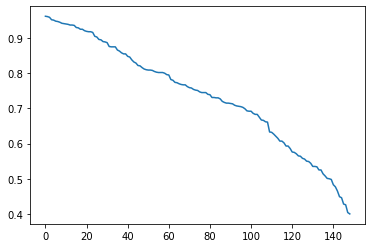

In [7]:
plt.plot(covid['Human Development Index 2021 (HDI)'])
plt.show()

In [8]:
covid.describe()

,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,NewDeaths,New Cases/1M pop,New Deaths/1M pop
count,149.000000,149.000000,149.000000,149.000000,149.000000,149.000000,1.490000e+02,149.000000,149.000000,149.000000,149.000000,1.490000e+02,1.490000e+02,1.490000e+02,1.280000e+02,1.490000e+02,149.000000,149.000000,149.000000,149.000000,18.000000,31.000000,18.000000
mean,89.590604,0.737940,72.099044,13.872340,9.282668,21483.297314,6.267643e+11,17043.642330,5.483672,9.456853,7.708107,8.636745e+07,3.580191e+07,3.313822e+07,8.862114e+05,5.523126e+05,147.465973,61.090268,56.137584,12556.147651,10.222222,50.808065,0.331667
std,55.154576,0.148244,7.600011,2.858387,3.145162,20484.572503,2.471488e+12,23472.569989,5.151016,34.697423,5.388807,3.461232e+08,1.394578e+08,1.328467e+08,2.890113e+06,2.065596e+06,79.618981,23.674900,24.003123,11346.083328,14.901858,65.684372,0.317143
min,1.000000,0.400000,52.676000,6.957112,2.114962,731.786709,4.692313e+08,221.477676,-7.084588,-0.606319,0.170000,3.577200e+04,3.381400e+04,3.162700e+04,0.000000e+00,4.100000e+02,0.280000,0.260000,0.260000,32.000000,1.000000,0.050000,0.010000
25%,40.000000,0.627000,67.239800,12.087473,7.088480,5472.104781,1.609182e+10,2535.623432,3.052614,2.194574,4.046000,2.787212e+06,1.265802e+06,1.226796e+06,2.704700e+04,1.912100e+04,77.450000,42.720000,37.800000,7465.000000,1.250000,3.000000,0.100000
50%,89.000000,0.751000,72.614600,13.951780,9.827750,13157.993900,6.360510e+10,6104.136709,4.600000,3.653533,6.011000,1.288491e+07,5.888649e+06,4.862494e+06,1.349460e+05,9.671100e+04,147.860000,65.550000,62.310000,11268.000000,4.500000,22.000000,0.200000
75%,135.000000,0.858000,77.198200,15.928960,11.895590,32803.234230,3.661376e+11,21391.925334,7.524910,5.812251,10.290000,3.956420e+07,1.864148e+07,1.770012e+07,6.124895e+05,3.901020e+05,213.920000,80.610000,75.190000,15163.000000,11.750000,78.500000,0.475000
max,189.000000,0.962000,85.473400,21.054590,14.090967,90918.644710,2.331508e+13,133590.146976,41.745101,382.815998,28.770000,3.491077e+09,1.310292e+09,1.276760e+09,2.474100e+07,2.242429e+07,319.780000,105.820000,105.820000,117113.000000,58.000000,282.000000,1.000000


In [9]:
covid.isnull().sum()

Country Code                                0
Country                                     0
HDI rank                                    0
Human Development Index 2021 (HDI)          0
Life expectancy at birth                    0
Expected years of schooling                 0
Mean years of schooling                     0
Gross national income (GNI) per capita      0
GDP 2021 (US$)                              0
GDP per capita 2021 (US$)                   0
GDP growth 2021 (annual %)                  0
Inflation Rate 2021 (%)                     0
Unemployment Rate 2021 (%)                  0
Region                                      0
IncomeGroup                                 0
total_vaccinations                          0
date                                        0
people_vaccinated                           0
people_fully_vaccinated                     0
daily_vaccinations_raw                     21
daily_vaccinations                          0
total_vaccinations_per_hundred    

In [10]:
covid['TotalDeaths'].value_counts()

225       2
14,452    1
688       1
43,186    1
66,396    1
         ..
9,309     1
7,621     1
7,118     1
8,612     1
312       1
Name: TotalDeaths, Length: 148, dtype: int64

In [11]:
covid.nunique()

Country Code                              149
Country                                   149
HDI rank                                  128
Human Development Index 2021 (HDI)        128
Life expectancy at birth                  149
Expected years of schooling               149
Mean years of schooling                   149
Gross national income (GNI) per capita    149
GDP 2021 (US$)                            149
GDP per capita 2021 (US$)                 149
GDP growth 2021 (annual %)                149
Inflation Rate 2021 (%)                   149
Unemployment Rate 2021 (%)                145
Region                                      7
IncomeGroup                                 4
total_vaccinations                        149
date                                       75
people_vaccinated                         149
people_fully_vaccinated                   149
daily_vaccinations_raw                    128
daily_vaccinations                        149
total_vaccinations_per_hundred    

In [12]:
#There's the need to find lat and long for all countries to put it on the map 

In [13]:
url = 'https://gist.githubusercontent.com/tadast/8827699/raw/f5cac3d42d16b78348610fc4ec301e9234f82821/countries_codes_and_coordinates.csv'
countrylatlong = pd.read_csv(url)
countrylatlong

,Country,Alpha-2 code,Alpha-3 code,Numeric code,Latitude (average),Longitude (average)
0,Afghanistan,"""AF""","""AFG""","""4""","""33""","""65"""
1,Albania,"""AL""","""ALB""","""8""","""41""","""20"""
2,Algeria,"""DZ""","""DZA""","""12""","""28""","""3"""
3,American Samoa,"""AS""","""ASM""","""16""","""-14.3333""","""-170"""
4,Andorra,"""AD""","""AND""","""20""","""42.5""","""1.6"""
...,...,...,...,...,...,...
251,Wallis and Futuna,"""WF""","""WLF""","""876""","""-13.3""","""-176.2"""
252,Western Sahara,"""EH""","""ESH""","""732""","""24.5""","""-13"""
253,Yemen,"""YE""","""YEM""","""887""","""15""","""48"""
254,Zambia,"""ZM""","""ZMB""","""894""","""-15""","""30"""


In [14]:
countrylatlong.drop(['Numeric code', 'Alpha-2 code'], axis = 1, inplace = True)

In [15]:
countrylatlong

,Country,Alpha-3 code,Latitude (average),Longitude (average)
0,Afghanistan,"""AFG""","""33""","""65"""
1,Albania,"""ALB""","""41""","""20"""
2,Algeria,"""DZA""","""28""","""3"""
3,American Samoa,"""ASM""","""-14.3333""","""-170"""
4,Andorra,"""AND""","""42.5""","""1.6"""
...,...,...,...,...
251,Wallis and Futuna,"""WLF""","""-13.3""","""-176.2"""
252,Western Sahara,"""ESH""","""24.5""","""-13"""
253,Yemen,"""YEM""","""15""","""48"""
254,Zambia,"""ZMB""","""-15""","""30"""


In [16]:
countrylatlong.rename({'Alpha-3 code': 'Country Code', 'Latitude (average)':'Latitude', 'Longitude (average)':'Longitude'}, axis=1, inplace=True)

In [17]:
countrylatlong

,Country,Country Code,Latitude,Longitude
0,Afghanistan,"""AFG""","""33""","""65"""
1,Albania,"""ALB""","""41""","""20"""
2,Algeria,"""DZA""","""28""","""3"""
3,American Samoa,"""ASM""","""-14.3333""","""-170"""
4,Andorra,"""AND""","""42.5""","""1.6"""
...,...,...,...,...
251,Wallis and Futuna,"""WLF""","""-13.3""","""-176.2"""
252,Western Sahara,"""ESH""","""24.5""","""-13"""
253,Yemen,"""YEM""","""15""","""48"""
254,Zambia,"""ZMB""","""-15""","""30"""


In [18]:
countrylatlong['Country Code'] = countrylatlong['Country Code'].str.strip('" "')
countrylatlong['Latitude'] = countrylatlong['Latitude'].str.strip('" "')
countrylatlong['Longitude'] = countrylatlong['Longitude'].str.strip('" "')

In [19]:
countrylatlong

,Country,Country Code,Latitude,Longitude
0,Afghanistan,AFG,33,65
1,Albania,ALB,41,20
2,Algeria,DZA,28,3
3,American Samoa,ASM,-14.3333,-170
4,Andorra,AND,42.5,1.6
...,...,...,...,...
251,Wallis and Futuna,WLF,-13.3,-176.2
252,Western Sahara,ESH,24.5,-13
253,Yemen,YEM,15,48
254,Zambia,ZMB,-15,30


In [20]:
covid

,Country Code,Country,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,CHE,Switzerland,1,0.962,83.9872,16.500299,13.859660,66933.004540,8.006402e+11,91991.600458,4.221717,0.581814,5.100,Europe & Central Asia,High income,16936227,2023-04-03,6096607,6013015,113605.0,92595,193.77,69.75,68.80,10594,Switzerland,"4,397,632",NaN,"14,452",NaN,"4,376,555",NaN,"6,625",39,"23,833,472","8,773,637",Europe,NaN,NaN,755
1,NOR,Norway,2,0.961,83.2339,18.185200,13.003630,64660.106220,4.821749e+11,89154.276093,3.880936,3.483881,4.370,Europe & Central Asia,High income,12145560,2022-11-13,4346995,4054726,138686.0,69148,223.50,79.99,74.61,12724,Norway,"1,481,421",NaN,"5,213",NaN,"1,474,840",NaN,"1,368",20,"11,002,430","5,511,370",Europe,NaN,NaN,248
2,ISL,Iceland,3,0.959,82.6782,19.163059,13.767170,55782.049810,2.560242e+10,68727.636665,4.403045,4.444240,6.020,Europe & Central Asia,High income,805469,2022-03-29,309770,290193,21266.0,7546,216.00,83.07,77.82,20236,Iceland,"209,191",NaN,229,NaN,NaN,NaN,NaN,2,"1,996,384","345,393",Europe,NaN,NaN,"385,871"
3,HKG,"Hong Kong, China (SAR)",4,0.952,85.4734,17.278170,12.226210,62606.845400,3.691764e+11,49800.542414,6.343106,1.568758,5.170,East Asia & Pacific,High income,20743734,2023-04-02,6914894,6798392,102019.0,86321,276.99,92.34,90.78,11527,Hong Kong,"2,885,246",+99,"13,482",5.0,"2,869,869",+96,"1,895",28,"76,127,725","7,604,299",Asia,13.0,0.7,249
4,AUS,Australia,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,"19,856",NaN,"11,264,265",NaN,"43,652",33,"78,835,048","26,068,792",Australia/Oceania,NaN,NaN,"1,674"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,MOZ,Mozambique,185,0.446,59.3247,10.219152,3.197642,1198.073924,1.577676e+10,491.839113,2.363988,5.688487,3.939,Sub-Saharan Africa,Low income,29457535,2023-01-29,18641485,18466955,295812.0,588728,89.35,56.54,56.01,17857,Mozambique,"233,334",NaN,"2,242",NaN,"228,805",NaN,"2,287",11,"1,371,127","33,089,461",Africa,NaN,NaN,69
145,MLI,Mali,186,0.428,58.9414,7.423038,2.310000,2132.629443,1.914046e+10,873.794862,3.052614,3.925603,2.603,Sub-Saharan Africa,Low income,5369445,2023-03-19,3959022,3247719,NaN,58966,23.77,17.52,14.37,2610,Mali,"33,118",NaN,743,NaN,"32,295",NaN,80,NaN,"801,612","21,473,764",Africa,NaN,NaN,4
146,BDI,Burundi,187,0.426,61.6627,10.722722,3.129267,731.786709,2.779813e+09,221.477676,1.795300,8.404538,1.132,Sub-Saharan Africa,Low income,35772,2023-03-19,33814,33225,109.0,410,0.28,0.26,0.26,32,Burundi,"53,686",NaN,38,NaN,"53,569",NaN,79,NaN,"345,742","12,624,840",Africa,NaN,NaN,6
147,CAF,Central African Republic,188,0.404,53.8947,8.040172,4.334000,966.058611,2.516498e+09,461.137490,0.900000,4.259364,6.458,Sub-Saharan Africa,Low income,2689234,2023-03-26,2381935,2266531,12887.0,25469,48.20,42.69,40.63,4565,CAF,"15,368",NaN,113,NaN,"15,200",NaN,55,2,"81,294","5,016,678",Africa,NaN,NaN,11


In [21]:
covidlatlong = countrylatlong.merge(covid, on= 'Country Code', how = 'inner', indicator = True)

In [22]:
covidlatlong

,Country_x,Country Code,Latitude,Longitude,Country_y,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,_merge
0,Albania,ALB,41,20,Albania,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,"3,602",NaN,"329,352",NaN,"1,709",NaN,"1,941,032","2,866,374",Europe,NaN,NaN,596,both
1,Algeria,DZA,28,3,Algeria,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,"6,881",NaN,"182,893",NaN,"81,825",NaN,"230,861","45,350,148",Africa,0.1,NaN,"1,804",both
2,Angola,AGO,-12.5,18.5,Angola,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,"1,933",NaN,"103,342",NaN,41,NaN,"1,499,795","35,027,343",Africa,NaN,NaN,1,both
3,Armenia,ARM,40,45,Armenia,85,0.759,72.0431,13.116760,11.330300,13157.993900,1.386141e+10,4966.513471,5.700000,7.184836,12.729,Europe & Central Asia,Upper middle income,2153341,2023-03-05,1130844,986762,NaN,17910,77.45,40.67,35.49,6441,Armenia,"448,151",NaN,"8,739",NaN,"435,162",NaN,"4,250",NaN,"3,242,901","2,971,966",Asia,NaN,NaN,"1,430",both
4,Australia,AUS,-27,133,Australia,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,"19,856",NaN,"11,264,265",NaN,"43,652",33,"78,835,048","26,068,792",Australia/Oceania,NaN,NaN,"1,674",both
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
152,Vanuatu,VUT,-16,167,Vanuatu,140,0.607,70.4490,11.535315,7.064846,3085.411633,9.563327e+08,2996.621062,0.449256,2.343284,2.118,East Asia & Pacific,Lower middle income,366638,2023-02-20,176624,162250,NaN,8843,112.21,54.06,49.66,27064,Vanuatu,"12,014",NaN,14,NaN,"11,976",NaN,24,NaN,"24,976","321,832",Australia/Oceania,NaN,NaN,75,both
153,Viet Nam,VNM,16,106,Viet Nam,115,0.703,73.6181,12.951932,8.370280,7867.371345,3.661376e+11,3756.489121,2.561551,1.834716,2.380,East Asia & Pacific,Lower middle income,266477589,2023-03-09,90497674,86002617,2091069.0,1675471,271.40,92.17,87.59,17064,Vietnam,"11,527,454",+51,"43,186",NaN,"10,615,014",+23,"869,254",7,"85,826,548","98,953,541",Asia,0.5,NaN,"8,784",both
154,Vietnam,VNM,16,106,Viet Nam,115,0.703,73.6181,12.951932,8.370280,7867.371345,3.661376e+11,3756.489121,2.561551,1.834716,2.380,East Asia & Pacific,Lower middle income,266477589,2023-03-09,90497674,86002617,2091069.0,1675471,271.40,92.17,87.59,17064,Vietnam,"11,527,454",+51,"43,186",NaN,"10,615,014",+23,"869,254",7,"85,826,548","98,953,541",Asia,0.5,NaN,"8,784",both
155,Zambia,ZMB,-15,30,Zambia,154,0.565,61.2234,10.928760,7.187091,3217.767739,2.214763e+10,1137.343633,4.598734,22.021234,6.220,Sub-Saharan Africa,Low income,1279211

In [23]:
covidlatlong = covidlatlong.drop_duplicates(subset=['Country Code'])

In [24]:
covidlatlong

,Country_x,Country Code,Latitude,Longitude,Country_y,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,_merge
0,Albania,ALB,41,20,Albania,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,"3,602",NaN,"329,352",NaN,"1,709",NaN,"1,941,032","2,866,374",Europe,NaN,NaN,596,both
1,Algeria,DZA,28,3,Algeria,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,"6,881",NaN,"182,893",NaN,"81,825",NaN,"230,861","45,350,148",Africa,0.1,NaN,"1,804",both
2,Angola,AGO,-12.5,18.5,Angola,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,"1,933",NaN,"103,342",NaN,41,NaN,"1,499,795","35,027,343",Africa,NaN,NaN,1,both
3,Armenia,ARM,40,45,Armenia,85,0.759,72.0431,13.116760,11.330300,13157.993900,1.386141e+10,4966.513471,5.700000,7.184836,12.729,Europe & Central Asia,Upper middle income,2153341,2023-03-05,1130844,986762,NaN,17910,77.45,40.67,35.49,6441,Armenia,"448,151",NaN,"8,739",NaN,"435,162",NaN,"4,250",NaN,"3,242,901","2,971,966",Asia,NaN,NaN,"1,430",both
4,Australia,AUS,-27,133,Australia,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,"19,856",NaN,"11,264,265",NaN,"43,652",33,"78,835,048","26,068,792",Australia/Oceania,NaN,NaN,"1,674",both
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151,Uzbekistan,UZB,41,64,Uzbekistan,101,0.727,70.8616,12.477140,11.895590,7916.785725,6.923890e+10,1983.064723,7.420110,10.849240,6.017,Europe & Central Asia,Lower middle income,75503399,2023-03-05,21684856,18144247,720866.0,426314,218.04,62.62,52.40,12311,Uzbekistan,"251,839",NaN,"1,637",NaN,"241,486",NaN,"8,716",23,"1,377,915","34,382,084",Asia,NaN,NaN,254,both
152,Vanuatu,VUT,-16,167,Vanuatu,140,0.607,70.4490,11.535315,7.064846,3085.411633,9.563327e+08,2996.621062,0.449256,2.343284,2.118,East Asia & Pacific,Lower middle income,366638,2023-02-20,176624,162250,NaN,8843,112.21,54.06,49.66,27064,Vanuatu,"12,014",NaN,14,NaN,"11,976",NaN,24,NaN,"24,976","321,832",Australia/Oceania,NaN,NaN,75,both
153,Viet Nam,VNM,16,106,Viet Nam,115,0.703,73.6181,12.951932,8.370280,7867.371345,3.661376e+11,3756.489121,2.561551,1.834716,2.380,East Asia & Pacific,Lower middle income,266477589,2023-03-09,90497674,86002617,2091069.0,1675471,271.40,92.17,87.59,17064,Vietnam,"11,527,454",+51,"43,186",NaN,"10,615,014",+23,"869,254",7,"85,826,548","98,953,541",Asia,0.5,NaN,"8,784",both
155,Zambia,ZMB,-15,30,Zambia,154,0.565,61.2234,10.928760,7.187091,3217.767739,2.214763e+10,1137.343633,4.598734,22.021234,6.220,Sub-Saharan Africa,Low income,12792112,202

In [25]:
covidlatlong.reset_index(drop=True, inplace = True)

In [26]:
covidlatlong

,Country_x,Country Code,Latitude,Longitude,Country_y,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,_merge
0,Albania,ALB,41,20,Albania,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,"3,602",NaN,"329,352",NaN,"1,709",NaN,"1,941,032","2,866,374",Europe,NaN,NaN,596,both
1,Algeria,DZA,28,3,Algeria,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,"6,881",NaN,"182,893",NaN,"81,825",NaN,"230,861","45,350,148",Africa,0.1,NaN,"1,804",both
2,Angola,AGO,-12.5,18.5,Angola,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,"1,933",NaN,"103,342",NaN,41,NaN,"1,499,795","35,027,343",Africa,NaN,NaN,1,both
3,Armenia,ARM,40,45,Armenia,85,0.759,72.0431,13.116760,11.330300,13157.993900,1.386141e+10,4966.513471,5.700000,7.184836,12.729,Europe & Central Asia,Upper middle income,2153341,2023-03-05,1130844,986762,NaN,17910,77.45,40.67,35.49,6441,Armenia,"448,151",NaN,"8,739",NaN,"435,162",NaN,"4,250",NaN,"3,242,901","2,971,966",Asia,NaN,NaN,"1,430",both
4,Australia,AUS,-27,133,Australia,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,"19,856",NaN,"11,264,265",NaN,"43,652",33,"78,835,048","26,068,792",Australia/Oceania,NaN,NaN,"1,674",both
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,Uzbekistan,UZB,41,64,Uzbekistan,101,0.727,70.8616,12.477140,11.895590,7916.785725,6.923890e+10,1983.064723,7.420110,10.849240,6.017,Europe & Central Asia,Lower middle income,75503399,2023-03-05,21684856,18144247,720866.0,426314,218.04,62.62,52.40,12311,Uzbekistan,"251,839",NaN,"1,637",NaN,"241,486",NaN,"8,716",23,"1,377,915","34,382,084",Asia,NaN,NaN,254,both
145,Vanuatu,VUT,-16,167,Vanuatu,140,0.607,70.4490,11.535315,7.064846,3085.411633,9.563327e+08,2996.621062,0.449256,2.343284,2.118,East Asia & Pacific,Lower middle income,366638,2023-02-20,176624,162250,NaN,8843,112.21,54.06,49.66,27064,Vanuatu,"12,014",NaN,14,NaN,"11,976",NaN,24,NaN,"24,976","321,832",Australia/Oceania,NaN,NaN,75,both
146,Viet Nam,VNM,16,106,Viet Nam,115,0.703,73.6181,12.951932,8.370280,7867.371345,3.661376e+11,3756.489121,2.561551,1.834716,2.380,East Asia & Pacific,Lower middle income,266477589,2023-03-09,90497674,86002617,2091069.0,1675471,271.40,92.17,87.59,17064,Vietnam,"11,527,454",+51,"43,186",NaN,"10,615,014",+23,"869,254",7,"85,826,548","98,953,541",Asia,0.5,NaN,"8,784",both
147,Zambia,ZMB,-15,30,Zambia,154,0.565,61.2234,10.928760,7.187091,3217.767739,2.214763e+10,1137.343633,4.598734,22.021234,6.220,Sub-Saharan Africa,Low income,12792112,202

In [27]:
covidlatlong = covidlatlong.drop(['Country_y','_merge'], axis = 1)

In [28]:
covidlatlong

,Country_x,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,Albania,ALB,41,20,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,"3,602",NaN,"329,352",NaN,"1,709",NaN,"1,941,032","2,866,374",Europe,NaN,NaN,596
1,Algeria,DZA,28,3,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,"6,881",NaN,"182,893",NaN,"81,825",NaN,"230,861","45,350,148",Africa,0.1,NaN,"1,804"
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,"1,933",NaN,"103,342",NaN,41,NaN,"1,499,795","35,027,343",Africa,NaN,NaN,1
3,Armenia,ARM,40,45,85,0.759,72.0431,13.116760,11.330300,13157.993900,1.386141e+10,4966.513471,5.700000,7.184836,12.729,Europe & Central Asia,Upper middle income,2153341,2023-03-05,1130844,986762,NaN,17910,77.45,40.67,35.49,6441,Armenia,"448,151",NaN,"8,739",NaN,"435,162",NaN,"4,250",NaN,"3,242,901","2,971,966",Asia,NaN,NaN,"1,430"
4,Australia,AUS,-27,133,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,"19,856",NaN,"11,264,265",NaN,"43,652",33,"78,835,048","26,068,792",Australia/Oceania,NaN,NaN,"1,674"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,Uzbekistan,UZB,41,64,101,0.727,70.8616,12.477140,11.895590,7916.785725,6.923890e+10,1983.064723,7.420110,10.849240,6.017,Europe & Central Asia,Lower middle income,75503399,2023-03-05,21684856,18144247,720866.0,426314,218.04,62.62,52.40,12311,Uzbekistan,"251,839",NaN,"1,637",NaN,"241,486",NaN,"8,716",23,"1,377,915","34,382,084",Asia,NaN,NaN,254
145,Vanuatu,VUT,-16,167,140,0.607,70.4490,11.535315,7.064846,3085.411633,9.563327e+08,2996.621062,0.449256,2.343284,2.118,East Asia & Pacific,Lower middle income,366638,2023-02-20,176624,162250,NaN,8843,112.21,54.06,49.66,27064,Vanuatu,"12,014",NaN,14,NaN,"11,976",NaN,24,NaN,"24,976","321,832",Australia/Oceania,NaN,NaN,75
146,Viet Nam,VNM,16,106,115,0.703,73.6181,12.951932,8.370280,7867.371345,3.661376e+11,3756.489121,2.561551,1.834716,2.380,East Asia & Pacific,Lower middle income,266477589,2023-03-09,90497674,86002617,2091069.0,1675471,271.40,92.17,87.59,17064,Vietnam,"11,527,454",+51,"43,186",NaN,"10,615,014",+23,"869,254",7,"85,826,548","98,953,541",Asia,0.5,NaN,"8,784"
147,Zambia,ZMB,-15,30,154,0.565,61.2234,10.928760,7.187091,3217.767739,2.214763e+10,1137.343633,4.598734,22.021234,6.220,Sub-Saharan Africa,Low income,12792112,2023-03-15,11158619,8747040,224617.0,180289,63.90,55.74,43.70,9006,Zambia,"343,687",NaN,"4,058",NaN,"339,507",NaN,122,NaN,"3,994,061","19,470,23

In [29]:
covidlatlong.rename({'Country_x': 'Country'}, axis=1, inplace=True)

In [30]:
covidlatlong

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,Albania,ALB,41,20,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,"3,602",NaN,"329,352",NaN,"1,709",NaN,"1,941,032","2,866,374",Europe,NaN,NaN,596
1,Algeria,DZA,28,3,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,"6,881",NaN,"182,893",NaN,"81,825",NaN,"230,861","45,350,148",Africa,0.1,NaN,"1,804"
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,"1,933",NaN,"103,342",NaN,41,NaN,"1,499,795","35,027,343",Africa,NaN,NaN,1
3,Armenia,ARM,40,45,85,0.759,72.0431,13.116760,11.330300,13157.993900,1.386141e+10,4966.513471,5.700000,7.184836,12.729,Europe & Central Asia,Upper middle income,2153341,2023-03-05,1130844,986762,NaN,17910,77.45,40.67,35.49,6441,Armenia,"448,151",NaN,"8,739",NaN,"435,162",NaN,"4,250",NaN,"3,242,901","2,971,966",Asia,NaN,NaN,"1,430"
4,Australia,AUS,-27,133,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,"19,856",NaN,"11,264,265",NaN,"43,652",33,"78,835,048","26,068,792",Australia/Oceania,NaN,NaN,"1,674"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,Uzbekistan,UZB,41,64,101,0.727,70.8616,12.477140,11.895590,7916.785725,6.923890e+10,1983.064723,7.420110,10.849240,6.017,Europe & Central Asia,Lower middle income,75503399,2023-03-05,21684856,18144247,720866.0,426314,218.04,62.62,52.40,12311,Uzbekistan,"251,839",NaN,"1,637",NaN,"241,486",NaN,"8,716",23,"1,377,915","34,382,084",Asia,NaN,NaN,254
145,Vanuatu,VUT,-16,167,140,0.607,70.4490,11.535315,7.064846,3085.411633,9.563327e+08,2996.621062,0.449256,2.343284,2.118,East Asia & Pacific,Lower middle income,366638,2023-02-20,176624,162250,NaN,8843,112.21,54.06,49.66,27064,Vanuatu,"12,014",NaN,14,NaN,"11,976",NaN,24,NaN,"24,976","321,832",Australia/Oceania,NaN,NaN,75
146,Viet Nam,VNM,16,106,115,0.703,73.6181,12.951932,8.370280,7867.371345,3.661376e+11,3756.489121,2.561551,1.834716,2.380,East Asia & Pacific,Lower middle income,266477589,2023-03-09,90497674,86002617,2091069.0,1675471,271.40,92.17,87.59,17064,Vietnam,"11,527,454",+51,"43,186",NaN,"10,615,014",+23,"869,254",7,"85,826,548","98,953,541",Asia,0.5,NaN,"8,784"
147,Zambia,ZMB,-15,30,154,0.565,61.2234,10.928760,7.187091,3217.767739,2.214763e+10,1137.343633,4.598734,22.021234,6.220,Sub-Saharan Africa,Low income,12792112,2023-03-15,11158619,8747040,224617.0,180289,63.90,55.74,43.70,9006,Zambia,"343,687",NaN,"4,058",NaN,"339,507",NaN,122,NaN,"3,994,061","19,470,234"

In [31]:
covidlatlong.to_excel('covidlatlongApril5th2023.xlsx', index = False)

### 5.1 Mapping

In [32]:
covidlatlong = pd.read_excel('covidlatlongApril5th2023.xlsx')

In [33]:
covidlatlong.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,"3,602",NaN,"329,352",NaN,"1,709",NaN,"1,941,032","2,866,374",Europe,NaN,NaN,596
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,"6,881",NaN,"182,893",NaN,"81,825",NaN,"230,861","45,350,148",Africa,0.1,NaN,"1,804"
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,"1,933",NaN,"103,342",NaN,41,NaN,"1,499,795","35,027,343",Africa,NaN,NaN,1


In [34]:
covidlatlong.shape

(149, 42)

In [35]:
covidlatlong.dtypes

Country                                    object
Country Code                               object
Latitude                                  float64
Longitude                                 float64
HDI rank                                    int64
Human Development Index 2021 (HDI)        float64
Life expectancy at birth                  float64
Expected years of schooling               float64
Mean years of schooling                   float64
Gross national income (GNI) per capita    float64
GDP 2021 (US$)                            float64
GDP per capita 2021 (US$)                 float64
GDP growth 2021 (annual %)                float64
Inflation Rate 2021 (%)                   float64
Unemployment Rate 2021 (%)                float64
Region                                     object
IncomeGroup                                object
total_vaccinations                          int64
date                                       object
people_vaccinated                           int64


#### 5.1.1 Globe

In [36]:
import geopandas as gpd
from mpl_toolkits.basemap import Basemap 
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [37]:
covidlatlong.shape

(149, 42)

In [38]:
sns.color_palette('Set1',149)

[(0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.968627450

In [39]:
country = list(covidlatlong['Country'].unique())
c = sns.color_palette('Set1',149)
label = country

In [40]:
country

['Albania',
 'Algeria',
 'Angola',
 'Armenia',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas',
 'Bahrain',
 'Bangladesh',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bhutan',
 'Bolivia, Plurinational State of',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei Darussalam',
 'Bulgaria',
 'Burkina Faso',
 'Burundi',
 'Cambodia',
 'Cameroon',
 'Canada',
 'Cape Verde',
 'Central African Republic',
 'Chile',
 'China',
 'Colombia',
 'Congo',
 'Costa Rica',
 "Côte d'Ivoire",
 'Croatia',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Dominican Republic',
 'Ecuador',
 'Egypt',
 'El Salvador',
 'Estonia',
 'Ethiopia',
 'Fiji',
 'Finland',
 'France',
 'Gambia',
 'Georgia',
 'Germany',
 'Ghana',
 'Greece',
 'Guatemala',
 'Guinea',
 'Guinea-Bissau',
 'Guyana',
 'Haiti',
 'Honduras',
 'Hong Kong',
 'Hungary',
 'Iceland',
 'India',
 'Indonesia',
 'Iran, Islamic Republic of',
 'Iraq',
 'Ireland',
 'Israel',
 'Italy',
 'Jamaica',
 'Japan',
 'Jordan',
 'Kenya',
 'Korea, Republic of',
 'Ky

In [41]:
c

[(0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.9686274509803922, 0.5058823529411764, 0.7490196078431373),
 (0.6, 0.6, 0.6),
 (0.8941176470588236, 0.10196078431372549, 0.10980392156862745),
 (0.21568627450980393, 0.49411764705882355, 0.7215686274509804),
 (0.30196078431372547, 0.6862745098039216, 0.2901960784313726),
 (0.596078431372549, 0.3058823529411765, 0.6392156862745098),
 (1.0, 0.4980392156862745, 0.0),
 (1.0, 1.0, 0.2),
 (0.6509803921568628, 0.33725490196078434, 0.1568627450980392),
 (0.968627450

In [42]:
for i, j, k in zip(country,c,country):
    print(i,j,k)

Albania (0.8941176470588236, 0.10196078431372549, 0.10980392156862745) Albania
Algeria (0.21568627450980393, 0.49411764705882355, 0.7215686274509804) Algeria
Angola (0.30196078431372547, 0.6862745098039216, 0.2901960784313726) Angola
Armenia (0.596078431372549, 0.3058823529411765, 0.6392156862745098) Armenia
Australia (1.0, 0.4980392156862745, 0.0) Australia
Austria (1.0, 1.0, 0.2) Austria
Azerbaijan (0.6509803921568628, 0.33725490196078434, 0.1568627450980392) Azerbaijan
Bahamas (0.9686274509803922, 0.5058823529411764, 0.7490196078431373) Bahamas
Bahrain (0.6, 0.6, 0.6) Bahrain
Bangladesh (0.8941176470588236, 0.10196078431372549, 0.10980392156862745) Bangladesh
Belarus (0.21568627450980393, 0.49411764705882355, 0.7215686274509804) Belarus
Belgium (0.30196078431372547, 0.6862745098039216, 0.2901960784313726) Belgium
Belize (0.596078431372549, 0.3058823529411765, 0.6392156862745098) Belize
Benin (1.0, 0.4980392156862745, 0.0) Benin
Bhutan (1.0, 1.0, 0.2) Bhutan
Bolivia, Plurinational St

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


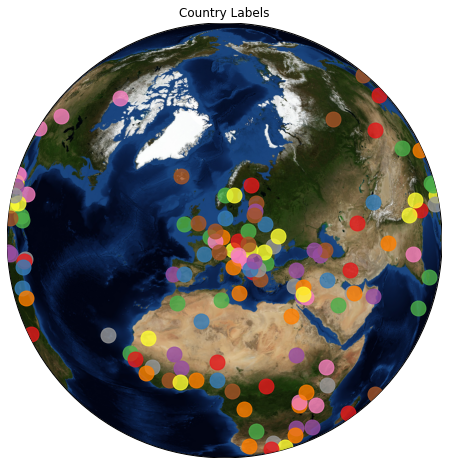

In [43]:
m3 = Basemap(projection='ortho', resolution=None, lat_0=50, lon_0=10,urcrnrlat=80,llcrnrlat=-80)

plt.figure(figsize=(8,8))

country = list(covidlatlong['Country'].unique())
c       = sns.color_palette('Set1',149)
#label   = country

def function(country,c,label):
    lat = list(covidlatlong[covidlatlong['Country'] == country].Latitude) 
    lon = list(covidlatlong[covidlatlong['Country'] == country].Longitude)
    x,y = m3(lon,lat)
    m3.plot(x,y,'go',markersize=15,color=c,alpha=.8,label=label)

for i,j in zip(country,c): # zip: aggregates elements based on the elements
    function(i,j,i)

m3.bluemarble(scale=0.5)
#plt.legend(loc='lower right',frameon=True,prop={'size':8}).get_frame().set_facecolor('white')
plt.title('Country Labels')
plt.show()

In [44]:
list(covidlatlong[covidlatlong['Country']=='Brazil'].Latitude)

[-10.0]

In [45]:
list(covidlatlong['Country'].unique())

['Albania',
 'Algeria',
 'Angola',
 'Armenia',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas',
 'Bahrain',
 'Bangladesh',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bhutan',
 'Bolivia, Plurinational State of',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei Darussalam',
 'Bulgaria',
 'Burkina Faso',
 'Burundi',
 'Cambodia',
 'Cameroon',
 'Canada',
 'Cape Verde',
 'Central African Republic',
 'Chile',
 'China',
 'Colombia',
 'Congo',
 'Costa Rica',
 "Côte d'Ivoire",
 'Croatia',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Dominican Republic',
 'Ecuador',
 'Egypt',
 'El Salvador',
 'Estonia',
 'Ethiopia',
 'Fiji',
 'Finland',
 'France',
 'Gambia',
 'Georgia',
 'Germany',
 'Ghana',
 'Greece',
 'Guatemala',
 'Guinea',
 'Guinea-Bissau',
 'Guyana',
 'Haiti',
 'Honduras',
 'Hong Kong',
 'Hungary',
 'Iceland',
 'India',
 'Indonesia',
 'Iran, Islamic Republic of',
 'Iraq',
 'Ireland',
 'Israel',
 'Italy',
 'Jamaica',
 'Japan',
 'Jordan',
 'Kenya',
 'Korea, Republic of',
 'Ky

In [46]:
country

['Albania',
 'Algeria',
 'Angola',
 'Armenia',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas',
 'Bahrain',
 'Bangladesh',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bhutan',
 'Bolivia, Plurinational State of',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei Darussalam',
 'Bulgaria',
 'Burkina Faso',
 'Burundi',
 'Cambodia',
 'Cameroon',
 'Canada',
 'Cape Verde',
 'Central African Republic',
 'Chile',
 'China',
 'Colombia',
 'Congo',
 'Costa Rica',
 "Côte d'Ivoire",
 'Croatia',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Dominican Republic',
 'Ecuador',
 'Egypt',
 'El Salvador',
 'Estonia',
 'Ethiopia',
 'Fiji',
 'Finland',
 'France',
 'Gambia',
 'Georgia',
 'Germany',
 'Ghana',
 'Greece',
 'Guatemala',
 'Guinea',
 'Guinea-Bissau',
 'Guyana',
 'Haiti',
 'Honduras',
 'Hong Kong',
 'Hungary',
 'Iceland',
 'India',
 'Indonesia',
 'Iran, Islamic Republic of',
 'Iraq',
 'Ireland',
 'Israel',
 'Italy',
 'Jamaica',
 'Japan',
 'Jordan',
 'Kenya',
 'Korea, Republic of',
 'Ky

In [47]:
print(country)

['Albania', 'Algeria', 'Angola', 'Armenia', 'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh', 'Belarus', 'Belgium', 'Belize', 'Benin', 'Bhutan', 'Bolivia, Plurinational State of', 'Bosnia and Herzegovina', 'Botswana', 'Brazil', 'Brunei Darussalam', 'Bulgaria', 'Burkina Faso', 'Burundi', 'Cambodia', 'Cameroon', 'Canada', 'Cape Verde', 'Central African Republic', 'Chile', 'China', 'Colombia', 'Congo', 'Costa Rica', "Côte d'Ivoire", 'Croatia', 'Cyprus', 'Czech Republic', 'Denmark', 'Dominican Republic', 'Ecuador', 'Egypt', 'El Salvador', 'Estonia', 'Ethiopia', 'Fiji', 'Finland', 'France', 'Gambia', 'Georgia', 'Germany', 'Ghana', 'Greece', 'Guatemala', 'Guinea', 'Guinea-Bissau', 'Guyana', 'Haiti', 'Honduras', 'Hong Kong', 'Hungary', 'Iceland', 'India', 'Indonesia', 'Iran, Islamic Republic of', 'Iraq', 'Ireland', 'Israel', 'Italy', 'Jamaica', 'Japan', 'Jordan', 'Kenya', 'Korea, Republic of', 'Kyrgyzstan', "Lao People's Democratic Republic", 'Latvia', 'Lebanon', 'Leso

#### 5.1.2 World Map

In [48]:
# Create a world map to show distributions of users 
import folium
from folium.plugins import MarkerCluster
#empty map
world_map= folium.Map(tiles='cartodbpositron')
marker_cluster = MarkerCluster().add_to(world_map)
#for each coordinate, create circlemarker of user percent
for i in range(len(covid)):
        lat = covidlatlong.iloc[i]['Latitude']
        long = covidlatlong.iloc[i]['Longitude']
        radius=5
        popup_text = """Country : {}<br>
                    Fully Vaccinated : {}<br>"""
        popup_text = popup_text.format(covidlatlong.iloc[i]['Country'],
                                   covidlatlong.iloc[i]['people_fully_vaccinated_per_hundred']
                                   )
        folium.CircleMarker(location = [lat, long], radius=radius, popup= popup_text, fill =True).add_to(marker_cluster)
#show the map
world_map

In [49]:
covidlatlong.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,"3,602",NaN,"329,352",NaN,"1,709",NaN,"1,941,032","2,866,374",Europe,NaN,NaN,596
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,"6,881",NaN,"182,893",NaN,"81,825",NaN,"230,861","45,350,148",Africa,0.1,NaN,"1,804"
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,"1,933",NaN,"103,342",NaN,41,NaN,"1,499,795","35,027,343",Africa,NaN,NaN,1


### 5.2 Graphs

In [50]:
covidvisual = covidlatlong.copy()

In [51]:
covidvisual.shape

(149, 42)

In [52]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,"3,602",NaN,"329,352",NaN,"1,709",NaN,"1,941,032","2,866,374",Europe,NaN,NaN,596
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,"6,881",NaN,"182,893",NaN,"81,825",NaN,"230,861","45,350,148",Africa,0.1,NaN,"1,804"
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,"1,933",NaN,"103,342",NaN,41,NaN,"1,499,795","35,027,343",Africa,NaN,NaN,1


In [53]:
covidvisual.dtypes

Country                                    object
Country Code                               object
Latitude                                  float64
Longitude                                 float64
HDI rank                                    int64
Human Development Index 2021 (HDI)        float64
Life expectancy at birth                  float64
Expected years of schooling               float64
Mean years of schooling                   float64
Gross national income (GNI) per capita    float64
GDP 2021 (US$)                            float64
GDP per capita 2021 (US$)                 float64
GDP growth 2021 (annual %)                float64
Inflation Rate 2021 (%)                   float64
Unemployment Rate 2021 (%)                float64
Region                                     object
IncomeGroup                                object
total_vaccinations                          int64
date                                       object
people_vaccinated                           int64


In [54]:
covidvisual['TotalDeaths'] = covidvisual['TotalDeaths'].replace(',','', regex=True)

In [55]:
covidvisual['Population']=covidvisual['Population'].replace(',','', regex=True)

In [56]:
covidvisual.head(2)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.11039,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.22546,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804"


In [57]:
covidvisual['TotalDeaths'] = covidvisual['TotalDeaths'].astype(float)
covidvisual['Population'] = covidvisual['Population'].astype(float)

In [58]:
covidvisual.dtypes

Country                                    object
Country Code                               object
Latitude                                  float64
Longitude                                 float64
HDI rank                                    int64
Human Development Index 2021 (HDI)        float64
Life expectancy at birth                  float64
Expected years of schooling               float64
Mean years of schooling                   float64
Gross national income (GNI) per capita    float64
GDP 2021 (US$)                            float64
GDP per capita 2021 (US$)                 float64
GDP growth 2021 (annual %)                float64
Inflation Rate 2021 (%)                   float64
Unemployment Rate 2021 (%)                float64
Region                                     object
IncomeGroup                                object
total_vaccinations                          int64
date                                       object
people_vaccinated                           int64


In [59]:
covidvisual['covid_mortality_rate (per 100000)'] = (covidvisual['TotalDeaths']/covidvisual['Population']*100000)

In [60]:
covidvisual.dtypes

Country                                    object
Country Code                               object
Latitude                                  float64
Longitude                                 float64
HDI rank                                    int64
Human Development Index 2021 (HDI)        float64
Life expectancy at birth                  float64
Expected years of schooling               float64
Mean years of schooling                   float64
Gross national income (GNI) per capita    float64
GDP 2021 (US$)                            float64
GDP per capita 2021 (US$)                 float64
GDP growth 2021 (annual %)                float64
Inflation Rate 2021 (%)                   float64
Unemployment Rate 2021 (%)                float64
Region                                     object
IncomeGroup                                object
total_vaccinations                          int64
date                                       object
people_vaccinated                           int64


In [61]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602.0,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374.0,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881.0,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148.0,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933.0,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343.0,Africa,NaN,NaN,1,5.518546


In [62]:
covidvisual['Country'].tolist()

['Albania',
 'Algeria',
 'Angola',
 'Armenia',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas',
 'Bahrain',
 'Bangladesh',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bhutan',
 'Bolivia, Plurinational State of',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei Darussalam',
 'Bulgaria',
 'Burkina Faso',
 'Burundi',
 'Cambodia',
 'Cameroon',
 'Canada',
 'Cape Verde',
 'Central African Republic',
 'Chile',
 'China',
 'Colombia',
 'Congo',
 'Costa Rica',
 "Côte d'Ivoire",
 'Croatia',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Dominican Republic',
 'Ecuador',
 'Egypt',
 'El Salvador',
 'Estonia',
 'Ethiopia',
 'Fiji',
 'Finland',
 'France',
 'Gambia',
 'Georgia',
 'Germany',
 'Ghana',
 'Greece',
 'Guatemala',
 'Guinea',
 'Guinea-Bissau',
 'Guyana',
 'Haiti',
 'Honduras',
 'Hong Kong',
 'Hungary',
 'Iceland',
 'India',
 'Indonesia',
 'Iran, Islamic Republic of',
 'Iraq',
 'Ireland',
 'Israel',
 'Italy',
 'Jamaica',
 'Japan',
 'Jordan',
 'Kenya',
 'Korea, Republic of',
 'Ky

In [63]:
replacers = {'Bolivia, Plurinational State of':'Bolivia', 
             'Iran, Islamic Republic of':'Iran',
             'Korea, Republic of':'South Korea',
             "Lao People's Democratic Republic":'Laos',
             'Macedonia, the former Yugoslav Republic of':'Macedonia',
             'Moldova, Republic of':'Moldova',
             'Palestinian Territory, Occupied':'Palestinian territories',
             'Tanzania, United Republic of':'Tanzania'} 
covidvisual['Country']=covidvisual['Country'].replace(replacers)

In [64]:
covidvisual['Country'].tolist()

['Albania',
 'Algeria',
 'Angola',
 'Armenia',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas',
 'Bahrain',
 'Bangladesh',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bhutan',
 'Bolivia',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei Darussalam',
 'Bulgaria',
 'Burkina Faso',
 'Burundi',
 'Cambodia',
 'Cameroon',
 'Canada',
 'Cape Verde',
 'Central African Republic',
 'Chile',
 'China',
 'Colombia',
 'Congo',
 'Costa Rica',
 "Côte d'Ivoire",
 'Croatia',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Dominican Republic',
 'Ecuador',
 'Egypt',
 'El Salvador',
 'Estonia',
 'Ethiopia',
 'Fiji',
 'Finland',
 'France',
 'Gambia',
 'Georgia',
 'Germany',
 'Ghana',
 'Greece',
 'Guatemala',
 'Guinea',
 'Guinea-Bissau',
 'Guyana',
 'Haiti',
 'Honduras',
 'Hong Kong',
 'Hungary',
 'Iceland',
 'India',
 'Indonesia',
 'Iran',
 'Iraq',
 'Ireland',
 'Israel',
 'Italy',
 'Jamaica',
 'Japan',
 'Jordan',
 'Kenya',
 'South Korea',
 'Kyrgyzstan',
 'Laos',
 'Latvia',
 'Lebanon',
 'Lesotho

In [65]:
covidvisual.to_excel('covidvisualApril5th2023.xlsx', index = False)

#### 5.2.1 Scatter Plots

In [66]:
import plotly_express as px

In [67]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [68]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546


In [69]:
covidvisual.shape

(149, 43)

In [70]:
fig = px.scatter(covidvisual, x = 'people_fully_vaccinated_per_hundred', y ='Country', title = 'People Fully Vaccinated (per 100) by Country', color = 'Country')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by Country',
        'y':0.85,
        'x':0.44,
        'xanchor': 'center',
        'yanchor': 'top'},
    xaxis_title='People Fully Vaccinated per Hundred')

In [71]:
fig = px.scatter(covidvisual, x = 'GDP per capita 2021 (US$)', y = 'people_fully_vaccinated_per_hundred', marginal_x = 'box', marginal_y = 'violin', color = 'GDP per capita 2021 (US$)')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by GDP per capita 2021',
        'y':0.95,
        'x':0.34,
        'xanchor': 'center',
        'yanchor': 'top'},
    yaxis_title='People Fully Vaccinated per Hundred')

In [72]:
fig = px.scatter(covidvisual, x = 'Human Development Index 2021 (HDI)', y = 'people_fully_vaccinated_per_hundred', marginal_x = 'box', marginal_y = 'violin', color = 'Country')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by Countries HDI',
        'y':0.95,
        'x':0.3,
        'xanchor': 'center',
        'yanchor': 'top'},
    yaxis_title='People Fully Vaccinated per Hundred')

In [73]:
fig = px.scatter(covidvisual, x = 'GDP per capita 2021 (US$)', y = 'people_fully_vaccinated_per_hundred', marginal_x = 'box', marginal_y = 'violin', color = 'Country', trendline = 'ols')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by GDP per capita',
        'y':0.95,
        'x':0.3,
        'xanchor': 'center',
        'yanchor': 'top'},
    yaxis_title='People Fully Vaccinated per Hundred')

#### 5.2.2 Bar Graphs

In [74]:
fig = px.bar(covidvisual, x = 'Country', y = 'people_fully_vaccinated_per_hundred', color = 'Country')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by Country',
        'y':0.95,
        'x':0.4,
        'xanchor': 'center',
        'yanchor': 'top'},
    yaxis_title='People Fully Vaccinated per Hundred')

In [75]:
fig = px.bar(covidvisual, x = 'people_fully_vaccinated_per_hundred', y = 'Country', color = 'Country', orientation='h')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by Country',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
 xaxis_title='People Fully Vaccinated per Hundred')

In [76]:
fig = px.bar(covidvisual, x='people_fully_vaccinated_per_hundred', y='Country', color='Country', orientation='h',
             hover_data=['Human Development Index 2021 (HDI)', 'TotalDeaths'],
             height=400)
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by Country with HDI and Total Deaths',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
 xaxis_title='People Fully Vaccinated per Hundred')

In [77]:
fig = px.scatter(covidvisual, x='Country', y='people_fully_vaccinated_per_hundred', color='Continent')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by Country and Continent',
        'y':0.95,
        'x':0.45,
        'xanchor': 'center',
        'yanchor': 'top'},
 yaxis_title='People Fully Vaccinated per Hundred')

#### 5.2.3 Pie Chart

In [78]:
covidvisual1 = covidvisual.sort_values(by='TotalDeaths', ascending = False)

In [79]:
covidvisual1.head()

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
142,United States,USA,38.0,-97.0,21,0.921,77.1982,16.280979,13.683430,64765.215090,2.331508e+13,70248.629000,5.945485,4.697859,5.350,North America,High income,673465377,2023-03-21,269835963,230283056,4576794.0,3506427,202.85,81.27,69.36,10561,USA,"106,273,691",NaN,1155668,NaN,"104,055,782",NaN,"1,062,241","1,895","1,174,878,661",334805269,North America,NaN,NaN,"3,173",345.176169
18,Brazil,BRA,-10.0,-55.0,87,0.754,72.7504,15.599060,8.128814,14369.888480,1.608981e+12,7507.160971,4.619422,8.301660,13.340,Latin America & Caribbean,Upper middle income,486436436,2023-03-22,189643431,176164186,3976605.0,1941268,225.92,88.08,81.82,9016,Brazil,"37,319,254",NaN,700556,NaN,"36,249,161",NaN,"369,537",NaN,"63,776,166",215353593,South America,NaN,NaN,"1,716",325.304997
61,India,IND,20.0,77.0,132,0.633,67.2398,11.874620,6.655109,6589.980037,3.176295e+12,2256.590409,8.681229,5.131407,7.713,South Asia,Lower middle income,2206587295,2023-04-04,1027400434,951962050,18627269.0,10037995,155.70,72.50,67.17,7083,India,"44,733,719",NaN,530916,NaN,"44,179,712",NaN,"23,091",NaN,"922,033,777",1406631776,Asia,NaN,NaN,16,37.743780
114,Russian Federation,RUS,60.0,100.0,52,0.822,69.4190,15.766370,12.774288,27166.308910,1.778783e+12,12194.777344,4.749584,6.694459,4.720,Europe & Central Asia,Upper middle income,186636075,2023-04-03,88792191,79699660,2389472.0,1020075,128.97,61.36,55.07,7049,Russia,"22,679,739","+8,636",397420,36.0,"22,049,429","+11,807","232,890",NaN,"273,400,000",145805947,Europe,59.0,0.2,"1,597",272.567757
88,Mexico,MEX,23.0,-102.0,86,0.758,70.2127,14.864440,9.221050,17896.294980,1.272839e+12,10045.680500,4.720565,5.689208,4.090,Latin America & Caribbean,Upper middle income,223158993,2022-11-18,97179493,81849962,7246123.0,1648223,175.02,76.22,64.19,12927,Mexico,"7,547,892","+2,913",333555,13.0,"6,788,390","+3,001","425,947",NaN,"19,810,846",131562772,North America,22.0,0.1,"3,238",253.532968


In [80]:
covidvisual1['TotalDeaths'][0:19]

142    1155668
18      700556
61      530916
114     397420
88      333555
108     219837
141     209396
67      189089
49      171169
46      165794
62      161039
63      145220
30      142678
127     120426
110     119391
140     111558
126     102595
138     101492
69       74002
Name: TotalDeaths, dtype: int64

In [81]:
covidvisual1.loc[covidvisual1['TotalDeaths']< 100000, 'Country'] ='Other Countries Total Deaths'
fig = px.pie(covidvisual1, values='TotalDeaths', names='Country', title='Total Deaths by Country')
fig.update_layout(
    title={
        'text': 'Countries with Highest Deaths',
        'y':0.9,
        'x':0.45,
        'xanchor': 'center',
        'yanchor': 'top'})

In [82]:
covidvisual1

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
142,United States,USA,38.0000,-97.0000,21,0.921,77.1982,16.280979,13.683430,64765.215090,2.331508e+13,70248.629000,5.945485,4.697859,5.350,North America,High income,673465377,2023-03-21,269835963,230283056,4576794.0,3506427,202.85,81.27,69.36,10561,USA,"106,273,691",NaN,1155668,NaN,"104,055,782",NaN,"1,062,241","1,895","1,174,878,661",334805269,North America,NaN,NaN,"3,173",345.176169
18,Brazil,BRA,-10.0000,-55.0000,87,0.754,72.7504,15.599060,8.128814,14369.888480,1.608981e+12,7507.160971,4.619422,8.301660,13.340,Latin America & Caribbean,Upper middle income,486436436,2023-03-22,189643431,176164186,3976605.0,1941268,225.92,88.08,81.82,9016,Brazil,"37,319,254",NaN,700556,NaN,"36,249,161",NaN,"369,537",NaN,"63,776,166",215353593,South America,NaN,NaN,"1,716",325.304997
61,India,IND,20.0000,77.0000,132,0.633,67.2398,11.874620,6.655109,6589.980037,3.176295e+12,2256.590409,8.681229,5.131407,7.713,South Asia,Lower middle income,2206587295,2023-04-04,1027400434,951962050,18627269.0,10037995,155.70,72.50,67.17,7083,India,"44,733,719",NaN,530916,NaN,"44,179,712",NaN,"23,091",NaN,"922,033,777",1406631776,Asia,NaN,NaN,16,37.743780
114,Russian Federation,RUS,60.0000,100.0000,52,0.822,69.4190,15.766370,12.774288,27166.308910,1.778783e+12,12194.777344,4.749584,6.694459,4.720,Europe & Central Asia,Upper middle income,186636075,2023-04-03,88792191,79699660,2389472.0,1020075,128.97,61.36,55.07,7049,Russia,"22,679,739","+8,636",397420,36.0,"22,049,429","+11,807","232,890",NaN,"273,400,000",145805947,Europe,59.0,0.2,"1,597",272.567757
88,Mexico,MEX,23.0000,-102.0000,86,0.758,70.2127,14.864440,9.221050,17896.294980,1.272839e+12,10045.680500,4.720565,5.689208,4.090,Latin America & Caribbean,Upper middle income,223158993,2022-11-18,97179493,81849962,7246123.0,1648223,175.02,76.22,64.19,12927,Mexico,"7,547,892","+2,913",333555,13.0,"6,788,390","+3,001","425,947",NaN,"19,810,846",131562772,North America,22.0,0.1,"3,238",253.532968
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22,Other Countries Total Deaths,BDI,-3.5000,30.0000,187,0.426,61.6627,10.722722,3.129267,731.786709,2.779813e+09,221.477676,1.795300,8.404538,1.132,Sub-Saharan Africa,Low income,35772,2023-03-19,33814,33225,109.0,410,0.28,0.26,0.26,32,Burundi,"53,686",NaN,38,NaN,"53,569",NaN,79,NaN,"345,742",12624840,Africa,NaN,NaN,6,0.300994
118,Other Countries Total Deaths,WSM,-13.5833,-172.3333,111,0.707,72.7675,12.418859,11.403800,5307.953374,8.438424e+08,3857.318464,-7.084588,3.133205,9.910,East Asia & Pacific,Lower middle income,452831,2023-02-13,191371,177885,NaN,4590,203.62,86.05,79.99,20639,Samoa,"16,737",NaN,31,NaN,"1,605",NaN,"15,101",NaN,"187,397",202239,Australia/Oceania,NaN,NaN,"74,669",15.328399
14,Other Countries Total Deaths,BTN,27.5000,90.5000,127,0.666,71.8150,13.225005,5.170262,9437.541512,2.539553e+09,3266.364905,4.087619,7.346839,3.908,South Asia,Lower middle income,2011426,2022-10-30,699116,677669,97322.0,91636,257.07,89.35,86.61,117113,Bhutan,"62,648",NaN,21,NaN,"61,564",NaN,"1,063",NaN,"2,303,734",787941,Asia,NaN,NaN,"1,349",2.665174
145,Other Co

In [83]:
covidvisual2 = covidvisual.sort_values(by='covid_mortality_rate (per 100000)', ascending = False)

In [84]:
covidvisual2

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
108,Peru,PER,-10.0000,-76.00,84,0.762,72.3769,15.387734,9.885519,12245.893660,2.232495e+11,6621.574336,13.349509,4.271664,5.100,Latin America & Caribbean,Upper middle income,88627741,2023-04-02,30411505,28590369,603818.0,390102,260.29,89.32,83.97,11457,Peru,"4,494,028",NaN,219837,NaN,"4,270,272",NaN,"3,919",35,"38,354,895",33684208,South America,NaN,NaN,116,652.641143
20,Bulgaria,BGR,43.0000,25.00,68,0.795,71.7980,13.897290,11.413180,23078.955950,8.405631e+10,12221.496606,7.634610,3.297744,5.270,Europe & Central Asia,Upper middle income,4610850,2023-04-04,2107140,2076682,38117.0,27038,67.99,31.07,30.62,3987,Bulgaria,"1,300,621",NaN,38269,NaN,"1,259,702",NaN,"2,650",38,"11,130,747",6844597,Europe,NaN,NaN,387,559.112538
59,Hungary,HUN,47.0000,20.00,46,0.846,74.5301,15.033628,12.249590,32789.010630,1.818480e+11,18728.121895,7.117315,5.110965,4.050,Europe & Central Asia,High income,16701238,2022-12-27,6420813,6207249,187488.0,125911,167.56,64.42,62.28,12632,Hungary,"2,199,764",+618,48811,8.0,"2,146,693",+690,"4,260",3,"11,394,556",9606259,Europe,64.0,0.8,443,508.116635
16,Bosnia and Herzegovina,BIH,44.0000,18.00,74,0.780,75.3003,13.800000,10.536320,15241.914650,2.336536e+10,7143.310548,7.545591,1.981639,14.900,Europe & Central Asia,Upper middle income,1924950,2022-01-29,943394,846080,66884.0,17247,59.53,29.18,26.17,5334,Bosnia and Herzegovina,"402,076",NaN,16306,NaN,"379,084",NaN,"6,686",NaN,"1,884,721",3249317,Europe,NaN,NaN,"2,058",501.828538
80,Macedonia,MKD,41.8333,22.00,78,0.770,73.8415,13.624432,10.228150,15917.752830,1.382505e+10,6694.641126,3.964264,3.230749,15.780,Europe & Central Asia,Upper middle income,1862732,2023-01-08,854479,838085,39207.0,15628,88.97,40.81,40.03,7465,North Macedonia,"347,492",NaN,9666,NaN,"337,068",NaN,758,NaN,"2,226,216",2081304,Europe,NaN,NaN,364,464.420383
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133,Tanzania,TZA,-6.0000,35.00,160,0.549,66.2007,9.221490,6.372899,2664.329096,6.784105e+10,1099.287598,4.279085,3.690920,2.740,Sub-Saharan Africa,Lower middle income,39392419,2023-03-12,34434933,32165791,NaN,263699,60.14,52.57,49.11,4026,Tanzania,"42,942",NaN,846,NaN,NaN,NaN,NaN,7,NaN,63298550,Africa,NaN,NaN,662,1.336524
13,Benin,BEN,9.5000,2.25,166,0.525,59.8210,10.766680,4.304786,3408.965923,1.714492e+10,1319.154995,7.155730,1.733540,1.752,Sub-Saharan Africa,Lower middle income,4232541,2022-12-18,3697190,2742837,NaN,60281,31.70,27.69,20.54,4514,Benin,"27,999",NaN,163,NaN,"27,830",NaN,6,NaN,"604,310",12784726,Africa,NaN,NaN,0.5,1.274959
99,Niger,NER,16.0000,8.00,189,0.400,61.5763,6.957112,2.116717,1239.866936,1.491500e+10,590.629455,1.387129,3.837868,0.668,Sub-Saharan Africa,Low income,7339299,2023-03-12,6217508,5454196,NaN,178386,28.00,23.72,20.81,6807,Niger,"9,931",NaN,312,NaN,"8,890",NaN,729,1,"254,538",26083660,Africa,NaN,NaN,28,1.196151
29,China,CHN,35.0000,105.00,79,0.768,78.2107,14.236115,7.600118,17504.399690,1.773406e+13,12556.333120,8.109793,0.981015,4.550,East Asia & Pacific,Upper middle income,3491077000,2023-02-09,1310292000,1276760000,24741000.0,22424286,244

In [85]:
covidvisual2.loc[covidvisual2['covid_mortality_rate (per 100000)']<180, 'Country'] = 'Other countries Death Rate'
fig = px.pie(covidvisual2, values='covid_mortality_rate (per 100000)', names='Country')
fig.update_layout(
    title={
        'text': 'Countries with Highest Mortality Rate',
        'y':0.98,
        'x':0.4,
        'xanchor': 'center',
        'yanchor': 'top'})

In [86]:
fig = px.pie(covidvisual2, values='covid_mortality_rate (per 100000)', names='Country',
             hover_data=['Human Development Index 2021 (HDI)'], labels={'HDI':'Human Develpment Index'})
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(
    title={
        'text': 'Countries with Highest Covid Death Rate and HDI',
        'y':0.95,
        'x':0.37,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

#### 5.2.4 Tree Map

In [87]:
covidvisual.head()

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546
3,Armenia,ARM,40.0,45.0,85,0.759,72.0431,13.116760,11.330300,13157.993900,1.386141e+10,4966.513471,5.700000,7.184836,12.729,Europe & Central Asia,Upper middle income,2153341,2023-03-05,1130844,986762,NaN,17910,77.45,40.67,35.49,6441,Armenia,"448,151",NaN,8739,NaN,"435,162",NaN,"4,250",NaN,"3,242,901",2971966,Asia,NaN,NaN,"1,430",294.047778
4,Australia,AUS,-27.0,133.0,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,19856,NaN,"11,264,265",NaN,"43,652",33,"78,835,048",26068792,Australia/Oceania,NaN,NaN,"1,674",76.167703


In [88]:
covidvisual.isnull().sum()

Country                                     0
Country Code                                0
Latitude                                    0
Longitude                                   0
HDI rank                                    0
Human Development Index 2021 (HDI)          0
Life expectancy at birth                    0
Expected years of schooling                 0
Mean years of schooling                     0
Gross national income (GNI) per capita      0
GDP 2021 (US$)                              0
GDP per capita 2021 (US$)                   0
GDP growth 2021 (annual %)                  0
Inflation Rate 2021 (%)                     0
Unemployment Rate 2021 (%)                  0
Region                                      0
IncomeGroup                                 0
total_vaccinations                          0
date                                        0
people_vaccinated                           0
people_fully_vaccinated                     0
daily_vaccinations_raw            

In [89]:
covidvisual.shape

(149, 43)

In [90]:
fig = px.treemap(covidvisual, path=['Continent', 'Country'], values='people_fully_vaccinated_per_hundred',
                  color='covid_mortality_rate (per 100000)', hover_data=['Country Code'],
                labels={'covid_mortality_rate (per 100000)': 'COVID Mortality Rate (per 100,000)'})
fig.update_layout(
    title={
        'text': 'Treemap of People Fully Vaccinated (per 100) by Country',
        'y':0.95,
        'x':0.44,
        'xanchor': 'center',
        'yanchor': 'top'})

#### 5.2.5 Trendline

In [91]:
fig = px.scatter(covidvisual, x='covid_mortality_rate (per 100000)', y='people_fully_vaccinated_per_hundred', trendline='ols')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) by Covid Death Rate OLS',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
 xaxis_title='Covid Mortality Rate (per 100,000)',
 yaxis_title='People Fully Vaccinated (per 100)')

In [92]:
fig = px.scatter(covidvisual, x='Human Development Index 2021 (HDI)', y='people_fully_vaccinated_per_hundred', trendline='ols')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) and HDI OLS',
        'y':0.95,
        'x':0.47,
        'xanchor': 'center',
        'yanchor': 'top'},
yaxis_title='People Fully Vaccinated (per 100)')

In [93]:
fig = px.scatter(covidvisual, x='Human Development Index 2021 (HDI)', y='people_fully_vaccinated_per_hundred', trendline='ols', color = 'Country')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) and HDI by Country',
        'y':0.95,
        'x':0.37,
        'xanchor': 'center',
        'yanchor': 'top'},
yaxis_title='People Fully Vaccinated (per 100)')

In [94]:
px.scatter(covidvisual, x='Human Development Index 2021 (HDI)', y='people_fully_vaccinated_per_hundred', trendline='ols', color = 'Continent')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) vs HDI by Continent Color',
        'y':0.95,
        'x':0.38,
        'xanchor': 'center',
        'yanchor': 'top'})

In [95]:
fig = px.scatter(covidvisual, x='Inflation Rate 2021 (%)', y='people_fully_vaccinated_per_hundred', trendline='ols')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) vs Inflation Rate (%)',
        'y':0.95,
        'x':0.47,
        'xanchor': 'center',
        'yanchor': 'top'},
yaxis_title='People Fully Vaccinated (per 100)')

In [96]:
fig = px.scatter(covidvisual, x='Unemployment Rate 2021 (%)', y='covid_mortality_rate (per 100000)', trendline='ols')
fig.update_layout(
    title={
        'text': 'Covid Death Rate (per 100000) vs Unemployment Rate (%)',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
yaxis_title='Covid Mortality Rate (per 100,000)')

In [97]:
covidvisual.columns

Index(['Country', 'Country Code', 'Latitude', 'Longitude', 'HDI rank',
       'Human Development Index 2021 (HDI)', 'Life expectancy at birth',
       'Expected years of schooling', 'Mean years of schooling',
       'Gross national income (GNI) per capita', 'GDP 2021 (US$)',
       'GDP per capita 2021 (US$)', 'GDP growth 2021 (annual %)',
       'Inflation Rate 2021 (%)', 'Unemployment Rate 2021 (%)', 'Region',
       'IncomeGroup', 'total_vaccinations', 'date', 'people_vaccinated',
       'people_fully_vaccinated', 'daily_vaccinations_raw',
       'daily_vaccinations', 'total_vaccinations_per_hundred',
       'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'Country,Other', 'TotalCases',
       'NewCases', 'TotalDeaths', 'NewDeaths', 'TotalRecovered',
       'NewRecovered', 'ActiveCases', 'Serious,Critical', 'TotalTests',
       'Population', 'Continent', 'New Cases/1M pop', 'New Deaths/1M pop',
       'Active Cases/1M p

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

C:\Users\andre\anaconda3\li

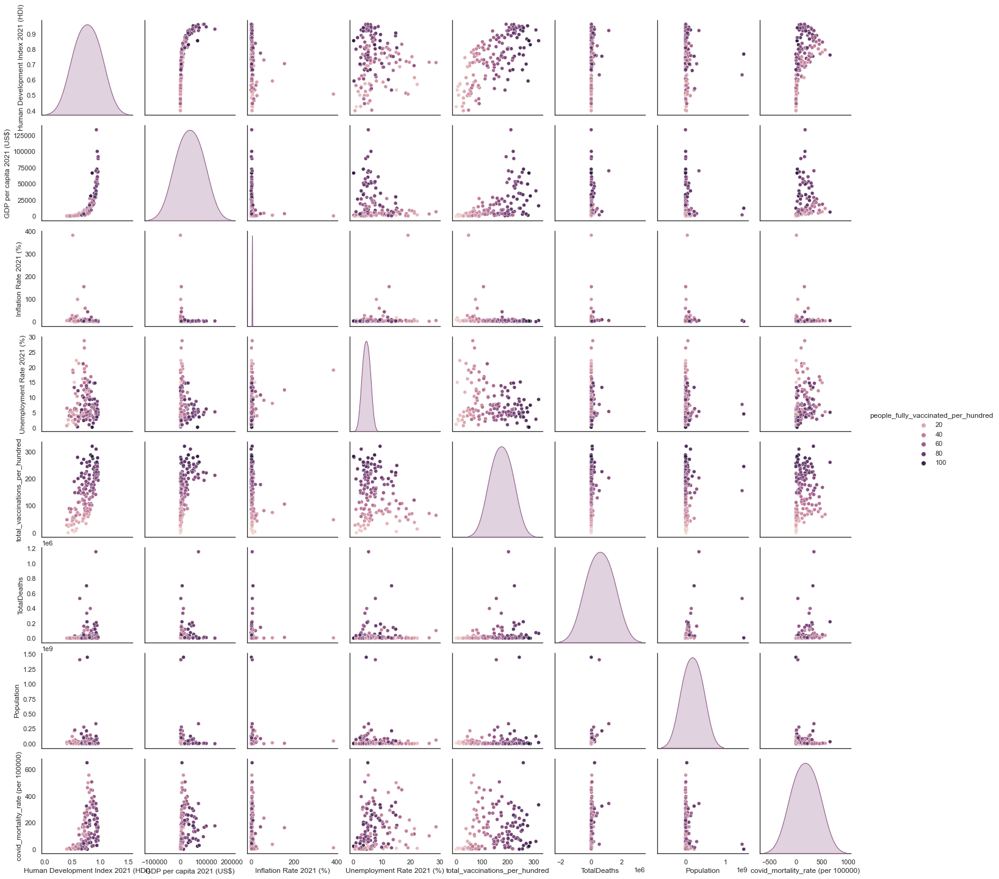

In [98]:
sns.set(
    style="white", 
    palette="muted", 
    color_codes=True
)
sns.pairplot(
    covidvisual[[
        'Human Development Index 2021 (HDI)', 'GDP per capita 2021 (US$)',
       'Region', 'Inflation Rate 2021 (%)','Unemployment Rate 2021 (%)', 'total_vaccinations_per_hundred', 'people_fully_vaccinated_per_hundred',
       'TotalCases','TotalDeaths','Population','Continent', 'covid_mortality_rate (per 100000)'
    ]].dropna(), 
    hue='people_fully_vaccinated_per_hundred'
)

### 5.3 Maps with Shapefiles

#### 5.3.1 From latitude and longitude finding a point to plot over the shapefile

In [99]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Point, Polygon

In [100]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [101]:
covidvisual

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546
3,Armenia,ARM,40.0,45.0,85,0.759,72.0431,13.116760,11.330300,13157.993900,1.386141e+10,4966.513471,5.700000,7.184836,12.729,Europe & Central Asia,Upper middle income,2153341,2023-03-05,1130844,986762,NaN,17910,77.45,40.67,35.49,6441,Armenia,"448,151",NaN,8739,NaN,"435,162",NaN,"4,250",NaN,"3,242,901",2971966,Asia,NaN,NaN,"1,430",294.047778
4,Australia,AUS,-27.0,133.0,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,19856,NaN,"11,264,265",NaN,"43,652",33,"78,835,048",26068792,Australia/Oceania,NaN,NaN,"1,674",76.167703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,Uzbekistan,UZB,41.0,64.0,101,0.727,70.8616,12.477140,11.895590,7916.785725,6.923890e+10,1983.064723,7.420110,10.849240,6.017,Europe & Central Asia,Lower middle income,75503399,2023-03-05,21684856,18144247,720866.0,426314,218.04,62.62,52.40,12311,Uzbekistan,"251,839",NaN,1637,NaN,"241,486",NaN,"8,716",23,"1,377,915",34382084,Asia,NaN,NaN,254,4.761201
145,Vanuatu,VUT,-16.0,167.0,140,0.607,70.4490,11.535315,7.064846,3085.411633,9.563327e+08,2996.621062,0.449256,2.343284,2.118,East Asia & Pacific,Lower middle income,366638,2023-02-20,176624,162250,NaN,8843,112.21,54.06,49.66,27064,Vanuatu,"12,014",NaN,14,NaN,"11,976",NaN,24,NaN,"24,976",321832,Australia/Oceania,NaN,NaN,75,4.350096
146,Viet Nam,VNM,16.0,106.0,115,0.703,73.6181,12.951932,8.370280,7867.371345,3.661376e+11,3756.489121,2.561551,1.834716,2.380,East Asia & Pacific,Lower middle income,266477589,2023-03-09,90497674,86002617,2091069.0,1675471,271.40,92.17,87.59,17064,Vietnam,"11,527,454",+51,43186,NaN,"10,615,014",+23,"869,254",7,"85,826,548",98953541,Asia,0.5,NaN,"8,784",43.642703
147,Zambia,ZMB,-15.0,30.0,154,0.565,61.2234,10.928760,7.187091,3217.767739,2.214763e+10,1137.343633,4.598734,22.021234,6.220,Sub-Saharan Africa,Low income,12792112,2023-03-15,11158619,8747040,224617.0,180289,63.90

In [102]:
covidvisual.shape

(149, 43)

In [103]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546


In [104]:
covidvisual['Country'].tolist()

['Albania',
 'Algeria',
 'Angola',
 'Armenia',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas',
 'Bahrain',
 'Bangladesh',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bhutan',
 'Bolivia',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei Darussalam',
 'Bulgaria',
 'Burkina Faso',
 'Burundi',
 'Cambodia',
 'Cameroon',
 'Canada',
 'Cape Verde',
 'Central African Republic',
 'Chile',
 'China',
 'Colombia',
 'Congo',
 'Costa Rica',
 "Côte d'Ivoire",
 'Croatia',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Dominican Republic',
 'Ecuador',
 'Egypt',
 'El Salvador',
 'Estonia',
 'Ethiopia',
 'Fiji',
 'Finland',
 'France',
 'Gambia',
 'Georgia',
 'Germany',
 'Ghana',
 'Greece',
 'Guatemala',
 'Guinea',
 'Guinea-Bissau',
 'Guyana',
 'Haiti',
 'Honduras',
 'Hong Kong',
 'Hungary',
 'Iceland',
 'India',
 'Indonesia',
 'Iran',
 'Iraq',
 'Ireland',
 'Israel',
 'Italy',
 'Jamaica',
 'Japan',
 'Jordan',
 'Kenya',
 'South Korea',
 'Kyrgyzstan',
 'Laos',
 'Latvia',
 'Lebanon',
 'Lesotho

In [105]:
#'naturalearth_lowres' is a shapefile dataset from geopandas
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
world.head(3)

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."


<AxesSubplot:>

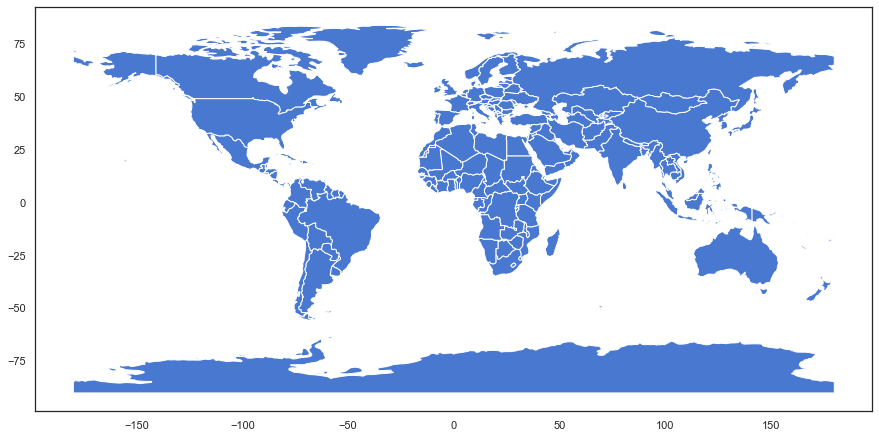

In [106]:
fig, ax = plt.subplots(figsize = (15,15))
world.plot(ax=ax)

In [107]:
crs = {'init':'epsg:4326'}
geometry = [Point(xy) for xy in zip(covidvisual['Longitude'], covidvisual['Latitude'])]
geometry[:5]

In [108]:
geodataframe = gpd.GeoDataFrame(covidvisual, crs = crs, geometry = geometry)
geodataframe.head()

C:\Users\andre\anaconda3\lib\site-packages\pyproj\crs\crs.py:68: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6



,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),geometry
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992,POINT (20.00000 41.00000)
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049,POINT (3.00000 28.00000)
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546,POINT (18.50000 -12.50000)
3,Armenia,ARM,40.0,45.0,85,0.759,72.0431,13.116760,11.330300,13157.993900,1.386141e+10,4966.513471,5.700000,7.184836,12.729,Europe & Central Asia,Upper middle income,2153341,2023-03-05,1130844,986762,NaN,17910,77.45,40.67,35.49,6441,Armenia,"448,151",NaN,8739,NaN,"435,162",NaN,"4,250",NaN,"3,242,901",2971966,Asia,NaN,NaN,"1,430",294.047778,POINT (45.00000 40.00000)
4,Australia,AUS,-27.0,133.0,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,19856,NaN,"11,264,265",NaN,"43,652",33,"78,835,048",26068792,Australia/Oceania,NaN,NaN,"1,674",76.167703,POINT (133.00000 -27.00000)


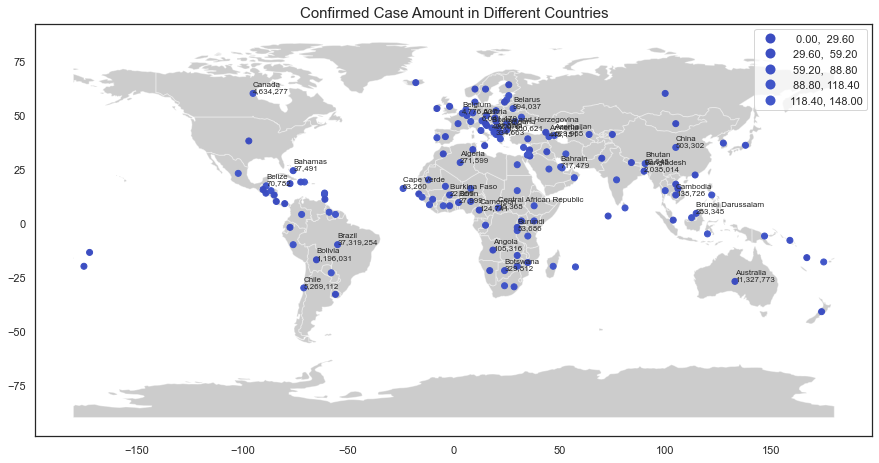

In [109]:
#plot confirmed cases world map 
#plotting the points from latitude and longitude over a shapefile
fig, ax = plt.subplots(figsize = (15,15))
world.plot(ax=ax, alpha = 0.4, color = 'grey')
geodataframe.plot(ax = ax, column='TotalCases', scheme="quantiles",
           figsize=(25, 20),
           legend=True,cmap='coolwarm')
plt.title('Confirmed Case Amount in Different Countries',fontsize=15)
# add countries names and numbers 
for i in range(0,30):
    plt.text(float(geodataframe.Longitude[i]),float(geodataframe.Latitude[i]),"{}\n{}".format(geodataframe.Country[i],geodataframe.TotalCases[i]),size=8)
plt.show()

### 5.3.2 Merging the shapefile with the data, not plotting the point over it

In [110]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [111]:
covidvisual.shape

(149, 43)

In [112]:
covidvisual['Country'].tolist()

['Albania',
 'Algeria',
 'Angola',
 'Armenia',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas',
 'Bahrain',
 'Bangladesh',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bhutan',
 'Bolivia',
 'Bosnia and Herzegovina',
 'Botswana',
 'Brazil',
 'Brunei Darussalam',
 'Bulgaria',
 'Burkina Faso',
 'Burundi',
 'Cambodia',
 'Cameroon',
 'Canada',
 'Cape Verde',
 'Central African Republic',
 'Chile',
 'China',
 'Colombia',
 'Congo',
 'Costa Rica',
 "Côte d'Ivoire",
 'Croatia',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Dominican Republic',
 'Ecuador',
 'Egypt',
 'El Salvador',
 'Estonia',
 'Ethiopia',
 'Fiji',
 'Finland',
 'France',
 'Gambia',
 'Georgia',
 'Germany',
 'Ghana',
 'Greece',
 'Guatemala',
 'Guinea',
 'Guinea-Bissau',
 'Guyana',
 'Haiti',
 'Honduras',
 'Hong Kong',
 'Hungary',
 'Iceland',
 'India',
 'Indonesia',
 'Iran',
 'Iraq',
 'Ireland',
 'Israel',
 'Italy',
 'Jamaica',
 'Japan',
 'Jordan',
 'Kenya',
 'South Korea',
 'Kyrgyzstan',
 'Laos',
 'Latvia',
 'Lebanon',
 'Lesotho

In [113]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546


In [114]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

In [115]:
world.head()

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.0,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.0,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


In [116]:
world.drop(['pop_est', 'continent', 'gdp_md_est'], axis = 1, inplace = True)

In [117]:
world.rename({'iso_a3':'Country Code'}, axis = 1, inplace = True)

In [118]:
world.head(3)

,name,Country Code,geometry
0,Fiji,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,Tanzania,TZA,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,W. Sahara,ESH,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."


In [119]:
worldmerge = world.merge(covidvisual, how = 'inner', on ='Country Code', indicator = True)

In [120]:
worldmerge.head(3)

,name,Country Code,geometry,Country,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),_merge
0,Fiji,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,-18.0,175.0,99,0.730,67.1140,14.736790,10.921548,9980.110866,4.296305e+09,4646.612723,-5.111607,0.155856,4.929,East Asia & Pacific,Upper middle income,1555078,2023-04-03,712010,641174,28295.0,17149,167.25,76.58,68.96,18444,Fiji,"68,914",NaN,883,NaN,"67,014",NaN,"1,017",NaN,"669,911",909466,Australia/Oceania,NaN,NaN,"1,118",97.089941,both
1,Tanzania,TZA,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982...",Tanzania,-6.0,35.0,160,0.549,66.2007,9.221490,6.372899,2664.329096,6.784105e+10,1099.287598,4.279085,3.690920,2.740,Sub-Saharan Africa,Lower middle income,39392419,2023-03-12,34434933,32165791,NaN,263699,60.14,52.57,49.11,4026,Tanzania,"42,942",NaN,846,NaN,NaN,NaN,NaN,7,NaN,63298550,Africa,NaN,NaN,662,1.336524,both
2,Canada,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,60.0,-95.0,15,0.936,82.6565,16.396259,13.834427,46807.986190,1.988336e+12,51987.939053,4.540887,3.395193,7.460,North America,High income,96956502,2023-02-02,34763194,31762130,879740.0,545858,252.13,90.40,82.60,14195,Canada,"4,634,277",NaN,52121,NaN,"4,549,731",NaN,"32,425",99,"66,343,123",38388419,North America,NaN,NaN,845,135.772718,both


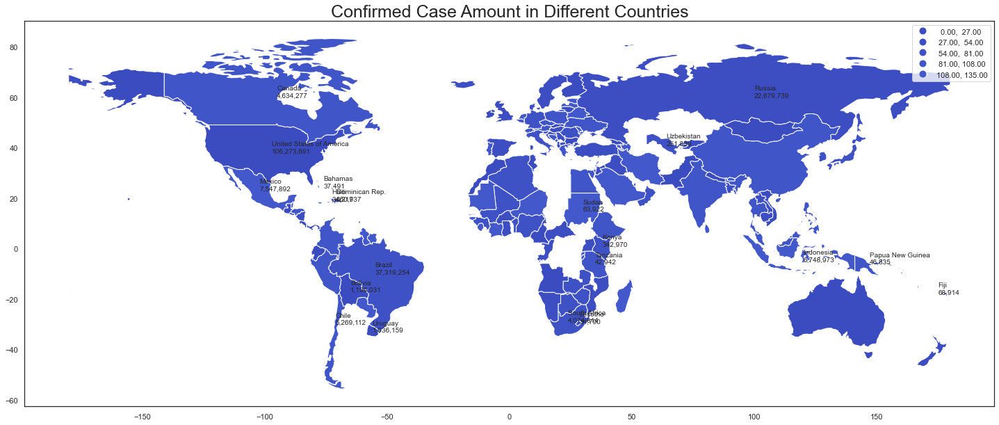

In [121]:
worldmerge.plot(column='TotalCases', scheme="quantiles",
           figsize=(25, 20),
           legend=True,cmap='coolwarm')
plt.title('Confirmed Case Amount in Different Countries',fontsize=25)
for i in range(0,20):
    plt.text(float(worldmerge.Longitude[i]),float(worldmerge.Latitude[i]),"{}\n{}".format(worldmerge.name[i],worldmerge.TotalCases[i]),size=10)
plt.show()

### 5.4 More Maps, Bubble Chart and Boxplot with Plotly

In [122]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

In [123]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [124]:
covidvisual.isna().sum()

Country                                     0
Country Code                                0
Latitude                                    0
Longitude                                   0
HDI rank                                    0
Human Development Index 2021 (HDI)          0
Life expectancy at birth                    0
Expected years of schooling                 0
Mean years of schooling                     0
Gross national income (GNI) per capita      0
GDP 2021 (US$)                              0
GDP per capita 2021 (US$)                   0
GDP growth 2021 (annual %)                  0
Inflation Rate 2021 (%)                     0
Unemployment Rate 2021 (%)                  0
Region                                      0
IncomeGroup                                 0
total_vaccinations                          0
date                                        0
people_vaccinated                           0
people_fully_vaccinated                     0
daily_vaccinations_raw            

In [125]:
covidvisual.shape

(149, 43)

In [126]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546


In [127]:
fig = px.scatter_geo(covidvisual, locations='Country Code', color='Continent',title = 'Total Deaths per Country',
               hover_name='Country', size='TotalDeaths')
fig.update_layout(
    title={
        'text':'Total Deaths per Country and Continent',
        'y':0.85,
        'x':0.47,
        'xanchor': 'center',
        'yanchor': 'top'})

In [128]:
fig = px.scatter_geo(covidvisual,
                    lat=covidvisual.Latitude,
                    lon=covidvisual.Longitude,
                    hover_name='Country')
fig.update_layout(
    title={
        'text':'Countries Coordinates',
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})

In [129]:
fig = px.choropleth(covidvisual, locations='Country Code',
                    color='covid_mortality_rate (per 100000)',
                    hover_name='Country',
                    color_continuous_scale=px.colors.sequential.Plasma,
                   labels={'covid_mortality_rate (per 100000)': 'COVID Mortality Rate (per 100,000)'})
fig.update_layout(
    title={
        'text':'Covid Death Rate by Country',
        'y':0.88,
        'x':0.44,
        'xanchor': 'center',
        'yanchor': 'top'})

In [130]:
fig = go.Figure(data=go.Choropleth(
    locations = covidvisual['Country Code'],
    z = covidvisual['people_fully_vaccinated_per_hundred'],
    text = covidvisual['Country'],
    colorscale = 'Blues',
    autocolorscale=False,
    reversescale=True,
    marker_line_color='darkgray',
    marker_line_width=0.5,
    #colorbar_tickprefix = '$',
    colorbar_title = '%',
    
))

fig.update_layout(
    title={'text':'People Fully Vaccinated by Country','y':0.89,'x':0.5,'xanchor': 'center','yanchor': 'top'},
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type='equirectangular'
    ),
    annotations = [dict(
        x=0.5,
        y=0.1,
        xref='paper',
        yref='paper',
        text='World Map',
        
        showarrow = False
    )]
)

fig.show()

In [131]:
fig = px.scatter(covidvisual, x='Human Development Index 2021 (HDI)', y='people_fully_vaccinated_per_hundred', size='TotalDeaths', color='Continent',
           hover_name='Country', log_x=True, size_max=60)
fig.update_layout(
    title={
        'text':'Fully Vaccinated People (per 100) vs HDI by Continent and Total Deaths',
        'y':0.95,
        'x':0.44,
        'xanchor': 'center',
        'yanchor': 'top'},
    yaxis_title='People Fully Vaccinated (per 100)')

In [132]:
fig = px.box(covidvisual, y='covid_mortality_rate (per 100000)', color = 'IncomeGroup', title = 'Covid Death Rate by Income Group',
labels={'IncomeGroup': 'Income Group'})
fig.update_layout(
    title={
        'text': 'Covid Death Rate per Continent',
        'y':0.88,
        'x':0.44,
        'xanchor': 'center',
        'yanchor': 'top'},
    yaxis_title='Covid Mortality Rate (per 100,000)',
xaxis_title='Income Group')

In [133]:
fig = px.box(covidvisual, y='covid_mortality_rate (per 100000)', color = 'Continent')
fig.update_layout(
    title={
        'text': 'Covid Death Rate per Continent',
        'y':0.95,
        'x':0.44,
        'xanchor': 'center',
        'yanchor': 'top'}, font_family='Arial',font_color='blue', title_font_family='Times New Roman',title_font_color='black',
    legend_title_font_color='green',  font=dict(family='Courier New, monospace',size=15,color='RebeccaPurple'
    ),
    yaxis_title='Covid Mortality Rate (per 100,000)',
xaxis_title='Continent')

In [1]:
import pandas as pd

In [2]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [3]:
covidvisual

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,...,NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,...,NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,...,NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546
3,Armenia,ARM,40.0,45.0,85,0.759,72.0431,13.116760,11.330300,13157.993900,...,NaN,"4,250",NaN,"3,242,901",2971966,Asia,NaN,NaN,"1,430",294.047778
4,Australia,AUS,-27.0,133.0,5,0.951,84.5265,21.054590,12.726820,49238.433350,...,NaN,"43,652",33,"78,835,048",26068792,Australia/Oceania,NaN,NaN,"1,674",76.167703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,Uzbekistan,UZB,41.0,64.0,101,0.727,70.8616,12.477140,11.895590,7916.785725,...,NaN,"8,716",23,"1,377,915",34382084,Asia,NaN,NaN,254,4.761201
145,Vanuatu,VUT,-16.0,167.0,140,0.607,70.4490,11.535315,7.064846,3085.411633,...,NaN,24,NaN,"24,976",321832,Australia/Oceania,NaN,NaN,75,4.350096
146,Viet Nam,VNM,16.0,106.0,115,0.703,73.6181,12.951932,8.370280,7867.371345,...,+23,"869,254",7,"85,826,548",98953541,Asia,0.5,NaN,"8,784",43.642703
147,Zambia,ZMB,-15.0,30.0,154,0.565,61.2234,10.928760,7.187091,3217.767739,...,NaN,122,NaN,"3,994,061",19470234,Africa,NaN,NaN,6,20.842071


In [4]:
covidvisual.shape

(149, 43)

In [5]:
covidvisual.columns

Index(['Country', 'Country Code', 'Latitude', 'Longitude', 'HDI rank',
       'Human Development Index 2021 (HDI)', 'Life expectancy at birth',
       'Expected years of schooling', 'Mean years of schooling',
       'Gross national income (GNI) per capita', 'GDP 2021 (US$)',
       'GDP per capita 2021 (US$)', 'GDP growth 2021 (annual %)',
       'Inflation Rate 2021 (%)', 'Unemployment Rate 2021 (%)', 'Region',
       'IncomeGroup', 'total_vaccinations', 'date', 'people_vaccinated',
       'people_fully_vaccinated', 'daily_vaccinations_raw',
       'daily_vaccinations', 'total_vaccinations_per_hundred',
       'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'Country,Other', 'TotalCases',
       'NewCases', 'TotalDeaths', 'NewDeaths', 'TotalRecovered',
       'NewRecovered', 'ActiveCases', 'Serious,Critical', 'TotalTests',
       'Population', 'Continent', 'New Cases/1M pop', 'New Deaths/1M pop',
       'Active Cases/1M p

In [6]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [7]:
covidvisual

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0000,20.0000,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683000,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0000,3.0000,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747000,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.10,NaN,"1,804",15.173049
2,Angola,AGO,-12.5000,18.5000,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384000,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546
3,Armenia,ARM,40.0000,45.0000,85,0.759,72.0431,13.116760,11.330300,13157.993900,1.386141e+10,4966.513471,5.700000,7.184836,12.729000,Europe & Central Asia,Upper middle income,2153341,2023-03-05,1130844,986762,NaN,17910,77.45,40.67,35.49,6441,Armenia,"448,151",NaN,8739,NaN,"435,162",NaN,"4,250",NaN,"3,242,901",2971966,Asia,NaN,NaN,"1,430",294.047778
4,Australia,AUS,-27.0000,133.0000,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120000,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,19856,NaN,"11,264,265",NaN,"43,652",33,"78,835,048",26068792,Australia/Oceania,NaN,NaN,"1,674",76.167703
5,Austria,AUT,47.3333,13.3333,25,0.916,81.5797,16.007959,12.256690,53618.671380,4.803684e+11,53637.705711,4.556851,2.766667,6.180000,Europe & Central Asia,High income,20447637,2023-03-17,6899073,6682331,NaN,113665,228.73,77.17,74.75,12715,Austria,"6,041,470","+1,751",22157,NaN,"5,998,735","+2,365","20,578",55,"211,273,524",9066710,Europe,193.00,NaN,"2,270",244.377508
6,Azerbaijan,AZE,40.5000,47.5000,91,0.745,69.3658,13.496890,10.542970,14256.744560,5.462218e+10,5387.997975,5.600037,6.650299,5.950000,Europe & Central Asia,Upper middle income,13857111,2022-08-28,5373253,4862494,116709.0,85991,133.78,51.88,46.94,8302,Azerbaijan,"829,955",NaN,10189,NaN,"819,310",NaN,456,NaN,"7,562,699",10300205,Asia,NaN,NaN,44,98.920361
7,Bahamas,BHS,24.2500,-76.0000,55,0.812,71.5983,12.899450,12.641924,30486.184290,1.120860e+10,27478.389629,13.719735,2.904913,11.665000,Latin America & Caribbean,High income,364701,2022-11-16,174147,165633,6771.0,3473,88.95,42.48,40.40,8471,Bahamas,"37,491",NaN,833,NaN,"36,366",NaN,292,1,"257,839",400516,North America,NaN,NaN,729,207.981704
8,Bahrain,BHR,26.0000,50.5500,35,0.875,78.7605,16.297560,11.046590,39497.247880,3.886866e+10,26562.969135,2.225351,-0.606319,1.532000,Middle East & North Africa,High income,3476633,2022-12-21,1241174,1226796,81811.0,22003,236.15,84.31,83.33,14945,Bahrain,"717,479",+143,1559,NaN,"715,123",+95,797,2,"10,799,671",1783983,Asia,80.0

In [8]:
import plotly.express as px

In [9]:
fig = px.scatter(covidvisual, x='Human Development Index 2021 (HDI)', y='people_fully_vaccinated_per_hundred', color='Continent', trendline='ols')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinanted (per 100) vs HDI by Continent OLS ',
        'y':0.95,
        'x':0.44,
        'xanchor': 'center',
        'yanchor': 'top'},
yaxis_title='People Fully Vaccinanted (per 100)')
fig.show()

results = px.get_trendline_results(fig)
print(results)

results.px_fit_results.iloc[0].summary()

           Continent                                     px_fit_results
0             Europe  <statsmodels.regression.linear_model.Regressio...
1             Africa  <statsmodels.regression.linear_model.Regressio...
2               Asia  <statsmodels.regression.linear_model.Regressio...
3  Australia/Oceania  <statsmodels.regression.linear_model.Regressio...
4      North America  <statsmodels.regression.linear_model.Regressio...
5      South America  <statsmodels.regression.linear_model.Regressio...


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.675
Model:                            OLS   Adj. R-squared:                  0.666
Method:                 Least Squares   F-statistic:                     76.89
Date:                Sun, 16 Apr 2023   Prob (F-statistic):           1.45e-10
Time:                        12:13:32   Log-Likelihood:                -143.28
No. Observations:                  39   AIC:                             290.6
Df Residuals:                      37   BIC:                             293.9
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       -136.1971     22.864     -5.957      0.000    -182.524     -89.870
x1           227.6928     25.966      8.769      0.000     175.080     280.305
==============================================================================
Omnibus:                        2.865   Durbin-Watson:                   1.697
Prob(Omnibus):                  0.239   Jarque-Bera (JB):                2.143
Skew:                           0.573   Prob(JB):                        0.343
Kurtosis:                       3.077   Cond. No.                         29.4
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [10]:
fig = px.scatter(covidvisual, x='Human Development Index 2021 (HDI)', y='people_fully_vaccinated_per_hundred', trendline='ols', hover_name='Country')
fig.update_layout(
    title={
        'text': 'People Fully Vaccinated (per 100) vs HDI OLS',
        'y':0.94,
        'x':0.47,
        'xanchor': 'center',
        'yanchor': 'top'},
yaxis_title='People Fully Vaccinanted (per 100)')
fig.show()

results = px.get_trendline_results(fig)
print(results)

results.px_fit_results.iloc[0].summary()

                                      px_fit_results
0  <statsmodels.regression.linear_model.Regressio...


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.412
Model:                            OLS   Adj. R-squared:                  0.408
Method:                 Least Squares   F-statistic:                     102.9
Date:                Sun, 16 Apr 2023   Prob (F-statistic):           1.17e-18
Time:                        12:13:32   Log-Likelihood:                -644.94
No. Observations:                 149   AIC:                             1294.
Df Residuals:                     147   BIC:                             1300.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -20.5314      7.709     -2.663      0.009     -35.765      -5.297
x1           103.8960     10.243     10.143      0.000      83.654     124.138
==============================================================================
Omnibus:                        2.112   Durbin-Watson:                   2.028
Prob(Omnibus):                  0.348   Jarque-Bera (JB):                1.883
Skew:                           0.166   Prob(JB):                        0.390
Kurtosis:                       2.561   Cond. No.                         10.5
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [11]:
fig = px.scatter(covidvisual, x='Human Development Index 2021 (HDI)', y='covid_mortality_rate (per 100000)', trendline='ols', hover_name='Country')
fig.update_layout(
    title={
        'text': 'Covid Death Rate (per 100000) vs HDI OLS',
        'y':0.94,
        'x':0.48,
        'xanchor': 'center',
        'yanchor': 'top'},
yaxis_title='Covid Mortality Rate (per 100,000)')
fig.show()

results = px.get_trendline_results(fig)
print(results)

results.px_fit_results.iloc[0].summary()

                                      px_fit_results
0  <statsmodels.regression.linear_model.Regressio...


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.294
Model:                            OLS   Adj. R-squared:                  0.290
Method:                 Least Squares   F-statistic:                     61.34
Date:                Sun, 16 Apr 2023   Prob (F-statistic):           8.79e-13
Time:                        12:13:32   Log-Likelihood:                -921.68
No. Observations:                 149   AIC:                             1847.
Df Residuals:                     147   BIC:                             1853.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       -238.5981     49.383     -4.832      0.000    -336.191    -141.005
x1           513.9306     65.618      7.832      0.000     384.254     643.607
==============================================================================
Omnibus:                       39.140   Durbin-Watson:                   1.999
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               71.441
Skew:                           1.223   Prob(JB):                     3.07e-16
Kurtosis:                       5.351   Cond. No.                         10.5
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [12]:
fig = px.scatter(covidvisual, x='people_fully_vaccinated_per_hundred', y='covid_mortality_rate (per 100000)', trendline='ols', hover_name='Country')
fig.update_layout(
    title={
        'text': 'Covid Death Rate vs People Fully Vaccinated (per 100) OLS',
        'y':0.95,
        'x':0.48,
        'xanchor': 'center',
        'yanchor': 'top'},
yaxis_title='Covid Mortality Rate (per 100,000)')
fig.show()

results = px.get_trendline_results(fig)
print(results)

results.px_fit_results.iloc[0].summary()

                                      px_fit_results
0  <statsmodels.regression.linear_model.Regressio...


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.028
Model:                            OLS   Adj. R-squared:                  0.021
Method:                 Least Squares   F-statistic:                     4.182
Date:                Sun, 16 Apr 2023   Prob (F-statistic):             0.0426
Time:                        12:13:33   Log-Likelihood:                -945.57
No. Observations:                 149   AIC:                             1895.
Df Residuals:                     147   BIC:                             1901.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         86.0345     29.031      2.964      0.004      28.663     143.406
x1             0.9729      0.476      2.045      0.043       0.033       1.913
==============================================================================
Omnibus:                       30.693   Durbin-Watson:                   1.871
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               41.906
Skew:                           1.196   Prob(JB):                     7.95e-10
Kurtosis:                       4.013   Cond. No.                         156.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [13]:
import numpy as np 
import matplotlib.pyplot as plt
import itertools
import seaborn as sns

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

C:\Users\andre\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

C:\Users\andre\anaconda3\lib\site-pac

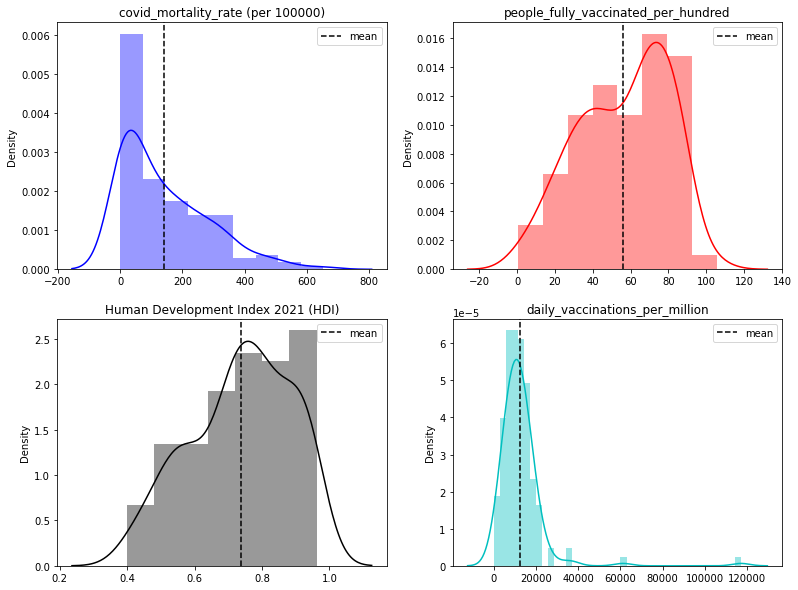

In [14]:
cols  = ['covid_mortality_rate (per 100000)','people_fully_vaccinated_per_hundred','Human Development Index 2021 (HDI)','daily_vaccinations_per_million']
length = len(cols)
c = ['b','r','k','c']
plt.figure(figsize=(13,10))

for i,j,k in itertools.zip_longest(cols,range(length),c):
    plt.subplot(2,2,j+1)
    sns.distplot(covidvisual[i],color=k)
    plt.axvline(covidvisual[i].mean(),color = 'k',linestyle = 'dashed',label='mean')
    plt.legend(loc='best')
    plt.title(i)
    plt.xlabel('')

plt.show()

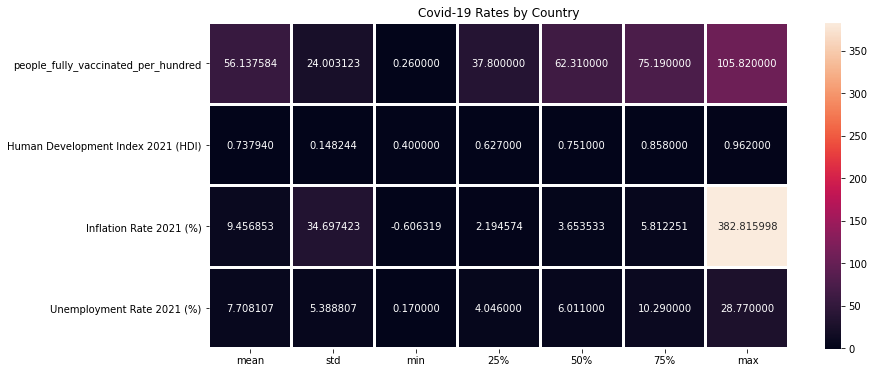

In [15]:
plt.figure(figsize=(13,6))
sns.heatmap(covidvisual[['people_fully_vaccinated_per_hundred', 'Human Development Index 2021 (HDI)','Inflation Rate 2021 (%)','Unemployment Rate 2021 (%)']].describe()[1:].transpose(),annot=True,fmt='f',linecolor='white',linewidths=2) # fmt: String formatting code to use when adding annotations
plt.title('Covid-19 Rates by Country')
plt.show()

Text(0.5, 1.0, 'Correlation Heatmap')

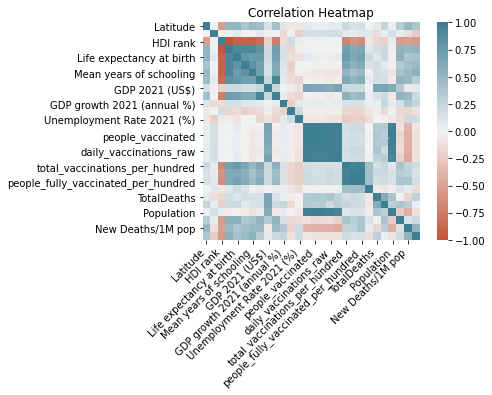

In [16]:
corr = covidvisual.corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);
plt.title('Correlation Heatmap')

In [17]:
fig = px.imshow(covidvisual.corr())
fig.update_layout(
    title={
        'text': 'Correlation Heatmap',
        'y':0.92,
        'x':0.48,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [18]:
import string
letters = string.ascii_uppercase[0:15]
covidvisual.corr()

,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,TotalDeaths,NewDeaths,Population,New Cases/1M pop,New Deaths/1M pop,covid_mortality_rate (per 100000)
Latitude,1.000000,0.015643,-0.534801,0.521362,0.515632,0.392072,0.488527,0.467022,0.145600,0.427024,0.106603,-0.048160,-0.070043,0.055496,0.043982,0.046558,0.052551,0.054092,0.208008,0.118250,0.161836,0.003837,0.085477,0.251346,0.032880,0.312686,0.494674,0.379312
Longitude,0.015643,1.000000,-0.027185,0.018920,0.073668,0.010802,-0.011674,0.073803,-0.008260,0.020799,-0.163787,0.009595,-0.223733,0.148779,0.147727,0.150458,0.156776,0.160624,0.073822,0.056991,0.088911,0.099391,-0.131760,0.040516,0.150644,0.049746,-0.130588,-0.235525
HDI rank,-0.534801,-0.027185,1.000000,-0.992610,-0.902727,-0.905268,-0.911776,-0.859371,-0.200472,-0.748611,-0.143421,0.182198,0.058715,-0.013923,0.011882,0.008014,0.022868,0.010625,-0.683806,-0.579042,-0.631873,-0.072318,-0.168479,-0.197041,0.047432,-0.543327,-0.518377,-0.545067
Human Development Index 2021 (HDI),0.521362,0.018920,-0.992610,1.000000,0.908595,0.909026,0.923084,0.831303,0.198806,0.721383,0.155804,-0.179181,-0.025236,0.021985,-0.003301,0.000070,-0.012444,-0.002411,0.693087,0.594456,0.641664,0.100184,0.173805,0.197814,-0.039208,0.542755,0.507771,0.542615
Life expectancy at birth,0.515632,0.073668,-0.902727,0.908595,1.000000,0.803481,0.746036,0.766371,0.191478,0.692378,0.162787,-0.136049,-0.099486,0.063354,0.032516,0.038862,0.034791,0.053921,0.746875,0.629264,0.681745,0.194643,0.105221,0.218246,-0.012393,0.562738,0.375853,0.406437
Expected years of schooling,0.392072,0.010802,-0.905268,0.909026,0.803481,1.000000,0.809316,0.714985,0.157988,0.635060,0.115806,-0.224174,-0.009111,0.012211,-0.010184,-0.007442,-0.008245,-0.008070,0.655973,0.562637,0.601093,0.122095,0.172266,0.081250,-0.043640,0.366154,0.435602,0.484350
Mean years of schooling,0.488527,-0.011674,-0.911776,0.923084,0.746036,0.809316,1.000000,0.705648,0.156418,0.609402,0.089544,-0.166140,0.020964,-0.044295,-0.064302,-0.062497,-0.085884,-0.074341,0.510587,0.427467,0.471275,-0.014693,0.159496,0.118753,-0.090237,0.419768,0.482949,0.574269
Gross national income (GNI) per capita,0.467022,0.073803,-0.859371,0.831303,0.766371,0.714985,0.705648,1.000000,0.229697,0.931802,0.074249,-0.141891,-0.178262,-0.013743,-0.033224,-0.031115,-0.055625,-0.035498,0.631173,0.536190,0.588238,0.047685,0.155172,0.150098,-0.058811,0.532931,0.500054,0.317555
GDP 2021 (US$),0.145600,-0.008260,-0.200472,0.198806,0.191478,0.157988,0.156418,0.229697,1.000000,0.231666,0.021489,-0.042033,-0.091963,0.666158,0.632690,0.629485,0.604294,0.664951,0.218036,0.210728,0.200272,-0.003177,0.653730,0.661145,0.595821,0.331409,-0.058806,0.074972
GDP per capita 2021 (US$),0.427024,0.020799,-0.748611,0.721383,0.692378,0.635060,0.609402,0.931802,0.231666,1.000000,0.047378,-0.123770,-0.187185,-0.014447,-0.031596,-0.030011,-0.052096,-0.033182,0.547979,0.450311,0.493026,0.045143,0.130999,0.196837,-0.054010,0.532630,0.484351,0.207534


In [19]:
corr = covidvisual.corr()

In [20]:
corr.style.background_gradient(cmap='coolwarm')

,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,TotalDeaths,NewDeaths,Population,New Cases/1M pop,New Deaths/1M pop,covid_mortality_rate (per 100000)
Latitude,1.000000,0.015643,-0.534801,0.521362,0.515632,0.392072,0.488527,0.467022,0.145600,0.427024,0.106603,-0.048160,-0.070043,0.055496,0.043982,0.046558,0.052551,0.054092,0.208008,0.118250,0.161836,0.003837,0.085477,0.251346,0.032880,0.312686,0.494674,0.379312
Longitude,0.015643,1.000000,-0.027185,0.018920,0.073668,0.010802,-0.011674,0.073803,-0.008260,0.020799,-0.163787,0.009595,-0.223733,0.148779,0.147727,0.150458,0.156776,0.160624,0.073822,0.056991,0.088911,0.099391,-0.131760,0.040516,0.150644,0.049746,-0.130588,-0.235525
HDI rank,-0.534801,-0.027185,1.000000,-0.992610,-0.902727,-0.905268,-0.911776,-0.859371,-0.200472,-0.748611,-0.143421,0.182198,0.058715,-0.013923,0.011882,0.008014,0.022868,0.010625,-0.683806,-0.579042,-0.631873,-0.072318,-0.168479,-0.197041,0.047432,-0.543327,-0.518377,-0.545067
Human Development Index 2021 (HDI),0.521362,0.018920,-0.992610,1.000000,0.908595,0.909026,0.923084,0.831303,0.198806,0.721383,0.155804,-0.179181,-0.025236,0.021985,-0.003301,0.000070,-0.012444,-0.002411,0.693087,0.594456,0.641664,0.100184,0.173805,0.197814,-0.039208,0.542755,0.507771,0.542615
Life expectancy at birth,0.515632,0.073668,-0.902727,0.908595,1.000000,0.803481,0.746036,0.766371,0.191478,0.692378,0.162787,-0.136049,-0.099486,0.063354,0.032516,0.038862,0.034791,0.053921,0.746875,0.629264,0.681745,0.194643,0.105221,0.218246,-0.012393,0.562738,0.375853,0.406437
Expected years of schooling,0.392072,0.010802,-0.905268,0.909026,0.803481,1.000000,0.809316,0.714985,0.157988,0.635060,0.115806,-0.224174,-0.009111,0.012211,-0.010184,-0.007442,-0.008245,-0.008070,0.655973,0.562637,0.601093,0.122095,0.172266,0.081250,-0.043640,0.366154,0.435602,0.484350
Mean years of schooling,0.488527,-0.011674,-0.911776,0.923084,0.746036,0.809316,1.000000,0.705648,0.156418,0.609402,0.089544,-0.166140,0.020964,-0.044295,-0.064302,-0.062497,-0.085884,-0.074341,0.510587,0.427467,0.471275,-0.014693,0.159496,0.118753,-0.090237,0.419768,0.482949,0.574269
Gross national income (GNI) per capita,0.467022,0.073803,-0.859371,0.831303,0.766371,0.714985,0.705648,1.000000,0.229697,0.931802,0.074249,-0.141891,-0.178262,-0.013743,-0.033224,-0.031115,-0.055625,-0.035498,0.631173,0.536190,0.588238,0.047685,0.155172,0.150098,-0.058811,0.532931,0.500054,0.317555
GDP 2021 (US$),0.145600,-0.008260,-0.200472,0.198806,0.191478,0.157988,0.156418,0.229697,1.000000,0.231666,0.021489,-0.042033,-0.091963,0.666158,0.632690,0.629485,0.604294,0.664951,0.218036,0.210728,0.200272,-0.003177,0.653730,0.661145,0.595821,0.331409,-0.058806,0.074972
GDP per capita 2021 (US$),0.427024,0.020799,-0.748611,0.721383,0.692378,0.635060,0.609402,0.931802,0.231666,1.000000,0.047378,-0.123770,-0.187185,-0.014447,-0.031596,-0.030011,-0.052096,-0.033182,0.547979,0.450311,0.493026,0.045143,0.130999,0.196837,-0.054010,0.532630,0.484351,0.207534


In [21]:
corr.style.background_gradient(cmap='coolwarm').set_precision(2) 

<ipython-input-21-cd5775de9887>:1: FutureWarning:

this method is deprecated in favour of `Styler.format(precision=..)`



,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,TotalDeaths,NewDeaths,Population,New Cases/1M pop,New Deaths/1M pop,covid_mortality_rate (per 100000)
Latitude,1.00,0.02,-0.53,0.52,0.52,0.39,0.49,0.47,0.15,0.43,0.11,-0.05,-0.07,0.06,0.04,0.05,0.05,0.05,0.21,0.12,0.16,0.00,0.09,0.25,0.03,0.31,0.49,0.38
Longitude,0.02,1.00,-0.03,0.02,0.07,0.01,-0.01,0.07,-0.01,0.02,-0.16,0.01,-0.22,0.15,0.15,0.15,0.16,0.16,0.07,0.06,0.09,0.10,-0.13,0.04,0.15,0.05,-0.13,-0.24
HDI rank,-0.53,-0.03,1.00,-0.99,-0.90,-0.91,-0.91,-0.86,-0.20,-0.75,-0.14,0.18,0.06,-0.01,0.01,0.01,0.02,0.01,-0.68,-0.58,-0.63,-0.07,-0.17,-0.20,0.05,-0.54,-0.52,-0.55
Human Development Index 2021 (HDI),0.52,0.02,-0.99,1.00,0.91,0.91,0.92,0.83,0.20,0.72,0.16,-0.18,-0.03,0.02,-0.00,0.00,-0.01,-0.00,0.69,0.59,0.64,0.10,0.17,0.20,-0.04,0.54,0.51,0.54
Life expectancy at birth,0.52,0.07,-0.90,0.91,1.00,0.80,0.75,0.77,0.19,0.69,0.16,-0.14,-0.10,0.06,0.03,0.04,0.03,0.05,0.75,0.63,0.68,0.19,0.11,0.22,-0.01,0.56,0.38,0.41
Expected years of schooling,0.39,0.01,-0.91,0.91,0.80,1.00,0.81,0.71,0.16,0.64,0.12,-0.22,-0.01,0.01,-0.01,-0.01,-0.01,-0.01,0.66,0.56,0.60,0.12,0.17,0.08,-0.04,0.37,0.44,0.48
Mean years of schooling,0.49,-0.01,-0.91,0.92,0.75,0.81,1.00,0.71,0.16,0.61,0.09,-0.17,0.02,-0.04,-0.06,-0.06,-0.09,-0.07,0.51,0.43,0.47,-0.01,0.16,0.12,-0.09,0.42,0.48,0.57
Gross national income (GNI) per capita,0.47,0.07,-0.86,0.83,0.77,0.71,0.71,1.00,0.23,0.93,0.07,-0.14,-0.18,-0.01,-0.03,-0.03,-0.06,-0.04,0.63,0.54,0.59,0.05,0.16,0.15,-0.06,0.53,0.50,0.32
GDP 2021 (US$),0.15,-0.01,-0.20,0.20,0.19,0.16,0.16,0.23,1.00,0.23,0.02,-0.04,-0.09,0.67,0.63,0.63,0.60,0.66,0.22,0.21,0.20,-0.00,0.65,0.66,0.60,0.33,-0.06,0.07
GDP per capita 2021 (US$),0.43,0.02,-0.75,0.72,0.69,0.64,0.61,0.93,0.23,1.00,0.05,-0.12,-0.19,-0.01,-0.03,-0.03,-0.05,-0.03,0.55,0.45,0.49,0.05,0.13,0.20,-0.05,0.53,0.48,0.21


In [22]:
corr = covidvisual.corr() 
c1 = corr.unstack()
c1.sort_values(ascending = False)

Latitude                                Latitude                                  1.000000
people_vaccinated                       people_vaccinated                         1.000000
Human Development Index 2021 (HDI)      Human Development Index 2021 (HDI)        1.000000
Life expectancy at birth                Life expectancy at birth                  1.000000
Expected years of schooling             Expected years of schooling               1.000000
Mean years of schooling                 Mean years of schooling                   1.000000
Gross national income (GNI) per capita  Gross national income (GNI) per capita    1.000000
GDP 2021 (US$)                          GDP 2021 (US$)                            1.000000
GDP per capita 2021 (US$)               GDP per capita 2021 (US$)                 1.000000
GDP growth 2021 (annual %)              GDP growth 2021 (annual %)                1.000000
Inflation Rate 2021 (%)                 Inflation Rate 2021 (%)                   1.000000

In [23]:
corr = covidvisual.corr() 
c1 = corr.abs().unstack()
c1.sort_values(ascending = False)

Latitude                                Latitude                                  1.000000
people_vaccinated                       people_vaccinated                         1.000000
Human Development Index 2021 (HDI)      Human Development Index 2021 (HDI)        1.000000
Life expectancy at birth                Life expectancy at birth                  1.000000
Expected years of schooling             Expected years of schooling               1.000000
Mean years of schooling                 Mean years of schooling                   1.000000
Gross national income (GNI) per capita  Gross national income (GNI) per capita    1.000000
GDP 2021 (US$)                          GDP 2021 (US$)                            1.000000
GDP per capita 2021 (US$)               GDP per capita 2021 (US$)                 1.000000
GDP growth 2021 (annual %)              GDP growth 2021 (annual %)                1.000000
Inflation Rate 2021 (%)                 Inflation Rate 2021 (%)                   1.000000

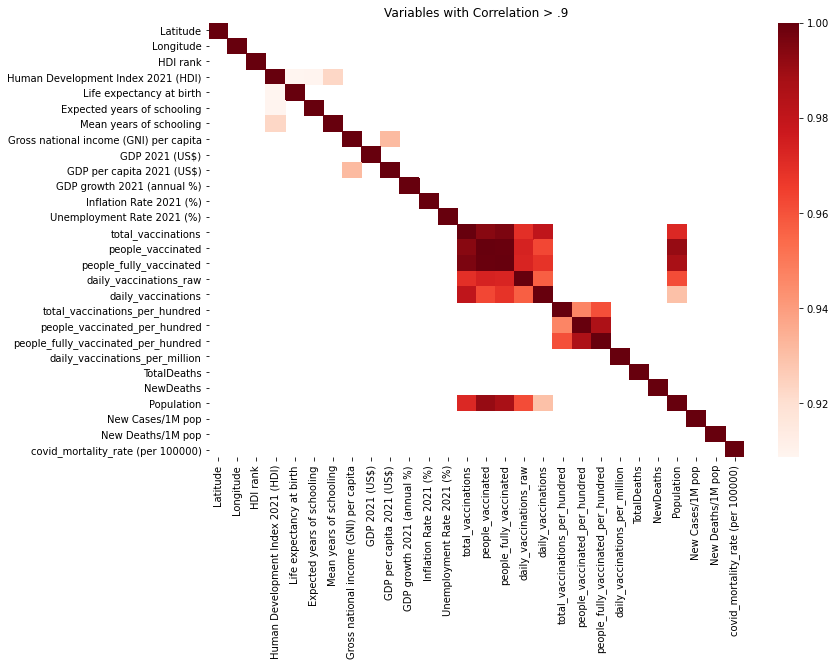

In [24]:
corr = covidvisual.corr()
kot = corr[corr>=.9]
plt.figure(figsize=(12,8))
sns.heatmap(kot, cmap='Reds')
plt.title('Variables with Correlation > .9');

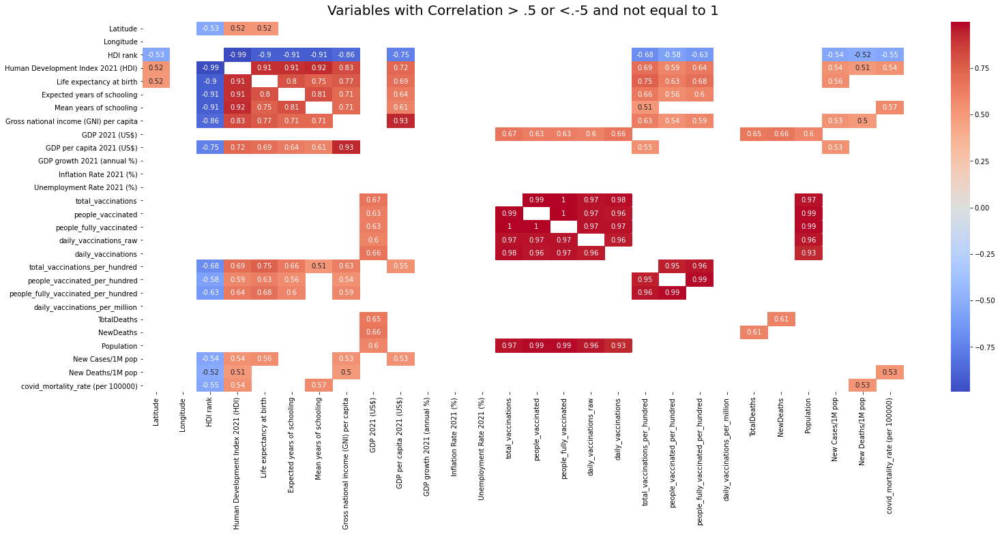

In [25]:
dfCorr = covidvisual.corr()
filteredDf = dfCorr[((dfCorr >= .5) | (dfCorr <= -.5)) & (dfCorr !=1.000)]
plt.figure(figsize=(25,10))
sns.heatmap(filteredDf, annot=True, cmap='coolwarm')
plt.title('Variables with Correlation > .5 or <.-5 and not equal to 1',
          size=20, verticalalignment='bottom')
plt.show()

# 7. Econometrics

In [1]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.sandbox.regression.predstd import wls_prediction_std
from statsmodels.api import add_constant, OLS
from statsmodels.iolib.summary2 import summary_col
from numpy import NaN
from sklearn import linear_model
from scipy import stats
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from linearmodels.iv import IV2SLS

In [2]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [3]:
covidvisual

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,...,NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,...,NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,...,NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546
3,Armenia,ARM,40.0,45.0,85,0.759,72.0431,13.116760,11.330300,13157.993900,...,NaN,"4,250",NaN,"3,242,901",2971966,Asia,NaN,NaN,"1,430",294.047778
4,Australia,AUS,-27.0,133.0,5,0.951,84.5265,21.054590,12.726820,49238.433350,...,NaN,"43,652",33,"78,835,048",26068792,Australia/Oceania,NaN,NaN,"1,674",76.167703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,Uzbekistan,UZB,41.0,64.0,101,0.727,70.8616,12.477140,11.895590,7916.785725,...,NaN,"8,716",23,"1,377,915",34382084,Asia,NaN,NaN,254,4.761201
145,Vanuatu,VUT,-16.0,167.0,140,0.607,70.4490,11.535315,7.064846,3085.411633,...,NaN,24,NaN,"24,976",321832,Australia/Oceania,NaN,NaN,75,4.350096
146,Viet Nam,VNM,16.0,106.0,115,0.703,73.6181,12.951932,8.370280,7867.371345,...,+23,"869,254",7,"85,826,548",98953541,Asia,0.5,NaN,"8,784",43.642703
147,Zambia,ZMB,-15.0,30.0,154,0.565,61.2234,10.928760,7.187091,3217.767739,...,NaN,122,NaN,"3,994,061",19470234,Africa,NaN,NaN,6,20.842071


In [4]:
covidvisual.shape

(149, 43)

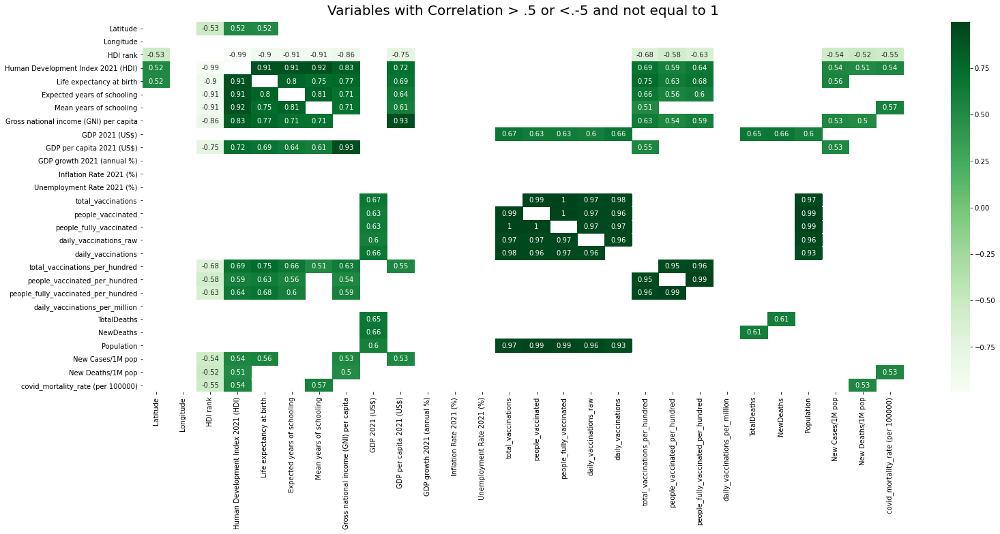

In [5]:
dfCorr = covidvisual.corr()
filteredDf = dfCorr[((dfCorr >= .5) | (dfCorr <= -.5)) & (dfCorr !=1.000)]
plt.figure(figsize=(25,10))
plt.title('Variables with Correlation > .5 or <.-5 and not equal to 1',
          size=20, verticalalignment='bottom')
sns.heatmap(filteredDf, annot=True, cmap='Greens')
plt.show()

In [6]:
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', None)

In [7]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546


In [8]:
covidvisual.sort_values(by=['covid_mortality_rate (per 100000)'], ascending = False).head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
108,Peru,PER,-10.0,-76.0,84,0.762,72.3769,15.387734,9.885519,12245.89366,2.232495e+11,6621.574336,13.349509,4.271664,5.10,Latin America & Caribbean,Upper middle income,88627741,2023-04-02,30411505,28590369,603818.0,390102,260.29,89.32,83.97,11457,Peru,"4,494,028",NaN,219837,NaN,"4,270,272",NaN,"3,919",35,"38,354,895",33684208,South America,NaN,NaN,116,652.641143
20,Bulgaria,BGR,43.0,25.0,68,0.795,71.7980,13.897290,11.413180,23078.95595,8.405631e+10,12221.496606,7.634610,3.297744,5.27,Europe & Central Asia,Upper middle income,4610850,2023-04-04,2107140,2076682,38117.0,27038,67.99,31.07,30.62,3987,Bulgaria,"1,300,621",NaN,38269,NaN,"1,259,702",NaN,"2,650",38,"11,130,747",6844597,Europe,NaN,NaN,387,559.112538
59,Hungary,HUN,47.0,20.0,46,0.846,74.5301,15.033628,12.249590,32789.01063,1.818480e+11,18728.121895,7.117315,5.110965,4.05,Europe & Central Asia,High income,16701238,2022-12-27,6420813,6207249,187488.0,125911,167.56,64.42,62.28,12632,Hungary,"2,199,764",+618,48811,8.0,"2,146,693",+690,"4,260",3,"11,394,556",9606259,Europe,64.0,0.8,443,508.116635


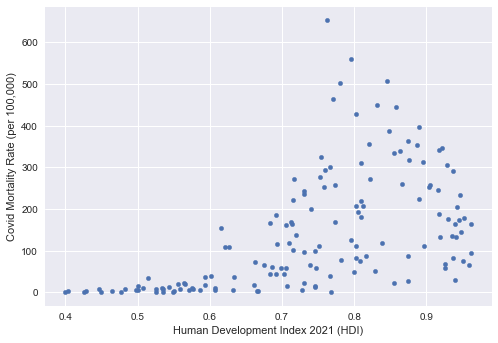

In [9]:
plt.style.use('seaborn')
covidvisual.plot(x='Human Development Index 2021 (HDI)', y='covid_mortality_rate (per 100000)', kind='scatter')
plt.ylabel('Covid Mortality Rate (per 100,000)')
plt.show()

In [10]:
#correlating the hdi with covid_mortality_rate, as control population, latitude can be used, income group (or gpd per capita);
#for an instrument, a variable that correlates with hdi but not directly to covid mortality rate, gdp per capita for example

## 7.1 Linear Regression

$$ 
Coviddeathrate_{i} = \beta_{0} + \beta_{1}HDI_{i} + u_{i}
$$

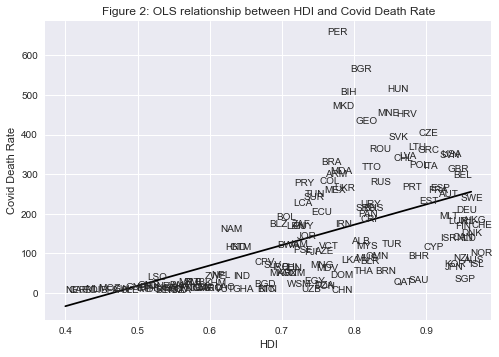

In [11]:
# Dropping NA's is required to use numpy's polyfit
df1_subset = covidvisual.dropna(subset=['covid_mortality_rate (per 100000)', 'Human Development Index 2021 (HDI)'])

# Use only 'base sample' for plotting purposes
#df1_subset = df1_subset[df1_subset['baseco'] == 1]

X = df1_subset['Human Development Index 2021 (HDI)']
y = df1_subset['covid_mortality_rate (per 100000)']
labels = df1_subset['Country Code']

# Replace markers with country labels
fig, ax = plt.subplots()
ax.scatter(X, y, marker='')

for i, label in enumerate(labels):
    ax.annotate(label, (X.iloc[i], y.iloc[i]))

# Fit a linear trend line
ax.plot(np.unique(X),
         np.poly1d(np.polyfit(X, y, 1))(np.unique(X)),
         color='black')

#ax.set_xlim([0,1])
#ax.set_ylim([0,300])
ax.set_xlabel('HDI')
ax.set_ylabel('Covid Death Rate')
ax.set_title('Figure 2: OLS relationship between HDI and Covid Death Rate')
plt.show()

In [12]:
#it might seem counterintuitive at first, as HDI increases Covid Death Rate increases
#it could be because of countries with higher HDI has higher mobility, or something else, let's find out

In [13]:
#adding a constant term prevents overall bias by forcing the residual mean to equal zero
#it's like moving the regression line up or down to the point where the residual mean equals zero
#that's why a constant term is usually added into a linear regression
#bias exists if the residuals have an overall positive or negative mean, the model makes predicitons that are too high or too low
#the constant term prevents overall bias by forcing the residual mean to equal zero

In [14]:
covidvisual['const'] = 1

In [15]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),const
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992,1
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049,1
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546,1


In [16]:
#building the model
reg1 = sm.OLS(endog=covidvisual['covid_mortality_rate (per 100000)'], exog=covidvisual[['const', 'Human Development Index 2021 (HDI)']], \
    missing='drop')
type(reg1)

statsmodels.regression.linear_model.OLS

##### obtainning the parameter estimates 
$$ 
Coviddeathrate_{i} = \hat\beta_{0} + \hat\beta_{1}HDI_{i} + u_{i}
$$

In [17]:
results = reg1.fit()
type(results)

statsmodels.regression.linear_model.RegressionResultsWrapper

In [18]:
print(results.summary())

                                    OLS Regression Results                                   
Dep. Variable:     covid_mortality_rate (per 100000)   R-squared:                       0.294
Model:                                           OLS   Adj. R-squared:                  0.290
Method:                                Least Squares   F-statistic:                     61.34
Date:                               Sun, 16 Apr 2023   Prob (F-statistic):           8.79e-13
Time:                                       16:13:18   Log-Likelihood:                -921.68
No. Observations:                                149   AIC:                             1847.
Df Residuals:                                    147   BIC:                             1853.
Df Model:                                          1                                         
Covariance Type:                           nonrobust                                         
                                         coef    std err    

The intercept $ \hat\beta_{0} = -238.60 $ \
The slope $ \hat\beta_{1} = 513.93 $ \
The positive $ \hat\beta_{1} $ parameter estimate implies that HDI has a positive effect on covid death rate, that is the higher HDI, higher covid death rate \
The p-value of 0.000 for $ \hat\beta_{1} $ implies that the effect of HDI on covid death rate is statistically significant
(using p<0.05 as a rejection rule). \
The R-squared value of 0.294 indicates that around 29% of variation in covid death rate is explained by HDI

In [19]:
#using the parameter estimates

$$
\widehat{Coviddeathrate_{i}} = -238.60 + 513.93HDI_{i}
$$

In [20]:
#the equation above describes the line that best fits the data shown in Figure 2
#the equation can be used to predict the level of covid death rate for a value of HDI

In [21]:
mean_hdi = np.mean(df1_subset['Human Development Index 2021 (HDI)'])
mean_hdi

0.7379395973154366

In [22]:
predicted_coviddeathrate = -238.60 + 513.93 * 0.74
predicted_coviddeathrate

141.70819999999995

In [23]:
#for a country with HDI value of 0.74 (the average for the dataset), the predicted level of covid death rate is 141.70

In [24]:
#there's another way to do it, it's easier and more accurate, using predict(), setting constant = 1 and hdii = mean_hdi

In [25]:
results.predict(exog=[1, mean_hdi])

array([140.65166713])

In [26]:
#plotting the predicted values hdi and observed values covid death rate

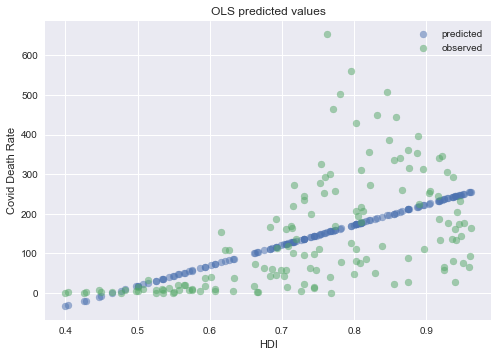

In [27]:
# Drop missing observations from whole sample

df1_plot = covidvisual.dropna(subset=['covid_mortality_rate (per 100000)', 'Human Development Index 2021 (HDI)'])

# Plot predicted values

fix, ax = plt.subplots()
ax.scatter(df1_plot['Human Development Index 2021 (HDI)'], results.predict(), alpha=0.5,
        label='predicted')

# Plot observed values

ax.scatter(df1_plot['Human Development Index 2021 (HDI)'], df1_plot['covid_mortality_rate (per 100000)'], alpha=0.5,
        label='observed')

ax.legend()
ax.set_title('OLS predicted values')
ax.set_xlabel('HDI')
ax.set_ylabel('Covid Death Rate')
plt.show()

## 7.2 Multivariate Regression Model

In [28]:
#that are many factors that influence covid death rate, and leaving out variables that affect it, will result in omitted variable bias
#yielding biased and inconsistent parameter estimates
#adding other factors will extend the linear regression model into multivariate regression model

In [29]:
#Factos such as:
#the effect on climate on covid death rate, latitude is used as a proxy
#(Latitude)
#population, in general it's harder to control countries with higher population, and the higher population more people can trasmit the virus
#(Population)
#people fully vaccinated per hundred, people who received all doses are less likely to die from the virus
#(people_fully_vaccinated_per_hundred)
#incomegroup, lower income groups are more likely to die from the virus cause the lack of resources, worse sanitation such as sewage treatment, 
#less access to treated water, and the lower income group are also more likely to share rooms with the same household, increasing the chance of transmitting the virus
#(IncomeGroup)-> since income group is categorical it won't be used in the regression

In [30]:
covidvisual.head()

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),const
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992,1
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049,1
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546,1
3,Armenia,ARM,40.0,45.0,85,0.759,72.0431,13.116760,11.330300,13157.993900,1.386141e+10,4966.513471,5.700000,7.184836,12.729,Europe & Central Asia,Upper middle income,2153341,2023-03-05,1130844,986762,NaN,17910,77.45,40.67,35.49,6441,Armenia,"448,151",NaN,8739,NaN,"435,162",NaN,"4,250",NaN,"3,242,901",2971966,Asia,NaN,NaN,"1,430",294.047778,1
4,Australia,AUS,-27.0,133.0,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,19856,NaN,"11,264,265",NaN,"43,652",33,"78,835,048",26068792,Australia/Oceania,NaN,NaN,"1,674",76.167703,1


In [31]:
#lists of variables to be used in each regression
X1 = ['const', 'Human Development Index 2021 (HDI)']
X2 = ['const', 'Human Development Index 2021 (HDI)', 'Latitude']
X3 = ['const', 'Human Development Index 2021 (HDI)', 'Latitude','Population']
X4 = ['const', 'Human Development Index 2021 (HDI)', 'Latitude','Population','people_fully_vaccinated_per_hundred']
#X5 = ['const', 'Human Development Index 2019 (HDI)', 'Latitude','Population','people_fully_vaccinated_per_hundred','IncomeGroup']
#estimating an OLS regression for each set of variables
reg1 = sm.OLS(covidvisual['covid_mortality_rate (per 100000)'], covidvisual[X1], missing='drop').fit()
reg2 = sm.OLS(covidvisual['covid_mortality_rate (per 100000)'], covidvisual[X2], missing='drop').fit()
reg3 = sm.OLS(covidvisual['covid_mortality_rate (per 100000)'], covidvisual[X3], missing='drop').fit()
reg4 = sm.OLS(covidvisual['covid_mortality_rate (per 100000)'], covidvisual[X4], missing='drop').fit()
#reg5 = sm.OLS(covidvisual['covid_mortality_rate (per 100000)'], covidvisual[X5], missing='drop').fit()

In [32]:
info_dict={'R-squared' : lambda x: f"{x.rsquared:.2f}",
           'No. observations' : lambda x: f"{int(x.nobs):d}"}

results_table = summary_col(results=[reg1,reg2,reg3, reg4],
                            float_format='%0.2f',
                            stars = True,
                            model_names=['Model 1',
                                         'Model 2',
                                         'Model 3',
                                         'Model 4'],
                            info_dict=info_dict,
                            regressor_order=['const',
                                             'Human Development Index 2021 (HDI)',
                                             'Latitude',
                                             'Population',
                                             'people_fully_vaccinated_per_hundred'])

results_table.add_title('Table 2 - OLS Regressions')

print(results_table)

                           Table 2 - OLS Regressions
                                     Model 1    Model 2    Model 3    Model 4  
-------------------------------------------------------------------------------
const                               -238.60*** -205.68*** -197.50*** -250.94***
                                    (49.38)    (53.04)    (53.22)    (54.88)   
Human Development Index 2021 (HDI)  513.93***  448.55***  441.63***  644.98*** 
                                    (65.62)    (76.46)    (76.40)    (101.13)  
Latitude                                       0.75       0.78*      0.40      
                                               (0.45)     (0.45)     (0.46)    
Population                                                -0.00      -0.00     
                                                          (0.00)     (0.00)    
people_fully_vaccinated_per_hundred                                  -1.61***  
                                                                   

In [33]:
#population and people fully vaccinated did not show significant 
#as for HDI, it showed statistically significant throghout all models  for p<.01, meaning that higher HDI impacts into higher covid death rate
#Latitude was not significant 
#latitude ranges from -90 to 90, at the equator is 0, above is positve until 90 and below is negative until 90

## 7.3 Endogeneity

In [34]:
#OLS models are likely to suffer from endogeneity issues, resulting in biased and inconsistent model estimates
#there's likely a two-way relationship between HDI and covid death rate

#higher covid death rate can be because of higher mobility, richer people can afford to travel more, in and out of the country
#variables that affect covid death rate may also be correlated with HDI

#to deal with endogeneity, two-stage least squares (2SLS) regression, an extension of OLS regression, can be used

### 7.3.1 Two-stage least squares (2SLS) regression

In [35]:
#this method requires replacing the endogenous variable HDIi, with a variable that is:
#1. correlated with HDIi
#2. not correlated with the error term (ie. it should not directly affect the dependent variable (in this case covid death rate),
#otherwise it would be correlated with ui due to omitted variable bias)

#the new set of regressor is called an intrument, which aims to remove endogeneity in our HDI variable

In [36]:
# an option for an instrument could be inflation rate or unemployment rate, each one is correlated with HDI,
#because countries that have lower unemployment rate tend to have a higher HDI
#and also countries that have lower inflation rate tend to have a higher HDI
#both, inflation rate nor unemployment rate is correlated dirrectly to covid death rate
#let's find out which one would be a better instrument

In [37]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),const
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992,1
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049,1
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546,1


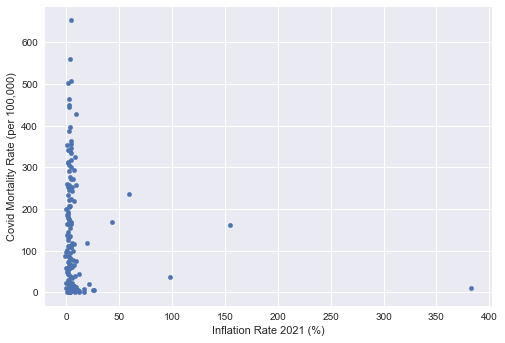

In [38]:
plt.style.use('seaborn')
covidvisual.plot(x='Inflation Rate 2021 (%)', y='covid_mortality_rate (per 100000)', kind='scatter')
plt.ylabel('Covid Mortality Rate (per 100,000)')
plt.show()

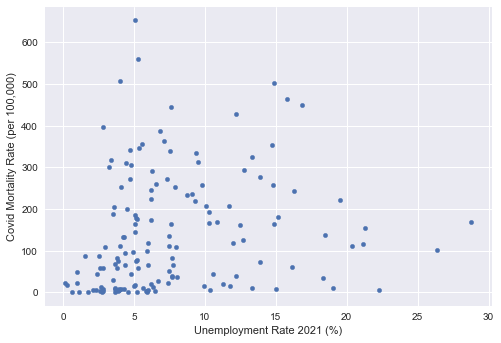

In [39]:
plt.style.use('seaborn')
covidvisual.plot(x='Unemployment Rate 2021 (%)', y='covid_mortality_rate (per 100000)', kind='scatter')
plt.ylabel('Covid Mortality Rate (per 100,000)')
plt.show()

In [40]:
#both inflation rate nor unemployment rate shows correlation with covid death rate, which is a good sign for the instrument
#it has to be correlated with the independent variable HDI and not with the dependent variable covid death rate

In [41]:
px.scatter(covidvisual, x='Inflation Rate 2021 (%)', y='Human Development Index 2021 (HDI)', trendline='ols')

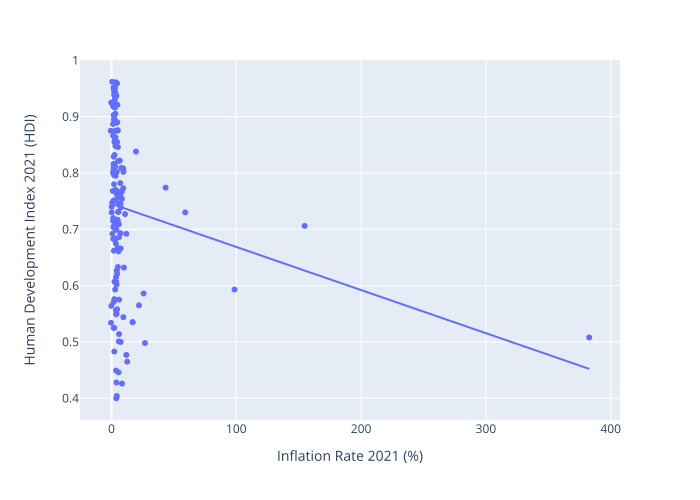

In [42]:
fig = px.scatter(covidvisual, x='Inflation Rate 2021 (%)', y='Human Development Index 2021 (HDI)', trendline='ols')
fig.show('svg')

In [43]:
px.scatter(covidvisual, x='Unemployment Rate 2021 (%)', y='Human Development Index 2021 (HDI)', trendline='ols')

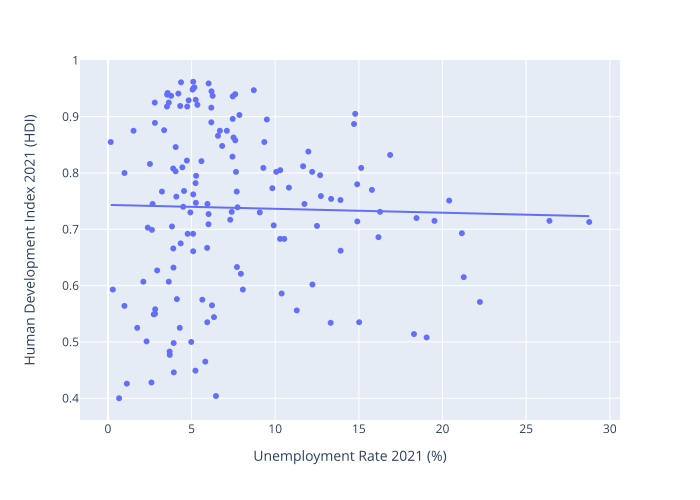

In [44]:
fig = px.scatter(covidvisual, x='Unemployment Rate 2021 (%)', y='Human Development Index 2021 (HDI)', trendline='ols')
fig.show('svg')

In [45]:
#inflation rate will be used as instrument because it shows a correlation (negative) with HDI
#a country with a higher inflation rate tends to present a lower HDI, 
#meanwhile inflation rate is not directly correlated with covid death rate

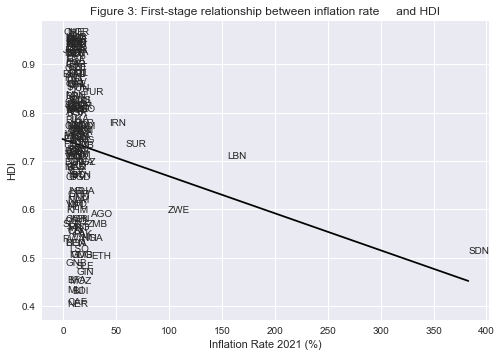

In [46]:
# Dropping NA's is required to use numpy's polyfit
df1_subset2 = covidvisual.dropna(subset=['Inflation Rate 2021 (%)', 'Human Development Index 2021 (HDI)'])

X = df1_subset2['Inflation Rate 2021 (%)']
y = df1_subset2['Human Development Index 2021 (HDI)']
labels = df1_subset2['Country Code']

# Replace markers with country labels
fig, ax = plt.subplots()
ax.scatter(X, y, marker='')

for i, label in enumerate(labels):
    ax.annotate(label, (X.iloc[i], y.iloc[i]))

# Fit a linear trend line
ax.plot(np.unique(X),
         np.poly1d(np.polyfit(X, y, 1))(np.unique(X)),
         color='black')

#ax.set_xlim([1.8,8.4])
#ax.set_ylim([3.3,10.4])
ax.set_xlabel('Inflation Rate 2021 (%)')
ax.set_ylabel('HDI')
ax.set_title('Figure 3: First-stage relationship between inflation rate \
    and HDI')
plt.show()

#### 7.3.1.1 First Stage

In [47]:
#the first stage involves regressing the endogenous variable (HDIi) on the instrument
#the instrument is the set of all exonegous variables in the model (not just the variable replaced)
#on model 1, the instrument is a constant and inflation rate
#thus, the first-stage regression estimated is

$$ 
HDI_{i} = \delta_{0} + \delta_{1}inflationrate_{i} +v_{i}
$$

In [48]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),const
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992,1
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049,1
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546,1


In [49]:
# Fit the first stage regression and print summary
results_fs = sm.OLS(covidvisual['Human Development Index 2021 (HDI)'],
                    covidvisual[['const', 'Inflation Rate 2021 (%)']],
                    missing='drop').fit()
print(results_fs.summary())

                                    OLS Regression Results                                    
Dep. Variable:     Human Development Index 2021 (HDI)   R-squared:                       0.032
Model:                                            OLS   Adj. R-squared:                  0.026
Method:                                 Least Squares   F-statistic:                     4.876
Date:                                Sun, 16 Apr 2023   Prob (F-statistic):             0.0288
Time:                                        16:13:26   Log-Likelihood:                 75.937
No. Observations:                                 149   AIC:                            -147.9
Df Residuals:                                     147   BIC:                            -141.9
Df Model:                                           1                                         
Covariance Type:                            nonrobust                                         
                              coef    std err     

#### 7.3.1.2 Second Stage

There's the need to retrieve the predicted values of HDIi using .predict()
then replace the endogenous variable HDIi with the predicted values $ \widehat{HDI_i} $ in the original linear model
the second stage regression is the following:

$$ 
Coviddeathrate_{i} = \beta_{0} + \beta_{1}\widehat{HDI_i} + u_{i}
$$

In [50]:
covidvisual['predicted_HDI'] = results_fs.predict()

results_ss = sm.OLS(covidvisual['covid_mortality_rate (per 100000)'],
                    covidvisual[['const', 'predicted_HDI']], missing = 'drop').fit()
print(results_ss.summary())

                                    OLS Regression Results                                   
Dep. Variable:     covid_mortality_rate (per 100000)   R-squared:                       0.008
Model:                                           OLS   Adj. R-squared:                  0.002
Method:                                Least Squares   F-statistic:                     1.247
Date:                               Sun, 16 Apr 2023   Prob (F-statistic):              0.266
Time:                                       16:13:26   Log-Likelihood:                -947.03
No. Observations:                                149   AIC:                             1898.
Df Residuals:                                    147   BIC:                             1904.
Df Model:                                          1                                         
Covariance Type:                           nonrobust                                         
                    coef    std err          t      P>|t|   

In [51]:
#the second stage results in a p-value that is not statistically significant
#indicating the second-stage regression results does not give an unbiased and conssitent estimate of the effect of 
#HDI on covid death rate, the inflation rate is not a good instrument, and HDI is not endogenous according to the 
#Hausman Test used after the IV2SLS 

In [52]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),const,predicted_HDI
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992,1,0.743616
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049,1,0.739647
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546,1,0.725463


In [53]:
iv = IV2SLS(dependent=covidvisual['covid_mortality_rate (per 100000)'],
            exog=covidvisual['const'],
            endog=covidvisual['Human Development Index 2021 (HDI)'],
            instruments=covidvisual['Inflation Rate 2021 (%)']).fit(cov_type='unadjusted')

print(iv.summary)

                                  IV-2SLS Estimation Summary                                 
Dep. Variable:     covid_mortality_rate (per 100000)   R-squared:                      0.2935
Estimator:                                   IV-2SLS   Adj. R-squared:                 0.2887
No. Observations:                                149   F-statistic:                    1.7746
Date:                               Sun, Apr 16 2023   P-value (F-stat)                0.1828
Time:                                       16:13:26   Distribution:                  chi2(1)
Cov. Estimator:                           unadjusted                                         
                                                                                             
                                         Parameter Estimates                                          
                                    Parameter  Std. Err.     T-stat    P-value    Lower CI    Upper CI
------------------------------------------

In [54]:
#the p value is not significant meaning the estimates are not consistent nor unbiased, but if it were interpreting the results
#there's the marginal effect of 484.88 to calculate the difference in the hdi index implies difference in covid death rate

#### 7.3.2 Hausman Test

In [55]:
#besides identifying endogeneity by thinking about the data and model, there's a test for endogeneity, it's called Hausman test
#to test the correlation between the endogenous variable, HDIi, and the errors, ui

$$
H_{0}: Cov({HDI_i},u_{i}) = 0 \ (no \ endogeneity) \\
H_{1}: Cov({HDI_i},u_{i}) \neq 0 \ (endogeneity)
$$

In [56]:
#the test is run in two stages
#first regressing the independent variable (HDIi) on the instrument (inflationratei)

$$ 
HDI_{i} = \pi_{0} + \pi_{1}inflationrate_{i} +v_{i}
$$

second retrieving the residuals $ \hat{v_{i}} $ and including them in the original equation

$$ 
Coviddeathrate_{i} = \beta_{0} + \beta_{1}{HDI_i} + \alpha\hat{v_i} + u_{i}
$$

If $\alpha$ is statistically significant (with a p-value < 0.05), then we reject the null hypothesis and conclude that $HDI_{i}$ is endogenous.
Estimating the Hausman Test and interpreting the results

In [57]:
# Estimate the first stage regression
reg1 = sm.OLS(endog=covidvisual['Human Development Index 2021 (HDI)'],
              exog=covidvisual[['const', 'Inflation Rate 2021 (%)']],
              missing='drop').fit()

# Retrieve the residuals
covidvisual['resid'] = reg1.resid

# Estimate the second stage residuals
reg2 = sm.OLS(endog=covidvisual['covid_mortality_rate (per 100000)'],
              exog=covidvisual[['const', 'Human Development Index 2021 (HDI)', 'resid']],
              missing='drop').fit()

print(reg2.summary())

                                    OLS Regression Results                                   
Dep. Variable:     covid_mortality_rate (per 100000)   R-squared:                       0.294
Model:                                           OLS   Adj. R-squared:                  0.285
Method:                                Least Squares   F-statistic:                     30.47
Date:                               Sun, 16 Apr 2023   Prob (F-statistic):           8.75e-12
Time:                                       16:13:26   Log-Likelihood:                -921.67
No. Observations:                                149   AIC:                             1849.
Df Residuals:                                    146   BIC:                             1858.
Df Model:                                          2                                         
Covariance Type:                           nonrobust                                         
                                         coef    std err    

In [58]:
#the output shows that the coefficient on the residuals is not statistically significant, 
#indicating HDIi is not endogenous

#if the coefficient on the residuals were statistically significant, HDIi would be endogenous

### 7.4 The OLS parameter 𝛽 estimated using matrix algebra and numpy

In [59]:
#the linear equation to estimate written in matrix form is 

y = X$\beta$ + u

In [60]:
#to solve the unknown parameter B, we want to minimize the sum of squared residuals

${\displaystyle\min_\hat{\beta}} \ \hat{u}' \ \hat{u}$

In [61]:
#isolating u on the first equation and substituting into the second equation

${\displaystyle\min_\hat{\beta}} \ (Y - X \hat{\beta})'(Y - X \hat{\beta})$

optimizing the problem gives the solution for the  $\hat{\beta}$ coefficients

$\hat{\beta} = (X'X)^{-1}X'y$

computing $\hat{\beta}$ from the model using numpy, the results should be the same as using statsmodels

In [62]:
df1 = covidvisual.dropna(subset=['covid_mortality_rate (per 100000)', 'Human Development Index 2021 (HDI)'])
# Define the X and y variables
y = np.asarray(df1['covid_mortality_rate (per 100000)'])
X = np.asarray(df1[['const', 'Human Development Index 2021 (HDI)']])

# Compute β_hat
β_hat = np.linalg.solve(X.T @ X, X.T @ y)

# Print out the results from the 2 x 1 vector β_hat
print(f'β_0 = {β_hat[0]:.2}')
print(f'β_1 = {β_hat[1]:.2}')

β_0 = -2.4e+02
β_1 = 5.1e+02


In [63]:
#exactly the same results

In [64]:
reg1 = sm.OLS(endog=covidvisual['covid_mortality_rate (per 100000)'], exog=covidvisual[['const', 'Human Development Index 2021 (HDI)']], \
    missing='drop')
type(reg1)

results = reg1.fit()
type(results)

print(results.summary())

                                    OLS Regression Results                                   
Dep. Variable:     covid_mortality_rate (per 100000)   R-squared:                       0.294
Model:                                           OLS   Adj. R-squared:                  0.290
Method:                                Least Squares   F-statistic:                     61.34
Date:                               Sun, 16 Apr 2023   Prob (F-statistic):           8.79e-13
Time:                                       16:13:26   Log-Likelihood:                -921.68
No. Observations:                                149   AIC:                             1847.
Df Residuals:                                    147   BIC:                             1853.
Df Model:                                          1                                         
Covariance Type:                           nonrobust                                         
                                         coef    std err    

The intercept $ \hat\beta_{0} = -238.60 $ \
The slope $ \hat\beta_{1} = 513.93 $ 

### 7.5 Regression Discontinuity Design (RDD)

In [65]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [66]:
covidvisual

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546
3,Armenia,ARM,40.0,45.0,85,0.759,72.0431,13.116760,11.330300,13157.993900,1.386141e+10,4966.513471,5.700000,7.184836,12.729,Europe & Central Asia,Upper middle income,2153341,2023-03-05,1130844,986762,NaN,17910,77.45,40.67,35.49,6441,Armenia,"448,151",NaN,8739,NaN,"435,162",NaN,"4,250",NaN,"3,242,901",2971966,Asia,NaN,NaN,"1,430",294.047778
4,Australia,AUS,-27.0,133.0,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,19856,NaN,"11,264,265",NaN,"43,652",33,"78,835,048",26068792,Australia/Oceania,NaN,NaN,"1,674",76.167703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,Uzbekistan,UZB,41.0,64.0,101,0.727,70.8616,12.477140,11.895590,7916.785725,6.923890e+10,1983.064723,7.420110,10.849240,6.017,Europe & Central Asia,Lower middle income,75503399,2023-03-05,21684856,18144247,720866.0,426314,218.04,62.62,52.40,12311,Uzbekistan,"251,839",NaN,1637,NaN,"241,486",NaN,"8,716",23,"1,377,915",34382084,Asia,NaN,NaN,254,4.761201
145,Vanuatu,VUT,-16.0,167.0,140,0.607,70.4490,11.535315,7.064846,3085.411633,9.563327e+08,2996.621062,0.449256,2.343284,2.118,East Asia & Pacific,Lower middle income,366638,2023-02-20,176624,162250,NaN,8843,112.21,54.06,49.66,27064,Vanuatu,"12,014",NaN,14,NaN,"11,976",NaN,24,NaN,"24,976",321832,Australia/Oceania,NaN,NaN,75,4.350096
146,Viet Nam,VNM,16.0,106.0,115,0.703,73.6181,12.951932,8.370280,7867.371345,3.661376e+11,3756.489121,2.561551,1.834716,2.380,East Asia & Pacific,Lower middle income,266477589,2023-03-09,90497674,86002617,2091069.0,1675471,271.40,92.17,87.59,17064,Vietnam,"11,527,454",+51,43186,NaN,"10,615,014",+23,"869,254",7,"85,826,548",98953541,Asia,0.5,NaN,"8,784",43.642703
147,Zambia,ZMB,-15.0,30.0,154,0.565,61.2234,10.928760,7.187091,3217.767739,2.214763e+10,1137.343633,4.598734,22.021234,6.220,Sub-Saharan Africa,Low income,12792112,2023-03-15,11158619,8747040,224617.0,180289,63.90

In [67]:
covidvisual.shape

(149, 43)

In [68]:
covidvisual.sort_values(by = 'people_fully_vaccinated_per_hundred', ascending = False)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
112,Qatar,QAT,25.5000,51.2500,42,0.855,79.2716,12.637220,9.996011,87134.134690,1.796772e+11,66838.357433,1.590757,2.304466,0.170,Middle East & North Africa,High income,7608548,2023-04-02,2852001,2852000,43974.0,37344,282.31,105.82,105.82,13856,Qatar,"501,236",+345,689,NaN,"499,092",+169,"1,455",48,"4,065,369",2979915,Asia,116.0,NaN,488,23.121465
19,Brunei Darussalam,BRN,4.5000,114.6667,51,0.829,74.6424,13.951780,9.180000,64489.539540,1.400657e+10,31449.076562,-1.590762,1.733414,7.446,East Asia & Pacific,High income,1291223,2023-03-10,450944,446551,8701.0,7901,287.58,100.43,99.45,17597,Brunei,"283,345",NaN,225,NaN,"243,601",NaN,"39,519",3,"717,784",445431,Asia,NaN,NaN,"88,721",50.512874
122,Singapore,SGP,1.3667,103.8000,12,0.939,82.7545,16.524321,11.924880,90918.644710,3.969869e+11,72794.003023,7.613963,2.304860,3.540,East Asia & Pacific,High income,14727569,2023-01-31,5160551,5120969,83201.0,75745,261.27,91.55,90.85,13437,Singapore,"2,255,812",NaN,1722,NaN,"2,149,583",NaN,"104,507",1,"24,756,666",5943546,Asia,NaN,NaN,"17,583",28.972603
58,Hong Kong,HKG,22.2500,114.1667,4,0.952,85.4734,17.278170,12.226210,62606.845400,3.691764e+11,49800.542414,6.343106,1.568758,5.170,East Asia & Pacific,High income,20743734,2023-04-02,6914894,6798392,102019.0,86321,276.99,92.34,90.78,11527,Hong Kong,"2,885,246",+99,13482,5.0,"2,869,869",+96,"1,895",28,"76,127,725",7604299,Asia,13.0,0.7,249,177.294449
28,Chile,CHL,-30.0000,-71.0000,42,0.855,78.9435,16.731300,10.934966,24563.244860,3.170585e+11,16265.095977,11.668225,4.524568,9.350,Latin America & Caribbean,High income,62688847,2023-02-08,18088517,17700117,430495.0,298755,319.78,92.27,90.29,15240,Chile,"5,269,112","+1,485",64497,NaN,"5,201,598","+2,993","3,017",84,"49,096,959",19250195,South America,77.0,NaN,157,335.045957
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24,Cameroon,CMR,6.0000,12.0000,151,0.576,60.3334,13.108599,6.151310,3620.932408,4.533828e+10,1666.932734,3.649917,2.271858,4.122,Sub-Saharan Africa,Lower middle income,4278883,2023-03-12,3435624,2895351,9890.0,232219,15.33,12.31,10.37,8319,Cameroon,"124,741",NaN,1968,NaN,"122,640",NaN,133,13,"1,751,774",27911548,Africa,NaN,NaN,5,7.050845
81,Madagascar,MDG,-20.0000,47.0000,173,0.501,64.4853,10.134991,5.120469,1483.520983,1.447260e+10,500.511032,4.402340,5.812251,2.310,Sub-Saharan Africa,Low income,2787212,2023-03-26,2502027,2423671,13544.0,12101,9.41,8.45,8.18,409,Madagascar,"68,105",NaN,1424,NaN,"66,566",NaN,115,NaN,"528,968",29178077,Africa,NaN,NaN,4,4.880376
106,Papua New Guinea,PNG,-6.0000,147.0000,156,0.558,65.3506,10.360771,4.740000,4008.623573,2.659431e+10,2672.945790,0.300000,4.483590,2.825,East Asia & Pacific,Lower middle income,732916,2023-04-03,379658,318967,NaN,5196,7.23,3.74,3.14,512,Papua New Guinea,"46,835",NaN,670,NaN,"43,982",NaN,"2,183",7,"249,149",9292169,Australia/Oceania,NaN,NaN,235,7.210373
56,Haiti,HTI,19.0000,-72.4167,163,0.535,63.1924,9.700000,5.554000,2847.500746,2.094439e+10,1829.593044,-1.798240,16.841524,15.017,Latin America & Caribbean,Lower middle income,515718,2023-01-20,406534

In [69]:
covidvisual['people_fully_vaccinated_per_hundred'].mean()

56.137583892617464

In [70]:
covidvisual['people_fully_vaccinated_per_hundred'].median()

62.31

In [71]:
covidvisual['people_fully_vaccinated_per_hundred'].isna().sum()

0

In [72]:
covidvisual['IncomeGroup'].value_counts()

High income            49
Lower middle income    44
Upper middle income    40
Low income             16
Name: IncomeGroup, dtype: int64

In [73]:
covidvisual['people_fully_vaccinated_per_hundred'].mean()

56.137583892617464

In [74]:
covidvisual.groupby(['IncomeGroup'])['people_fully_vaccinated_per_hundred'].mean()

IncomeGroup
High income            73.929592
Low income             30.041250
Lower middle income    48.477955
Upper middle income    53.206500
Name: people_fully_vaccinated_per_hundred, dtype: float64

In [75]:
covidvisual.groupby(['IncomeGroup'])['people_fully_vaccinated_per_hundred'].median()

IncomeGroup
High income            74.750
Low income             28.110
Lower middle income    50.030
Upper middle income    49.995
Name: people_fully_vaccinated_per_hundred, dtype: float64

In [76]:
covidvisual[covidvisual['IncomeGroup']=='High income']

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
4,Australia,AUS,-27.0000,133.0000,5,0.951,84.5265,21.054590,12.726820,49238.43335,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,19856,NaN,"11,264,265",NaN,"43,652",33,"78,835,048",26068792,Australia/Oceania,NaN,NaN,"1,674",76.167703
5,Austria,AUT,47.3333,13.3333,25,0.916,81.5797,16.007959,12.256690,53618.67138,4.803684e+11,53637.705711,4.556851,2.766667,6.180,Europe & Central Asia,High income,20447637,2023-03-17,6899073,6682331,NaN,113665,228.73,77.17,74.75,12715,Austria,"6,041,470","+1,751",22157,NaN,"5,998,735","+2,365","20,578",55,"211,273,524",9066710,Europe,193.0,NaN,"2,270",244.377508
7,Bahamas,BHS,24.2500,-76.0000,55,0.812,71.5983,12.899450,12.641924,30486.18429,1.120860e+10,27478.389629,13.719735,2.904913,11.665,Latin America & Caribbean,High income,364701,2022-11-16,174147,165633,6771.0,3473,88.95,42.48,40.40,8471,Bahamas,"37,491",NaN,833,NaN,"36,366",NaN,292,1,"257,839",400516,North America,NaN,NaN,729,207.981704
8,Bahrain,BHR,26.0000,50.5500,35,0.875,78.7605,16.297560,11.046590,39497.24788,3.886866e+10,26562.969135,2.225351,-0.606319,1.532,Middle East & North Africa,High income,3476633,2022-12-21,1241174,1226796,81811.0,22003,236.15,84.31,83.33,14945,Bahrain,"717,479",+143,1559,NaN,"715,123",+95,797,2,"10,799,671",1783983,Asia,80.0,NaN,447,87.388725
11,Belgium,BEL,50.8333,4.0000,13,0.937,81.8787,19.604219,12.375680,52293.39977,5.941042e+11,51247.014353,6.133866,2.440249,6.260,Europe & Central Asia,High income,29629530,2023-03-27,9266107,9168461,197731.0,155091,254.20,79.50,78.66,13306,Belgium,"4,776,837",NaN,34059,NaN,"4,698,695","+1,653","44,083",43,"36,921,180",11668278,Europe,NaN,NaN,"3,778",291.893971
19,Brunei Darussalam,BRN,4.5000,114.6667,51,0.829,74.6424,13.951780,9.180000,64489.53954,1.400657e+10,31449.076562,-1.590762,1.733414,7.446,East Asia & Pacific,High income,1291223,2023-03-10,450944,446551,8701.0,7901,287.58,100.43,99.45,17597,Brunei,"283,345",NaN,225,NaN,"243,601",NaN,"39,519",3,"717,784",445431,Asia,NaN,NaN,"88,721",50.512874
25,Canada,CAN,60.0000,-95.0000,15,0.936,82.6565,16.396259,13.834427,46807.98619,1.988336e+12,51987.939053,4.540887,3.395193,7.460,North America,High income,96956502,2023-02-02,34763194,31762130,879740.0,545858,252.13,90.40,82.60,14195,Canada,"4,634,277",NaN,52121,NaN,"4,549,731",NaN,"32,425",99,"66,343,123",38388419,North America,NaN,NaN,845,135.772718
28,Chile,CHL,-30.0000,-71.0000,42,0.855,78.9435,16.731300,10.934966,24563.24486,3.170585e+11,16265.095977,11.668225,4.524568,9.350,Latin America & Caribbean,High income,62688847,2023-02-08,18088517,17700117,430495.0,298755,319.78,92.27,90.29,15240,Chile,"5,269,112","+1,485",64497,NaN,"5,201,598","+2,993","3,017",84,"49,096,959",19250195,South America,77.0,NaN,157,335.045957
34,Croatia,HRV,45.1667,15.5000,40,0.858,77.5804,15.112100,12.191084,30132.28814,6.895508e+10,17685.325283,13.072205,2.554507,7.610,Europe & Central Asia,High income,5361245,2023-04-03,2321402,2251361,53059.0,35538,133.02,57.60,55.86,8818,Croatia,"1,270,891",NaN,18069,NaN,"1,252,329",NaN,493,4,"5,553,846",4059286,Europe,Na

In [77]:
len(covidvisual[covidvisual['IncomeGroup']=='High income'])

49

In [78]:
#in order to use RDD let's get the cut off to be around the median of 74 for High Income Group 
#since there's a higher number of observations the high income group, this group will be used cause it has similar characteristics

In [79]:
covidhighincomerdd = covidvisual[covidvisual['IncomeGroup']=='High income']

In [80]:
covidhighincomerdd.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
4,Australia,AUS,-27.0000,133.0000,5,0.951,84.5265,21.054590,12.726820,49238.43335,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,19856,NaN,"11,264,265",NaN,"43,652",33,"78,835,048",26068792,Australia/Oceania,NaN,NaN,"1,674",76.167703
5,Austria,AUT,47.3333,13.3333,25,0.916,81.5797,16.007959,12.256690,53618.67138,4.803684e+11,53637.705711,4.556851,2.766667,6.180,Europe & Central Asia,High income,20447637,2023-03-17,6899073,6682331,NaN,113665,228.73,77.17,74.75,12715,Austria,"6,041,470","+1,751",22157,NaN,"5,998,735","+2,365","20,578",55,"211,273,524",9066710,Europe,193.0,NaN,"2,270",244.377508
7,Bahamas,BHS,24.2500,-76.0000,55,0.812,71.5983,12.899450,12.641924,30486.18429,1.120860e+10,27478.389629,13.719735,2.904913,11.665,Latin America & Caribbean,High income,364701,2022-11-16,174147,165633,6771.0,3473,88.95,42.48,40.40,8471,Bahamas,"37,491",NaN,833,NaN,"36,366",NaN,292,1,"257,839",400516,North America,NaN,NaN,729,207.981704


In [81]:
covidhighincomerdd.shape

(49, 43)

In [82]:
covidhighincomerdd = covidhighincomerdd.sort_values(by ='people_fully_vaccinated_per_hundred', ascending = False)

In [83]:
covidhighincomerdd = covidhighincomerdd.dropna(subset=['people_fully_vaccinated_per_hundred'])

In [84]:
covidhighincomerdd.shape

(49, 43)

In [85]:
covidhighincomerdd['people_fully_vaccinated_per_hundred'].median()

74.75

In [86]:
len(covidhighincomerdd[covidhighincomerdd['people_fully_vaccinated_per_hundred'] < 74.75])

24

In [87]:
len(covidhighincomerdd[covidhighincomerdd['people_fully_vaccinated_per_hundred'] > 74.75])

24

In [88]:
#to ilustrate a RDD application the cuttoff will be 74.75 (median) for people fully vaccinated per hundred
#it would be interesting to use the date in which countries started applying the vaccine, but this information in the data 
#is not available, the vaccine application ordered by the government would be an exogenous fact

In [89]:
covidhighincomerdd

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
112,Qatar,QAT,25.5000,51.2500,42,0.855,79.2716,12.637220,9.996011,87134.13469,1.796772e+11,66838.357433,1.590757,2.304466,0.170,Middle East & North Africa,High income,7608548,2023-04-02,2852001,2852000,43974.0,37344,282.31,105.82,105.82,13856,Qatar,"501,236",+345,689,NaN,"499,092",+169,"1,455",48,"4,065,369",2979915,Asia,116.0,NaN,488,23.121465
19,Brunei Darussalam,BRN,4.5000,114.6667,51,0.829,74.6424,13.951780,9.180000,64489.53954,1.400657e+10,31449.076562,-1.590762,1.733414,7.446,East Asia & Pacific,High income,1291223,2023-03-10,450944,446551,8701.0,7901,287.58,100.43,99.45,17597,Brunei,"283,345",NaN,225,NaN,"243,601",NaN,"39,519",3,"717,784",445431,Asia,NaN,NaN,"88,721",50.512874
122,Singapore,SGP,1.3667,103.8000,12,0.939,82.7545,16.524321,11.924880,90918.64471,3.969869e+11,72794.003023,7.613963,2.304860,3.540,East Asia & Pacific,High income,14727569,2023-01-31,5160551,5120969,83201.0,75745,261.27,91.55,90.85,13437,Singapore,"2,255,812",NaN,1722,NaN,"2,149,583",NaN,"104,507",1,"24,756,666",5943546,Asia,NaN,NaN,"17,583",28.972603
58,Hong Kong,HKG,22.2500,114.1667,4,0.952,85.4734,17.278170,12.226210,62606.84540,3.691764e+11,49800.542414,6.343106,1.568758,5.170,East Asia & Pacific,High income,20743734,2023-04-02,6914894,6798392,102019.0,86321,276.99,92.34,90.78,11527,Hong Kong,"2,885,246",+99,13482,5.0,"2,869,869",+96,"1,895",28,"76,127,725",7604299,Asia,13.0,0.70,249,177.294449
28,Chile,CHL,-30.0000,-71.0000,42,0.855,78.9435,16.731300,10.934966,24563.24486,3.170585e+11,16265.095977,11.668225,4.524568,9.350,Latin America & Caribbean,High income,62688847,2023-02-08,18088517,17700117,430495.0,298755,319.78,92.27,90.29,15240,Chile,"5,269,112","+1,485",64497,NaN,"5,201,598","+2,993","3,017",84,"49,096,959",19250195,South America,77.0,NaN,157,335.045957
85,Malta,MLT,35.8333,14.5833,23,0.918,83.7769,16.838570,12.210260,38884.45623,1.736404e+10,33486.671984,10.297764,1.497892,3.530,Middle East & North Africa,High income,1380764,2023-04-04,478768,471505,17371.0,8191,258.91,89.78,88.41,15359,Malta,"118,133",NaN,832,NaN,"116,641",NaN,660,4,"2,127,851",444033,Europe,NaN,NaN,"1,486",187.373461
111,Portugal,PRT,39.5000,-8.0000,38,0.866,81.0443,16.871229,9.575940,33154.53343,2.536631e+11,24567.509265,5.482392,1.265657,6.580,Europe & Central Asia,High income,28157454,2023-03-24,9782964,8897476,NaN,152104,274.15,95.25,86.63,14809,Portugal,"5,575,030",NaN,26408,NaN,"5,544,065",NaN,"4,557",61,"46,052,812",10140570,Europe,NaN,NaN,449,260.419286
72,South Korea,KOR,37.0000,127.5000,19,0.925,83.6978,16.521740,12.512930,44500.93187,1.810956e+12,34997.781643,4.145324,2.498333,3.640,East Asia & Pacific,High income,129647782,2023-04-04,44811589,44396882,1382042.0,881020,250.21,86.48,85.68,17003,S. Korea,"30,871,740","+14,465",34296,7.0,"30,655,934","+8,987","181,510",126,"15,804,065",51329899,Asia,282.0,0.10,"3,536",66.814860
127,Spain,ESP,40.0000,-4.0000,27,0.905,83.0100,17.916901,10.605400,38353.60164,1.427381e+12,30103.513733,5.519595,3.093135,14.780,Europe & Central Asia,High income,105733320,2023-03-29,41347499,40735254,765399.0,670109,222.32,86.94,85.65,14090,Spain,"13,798,747",NaN,120426,NaN,"13,645,949",NaN,"32,372",231,"471,036,328",46719142,Eur

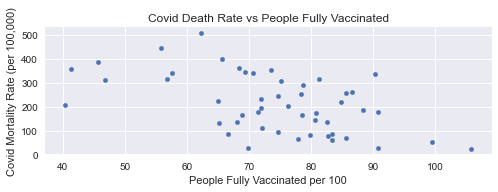

In [90]:
plt.figure(figsize=(8,8))
ax = plt.subplot(3,1,1)
covidhighincomerdd.plot.scatter(x='people_fully_vaccinated_per_hundred', y='covid_mortality_rate (per 100000)', ax=ax)
plt.xlabel('People Fully Vaccinated per 100')
plt.ylabel('Covid Mortality Rate (per 100,000)')

plt.title('Covid Death Rate vs People Fully Vaccinated');

In [91]:
covidhighincomerdd.rename({'covid_mortality_rate (per 100000)':'coviddeathrate'}, axis = 'columns', inplace = True)

In [92]:
rdd_df = covidhighincomerdd.assign(threshold=(covidhighincomerdd['people_fully_vaccinated_per_hundred'] > 74.75).astype(int))

model = smf.wls('coviddeathrate~people_fully_vaccinated_per_hundred*threshold', rdd_df).fit()

model.summary().tables[1]

,coef,std err,t,P>|t|,[0.025,0.975]
Intercept,551.3405,135.079,4.082,0.000,279.278,823.403
people_fully_vaccinated_per_hundred,-4.5704,2.091,-2.186,0.034,-8.782,-0.359
threshold,47.2258,295.194,0.160,0.874,-547.325,641.777
people_fully_vaccinated_per_hundred:threshold,-0.5601,3.736,-0.150,0.881,-8.084,6.964


In [93]:
#covid death rate increases by 47.22(threshold) points with more people fully vaccinated
#people fully vaccinated increases the chance of death by 47%
#the p-value is not below 0.01, so it's not statistically significant
#and the right interpretation that would make total sense would be 47% decrease in death rate by people fully vaccinated per hundred above the threshold (74.75)

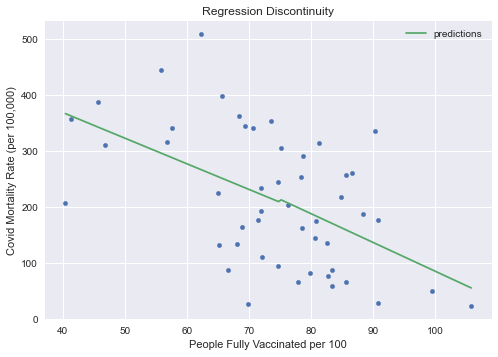

In [94]:
ax = covidhighincomerdd.plot.scatter(x='people_fully_vaccinated_per_hundred', y='coviddeathrate', color='C0')
covidhighincomerdd.assign(predictions=model.fittedvalues).plot(x='people_fully_vaccinated_per_hundred', y='predictions', ax=ax, color='C1')
plt.xlabel('People Fully Vaccinated per 100')
plt.ylabel('Covid Mortality Rate (per 100,000)')
plt.title('Regression Discontinuity');

In [95]:
#a slight discontinuity around the threshold is observed

In [96]:
#another way of doing it would be 

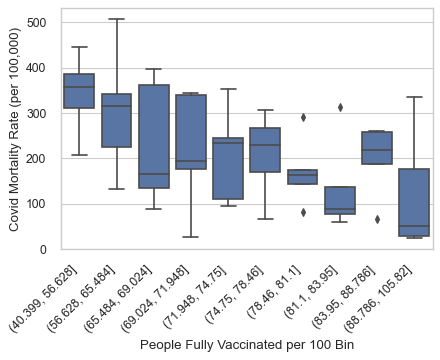

In [97]:
# Create binned peoplefullyvaccinated values
covidhighincomerdd['peoplefullyvaccinated_bin'] = pd.qcut(covidhighincomerdd['people_fully_vaccinated_per_hundred'],10)
covidhighincomerdd['peoplefullyvaccinated_bin'].value_counts()

covidhighincomerdd['over74'] = 0
covidhighincomerdd.loc[covidhighincomerdd['people_fully_vaccinated_per_hundred']>=74.75,'over74'] = 1 
covidhighincomerdd['over74'].value_counts()

# Plot
plt.figure(num=None, figsize=(6, 4), dpi=80, facecolor='w', edgecolor='k')

sns.set(style='whitegrid')
a = sns.boxplot(x='peoplefullyvaccinated_bin', y='coviddeathrate',
              color='b',  data=covidhighincomerdd)
plt.xlabel('People Fully Vaccinated per 100 Bin')
plt.ylabel('Covid Mortality Rate (per 100,000)')
a.set_xticklabels(a.get_xticklabels(), rotation=45, horizontalalignment='right');

In [98]:
re = smf.ols(formula = 'coviddeathrate ~ over74', data = covidhighincomerdd).fit()
print(re.summary())

                            OLS Regression Results                            
Dep. Variable:         coviddeathrate   R-squared:                       0.147
Model:                            OLS   Adj. R-squared:                  0.129
Method:                 Least Squares   F-statistic:                     8.088
Date:                Sun, 16 Apr 2023   Prob (F-statistic):            0.00658
Time:                        16:13:28   Log-Likelihood:                -300.34
No. Observations:                  49   AIC:                             604.7
Df Residuals:                      47   BIC:                             608.5
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    260.4445     23.157     11.247      0.0

In [99]:
#the p-value is actually significant, meaning the RDD is a good choice is this case

Text(0.5, 1.0, 'Regression Discontinuity: Before and After the Cutoff')

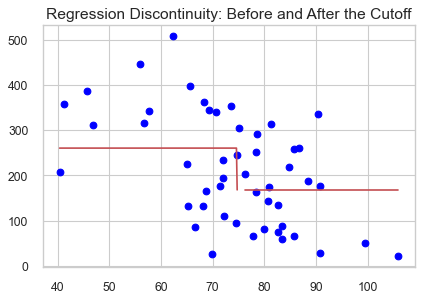

In [100]:
plt.figure(num=None, figsize=(6, 4), dpi=80, facecolor='w', edgecolor='k')
plt.scatter(covidhighincomerdd['people_fully_vaccinated_per_hundred'],covidhighincomerdd['coviddeathrate'], color='blue')
l=covidhighincomerdd.loc[covidhighincomerdd['over74']==0,'over74'].count()
plt.plot(covidhighincomerdd['people_fully_vaccinated_per_hundred'][0:(l-1)], re.predict()[0:(l-1)], '-', color='r')
plt.plot(covidhighincomerdd['people_fully_vaccinated_per_hundred'][l:], re.predict()[l:], '-', color='r')
plt.title('Regression Discontinuity: Before and After the Cutoff', fontsize='14')

In [101]:
#a discontinuity is shown and it's statistically significant
#since it is significant, now it makes sense to say 
#there is a 47% decrease in death rate by people fully vaccinated per hundred 
#above the threshold of 74.75 fully vaccinated people per 100 individuals

## 7.6 Difference-in-Difference

The idea behind DiD is the following: 
The difference in the mean of the outcome between the two groups, treatment group and control group, in the "before" period (A) 
The difference in the mean of the outcome between the two groups, treatment group and control group, in the "after" period (B)
The "second difference", the difference between (A) and (B), which would be (C)
It measures how the change in outcome differs between the two groups, the average effect of treatment on the treated (ATT)
This difference is attributed to the causal effect of the intervention, difference-in-differences (DiD)

So, 
1. The difference in the mean of the outcome between the treatment group and control group
before the intervention (A)
2. The difference in the mean of the outcome between the treatment group and control group
after the intervention (B)
3. The difference between (A) and (B), which is the "second difference", DiD estimate

To do this there are some assumptions that need to be met when designing the treatment and control groups, they are:

1. Parallel trends: the treatment and control groups have parallel trends in the outcome. 
Meaning that in the absence of the intervention, the difference between the treatment and control group is constant over time. 
To see this, a good way is to plot and visually inspect if the parallel trends hold.
2. No spillover effects.
3. The characteristics of the treatment and control groups are stable over the study period.

In [102]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [103]:
covidvisual.shape

(149, 43)

In [104]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546


to ilustrate a DiD, the best idea would be to have two different periods in time, for example when the vaccines started being 
applied. The period would be before the vaccines were applied and after, the treatment group the countries that received 
the vaccines and the control group the countries that did not receive vaccines. For a good counterfactual countries within 
the same income group could be chosen as treatment group (the ones that received that vaccines) and the control group 
the ones that did not receive the vaccines, in this case differences-in-differences-in-differences could be used, since 
the income groups would be interacted, or just differences-in-dinfferences with a dummy variable for income
but this is not the case, the data does not have two periods, so to apply the method I'll use 
the median date, how it is affecting the covid death rate

In [105]:
#there's the need to create the dummies and interaction

In [106]:
covidvisual.sort_values('date', ascending = False)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
66,Israel,ISR,31.5000,34.7500,22,0.919,82.2550,16.050890,13.344866,41523.74319,4.885265e+11,52170.711862,8.611990,1.492288,4.319,Middle East & North Africa,High income,18647371,2023-04-04,6722955,6159577,234491.0,185556,197.35,71.15,65.19,19638,Israel,"4,815,175",NaN,12404,NaN,"4,794,621",NaN,"8,150",57,"41,373,364",9326000,Asia,NaN,NaN,874,133.004504
20,Bulgaria,BGR,43.0000,25.0000,68,0.795,71.7980,13.897290,11.413180,23078.95595,8.405631e+10,12221.496606,7.634610,3.297744,5.270,Europe & Central Asia,Upper middle income,4610850,2023-04-04,2107140,2076682,38117.0,27038,67.99,31.07,30.62,3987,Bulgaria,"1,300,621",NaN,38269,NaN,"1,259,702",NaN,"2,650",38,"11,130,747",6844597,Europe,NaN,NaN,387,559.112538
78,Lithuania,LTU,56.0000,24.0000,35,0.875,73.7201,16.285061,13.498100,37931.30359,6.644526e+10,23723.340251,5.981032,4.683544,7.110,Europe & Central Asia,High income,4545410,2023-04-04,1957051,1880393,41195.0,27613,165.28,71.16,68.38,10041,Lithuania,"1,315,338",+269,9642,1.0,"1,300,462",+383,"5,234",5,"10,419,935",2661708,Europe,101.0,0.4,"1,966",362.248601
143,Uruguay,URY,-33.0000,-56.0000,58,0.809,75.4356,16.832600,8.982550,21268.88122,5.931948e+10,17313.188348,4.367009,7.747914,9.290,Latin America & Caribbean,High income,9011643,2023-04-04,3009451,2902021,169667.0,49511,263.28,87.92,84.79,14465,Uruguay,"1,036,159",NaN,7621,NaN,"1,027,930",NaN,608,18,"6,114,822",3496016,South America,NaN,NaN,174,217.990993
85,Malta,MLT,35.8333,14.5833,23,0.918,83.7769,16.838570,12.210260,38884.45623,1.736404e+10,33486.671984,10.297764,1.497892,3.530,Middle East & North Africa,High income,1380764,2023-04-04,478768,471505,17371.0,8191,258.91,89.78,88.41,15359,Malta,"118,133",NaN,832,NaN,"116,641",NaN,660,4,"2,127,851",444033,Europe,NaN,NaN,"1,486",187.373461
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
130,Suriname,SUR,4.0000,-56.0000,99,0.730,70.2743,13.035644,9.776801,12672.20033,2.984706e+09,4869.134226,-2.729619,59.111710,9.078,Latin America & Caribbean,Upper middle income,505699,2022-05-23,267820,237879,9775.0,6238,81.82,43.33,38.49,10093,Suriname,"82,495",NaN,1404,NaN,NaN,NaN,NaN,NaN,"241,666",596831,South America,NaN,NaN,"52,502",235.242472
90,Mongolia,MNG,46.0000,105.0000,96,0.739,70.9754,14.980350,9.423700,10588.22532,1.528644e+10,4566.140154,1.636770,7.352812,7.750,East Asia & Pacific,Lower middle income,5492919,2022-05-18,2272965,2175617,827202.0,125462,161.63,66.88,64.02,36918,Mongolia,"1,007,911",NaN,2179,NaN,"1,005,728",NaN,4,192,"4,030,048",3378078,Asia,NaN,NaN,1,64.504135
60,Iceland,ISL,65.0000,-18.0000,3,0.959,82.6782,19.163059,13.767170,55782.04981,2.560242e+10,68727.636665,4.403045,4.444240,6.020,Europe & Central Asia,High income,805469,2022-03-29,309770,290193,21266.0,7546,216.00,83.07,77.82,20236,Iceland,"209,191",NaN,229,NaN,NaN,NaN,NaN,2,"1,996,384",345393,Europe,NaN,NaN,"385,871",66.301286
140,Ukraine,UKR,49.0000,32.0000,77,0.773,71.6240,14.956569,11.131420,13255.50977,2.000855e+11,4835.571777,3.400000,9.363139,9.830,Europe & Central Asia,Lower middle income,31668577,2022-02-27,15774300,15153577,

In [107]:
covidvisual['date'].max()

'2023-04-04'

In [108]:
covidvisual['date'].min()

'2022-01-29'

In [109]:
covidvisual['date'].astype('datetime64[ns]').quantile(0.5, interpolation='midpoint')

Timestamp('2023-03-17 00:00:00')

In [110]:
covidvisual.dtypes

Country                                    object
Country Code                               object
Latitude                                  float64
Longitude                                 float64
HDI rank                                    int64
Human Development Index 2021 (HDI)        float64
Life expectancy at birth                  float64
Expected years of schooling               float64
Mean years of schooling                   float64
Gross national income (GNI) per capita    float64
GDP 2021 (US$)                            float64
GDP per capita 2021 (US$)                 float64
GDP growth 2021 (annual %)                float64
Inflation Rate 2021 (%)                   float64
Unemployment Rate 2021 (%)                float64
Region                                     object
IncomeGroup                                object
total_vaccinations                          int64
date                                       object
people_vaccinated                           int64


In [111]:
#covidvisual['date'] = pd.to_datetime(covidvisual['date']) it's better not to convert to timestamp

In [112]:
covidvisual['date'].describe()

count            149
unique            75
top       2023-03-26
freq              13
Name: date, dtype: object

In [113]:
#covidvisual['date'].median() #this works when converted to timestamp 
#the median Timestamp('2023-03-17 00:00:00') will change when the code is run again with the data updated

In [114]:
covidvisual['people_fully_vaccinated_per_hundred'].describe()

count    149.000000
mean      56.137584
std       24.003123
min        0.260000
25%       37.800000
50%       62.310000
75%       75.190000
max      105.820000
Name: people_fully_vaccinated_per_hundred, dtype: float64

In [115]:
covidvisual['date']

0      2023-03-19
1      2022-09-04
2      2023-03-26
3      2023-03-05
4      2023-02-02
          ...    
144    2023-03-05
145    2023-02-20
146    2023-03-09
147    2023-03-15
148    2022-10-09
Name: date, Length: 149, dtype: object

In [116]:
len(covidvisual[covidvisual['date'] < '2023-03-17'])

73

In [117]:
len(covidvisual[covidvisual['date'] > '2023-03-17'])

74

In [118]:
len(covidvisual[covidvisual['date'] == '2023-03-17'])

2

In [119]:
len(covidvisual[covidvisual['IncomeGroup']=='Low income'])

16

I'll choose two periods, before 2023-03-17 and after, for treatment and control 
in the low income group the treatment for the countries who received the vaccines (16 countries), and as control 
the countries who did not receive the vaccines

In [120]:
covidvisual['IncomeGroup']

0      Upper middle income
1      Lower middle income
2      Lower middle income
3      Upper middle income
4              High income
              ...         
144    Lower middle income
145    Lower middle income
146    Lower middle income
147             Low income
148    Lower middle income
Name: IncomeGroup, Length: 149, dtype: object

In [121]:
(covidvisual[covidvisual['IncomeGroup']=='Low income']).isna().sum()

Country                                    0
Country Code                               0
Latitude                                   0
Longitude                                  0
HDI rank                                   0
Human Development Index 2021 (HDI)         0
Life expectancy at birth                   0
Expected years of schooling                0
Mean years of schooling                    0
Gross national income (GNI) per capita     0
GDP 2021 (US$)                             0
GDP per capita 2021 (US$)                  0
GDP growth 2021 (annual %)                 0
Inflation Rate 2021 (%)                    0
Unemployment Rate 2021 (%)                 0
Region                                     0
IncomeGroup                                0
total_vaccinations                         0
date                                       0
people_vaccinated                          0
people_fully_vaccinated                    0
daily_vaccinations_raw                     3
daily_vacc

In [122]:
covidlowincome = covidvisual[covidvisual['IncomeGroup']=='Low income']

In [123]:
covidlowincome.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
21,Burkina Faso,BFA,13.0,-2.0,184,0.449,59.2696,9.142100,2.114962,2117.915916,1.973762e+10,893.077156,6.906342,3.653533,5.232,Sub-Saharan Africa,Low income,6674010,2023-03-19,5152110,4129254,NaN,39484,29.43,22.72,18.21,1741,Burkina Faso,"22,056",NaN,396,NaN,"21,596",NaN,64,NaN,"248,995",22102838,Africa,NaN,NaN,3,1.791625
22,Burundi,BDI,-3.5,30.0,187,0.426,61.6627,10.722722,3.129267,731.786709,2.779813e+09,221.477676,1.795300,8.404538,1.132,Sub-Saharan Africa,Low income,35772,2023-03-19,33814,33225,109.0,410,0.28,0.26,0.26,32,Burundi,"53,686",NaN,38,NaN,"53,569",NaN,79,NaN,"345,742",12624840,Africa,NaN,NaN,6,0.300994
27,Central African Republic,CAF,7.0,21.0,188,0.404,53.8947,8.040172,4.334000,966.058611,2.516498e+09,461.137490,0.900000,4.259364,6.458,Sub-Saharan Africa,Low income,2689234,2023-03-26,2381935,2266531,12887.0,25469,48.20,42.69,40.63,4565,CAF,"15,368",NaN,113,NaN,"15,200",NaN,55,2,"81,294",5016678,Africa,NaN,NaN,11,2.252487


In [124]:
covidlowincome['people_fully_vaccinated_per_hundred'].fillna(0).apply(np.ceil).astype(int)

21     19
22      1
27     41
43     31
47     20
53     35
54     18
81      9
84     15
93     57
99     21
115    72
121    49
129    29
139    28
147    44
Name: people_fully_vaccinated_per_hundred, dtype: int32

In [125]:
covidlowincome['people_fully_vaccinated_per_hundred']=covidlowincome['people_fully_vaccinated_per_hundred'].fillna(0).apply(np.ceil).astype(int)

<ipython-input-125-9074147ca381>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [126]:
covidlowincome['people_fully_vaccinated_per_hundred']

21     19
22      1
27     41
43     31
47     20
53     35
54     18
81      9
84     15
93     57
99     21
115    72
121    49
129    29
139    28
147    44
Name: people_fully_vaccinated_per_hundred, dtype: int32

In [127]:
covidlowincome.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
21,Burkina Faso,BFA,13.0,-2.0,184,0.449,59.2696,9.142100,2.114962,2117.915916,1.973762e+10,893.077156,6.906342,3.653533,5.232,Sub-Saharan Africa,Low income,6674010,2023-03-19,5152110,4129254,NaN,39484,29.43,22.72,19,1741,Burkina Faso,"22,056",NaN,396,NaN,"21,596",NaN,64,NaN,"248,995",22102838,Africa,NaN,NaN,3,1.791625
22,Burundi,BDI,-3.5,30.0,187,0.426,61.6627,10.722722,3.129267,731.786709,2.779813e+09,221.477676,1.795300,8.404538,1.132,Sub-Saharan Africa,Low income,35772,2023-03-19,33814,33225,109.0,410,0.28,0.26,1,32,Burundi,"53,686",NaN,38,NaN,"53,569",NaN,79,NaN,"345,742",12624840,Africa,NaN,NaN,6,0.300994
27,Central African Republic,CAF,7.0,21.0,188,0.404,53.8947,8.040172,4.334000,966.058611,2.516498e+09,461.137490,0.900000,4.259364,6.458,Sub-Saharan Africa,Low income,2689234,2023-03-26,2381935,2266531,12887.0,25469,48.20,42.69,41,4565,CAF,"15,368",NaN,113,NaN,"15,200",NaN,55,2,"81,294",5016678,Africa,NaN,NaN,11,2.252487


In [128]:
covidlowincome['Continent'].unique()

array(['Africa'], dtype=object)

In [129]:
covidvisualdummies = pd.get_dummies(covidlowincome, columns=['IncomeGroup', 'Continent']) #drop_first = True)

In [130]:
covidvisualdummies.shape

(16, 43)

In [131]:
covidvisualdummies.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),IncomeGroup_Low income,Continent_Africa
21,Burkina Faso,BFA,13.0,-2.0,184,0.449,59.2696,9.142100,2.114962,2117.915916,1.973762e+10,893.077156,6.906342,3.653533,5.232,Sub-Saharan Africa,6674010,2023-03-19,5152110,4129254,NaN,39484,29.43,22.72,19,1741,Burkina Faso,"22,056",NaN,396,NaN,"21,596",NaN,64,NaN,"248,995",22102838,NaN,NaN,3,1.791625,1,1
22,Burundi,BDI,-3.5,30.0,187,0.426,61.6627,10.722722,3.129267,731.786709,2.779813e+09,221.477676,1.795300,8.404538,1.132,Sub-Saharan Africa,35772,2023-03-19,33814,33225,109.0,410,0.28,0.26,1,32,Burundi,"53,686",NaN,38,NaN,"53,569",NaN,79,NaN,"345,742",12624840,NaN,NaN,6,0.300994,1,1
27,Central African Republic,CAF,7.0,21.0,188,0.404,53.8947,8.040172,4.334000,966.058611,2.516498e+09,461.137490,0.900000,4.259364,6.458,Sub-Saharan Africa,2689234,2023-03-26,2381935,2266531,12887.0,25469,48.20,42.69,41,4565,CAF,"15,368",NaN,113,NaN,"15,200",NaN,55,2,"81,294",5016678,NaN,NaN,11,2.252487,1,1


In [132]:
covidvisualdummies.sort_values('date', ascending = False)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),IncomeGroup_Low income,Continent_Africa
129,Sudan,SDN,15.0000,30.0000,172,0.508,65.2667,7.945188,3.820000,3575.190840,3.432606e+10,751.821350,-1.868520,382.815998,19.049999,Sub-Saharan Africa,22598737,2023-04-02,15207452,13416394,20715.0,159116,48.21,32.44,29,3395,Sudan,"63,922",NaN,5034,NaN,"58,603",NaN,285,NaN,"562,941",45992020,NaN,NaN,6,10.945377,1,1
27,Central African Republic,CAF,7.0000,21.0000,188,0.404,53.8947,8.040172,4.334000,966.058611,2.516498e+09,461.137490,0.900000,4.259364,6.458000,Sub-Saharan Africa,2689234,2023-03-26,2381935,2266531,12887.0,25469,48.20,42.69,41,4565,CAF,"15,368",NaN,113,NaN,"15,200",NaN,55,2,"81,294",5016678,NaN,NaN,11,2.252487,1,1
43,Ethiopia,ETH,8.0000,38.0000,175,0.498,64.9748,9.651071,3.201521,2361.069604,1.112711e+11,925.077428,5.637303,26.839522,3.930000,Sub-Saharan Africa,53805400,2023-03-26,43896866,37465340,1866822.0,2808915,43.61,35.58,31,22766,Ethiopia,"500,659",+21,7573,NaN,"487,690",+7,"5,396",1,"5,523,562",120812698,0.2,NaN,45,6.268381,1,1
54,Guinea-Bissau,GNB,12.0000,-15.0000,177,0.483,59.6523,10.613063,3.583719,1908.241590,1.638518e+09,795.118569,3.800002,2.242489,3.687000,Sub-Saharan Africa,594450,2023-03-26,545131,363442,1658.0,17553,28.23,25.89,18,8336,Guinea-Bissau,"9,230",NaN,176,NaN,"8,720",NaN,334,6,"145,231",2063367,NaN,NaN,162,8.529748,1,1
81,Madagascar,MDG,-20.0000,47.0000,173,0.501,64.4853,10.134991,5.120469,1483.520983,1.447260e+10,500.511032,4.402340,5.812251,2.310000,Sub-Saharan Africa,2787212,2023-03-26,2502027,2423671,13544.0,12101,9.41,8.45,9,409,Madagascar,"68,105",NaN,1424,NaN,"66,566",NaN,115,NaN,"528,968",29178077,NaN,NaN,4,4.880376,1,1
121,Sierra Leone,SLE,8.5000,-11.5000,181,0.477,60.0624,9.573391,4.576081,1621.512579,4.042238e+09,480.039211,4.104700,11.873959,3.697000,Sub-Saharan Africa,7548308,2023-03-26,5015637,4197335,6053.0,60860,87.71,58.28,49,7072,Sierra Leone,"7,762",NaN,126,NaN,NaN,NaN,NaN,NaN,"259,958",8306436,NaN,NaN,330,1.516896,1,1
139,Uganda,UGA,1.0000,32.0000,166,0.525,62.7048,10.149870,5.730942,2181.436510,4.052979e+10,883.892032,3.536580,2.204572,4.295000,Sub-Saharan Africa,26406936,2023-03-26,19488104,13043107,134275.0,294514,55.89,41.25,28,6233,Uganda,"170,570",NaN,3630,NaN,"100,431",NaN,"66,509",3,"3,012,408",48432863,NaN,NaN,"1,373",7.494911,1,1
21,Burkina Faso,BFA,13.0000,-2.0000,184,0.449,59.2696,9.142100,2.114962,2117.915916,1.973762e+10,893.077156,6.906342,3.653533,5.232000,Sub-Saharan Africa,6674010,2023-03-19,5152110,4129254,NaN,39484,29.43,22.72,19,1741,Burkina Faso,"22,056",NaN,396,NaN,"21,596",NaN,64,NaN,"248,995",22102838,NaN,NaN,3,1.791625,1,1
22,Burundi,BDI,-3.5000,30.0000,187,0.426,61.6627,10.722722,3.129267,731.786709,2.779813e+09,221.477676,1.795300,8.404538,1.132000,Sub-Saharan Africa,35772,2023-03-19,33814,33225,109.0,410,0.28,0.26,1,32,Burundi,"53,686",NaN,38,NaN,"53,569",NaN,79,NaN,"345,742",12624840,NaN,NaN,6,0.300994,1,1
47,Gambia,GMB,13.4667,-16.5667,174,0.500,62.0830,9.418626,4.637487,2172.207664,2.038417e+09,772.152395,4.265492,7.370348,4.981000,Sub-Saharan Africa,1444492,2023-03-19,934799,539186,429.0,8164,53.38,34.55,20,3017,Gambia,"12,598",NaN,372,NaN,"12,189",NaN,37,NaN,"155,686",2558482,NaN,NaN,14,14.539872,1,1


In [133]:
covidvisualdummies.dtypes

Country                                    object
Country Code                               object
Latitude                                  float64
Longitude                                 float64
HDI rank                                    int64
Human Development Index 2021 (HDI)        float64
Life expectancy at birth                  float64
Expected years of schooling               float64
Mean years of schooling                   float64
Gross national income (GNI) per capita    float64
GDP 2021 (US$)                            float64
GDP per capita 2021 (US$)                 float64
GDP growth 2021 (annual %)                float64
Inflation Rate 2021 (%)                   float64
Unemployment Rate 2021 (%)                float64
Region                                     object
total_vaccinations                          int64
date                                       object
people_vaccinated                           int64
people_fully_vaccinated                     int64


In [134]:
covidvisualdummies['date'] = covidvisualdummies['date'].str.replace('-','')

In [135]:
covidvisualdummies

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),IncomeGroup_Low income,Continent_Africa
21,Burkina Faso,BFA,13.0000,-2.0000,184,0.449,59.2696,9.142100,2.114962,2117.915916,1.973762e+10,893.077156,6.906342,3.653533,5.232000,Sub-Saharan Africa,6674010,20230319,5152110,4129254,NaN,39484,29.43,22.72,19,1741,Burkina Faso,"22,056",NaN,396,NaN,"21,596",NaN,64,NaN,"248,995",22102838,NaN,NaN,3,1.791625,1,1
22,Burundi,BDI,-3.5000,30.0000,187,0.426,61.6627,10.722722,3.129267,731.786709,2.779813e+09,221.477676,1.795300,8.404538,1.132000,Sub-Saharan Africa,35772,20230319,33814,33225,109.0,410,0.28,0.26,1,32,Burundi,"53,686",NaN,38,NaN,"53,569",NaN,79,NaN,"345,742",12624840,NaN,NaN,6,0.300994,1,1
27,Central African Republic,CAF,7.0000,21.0000,188,0.404,53.8947,8.040172,4.334000,966.058611,2.516498e+09,461.137490,0.900000,4.259364,6.458000,Sub-Saharan Africa,2689234,20230326,2381935,2266531,12887.0,25469,48.20,42.69,41,4565,CAF,"15,368",NaN,113,NaN,"15,200",NaN,55,2,"81,294",5016678,NaN,NaN,11,2.252487,1,1
43,Ethiopia,ETH,8.0000,38.0000,175,0.498,64.9748,9.651071,3.201521,2361.069604,1.112711e+11,925.077428,5.637303,26.839522,3.930000,Sub-Saharan Africa,53805400,20230326,43896866,37465340,1866822.0,2808915,43.61,35.58,31,22766,Ethiopia,"500,659",+21,7573,NaN,"487,690",+7,"5,396",1,"5,523,562",120812698,0.2,NaN,45,6.268381,1,1
47,Gambia,GMB,13.4667,-16.5667,174,0.500,62.0830,9.418626,4.637487,2172.207664,2.038417e+09,772.152395,4.265492,7.370348,4.981000,Sub-Saharan Africa,1444492,20230319,934799,539186,429.0,8164,53.38,34.55,20,3017,Gambia,"12,598",NaN,372,NaN,"12,189",NaN,37,NaN,"155,686",2558482,NaN,NaN,14,14.539872,1,1
53,Guinea,GIN,11.0000,-10.0000,182,0.465,58.8922,9.805297,2.202126,2480.887182,1.609182e+10,1189.175999,3.900000,12.597070,5.820000,Sub-Saharan Africa,10642438,20230319,7677166,4724235,298940.0,172447,76.79,55.39,35,12443,Guinea,"38,280",NaN,467,NaN,"37,757",NaN,56,8,"660,107",13865691,NaN,NaN,4,3.368025,1,1
54,Guinea-Bissau,GNB,12.0000,-15.0000,177,0.483,59.6523,10.613063,3.583719,1908.241590,1.638518e+09,795.118569,3.800002,2.242489,3.687000,Sub-Saharan Africa,594450,20230326,545131,363442,1658.0,17553,28.23,25.89,18,8336,Guinea-Bissau,"9,230",NaN,176,NaN,"8,720",NaN,334,6,"145,231",2063367,NaN,NaN,162,8.529748,1,1
81,Madagascar,MDG,-20.0000,47.0000,173,0.501,64.4853,10.134991,5.120469,1483.520983,1.447260e+10,500.511032,4.402340,5.812251,2.310000,Sub-Saharan Africa,2787212,20230326,2502027,2423671,13544.0,12101,9.41,8.45,9,409,Madagascar,"68,105",NaN,1424,NaN,"66,566",NaN,115,NaN,"528,968",29178077,NaN,NaN,4,4.880376,1,1
84,Mali,MLI,17.0000,-4.0000,186,0.428,58.9414,7.423038,2.310000,2132.629443,1.914046e+10,873.794862,3.052614,3.925603,2.603000,Sub-Saharan Africa,5369445,20230319,3959022,3247719,NaN,58966,23.77,17.52,15,2610,Mali,"33,118",NaN,743,NaN,"32,295",NaN,80,NaN,"801,612",21473764,NaN,NaN,4,3.460036,1,1
93,Mozambique,MOZ,-18.2500,35.0000,185,0.446,59.3247,10.219152,3.197642,1198.073924,1.577676e+10,491.839113,2.363988,5.688487,3.939000,Sub-Saharan Africa,29457535,20230129,18641485,18466955,295812.0,588728,89.35,56.54,57,17857,Mozambique,"233,334",NaN,2242,NaN,"228,805",NaN,"2,287",11,"1,371,127",33089461,NaN,NaN,69,6.775571,1,1


In [136]:
covidvisualdummies.sort_values(by = 'date', ascending = False, inplace = True)

In [137]:
covidvisualdummies

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),IncomeGroup_Low income,Continent_Africa
129,Sudan,SDN,15.0000,30.0000,172,0.508,65.2667,7.945188,3.820000,3575.190840,3.432606e+10,751.821350,-1.868520,382.815998,19.049999,Sub-Saharan Africa,22598737,20230402,15207452,13416394,20715.0,159116,48.21,32.44,29,3395,Sudan,"63,922",NaN,5034,NaN,"58,603",NaN,285,NaN,"562,941",45992020,NaN,NaN,6,10.945377,1,1
27,Central African Republic,CAF,7.0000,21.0000,188,0.404,53.8947,8.040172,4.334000,966.058611,2.516498e+09,461.137490,0.900000,4.259364,6.458000,Sub-Saharan Africa,2689234,20230326,2381935,2266531,12887.0,25469,48.20,42.69,41,4565,CAF,"15,368",NaN,113,NaN,"15,200",NaN,55,2,"81,294",5016678,NaN,NaN,11,2.252487,1,1
43,Ethiopia,ETH,8.0000,38.0000,175,0.498,64.9748,9.651071,3.201521,2361.069604,1.112711e+11,925.077428,5.637303,26.839522,3.930000,Sub-Saharan Africa,53805400,20230326,43896866,37465340,1866822.0,2808915,43.61,35.58,31,22766,Ethiopia,"500,659",+21,7573,NaN,"487,690",+7,"5,396",1,"5,523,562",120812698,0.2,NaN,45,6.268381,1,1
54,Guinea-Bissau,GNB,12.0000,-15.0000,177,0.483,59.6523,10.613063,3.583719,1908.241590,1.638518e+09,795.118569,3.800002,2.242489,3.687000,Sub-Saharan Africa,594450,20230326,545131,363442,1658.0,17553,28.23,25.89,18,8336,Guinea-Bissau,"9,230",NaN,176,NaN,"8,720",NaN,334,6,"145,231",2063367,NaN,NaN,162,8.529748,1,1
81,Madagascar,MDG,-20.0000,47.0000,173,0.501,64.4853,10.134991,5.120469,1483.520983,1.447260e+10,500.511032,4.402340,5.812251,2.310000,Sub-Saharan Africa,2787212,20230326,2502027,2423671,13544.0,12101,9.41,8.45,9,409,Madagascar,"68,105",NaN,1424,NaN,"66,566",NaN,115,NaN,"528,968",29178077,NaN,NaN,4,4.880376,1,1
121,Sierra Leone,SLE,8.5000,-11.5000,181,0.477,60.0624,9.573391,4.576081,1621.512579,4.042238e+09,480.039211,4.104700,11.873959,3.697000,Sub-Saharan Africa,7548308,20230326,5015637,4197335,6053.0,60860,87.71,58.28,49,7072,Sierra Leone,"7,762",NaN,126,NaN,NaN,NaN,NaN,NaN,"259,958",8306436,NaN,NaN,330,1.516896,1,1
139,Uganda,UGA,1.0000,32.0000,166,0.525,62.7048,10.149870,5.730942,2181.436510,4.052979e+10,883.892032,3.536580,2.204572,4.295000,Sub-Saharan Africa,26406936,20230326,19488104,13043107,134275.0,294514,55.89,41.25,28,6233,Uganda,"170,570",NaN,3630,NaN,"100,431",NaN,"66,509",3,"3,012,408",48432863,NaN,NaN,"1,373",7.494911,1,1
21,Burkina Faso,BFA,13.0000,-2.0000,184,0.449,59.2696,9.142100,2.114962,2117.915916,1.973762e+10,893.077156,6.906342,3.653533,5.232000,Sub-Saharan Africa,6674010,20230319,5152110,4129254,NaN,39484,29.43,22.72,19,1741,Burkina Faso,"22,056",NaN,396,NaN,"21,596",NaN,64,NaN,"248,995",22102838,NaN,NaN,3,1.791625,1,1
22,Burundi,BDI,-3.5000,30.0000,187,0.426,61.6627,10.722722,3.129267,731.786709,2.779813e+09,221.477676,1.795300,8.404538,1.132000,Sub-Saharan Africa,35772,20230319,33814,33225,109.0,410,0.28,0.26,1,32,Burundi,"53,686",NaN,38,NaN,"53,569",NaN,79,NaN,"345,742",12624840,NaN,NaN,6,0.300994,1,1
47,Gambia,GMB,13.4667,-16.5667,174,0.500,62.0830,9.418626,4.637487,2172.207664,2.038417e+09,772.152395,4.265492,7.370348,4.981000,Sub-Saharan Africa,1444492,20230319,934799,539186,429.0,8164,53.38,34.55,20,3017,Gambia,"12,598",NaN,372,NaN,"12,189",NaN,37,NaN,"155,686",2558482,NaN,NaN,14,14.539872,1,1


In [138]:
len(covidvisualdummies['date'])//2

8

In [139]:
covidvisualdummies['date'].iloc[8]

'20230319'

In [140]:
covidvisualdummies['date'] = covidvisualdummies['date'].astype(int)

In [141]:
covidvisualdummies[covidvisualdummies['date'] < 20230319] 

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),IncomeGroup_Low income,Continent_Africa
147,Zambia,ZMB,-15.00,30.0,154,0.565,61.2234,10.928760,7.187091,3217.767739,2.214763e+10,1137.343633,4.598734,22.021234,6.220,Sub-Saharan Africa,12792112,20230315,11158619,8747040,224617.0,180289,63.90,55.74,44,9006,Zambia,"343,687",NaN,4058,NaN,"339,507",NaN,122,NaN,"3,994,061",19470234,NaN,NaN,6,20.842071,1,1
99,Niger,NER,16.00,8.0,189,0.400,61.5763,6.957112,2.116717,1239.866936,1.491500e+10,590.629455,1.387129,3.837868,0.668,Sub-Saharan Africa,7339299,20230312,6217508,5454196,NaN,178386,28.00,23.72,21,6807,Niger,"9,931",NaN,312,NaN,"8,890",NaN,729,1,"254,538",26083660,NaN,NaN,28,1.196151,1,1
93,Mozambique,MOZ,-18.25,35.0,185,0.446,59.3247,10.219152,3.197642,1198.073924,1.577676e+10,491.839113,2.363988,5.688487,3.939,Sub-Saharan Africa,29457535,20230129,18641485,18466955,295812.0,588728,89.35,56.54,57,17857,Mozambique,"233,334",NaN,2242,NaN,"228,805",NaN,"2,287",11,"1,371,127",33089461,NaN,NaN,69,6.775571,1,1
115,Rwanda,RWA,-2.00,30.0,165,0.534,66.0722,11.230970,4.425292,2209.795202,1.107036e+10,822.347989,10.884519,-0.391347,13.315,Sub-Saharan Africa,26106436,20230101,10572981,9897876,211071.0,370105,189.50,76.75,72,26865,Rwanda,"133,194",NaN,1468,NaN,"131,647",NaN,79,NaN,"6,021,981",13600464,NaN,NaN,6,10.793749,1,1


In [142]:
covidvisualdummies.loc[covidvisualdummies['date'] < 20230319, 'date'] = 0
covidvisualdummies.loc[covidvisualdummies['date'] >= 20230319, 'date'] = 1 

In [143]:
covidvisualdummies

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),IncomeGroup_Low income,Continent_Africa
129,Sudan,SDN,15.0000,30.0000,172,0.508,65.2667,7.945188,3.820000,3575.190840,3.432606e+10,751.821350,-1.868520,382.815998,19.049999,Sub-Saharan Africa,22598737,1,15207452,13416394,20715.0,159116,48.21,32.44,29,3395,Sudan,"63,922",NaN,5034,NaN,"58,603",NaN,285,NaN,"562,941",45992020,NaN,NaN,6,10.945377,1,1
27,Central African Republic,CAF,7.0000,21.0000,188,0.404,53.8947,8.040172,4.334000,966.058611,2.516498e+09,461.137490,0.900000,4.259364,6.458000,Sub-Saharan Africa,2689234,1,2381935,2266531,12887.0,25469,48.20,42.69,41,4565,CAF,"15,368",NaN,113,NaN,"15,200",NaN,55,2,"81,294",5016678,NaN,NaN,11,2.252487,1,1
43,Ethiopia,ETH,8.0000,38.0000,175,0.498,64.9748,9.651071,3.201521,2361.069604,1.112711e+11,925.077428,5.637303,26.839522,3.930000,Sub-Saharan Africa,53805400,1,43896866,37465340,1866822.0,2808915,43.61,35.58,31,22766,Ethiopia,"500,659",+21,7573,NaN,"487,690",+7,"5,396",1,"5,523,562",120812698,0.2,NaN,45,6.268381,1,1
54,Guinea-Bissau,GNB,12.0000,-15.0000,177,0.483,59.6523,10.613063,3.583719,1908.241590,1.638518e+09,795.118569,3.800002,2.242489,3.687000,Sub-Saharan Africa,594450,1,545131,363442,1658.0,17553,28.23,25.89,18,8336,Guinea-Bissau,"9,230",NaN,176,NaN,"8,720",NaN,334,6,"145,231",2063367,NaN,NaN,162,8.529748,1,1
81,Madagascar,MDG,-20.0000,47.0000,173,0.501,64.4853,10.134991,5.120469,1483.520983,1.447260e+10,500.511032,4.402340,5.812251,2.310000,Sub-Saharan Africa,2787212,1,2502027,2423671,13544.0,12101,9.41,8.45,9,409,Madagascar,"68,105",NaN,1424,NaN,"66,566",NaN,115,NaN,"528,968",29178077,NaN,NaN,4,4.880376,1,1
121,Sierra Leone,SLE,8.5000,-11.5000,181,0.477,60.0624,9.573391,4.576081,1621.512579,4.042238e+09,480.039211,4.104700,11.873959,3.697000,Sub-Saharan Africa,7548308,1,5015637,4197335,6053.0,60860,87.71,58.28,49,7072,Sierra Leone,"7,762",NaN,126,NaN,NaN,NaN,NaN,NaN,"259,958",8306436,NaN,NaN,330,1.516896,1,1
139,Uganda,UGA,1.0000,32.0000,166,0.525,62.7048,10.149870,5.730942,2181.436510,4.052979e+10,883.892032,3.536580,2.204572,4.295000,Sub-Saharan Africa,26406936,1,19488104,13043107,134275.0,294514,55.89,41.25,28,6233,Uganda,"170,570",NaN,3630,NaN,"100,431",NaN,"66,509",3,"3,012,408",48432863,NaN,NaN,"1,373",7.494911,1,1
21,Burkina Faso,BFA,13.0000,-2.0000,184,0.449,59.2696,9.142100,2.114962,2117.915916,1.973762e+10,893.077156,6.906342,3.653533,5.232000,Sub-Saharan Africa,6674010,1,5152110,4129254,NaN,39484,29.43,22.72,19,1741,Burkina Faso,"22,056",NaN,396,NaN,"21,596",NaN,64,NaN,"248,995",22102838,NaN,NaN,3,1.791625,1,1
22,Burundi,BDI,-3.5000,30.0000,187,0.426,61.6627,10.722722,3.129267,731.786709,2.779813e+09,221.477676,1.795300,8.404538,1.132000,Sub-Saharan Africa,35772,1,33814,33225,109.0,410,0.28,0.26,1,32,Burundi,"53,686",NaN,38,NaN,"53,569",NaN,79,NaN,"345,742",12624840,NaN,NaN,6,0.300994,1,1
47,Gambia,GMB,13.4667,-16.5667,174,0.500,62.0830,9.418626,4.637487,2172.207664,2.038417e+09,772.152395,4.265492,7.370348,4.981000,Sub-Saharan Africa,1444492,1,934799,539186,429.0,8164,53.38,34.55,20,3017,Gambia,"12,598",NaN,372,NaN,"12,189",NaN,37,NaN,"155,686",2558482,NaN,NaN,14,14.539872,1,1


In [144]:
#now there's a need for an interaction term

In [145]:
covidvisualdummies['people_fully_vaccinated_per_hundred']

129    29
27     41
43     31
54     18
81      9
121    49
139    28
21     19
22      1
47     20
53     35
84     15
147    44
99     21
93     57
115    72
Name: people_fully_vaccinated_per_hundred, dtype: int32

In [146]:
covidvisualdummies['date']

129    1
27     1
43     1
54     1
81     1
121    1
139    1
21     1
22     1
47     1
53     1
84     1
147    0
99     0
93     0
115    0
Name: date, dtype: int32

In [147]:
covidvisualdummies['date*people_fully_vaccinated_per_hundred']=covidvisualdummies['date']*covidvisualdummies['people_fully_vaccinated_per_hundred']

In [148]:
covidvisualdummies.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),IncomeGroup_Low income,Continent_Africa,date*people_fully_vaccinated_per_hundred
129,Sudan,SDN,15.0,30.0,172,0.508,65.2667,7.945188,3.820000,3575.190840,3.432606e+10,751.821350,-1.868520,382.815998,19.049999,Sub-Saharan Africa,22598737,1,15207452,13416394,20715.0,159116,48.21,32.44,29,3395,Sudan,"63,922",NaN,5034,NaN,"58,603",NaN,285,NaN,"562,941",45992020,NaN,NaN,6,10.945377,1,1,29
27,Central African Republic,CAF,7.0,21.0,188,0.404,53.8947,8.040172,4.334000,966.058611,2.516498e+09,461.137490,0.900000,4.259364,6.458000,Sub-Saharan Africa,2689234,1,2381935,2266531,12887.0,25469,48.20,42.69,41,4565,CAF,"15,368",NaN,113,NaN,"15,200",NaN,55,2,"81,294",5016678,NaN,NaN,11,2.252487,1,1,41
43,Ethiopia,ETH,8.0,38.0,175,0.498,64.9748,9.651071,3.201521,2361.069604,1.112711e+11,925.077428,5.637303,26.839522,3.930000,Sub-Saharan Africa,53805400,1,43896866,37465340,1866822.0,2808915,43.61,35.58,31,22766,Ethiopia,"500,659",+21,7573,NaN,"487,690",+7,"5,396",1,"5,523,562",120812698,0.2,NaN,45,6.268381,1,1,31


In [149]:
covidvisualdummies.rename({'covid_mortality_rate (per 100000)':'coviddeathrate', 'IncomeGroup_Low income':'lowincomegroup'}, axis = 'columns', inplace = True)

In [150]:
#covidvisualdummies.rename({'Continent_North America':'continent_northamerica'}, axis = 'columns', inplace = True)

In [151]:
model = smf.ols(formula = 'coviddeathrate ~ date*people_fully_vaccinated_per_hundred + Continent_Africa \
                + lowincomegroup', data = covidvisualdummies).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:         coviddeathrate   R-squared:                       0.180
Model:                            OLS   Adj. R-squared:                 -0.025
Method:                 Least Squares   F-statistic:                    0.8800
Date:                Sun, 16 Apr 2023   Prob (F-statistic):              0.479
Time:                        16:13:29   Log-Likelihood:                -48.102
No. Observations:                  16   AIC:                             104.2
Df Residuals:                      12   BIC:                             107.3
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                                               coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------

C:\Users\andre\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:1477: UserWarning:

kurtosistest only valid for n>=20 ... continuing anyway, n=16



The 'date:people_fully_vaccinated_per_hundred' is not statistically significant, meaning that vaccines after the date meantioned has no impact on coviddeathrate, as compared with the date before.

In [152]:
# People Fully Vaccinated in the low income group Before and after the middle date
peoplefullyvaccinated_before = covidvisualdummies.loc[(covidvisualdummies['people_fully_vaccinated_per_hundred']==1) & (covidvisualdummies['date']!=1),'coviddeathrate'].mean()
peoplefullyvaccinated_after  = covidvisualdummies.loc[(covidvisualdummies['people_fully_vaccinated_per_hundred']==1) & (covidvisualdummies['date']==1),'coviddeathrate'].mean()

# People Not Fully Vaccinated in the low income group Before and after the middle date
peoplenotfullyvaccinated_before = covidvisualdummies.loc[(covidvisualdummies['people_fully_vaccinated_per_hundred']!=1) & (covidvisualdummies['date']!=1),'coviddeathrate'].mean()
peoplenotfullyvaccinated_after  = covidvisualdummies.loc[(covidvisualdummies['people_fully_vaccinated_per_hundred']!=1) & (covidvisualdummies['date']==1),'coviddeathrate'].mean()

# People Fully Vaccinated in the low income group Before and after the middle date counterfactual (if no treatment)
peoplefullyvaccinated_counterfactual = peoplefullyvaccinated_before + ( peoplefullyvaccinated_before - peoplenotfullyvaccinated_before )

[peoplefullyvaccinated_before, peoplefullyvaccinated_after,
 peoplenotfullyvaccinated_before,peoplenotfullyvaccinated_after,peoplefullyvaccinated_before,peoplefullyvaccinated_counterfactual]

#it'll present the covid death rate of peoplefullyvaccinated (before and after), peoplenotfullyvaccinated(before and after) and peoplefullyvaccinated counterfactual

[nan, 0.3009939135862316, 9.901885701099854, 5.913430381508476, nan, nan]

<Figure size 320x240 with 0 Axes>

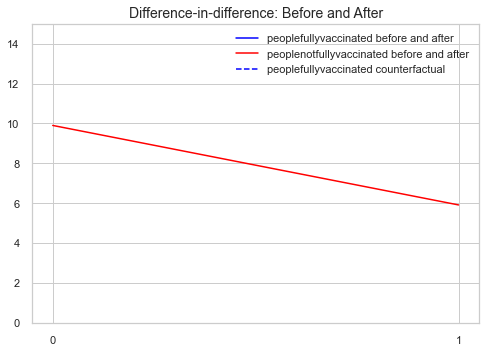

In [153]:
plt.figure(num=None, figsize=(4, 3), dpi=80, facecolor='w', edgecolor='k')
fig, ax = plt.subplots()
linepeoplefullyvaccinated, = ax.plot(['0', '1'], [peoplefullyvaccinated_before, peoplefullyvaccinated_after],color='blue',label='peoplefullyvaccinated before and after')
linepeoplenotfullyvaccinated, = ax.plot(['0', '1'], [peoplenotfullyvaccinated_before, peoplenotfullyvaccinated_after],color = 'red',label = 'peoplenotfullyvaccinated before and after')
linepeoplefullyvaccinated0, = ax.plot(['0', '1'], [peoplefullyvaccinated_before, peoplefullyvaccinated_counterfactual],color = 'blue',linestyle='dashed',label='peoplefullyvaccinated counterfactual')
ax.legend()
plt.ylim(0, 15)  
plt.title("Difference-in-difference: Before and After", fontsize="14");

In [154]:
#the blue line and dotted lines are not showned because of the dates chosen, it had some NaN values when making the counterfactural
#with other dates it will show

### 7.7 More OLS

In [155]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [156]:
covidvisual

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546
3,Armenia,ARM,40.0,45.0,85,0.759,72.0431,13.116760,11.330300,13157.993900,1.386141e+10,4966.513471,5.700000,7.184836,12.729,Europe & Central Asia,Upper middle income,2153341,2023-03-05,1130844,986762,NaN,17910,77.45,40.67,35.49,6441,Armenia,"448,151",NaN,8739,NaN,"435,162",NaN,"4,250",NaN,"3,242,901",2971966,Asia,NaN,NaN,"1,430",294.047778
4,Australia,AUS,-27.0,133.0,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,19856,NaN,"11,264,265",NaN,"43,652",33,"78,835,048",26068792,Australia/Oceania,NaN,NaN,"1,674",76.167703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,Uzbekistan,UZB,41.0,64.0,101,0.727,70.8616,12.477140,11.895590,7916.785725,6.923890e+10,1983.064723,7.420110,10.849240,6.017,Europe & Central Asia,Lower middle income,75503399,2023-03-05,21684856,18144247,720866.0,426314,218.04,62.62,52.40,12311,Uzbekistan,"251,839",NaN,1637,NaN,"241,486",NaN,"8,716",23,"1,377,915",34382084,Asia,NaN,NaN,254,4.761201
145,Vanuatu,VUT,-16.0,167.0,140,0.607,70.4490,11.535315,7.064846,3085.411633,9.563327e+08,2996.621062,0.449256,2.343284,2.118,East Asia & Pacific,Lower middle income,366638,2023-02-20,176624,162250,NaN,8843,112.21,54.06,49.66,27064,Vanuatu,"12,014",NaN,14,NaN,"11,976",NaN,24,NaN,"24,976",321832,Australia/Oceania,NaN,NaN,75,4.350096
146,Viet Nam,VNM,16.0,106.0,115,0.703,73.6181,12.951932,8.370280,7867.371345,3.661376e+11,3756.489121,2.561551,1.834716,2.380,East Asia & Pacific,Lower middle income,266477589,2023-03-09,90497674,86002617,2091069.0,1675471,271.40,92.17,87.59,17064,Vietnam,"11,527,454",+51,43186,NaN,"10,615,014",+23,"869,254",7,"85,826,548",98953541,Asia,0.5,NaN,"8,784",43.642703
147,Zambia,ZMB,-15.0,30.0,154,0.565,61.2234,10.928760,7.187091,3217.767739,2.214763e+10,1137.343633,4.598734,22.021234,6.220,Sub-Saharan Africa,Low income,12792112,2023-03-15,11158619,8747040,224617.0,180289,63.90

In [157]:
covidvisual.shape

(149, 43)

In [158]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546


In [159]:
covidvisual.columns

Index(['Country', 'Country Code', 'Latitude', 'Longitude', 'HDI rank',
       'Human Development Index 2021 (HDI)', 'Life expectancy at birth',
       'Expected years of schooling', 'Mean years of schooling',
       'Gross national income (GNI) per capita', 'GDP 2021 (US$)',
       'GDP per capita 2021 (US$)', 'GDP growth 2021 (annual %)',
       'Inflation Rate 2021 (%)', 'Unemployment Rate 2021 (%)', 'Region',
       'IncomeGroup', 'total_vaccinations', 'date', 'people_vaccinated',
       'people_fully_vaccinated', 'daily_vaccinations_raw',
       'daily_vaccinations', 'total_vaccinations_per_hundred',
       'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'Country,Other', 'TotalCases',
       'NewCases', 'TotalDeaths', 'NewDeaths', 'TotalRecovered',
       'NewRecovered', 'ActiveCases', 'Serious,Critical', 'TotalTests',
       'Population', 'Continent', 'New Cases/1M pop', 'New Deaths/1M pop',
       'Active Cases/1M p

In [160]:
X = covidvisual[['people_fully_vaccinated_per_hundred', 'Human Development Index 2021 (HDI)', 'Unemployment Rate 2021 (%)', 'Inflation Rate 2021 (%)', 'GDP per capita 2021 (US$)', 'GDP 2021 (US$)', 'HDI rank']]
y = covidvisual['covid_mortality_rate (per 100000)']
X = sm.add_constant(X)

In [161]:
model = sm.OLS(y, X, missing='drop')
results = model.fit()
predictions = results.predict(X)
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                    OLS Regression Results                                   
=============================================================================================
Dep. Variable:     covid_mortality_rate (per 100000)   R-squared:                       0.452
Model:                                           OLS   Adj. R-squared:                  0.425
Method:                                Least Squares   F-statistic:                     16.64
Date:                               Sun, 16 Apr 2023   Prob (F-statistic):           6.96e-16
Time:                                       16:13:30   Log-Likelihood:                -902.79
No. Observations:                                149   AIC:                             1822.
Df Residuals:                                    141   BIC:                             1846.
Df Model:                                          7                                         
Covariance Type:                           nonrobust                                         
=======================================================================================================
                                          coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                1029.1086    517.958      1.987      0.049       5.141    2053.076
people_fully_vaccinated_per_hundred    -1.3522      0.500     -2.704      0.008      -2.341      -0.363
Human Development Index 2021 (HDI)   -576.9525    534.415     -1.080      0.282   -1633.455     479.550
Unemployment Rate 2021 (%)              3.5155      1.818      1.933      0.055      -0.079       7.110
Inflation Rate 2021 (%)                -0.0908      0.262     -0.347      0.729      -0.608       0.426
GDP per capita 2021 (US$)              -0.0026      0.001     -4.380      0.000      -0.004      -0.001
GDP 2021 (US$)                       1.712e-12   3.66e-12      0.468      0.641   -5.53e-12    8.95e-12
HDI rank                               -4.1253      1.465     -2.816      0.006      -7.021      -1.230
==============================================================================
Omnibus:                       42.969   Durbin-Watson:                   1.982
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              121.057
Skew:                           1.120   Prob(JB):                     5.16e-27
Kurtosis:                       6.806   Cond. No.                     2.17e+14
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.17e+14. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [162]:
covidvisual.isnull().sum()

Country                                     0
Country Code                                0
Latitude                                    0
Longitude                                   0
HDI rank                                    0
Human Development Index 2021 (HDI)          0
Life expectancy at birth                    0
Expected years of schooling                 0
Mean years of schooling                     0
Gross national income (GNI) per capita      0
GDP 2021 (US$)                              0
GDP per capita 2021 (US$)                   0
GDP growth 2021 (annual %)                  0
Inflation Rate 2021 (%)                     0
Unemployment Rate 2021 (%)                  0
Region                                      0
IncomeGroup                                 0
total_vaccinations                          0
date                                        0
people_vaccinated                           0
people_fully_vaccinated                     0
daily_vaccinations_raw            

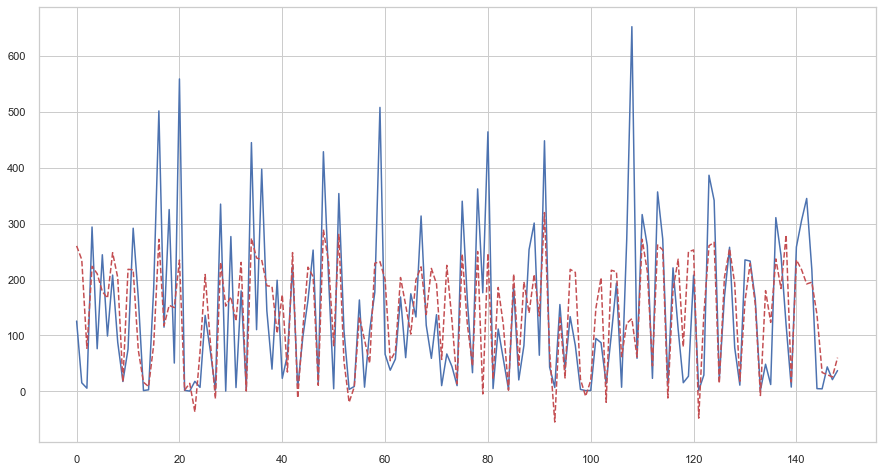

In [163]:
fig = plt.figure(figsize=(15,8))
plt.plot(range(0,len(y)), y.tolist(), 'b')
plt.plot(range(0,len(y)), predictions.tolist(), 'r--')
plt.show()

In [164]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [165]:
covidvisual.head(2)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.11039,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.22546,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049


In [166]:
covidvisuallm = covidvisual.loc[:, ['people_fully_vaccinated_per_hundred','covid_mortality_rate (per 100000)']]

In [167]:
covidvisuallm

,people_fully_vaccinated_per_hundred,covid_mortality_rate (per 100000)
0,44.91,125.663992
1,14.43,15.173049
2,24.25,5.518546
3,35.49,294.047778
4,82.72,76.167703
...,...,...
144,52.40,4.761201
145,49.66,4.350096
146,87.59,43.642703
147,43.70,20.842071


In [168]:
covidvisuallm = covidvisuallm.dropna(subset=['people_fully_vaccinated_per_hundred','covid_mortality_rate (per 100000)'])

In [169]:
covidvisuallm

,people_fully_vaccinated_per_hundred,covid_mortality_rate (per 100000)
0,44.91,125.663992
1,14.43,15.173049
2,24.25,5.518546
3,35.49,294.047778
4,82.72,76.167703
...,...,...
144,52.40,4.761201
145,49.66,4.350096
146,87.59,43.642703
147,43.70,20.842071


In [170]:
X = covidvisuallm['people_fully_vaccinated_per_hundred']
y = covidvisuallm['covid_mortality_rate (per 100000)']

In [171]:
lm = linear_model.LinearRegression()
model = lm.fit(X.values.reshape(-1,1),y)

In [172]:
lm.coef_

array([0.97291559])

In [173]:
lm.intercept_

86.03453683717042

In [174]:
lm.score(X.values.reshape(-1,1),y)

0.02766353880756789

In [175]:
predictions = lm.predict(X.values.reshape(-1,1))
print(predictions[0:5])

[129.72817578 100.07370873 109.62773978 120.56331096 166.51411406]


#### 7.7.1 Robust Linear Regression

In [176]:
X = covidvisuallm['people_fully_vaccinated_per_hundred']
y = covidvisuallm['covid_mortality_rate (per 100000)']

In [177]:
model = sm.RLM(y, X, missing='drop', M=sm.robust.norms.HuberT())
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            Robust linear Model Regression Results                           
=============================================================================================
Dep. Variable:     covid_mortality_rate (per 100000)   No. Observations:                  149
Model:                                           RLM   Df Residuals:                      148
Method:                                         IRLS   Df Model:                            0
Norm:                                         HuberT                                         
Scale Est.:                                      mad                                         
Cov Type:                                         H1                                         
Date:                               Sun, 16 Apr 2023                                         
Time:                                       16:13:31                                         
No. Iterations:                                   13                                         
=======================================================================================================
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
people_fully_vaccinated_per_hundred     2.0444      0.168     12.153      0.000       1.715       2.374
=======================================================================================================

If the model instance has been used for another fit with different fit parameters, then the fit options might not be the correct ones anymore .
"""

In [178]:
X = covidvisuallm['people_fully_vaccinated_per_hundred']
y = covidvisuallm['covid_mortality_rate (per 100000)']
X = sm.add_constant(X)

In [179]:
res = sm.OLS(y, X).fit()
print(res.params)

const                                  86.034537
people_fully_vaccinated_per_hundred     0.972916
dtype: float64


In [180]:
resrlm = sm.RLM(y, X).fit()
print(resrlm.params)

const                                  63.157748
people_fully_vaccinated_per_hundred     1.120952
dtype: float64


### 7.8 Logit Regression

y must be 0 or 1

In [181]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [182]:
covidvisual

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546
3,Armenia,ARM,40.0,45.0,85,0.759,72.0431,13.116760,11.330300,13157.993900,1.386141e+10,4966.513471,5.700000,7.184836,12.729,Europe & Central Asia,Upper middle income,2153341,2023-03-05,1130844,986762,NaN,17910,77.45,40.67,35.49,6441,Armenia,"448,151",NaN,8739,NaN,"435,162",NaN,"4,250",NaN,"3,242,901",2971966,Asia,NaN,NaN,"1,430",294.047778
4,Australia,AUS,-27.0,133.0,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,19856,NaN,"11,264,265",NaN,"43,652",33,"78,835,048",26068792,Australia/Oceania,NaN,NaN,"1,674",76.167703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,Uzbekistan,UZB,41.0,64.0,101,0.727,70.8616,12.477140,11.895590,7916.785725,6.923890e+10,1983.064723,7.420110,10.849240,6.017,Europe & Central Asia,Lower middle income,75503399,2023-03-05,21684856,18144247,720866.0,426314,218.04,62.62,52.40,12311,Uzbekistan,"251,839",NaN,1637,NaN,"241,486",NaN,"8,716",23,"1,377,915",34382084,Asia,NaN,NaN,254,4.761201
145,Vanuatu,VUT,-16.0,167.0,140,0.607,70.4490,11.535315,7.064846,3085.411633,9.563327e+08,2996.621062,0.449256,2.343284,2.118,East Asia & Pacific,Lower middle income,366638,2023-02-20,176624,162250,NaN,8843,112.21,54.06,49.66,27064,Vanuatu,"12,014",NaN,14,NaN,"11,976",NaN,24,NaN,"24,976",321832,Australia/Oceania,NaN,NaN,75,4.350096
146,Viet Nam,VNM,16.0,106.0,115,0.703,73.6181,12.951932,8.370280,7867.371345,3.661376e+11,3756.489121,2.561551,1.834716,2.380,East Asia & Pacific,Lower middle income,266477589,2023-03-09,90497674,86002617,2091069.0,1675471,271.40,92.17,87.59,17064,Vietnam,"11,527,454",+51,43186,NaN,"10,615,014",+23,"869,254",7,"85,826,548",98953541,Asia,0.5,NaN,"8,784",43.642703
147,Zambia,ZMB,-15.0,30.0,154,0.565,61.2234,10.928760,7.187091,3217.767739,2.214763e+10,1137.343633,4.598734,22.021234,6.220,Sub-Saharan Africa,Low income,12792112,2023-03-15,11158619,8747040,224617.0,180289,63.90

In [183]:
covidvisual['IncomeGroup']

0      Upper middle income
1      Lower middle income
2      Lower middle income
3      Upper middle income
4              High income
              ...         
144    Lower middle income
145    Lower middle income
146    Lower middle income
147             Low income
148    Lower middle income
Name: IncomeGroup, Length: 149, dtype: object

In [184]:
#y = covidvisual['IncomeGroup']
covidvisualdum = covidvisual.drop('IncomeGroup',1)

<ipython-input-184-b830d2a71709>:2: FutureWarning:

In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only



In [185]:
covidvisualdum.head(2)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.11039,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.22546,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049


In [186]:
dummie_incomegroup = pd.get_dummies(covidvisual['IncomeGroup'],prefix='dum')

In [187]:
dummie_incomegroup.head(3)

,dum_High income,dum_Low income,dum_Lower middle income,dum_Upper middle income
0,0,0,0,1
1,0,0,1,0
2,0,0,1,0


In [188]:
coviddummies = pd.concat([covidvisualdum, dummie_incomegroup], axis = 1)

In [189]:
coviddummies.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),dum_High income,dum_Low income,dum_Lower middle income,dum_Upper middle income
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992,0,0,0,1
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049,0,0,1,0
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546,0,0,1,0


In [190]:
coviddummies1 = coviddummies.loc[:, ['people_fully_vaccinated_per_hundred','covid_mortality_rate (per 100000)','dum_High income']]

In [191]:
coviddummies1.head(3)

,people_fully_vaccinated_per_hundred,covid_mortality_rate (per 100000),dum_High income
0,44.91,125.663992,0
1,14.43,15.173049,0
2,24.25,5.518546,0


In [192]:
coviddummies1 = coviddummies1.dropna()
#coviddummies1= covidvisuallm.dropna(subset=['people_fully_vaccinated_per_hundred','covid_mortality_rate (per 100000)','dum_High income'])

In [193]:
coviddummies1.head(3)

,people_fully_vaccinated_per_hundred,covid_mortality_rate (per 100000),dum_High income
0,44.91,125.663992,0
1,14.43,15.173049,0
2,24.25,5.518546,0


In [194]:
coviddummies1.shape

(149, 3)

In [195]:
Y = coviddummies1['dum_High income']

In [196]:
Y.head(3)

0    0
1    0
2    0
Name: dum_High income, dtype: uint8

In [197]:
X = coviddummies1[['covid_mortality_rate (per 100000)', 'people_fully_vaccinated_per_hundred']]

In [198]:
X.head(3)

,covid_mortality_rate (per 100000),people_fully_vaccinated_per_hundred
0,125.663992,44.91
1,15.173049,14.43
2,5.518546,24.25


In [199]:
X = sm.add_constant(X)

In [200]:
X.head(3)

,const,covid_mortality_rate (per 100000),people_fully_vaccinated_per_hundred
0,1.0,125.663992,44.91
1,1.0,15.173049,14.43
2,1.0,5.518546,24.25


In [201]:
logit_mod = sm.Logit(Y,X)

In [202]:
logit_res = logit_mod.fit()
logit_res.summary()

Optimization terminated successfully.
         Current function value: inf
         Iterations 8


C:\Users\andre\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1819: RuntimeWarning:

overflow encountered in exp

C:\Users\andre\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1872: RuntimeWarning:

divide by zero encountered in log

C:\Users\andre\anaconda3\lib\site-packages\statsmodels\base\model.py:592: HessianInversionWarning:

Inverting hessian failed, no bse or cov_params available

C:\Users\andre\anaconda3\lib\site-packages\statsmodels\base\model.py:592: HessianInversionWarning:

Inverting hessian failed, no bse or cov_params available



<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:        dum_High income   No. Observations:                  149
Model:                          Logit   Df Residuals:                      146
Method:                           MLE   Df Model:                            2
Date:                Sun, 16 Apr 2023   Pseudo R-squ.:                     inf
Time:                        16:13:31   Log-Likelihood:                   -inf
converged:                       True   LL-Null:                        0.0000
Covariance Type:            nonrobust   LLR p-value:                     1.000
=======================================================================================================
                                          coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                  -8.1190      1.456     -5.576      0.000     -10.973      -5.265
covid_mortality_rate (per 100000)       0.0089      0.002      4.322      0.000       0.005       0.013
people_fully_vaccinated_per_hundred     0.0927      0.018      5.277      0.000       0.058       0.127
=======================================================================================================
"""

In [203]:
logit_res.summary2()

<class 'statsmodels.iolib.summary2.Summary'>
"""
                                   Results: Logit
====================================================================================
Model:                       Logit                   Pseudo R-squared:        inf   
Dependent Variable:          dum_High income         AIC:                     inf   
Date:                        2023-04-16 16:13        BIC:                     inf   
No. Observations:            149                     Log-Likelihood:          -inf  
Df Model:                    2                       LL-Null:                 0.0000
Df Residuals:                146                     LLR p-value:             1.0000
Converged:                   1.0000                  Scale:                   1.0000
No. Iterations:              8.0000                                                 
------------------------------------------------------------------------------------
                                     Coef.  Std.Err.    z    P>|z|   [0.025   0.975]
------------------------------------------------------------------------------------
const                               -8.1190   1.4560 -5.5761 0.0000 -10.9728 -5.2652
covid_mortality_rate (per 100000)    0.0089   0.0021  4.3225 0.0000   0.0049  0.0130
people_fully_vaccinated_per_hundred  0.0927   0.0176  5.2773 0.0000   0.0583  0.1271
====================================================================================

"""

In [204]:
logit_res.get_margeff(at='overall', method='dydx').summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
        Logit Marginal Effects       
=====================================
Dep. Variable:        dum_High income
Method:                          dydx
At:                           overall
=======================================================================================================
                                         dy/dx    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
covid_mortality_rate (per 100000)       0.0011      0.000      6.111      0.000       0.001       0.001
people_fully_vaccinated_per_hundred     0.0117      0.001     10.549      0.000       0.010       0.014
=======================================================================================================
"""

### 7.9 Quantile Regression

In [205]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [206]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546


In [207]:
covidvisual.rename({'covid_mortality_rate (per 100000)':'coviddeathrateper100k'}, axis='columns', inplace = True)

In [208]:
covidvisual.rename({'Human Development Index 2021 (HDI)':'hdi'}, axis='columns', inplace = True)

In [209]:
covidvisual

,Country,Country Code,Latitude,Longitude,HDI rank,hdi,Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),GDP growth 2021 (annual %),Inflation Rate 2021 (%),Unemployment Rate 2021 (%),Region,IncomeGroup,total_vaccinations,date,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,coviddeathrateper100k
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,1.825579e+10,6492.872012,8.515501,2.041472,12.683,Europe & Central Asia,Upper middle income,3070468,2023-03-19,1347054,1276432,23655.0,17565,108.03,47.39,44.91,6180,Albania,"334,663",NaN,3602,NaN,"329,352",NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,1.630444e+11,3690.627878,3.500000,7.226063,11.747,Middle East & North Africa,Lower middle income,15267442,2022-09-04,7840131,6481186,147230.0,256927,34.00,17.46,14.43,5722,Algeria,"271,599",+5,6881,NaN,"182,893",NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,6.740429e+10,1953.533757,1.100000,25.754266,10.384,Sub-Saharan Africa,Lower middle income,24867841,2023-03-26,15510800,8631439,NaN,183173,69.88,43.58,24.25,5147,Angola,"105,316",NaN,1933,NaN,"103,342",NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546
3,Armenia,ARM,40.0,45.0,85,0.759,72.0431,13.116760,11.330300,13157.993900,1.386141e+10,4966.513471,5.700000,7.184836,12.729,Europe & Central Asia,Upper middle income,2153341,2023-03-05,1130844,986762,NaN,17910,77.45,40.67,35.49,6441,Armenia,"448,151",NaN,8739,NaN,"435,162",NaN,"4,250",NaN,"3,242,901",2971966,Asia,NaN,NaN,"1,430",294.047778
4,Australia,AUS,-27.0,133.0,5,0.951,84.5265,21.054590,12.726820,49238.433350,1.552667e+12,60443.109165,2.236212,2.863910,5.120,East Asia & Pacific,High income,63681652,2023-02-02,22236698,21654488,351226.0,295848,243.27,84.95,82.72,11302,Australia,"11,327,773",NaN,19856,NaN,"11,264,265",NaN,"43,652",33,"78,835,048",26068792,Australia/Oceania,NaN,NaN,"1,674",76.167703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,Uzbekistan,UZB,41.0,64.0,101,0.727,70.8616,12.477140,11.895590,7916.785725,6.923890e+10,1983.064723,7.420110,10.849240,6.017,Europe & Central Asia,Lower middle income,75503399,2023-03-05,21684856,18144247,720866.0,426314,218.04,62.62,52.40,12311,Uzbekistan,"251,839",NaN,1637,NaN,"241,486",NaN,"8,716",23,"1,377,915",34382084,Asia,NaN,NaN,254,4.761201
145,Vanuatu,VUT,-16.0,167.0,140,0.607,70.4490,11.535315,7.064846,3085.411633,9.563327e+08,2996.621062,0.449256,2.343284,2.118,East Asia & Pacific,Lower middle income,366638,2023-02-20,176624,162250,NaN,8843,112.21,54.06,49.66,27064,Vanuatu,"12,014",NaN,14,NaN,"11,976",NaN,24,NaN,"24,976",321832,Australia/Oceania,NaN,NaN,75,4.350096
146,Viet Nam,VNM,16.0,106.0,115,0.703,73.6181,12.951932,8.370280,7867.371345,3.661376e+11,3756.489121,2.561551,1.834716,2.380,East Asia & Pacific,Lower middle income,266477589,2023-03-09,90497674,86002617,2091069.0,1675471,271.40,92.17,87.59,17064,Vietnam,"11,527,454",+51,43186,NaN,"10,615,014",+23,"869,254",7,"85,826,548",98953541,Asia,0.5,NaN,"8,784",43.642703
147,Zambia,ZMB,-15.0,30.0,154,0.565,61.2234,10.928760,7.187091,3217.767739,2.214763e+10,1137.343633,4.598734,22.021234,6.220,Sub-Saharan Africa,Low income,12792112,2023-03-15,11158619,8747040,224617.0,180289,63.90,55.74,43.70,9006,Zambia,"343,687",NaN,4058

In [210]:
mod = smf.quantreg('coviddeathrateper100k ~ hdi', covidvisual)
res = mod.fit(q=.5)
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                           QuantReg Regression Results                           
=================================================================================
Dep. Variable:     coviddeathrateper100k   Pseudo R-squared:               0.2280
Model:                          QuantReg   Bandwidth:                       88.59
Method:                    Least Squares   Sparsity:                        236.9
Date:                   Sun, 16 Apr 2023   No. Observations:                  149
Time:                           16:13:32   Df Residuals:                      147
                                           Df Model:                            1
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   -208.1038     49.437     -4.209      0.000    -305.804    -110.404
hdi          425.1182     65.690      6.472      0.000     295.299     554.937
==============================================================================
"""

In [211]:
quantiles = np.arange(.05, .96, .1)
def fit_model(q):
    res = mod.fit(q=q)
    return [q, res.params['Intercept'], res.params['hdi']] + \
            res.conf_int().loc['hdi'].tolist()

models = [fit_model(x) for x in quantiles]
models = pd.DataFrame(models, columns=['q', 'a', 'b', 'lb', 'ub'])

ols = smf.ols('coviddeathrateper100k ~ hdi', covidvisual).fit()
ols_ci = ols.conf_int().loc['hdi'].tolist()
ols = dict(a = ols.params['Intercept'],
           b = ols.params['hdi'],
           lb = ols_ci[0],
           ub = ols_ci[1])

print(models)
print(ols)

      q           a            b          lb           ub
0  0.05  -41.594345    75.691006   10.414789   140.967223
1  0.15  -90.644833   170.274678   83.660055   256.889300
2  0.25 -149.235767   281.666139  182.844734   380.487544
3  0.35 -160.214684   319.063316  204.533511   433.593121
4  0.45 -196.797645   392.965586  266.088531   519.842642
5  0.55 -257.960393   530.579868  386.746564   674.413172
6  0.65 -291.858055   623.001094  467.813636   778.188551
7  0.75 -323.592147   724.685451  555.724593   893.646309
8  0.85 -339.721027   798.173758  611.807092   984.540423
9  0.95 -418.918326  1042.502010  716.176235  1368.827786
{'a': -238.59805394866953, 'b': 513.9305743433147, 'lb': 384.254036553393, 'ub': 643.6071121332363}


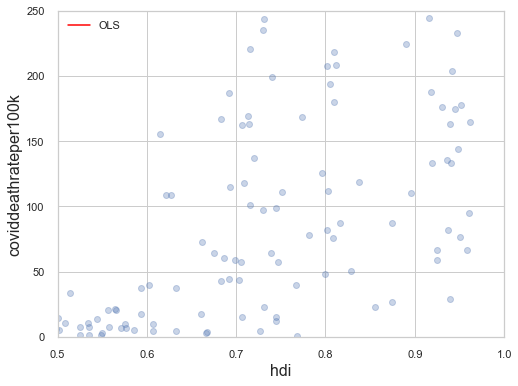

In [212]:
x = np.arange(covidvisual.hdi.min(), covidvisual.hdi.max(), 50)
get_y = lambda a, b: a + b * x

fig, ax = plt.subplots(figsize=(8, 6))

for i in range(models.shape[0]):
    y = get_y(models.a[i], models.b[i])
    ax.plot(x, y, linestyle='dotted', color='grey')

y = get_y(ols['a'], ols['b'])

ax.plot(x, y, color='red', label='OLS')
ax.scatter(covidvisual.hdi, covidvisual.coviddeathrateper100k, alpha=.3)
ax.set_xlim((0.5, 1))
ax.set_ylim((0, 250))
legend = ax.legend()
ax.set_xlabel('hdi', fontsize=16)
ax.set_ylabel('coviddeathrateper100k', fontsize=16);

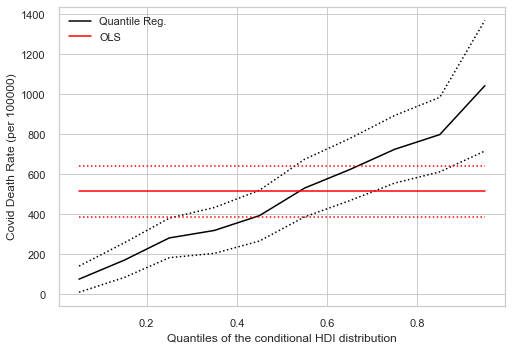

In [213]:
n = models.shape[0]
p1 = plt.plot(models.q, models.b, color='black', label='Quantile Reg.')
p2 = plt.plot(models.q, models.ub, linestyle='dotted', color='black')
p3 = plt.plot(models.q, models.lb, linestyle='dotted', color='black')
p4 = plt.plot(models.q, [ols['b']] * n, color='red', label='OLS')
p5 = plt.plot(models.q, [ols['lb']] * n, linestyle='dotted', color='red')
p6 = plt.plot(models.q, [ols['ub']] * n, linestyle='dotted', color='red')
plt.ylabel(r'Covid Death Rate (per 100000)')
plt.xlabel('Quantiles of the conditional HDI distribution')
plt.legend()
plt.show()

The graph displays estimated coefficients as a function of quantile using a black line, with the OLS estimate of the coefficients shown by the horizontal line. For most of the estimated coefficients in the quantiles, the upper and lower bounds (at a 95% confidence interval) do not fall within the OLS estimate. 
This suggests a notable difference between the OLS estimates and the quantile regression estimates. As a result, it is logical to analyze the Covid death rate by quantiles of the conditional HDI distribution rather than just relying on a regular OLS estimate.

# 8. Spatial Econometrics

In [1]:
import esda
import pandas as pd
import geopandas as gpd
from geopandas import GeoDataFrame
import libpysal as lps
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import Point
%matplotlib inline

In [2]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [3]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,...,NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,...,NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,...,NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546


In [4]:
covidvisual.shape

(149, 43)

In [5]:
covidvisual.columns

Index(['Country', 'Country Code', 'Latitude', 'Longitude', 'HDI rank',
       'Human Development Index 2021 (HDI)', 'Life expectancy at birth',
       'Expected years of schooling', 'Mean years of schooling',
       'Gross national income (GNI) per capita', 'GDP 2021 (US$)',
       'GDP per capita 2021 (US$)', 'GDP growth 2021 (annual %)',
       'Inflation Rate 2021 (%)', 'Unemployment Rate 2021 (%)', 'Region',
       'IncomeGroup', 'total_vaccinations', 'date', 'people_vaccinated',
       'people_fully_vaccinated', 'daily_vaccinations_raw',
       'daily_vaccinations', 'total_vaccinations_per_hundred',
       'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'Country,Other', 'TotalCases',
       'NewCases', 'TotalDeaths', 'NewDeaths', 'TotalRecovered',
       'NewRecovered', 'ActiveCases', 'Serious,Critical', 'TotalTests',
       'Population', 'Continent', 'New Cases/1M pop', 'New Deaths/1M pop',
       'Active Cases/1M p

In [6]:
import shapely
shapely.speedups.disable()

In [7]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

In [8]:
world

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.0,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.0,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."
...,...,...,...,...,...,...
172,7111024,Europe,Serbia,SRB,101800.0,"POLYGON ((18.82982 45.90887, 18.82984 45.90888..."
173,642550,Europe,Montenegro,MNE,10610.0,"POLYGON ((20.07070 42.58863, 19.80161 42.50009..."
174,1895250,Europe,Kosovo,-99,18490.0,"POLYGON ((20.59025 41.85541, 20.52295 42.21787..."
175,1218208,North America,Trinidad and Tobago,TTO,43570.0,"POLYGON ((-61.68000 10.76000, -61.10500 10.890..."


In [9]:
world.drop(['pop_est', 'continent', 'gdp_md_est'], axis = 1, inplace = True)

In [10]:
world.head(3)

,name,iso_a3,geometry
0,Fiji,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,Tanzania,TZA,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,W. Sahara,ESH,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."


In [11]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,...,NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,...,NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,...,NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546


In [12]:
world.rename({'iso_a3':'Country Code'}, axis = 1, inplace = True)

In [13]:
worldmerge = world.merge(covidvisual, how = 'inner', on ='Country Code', indicator = True) 
#in order to preserve the map and to avoid empty spaces on the map, the merge is how='left'

In [14]:
worldmerge.head(3)

,name,Country Code,geometry,Country,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,...,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000),_merge
0,Fiji,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,-18.0,175.0,99,0.730,67.1140,14.736790,...,"1,017",NaN,"669,911",909466,Australia/Oceania,NaN,NaN,"1,118",97.089941,both
1,Tanzania,TZA,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982...",Tanzania,-6.0,35.0,160,0.549,66.2007,9.221490,...,NaN,7,NaN,63298550,Africa,NaN,NaN,662,1.336524,both
2,Canada,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,60.0,-95.0,15,0.936,82.6565,16.396259,...,"32,425",99,"66,343,123",38388419,North America,NaN,NaN,845,135.772718,both


In [15]:
worldmerge.drop('_merge', axis = 1, inplace = True)

In [16]:
worldmerge

,name,Country Code,geometry,Country,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Fiji,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,-18.0000,175.0,99,0.730,67.1140,14.736790,...,NaN,"1,017",NaN,"669,911",909466,Australia/Oceania,NaN,NaN,"1,118",97.089941
1,Tanzania,TZA,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982...",Tanzania,-6.0000,35.0,160,0.549,66.2007,9.221490,...,NaN,NaN,7,NaN,63298550,Africa,NaN,NaN,662,1.336524
2,Canada,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,60.0000,-95.0,15,0.936,82.6565,16.396259,...,NaN,"32,425",99,"66,343,123",38388419,North America,NaN,NaN,845,135.772718
3,United States of America,USA,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",United States,38.0000,-97.0,21,0.921,77.1982,16.280979,...,NaN,"1,062,241","1,895","1,174,878,661",334805269,North America,NaN,NaN,"3,173",345.176169
4,Uzbekistan,UZB,"POLYGON ((55.96819 41.30864, 55.92892 44.99586...",Uzbekistan,41.0000,64.0,101,0.727,70.8616,12.477140,...,NaN,"8,716",23,"1,377,915",34382084,Asia,NaN,NaN,254,4.761201
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
131,Bosnia and Herz.,BIH,"POLYGON ((18.56000 42.65000, 17.67492 43.02856...",Bosnia and Herzegovina,44.0000,18.0,74,0.780,75.3003,13.800000,...,NaN,"6,686",NaN,"1,884,721",3249317,Europe,NaN,NaN,"2,058",501.828538
132,Macedonia,MKD,"POLYGON ((22.38053 42.32026, 22.88137 41.99930...",Macedonia,41.8333,22.0,78,0.770,73.8415,13.624432,...,NaN,758,NaN,"2,226,216",2081304,Europe,NaN,NaN,364,464.420383
133,Serbia,SRB,"POLYGON ((18.82982 45.90887, 18.82984 45.90888...",Serbia,44.0000,21.0,63,0.802,74.1923,14.400090,...,NaN,"14,155",12,"12,648,684",8653016,Europe,NaN,NaN,"1,636",207.788822
134,Montenegro,MNE,"POLYGON ((20.07070 42.58863, 19.80161 42.50009...",Montenegro,42.0000,19.0,49,0.832,76.3426,15.081610,...,+60,679,6,"2,736,615",627950,Europe,97.0,NaN,"1,081",448.443347


<AxesSubplot:>

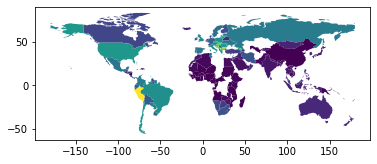

In [17]:
worldmerge.plot(column='covid_mortality_rate (per 100000)')

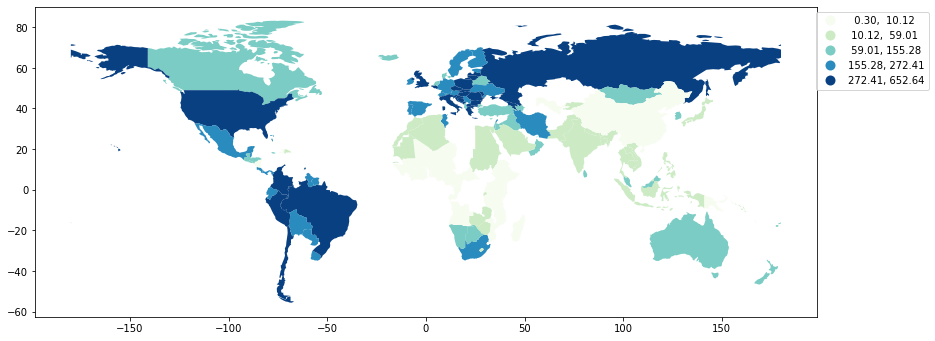

In [18]:
fig, ax = plt.subplots(figsize=(14,10), subplot_kw={'aspect':'equal'})
worldmerge.plot(column='covid_mortality_rate (per 100000)', scheme='Quantiles', k=5, cmap='GnBu', legend=True, ax=ax);
leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0., 1.15, 1.0))
#ax.set_xlim(150000, 160000)
#ax.set_ylim(208000, 215000)

### 8.1 Spatial Autocorrelation

Sometimes, we observe visually-clustered patterns, 
but often there are no discernible statistical patterns, 
thus requiring testing. 
Spatial autocorrelation pertains to the combination of two types of similarity - spatial and attribute similarity.

#### 8.1.1 Spatial Similarity

In [19]:
#queen contiguity for spatial weights is defined
#w = Queen.from_dataframe(df, idVariable='name')
#knn1 = lps.weights.KNN.from_dataframe(df)
#queen = lps.weights.Queen.from_dataframe(df)

#symm_knn = lps.weights.WSP((knn1.sparse + knn1.sparse.T)>0).to_W()

#fully_connected = lps.weights.w_union(symm_knn, queen)

In [20]:
worldmerge

,name,Country Code,geometry,Country,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Fiji,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,-18.0000,175.0,99,0.730,67.1140,14.736790,...,NaN,"1,017",NaN,"669,911",909466,Australia/Oceania,NaN,NaN,"1,118",97.089941
1,Tanzania,TZA,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982...",Tanzania,-6.0000,35.0,160,0.549,66.2007,9.221490,...,NaN,NaN,7,NaN,63298550,Africa,NaN,NaN,662,1.336524
2,Canada,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,60.0000,-95.0,15,0.936,82.6565,16.396259,...,NaN,"32,425",99,"66,343,123",38388419,North America,NaN,NaN,845,135.772718
3,United States of America,USA,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",United States,38.0000,-97.0,21,0.921,77.1982,16.280979,...,NaN,"1,062,241","1,895","1,174,878,661",334805269,North America,NaN,NaN,"3,173",345.176169
4,Uzbekistan,UZB,"POLYGON ((55.96819 41.30864, 55.92892 44.99586...",Uzbekistan,41.0000,64.0,101,0.727,70.8616,12.477140,...,NaN,"8,716",23,"1,377,915",34382084,Asia,NaN,NaN,254,4.761201
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
131,Bosnia and Herz.,BIH,"POLYGON ((18.56000 42.65000, 17.67492 43.02856...",Bosnia and Herzegovina,44.0000,18.0,74,0.780,75.3003,13.800000,...,NaN,"6,686",NaN,"1,884,721",3249317,Europe,NaN,NaN,"2,058",501.828538
132,Macedonia,MKD,"POLYGON ((22.38053 42.32026, 22.88137 41.99930...",Macedonia,41.8333,22.0,78,0.770,73.8415,13.624432,...,NaN,758,NaN,"2,226,216",2081304,Europe,NaN,NaN,364,464.420383
133,Serbia,SRB,"POLYGON ((18.82982 45.90887, 18.82984 45.90888...",Serbia,44.0000,21.0,63,0.802,74.1923,14.400090,...,NaN,"14,155",12,"12,648,684",8653016,Europe,NaN,NaN,"1,636",207.788822
134,Montenegro,MNE,"POLYGON ((20.07070 42.58863, 19.80161 42.50009...",Montenegro,42.0000,19.0,49,0.832,76.3426,15.081610,...,+60,679,6,"2,736,615",627950,Europe,97.0,NaN,"1,081",448.443347


In [21]:
df = worldmerge
wq =  lps.weights.Queen.from_dataframe(df, idVariable = 'Country Code')
wq.transform = 'r'

('WARNING: ', 'FJI', ' is an island (no neighbors)')
('WARNING: ', 'BHS', ' is an island (no neighbors)')
('WARNING: ', 'JAM', ' is an island (no neighbors)')
('WARNING: ', 'MDG', ' is an island (no neighbors)')
('WARNING: ', 'GMB', ' is an island (no neighbors)')
('WARNING: ', 'VUT', ' is an island (no neighbors)')
('WARNING: ', 'KOR', ' is an island (no neighbors)')
('WARNING: ', 'SLB', ' is an island (no neighbors)')
('WARNING: ', 'NZL', ' is an island (no neighbors)')
('WARNING: ', 'AUS', ' is an island (no neighbors)')
('WARNING: ', 'LKA', ' is an island (no neighbors)')
('WARNING: ', 'ISL', ' is an island (no neighbors)')
('WARNING: ', 'PHL', ' is an island (no neighbors)')
('WARNING: ', 'JPN', ' is an island (no neighbors)')
('WARNING: ', 'CYP', ' is an island (no neighbors)')
('WARNING: ', 'TTO', ' is an island (no neighbors)')


C:\Users\andre\anaconda3\lib\site-packages\libpysal\weights\weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 21 disconnected components.
 There are 16 islands with ids: AUS, BHS, CYP, FJI, GMB, ISL, JAM, JPN, KOR, LKA, MDG, NZL, PHL, SLB, TTO, VUT.
  warnings.warn(message)


In [22]:
df = worldmerge
wq =  lps.weights.Queen.from_dataframe(df)
wq.transform = 'r'

('WARNING: ', 0, ' is an island (no neighbors)')
('WARNING: ', 13, ' is an island (no neighbors)')
('WARNING: ', 32, ' is an island (no neighbors)')
('WARNING: ', 56, ' is an island (no neighbors)')
('WARNING: ', 58, ' is an island (no neighbors)')
('WARNING: ', 65, ' is an island (no neighbors)')
('WARNING: ', 70, ' is an island (no neighbors)')
('WARNING: ', 104, ' is an island (no neighbors)')
('WARNING: ', 105, ' is an island (no neighbors)')
('WARNING: ', 106, ' is an island (no neighbors)')
('WARNING: ', 107, ' is an island (no neighbors)')
('WARNING: ', 112, ' is an island (no neighbors)')
('WARNING: ', 115, ' is an island (no neighbors)')
('WARNING: ', 122, ' is an island (no neighbors)')
('WARNING: ', 125, ' is an island (no neighbors)')
('WARNING: ', 135, ' is an island (no neighbors)')


C:\Users\andre\anaconda3\lib\site-packages\libpysal\weights\weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 21 disconnected components.
 There are 16 islands with ids: 0, 13, 32, 56, 58, 65, 70, 104, 105, 106, 107, 112, 115, 122, 125, 135.
  warnings.warn(message)


In [23]:
worldmerge

,name,Country Code,geometry,Country,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Fiji,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,-18.0000,175.0,99,0.730,67.1140,14.736790,...,NaN,"1,017",NaN,"669,911",909466,Australia/Oceania,NaN,NaN,"1,118",97.089941
1,Tanzania,TZA,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982...",Tanzania,-6.0000,35.0,160,0.549,66.2007,9.221490,...,NaN,NaN,7,NaN,63298550,Africa,NaN,NaN,662,1.336524
2,Canada,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,60.0000,-95.0,15,0.936,82.6565,16.396259,...,NaN,"32,425",99,"66,343,123",38388419,North America,NaN,NaN,845,135.772718
3,United States of America,USA,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",United States,38.0000,-97.0,21,0.921,77.1982,16.280979,...,NaN,"1,062,241","1,895","1,174,878,661",334805269,North America,NaN,NaN,"3,173",345.176169
4,Uzbekistan,UZB,"POLYGON ((55.96819 41.30864, 55.92892 44.99586...",Uzbekistan,41.0000,64.0,101,0.727,70.8616,12.477140,...,NaN,"8,716",23,"1,377,915",34382084,Asia,NaN,NaN,254,4.761201
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
131,Bosnia and Herz.,BIH,"POLYGON ((18.56000 42.65000, 17.67492 43.02856...",Bosnia and Herzegovina,44.0000,18.0,74,0.780,75.3003,13.800000,...,NaN,"6,686",NaN,"1,884,721",3249317,Europe,NaN,NaN,"2,058",501.828538
132,Macedonia,MKD,"POLYGON ((22.38053 42.32026, 22.88137 41.99930...",Macedonia,41.8333,22.0,78,0.770,73.8415,13.624432,...,NaN,758,NaN,"2,226,216",2081304,Europe,NaN,NaN,364,464.420383
133,Serbia,SRB,"POLYGON ((18.82982 45.90887, 18.82984 45.90888...",Serbia,44.0000,21.0,63,0.802,74.1923,14.400090,...,NaN,"14,155",12,"12,648,684",8653016,Europe,NaN,NaN,"1,636",207.788822
134,Montenegro,MNE,"POLYGON ((20.07070 42.58863, 19.80161 42.50009...",Montenegro,42.0000,19.0,49,0.832,76.3426,15.081610,...,+60,679,6,"2,736,615",627950,Europe,97.0,NaN,"1,081",448.443347


In [24]:
worldmerge.drop(worldmerge.index[[0, 13, 32, 56, 58, 65, 70, 104, 105, 106, 107, 112, 115, 122, 125, 135]], axis = 0, inplace = True)

In [25]:
worldmerge.reset_index(drop=True, inplace = True)

In [26]:
df = worldmerge
wq =  lps.weights.Queen.from_dataframe(df, idVariable = 'Country Code')
wq.transform = 'r'

C:\Users\andre\anaconda3\lib\site-packages\libpysal\weights\weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 5 disconnected components.
  warnings.warn(message)


#### 8.1.2 Attribute Similarity

The spatial weight between neighborhoods i and j indicates if the two are neighbors. 
The spatial lag is a derived variable that is a measure of attribute of similarity that pairs up with the concept of spatial similarity.
The spatial lag for neighborhood i is as showed in the equation below.

$$ 
ylag_{i} = \sum_{j}w_{i,j}y_{j}
$$

In [27]:
#so, the spatial lag = average of the neighbors 

In [28]:
y = df['covid_mortality_rate (per 100000)']
ylag = lps.weights.lag_spatial(wq, y)

In [29]:
ylag

array([2.25286833e+02, 1.23920121e+02, 7.45408855e+01, 1.42982756e+02,
       1.62136834e+02, 1.36176447e+01, 8.81524279e+01, 2.43354440e+02,
       1.34643779e+02, 1.01093603e+02, 2.51060944e+02, 1.69935045e+02,
       8.39536133e+01, 8.77366644e+01, 1.59716995e+02, 1.39017614e+02,
       5.08116635e+02, 1.04899269e+02, 3.55452728e+02, 1.39874746e+02,
       7.49491105e+00, 3.39943514e+01, 1.89598480e+02, 2.08046866e+02,
       6.35293136e+01, 2.90751821e+02, 1.28981133e+02, 1.20652953e+02,
       2.29415993e+02, 6.42590941e+01, 1.53144378e+02, 3.70415593e+01,
       3.00993914e-01, 2.49053548e+02, 1.44565399e+02, 8.36007671e+01,
       1.76377825e+02, 1.07161236e+02, 8.09399829e+01, 1.68772153e+02,
       2.43743990e+02, 1.99838367e+02, 3.77608473e+01, 1.51297527e+02,
       1.51689606e+00, 1.85470986e+02, 7.69355672e+01, 1.64723051e+02,
       1.48597309e+02, 2.50305590e+02, 1.55284573e+02, 1.58891373e+02,
       4.76622089e+02, 1.72131585e+02, 3.00623979e+00, 2.23171222e+02,
      

In [30]:
import mapclassify as mc
ylagq5 = mc.Quantiles(ylag, k=5)

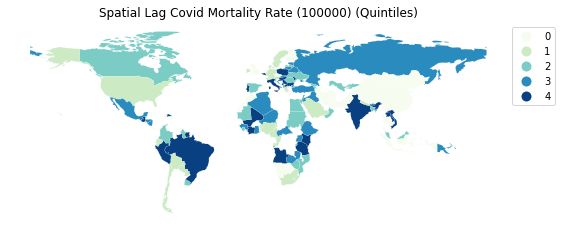

In [31]:
f, ax = plt.subplots(1, figsize=(9, 9))
df.assign(cl=ylagq5.yb).plot(column='cl', categorical=True, \
        k=5, cmap='GnBu', linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0., 1.1, 1.0))
plt.title('Spatial Lag Covid Mortality Rate (100000) (Quintiles)')

plt.show()

In [32]:
#the quintile map for the spatial lag makes us think there's similarity in space

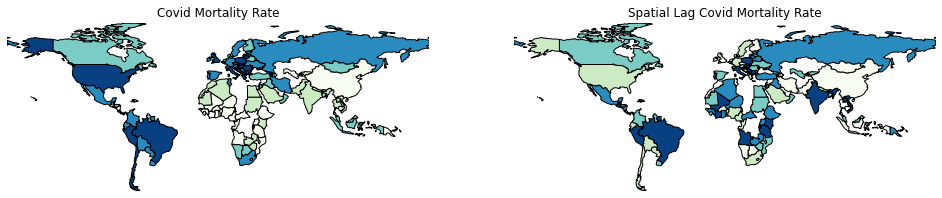

In [33]:
df['lag_coviddeathrate'] = ylag
f,ax = plt.subplots(1,2,figsize=(4.16*4,4))
df.plot(column='covid_mortality_rate (per 100000)', ax=ax[0], edgecolor='k',
        scheme='quantiles',  k=5, cmap='GnBu')
ax[0].axis(df.total_bounds[np.asarray([0,2,1,3])])
ax[0].set_title('Covid Mortality Rate')
df.plot(column='lag_coviddeathrate', ax=ax[1], edgecolor='k',
        scheme='quantiles', cmap='GnBu', k=5)
ax[1].axis(df.total_bounds[np.asarray([0,2,1,3])])
ax[1].set_title('Spatial Lag Covid Mortality Rate')
ax[0].axis('off')
ax[1].axis('off')
plt.show()

In [34]:
#on the left are the values of covid mortality rate and neighbors
#on the right are weighted average of covid death rates' neighbors, which is the spatial lag

### 8.2 Global Spatial Autocorrelation

In [35]:
#converting the attribute to a binary case to see it easily 

In [36]:
y.median()

116.67927528763295

In [37]:
yb = y > y.median()
sum(yb)

60

In [38]:
sum(y < y.median())

60

In [39]:
#there are 60 neighborhoods with covid death rate above the median and 60 (120-60=60) below the median

In [40]:
y

0        1.336524
1      135.772718
2      345.176169
3        4.761201
4        7.210373
          ...    
115     10.793749
116    501.828538
117    464.420383
118    207.788822
119    448.443347
Name: covid_mortality_rate (per 100000), Length: 120, dtype: float64

In [41]:
yb = y > y.median()
labels = ['0 Low', '1 High']
yb = [labels[i] for i in 1*yb] 
df['yb'] = yb

<AxesSubplot:>

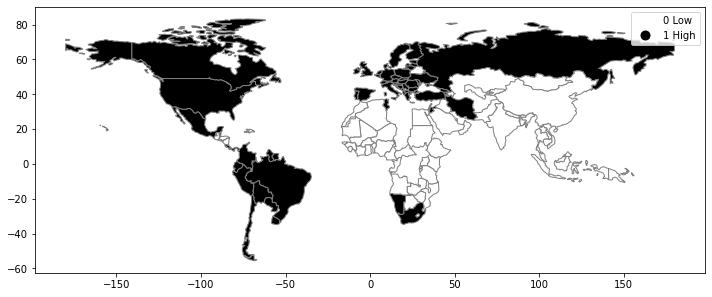

In [42]:
fig, ax = plt.subplots(figsize=(12,10), subplot_kw={'aspect':'equal'})
df.plot(column='yb', cmap='binary', edgecolor='grey', legend=True, ax=ax)

#### 8.2.1 Join Counts

In [43]:
# a join is a way to formalize a test for spatial autocorrelation in a binary attribute, it also exists for each 
#neighbor pair of observations, and the joins are reflected in the binary spatial weights object wq
#each unit can take either Black (B) or White (W), there are three type of joins, BB (black black), WW (white white), BW (black white or white black)
#finding out what is the number of BB joins if the 65 black polygons were randomly assingned on the map

In [44]:
import esda 
yb = 1 * (y > y.median()) # convert back to binary
wq =  lps.weights.Queen.from_dataframe(df)
wq.transform = 'b'
np.random.seed(12345)
jc = esda.join_counts.Join_Counts(yb, wq)

C:\Users\andre\anaconda3\lib\site-packages\libpysal\weights\weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 5 disconnected components.
  warnings.warn(message)


In [45]:
jc.bb

92.0

In [46]:
jc.ww

75.0

In [47]:
jc.bw

31.0

In [48]:
jc.bb + jc.ww + jc.bw #all possibilites

198.0

In [49]:
wq.s0 / 2 #unique number of joins in the spatial weights object

198.0

In [50]:
jc.bb #there are 92 BB joins

92.0

In [51]:
jc.mean_bb #The average number of BB joins from the synthetic realizations is

48.752752752752755

In [52]:
#less than the observed count, but is it enought to reject the null of complete spatial randomness(CSR)

In [53]:
jc.p_sim_bb #the pseudo p-value summarizes that the observed value is extremely high, it'a bellow 1%, rejecting null of CSR, 
#meaning there's autocorrelation in covid death rate

0.001

#### 8.2.2 Continous Case

In [54]:
#transforming the weights to be row-standardized from the current binary state

In [55]:
wq.transform = 'r'

In [56]:
y = df['covid_mortality_rate (per 100000)']

In [57]:
#Moran's I is a test for global autocorrelation for a continuous attribute

In [58]:
np.random.seed(12345)
mi = esda.moran.Moran(y, wq)
mi.I

0.6748124515232901

Text(0.5, 0, "Moran's I")

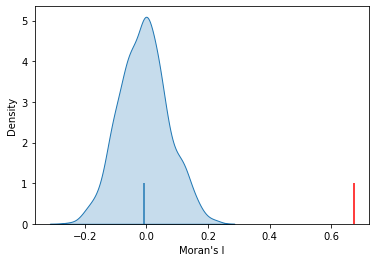

In [59]:
import seaborn as sbn
sbn.kdeplot(mi.sim, shade=True)
plt.vlines(mi.I, 0, 1, color='r')
plt.vlines(mi.EI, 0,1)
plt.xlabel('Moran\'s I')

In [60]:
mi.p_sim

0.001

### 8.3 Local Autocorrelation: Hot Spots, Cold Spots, and Spatial Outliers

In [61]:
#local Moran statistic

In [62]:
np.random.seed(12345)
import esda

In [63]:
wq.transform = 'r'
lag_coviddeathrate = lps.weights.lag_spatial(wq, df['covid_mortality_rate (per 100000)'])

In [64]:
df.rename({'covid_mortality_rate (per 100000)':'coviddeathrate'}, axis = 1, inplace = True)

In [65]:
df.head(3)

,name,Country Code,geometry,Country,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,...,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,coviddeathrate,lag_coviddeathrate,yb
0,Tanzania,TZA,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982...",Tanzania,-6.0,35.0,160,0.549,66.2007,9.221490,...,7,NaN,63298550,Africa,NaN,NaN,662,1.336524,225.286833,0 Low
1,Canada,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,60.0,-95.0,15,0.936,82.6565,16.396259,...,99,"66,343,123",38388419,North America,NaN,NaN,845,135.772718,123.920121,1 High
2,United States of America,USA,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",United States,38.0,-97.0,21,0.921,77.1982,16.280979,...,"1,895","1,174,878,661",334805269,North America,NaN,NaN,"3,173",345.176169,74.540885,1 High


In [66]:
#df = df[df.coviddeathrate != 0]
#df = df[df.lag_coviddeathrate !=0]
df = df.dropna(axis=0, subset=['coviddeathrate','lag_coviddeathrate'])

In [67]:
df['coviddeathrate'].values.reshape(-1,1) #when plotting the graph below there was an error expected x and y to have same length
#that's why the need to reshape, but this would be 2d, it has to be 1d, many errors where found when doing the plotting below
#what worked was reshaping x and y to 1d with values.reshape(-1)

array([[1.33652351e+00],
       [1.35772718e+02],
       [3.45176169e+02],
       [4.76120063e+00],
       [7.21037252e+00],
       [5.76922584e+01],
       [3.35045957e+02],
       [1.01182561e+01],
       [1.09453770e+01],
       [7.36283530e+00],
       [3.96513503e+01],
       [2.72567757e+02],
       [1.68863605e+02],
       [3.32306997e+01],
       [2.53532968e+02],
       [2.17990993e+02],
       [3.25304997e+02],
       [1.86572516e+02],
       [6.52641143e+02],
       [2.76976024e+02],
       [1.93660214e+02],
       [1.79628794e+02],
       [3.31902465e+00],
       [1.08704936e+02],
       [6.45763175e+01],
       [1.08630853e+02],
       [1.66913317e+02],
       [1.63466806e+02],
       [2.35242472e+02],
       [1.98842170e+02],
       [3.70415593e+01],
       [1.14740439e+02],
       [1.55284573e+02],
       [3.46003616e+00],
       [2.03387161e+01],
       [1.27495888e+00],
       [1.19615115e+00],
       [1.45561459e+00],
       [7.05084505e+00],
       [4.51297945e+00],


In [68]:
df['coviddeathrate'].values.reshape(-1)

array([1.33652351e+00, 1.35772718e+02, 3.45176169e+02, 4.76120063e+00,
       7.21037252e+00, 5.76922584e+01, 3.35045957e+02, 1.01182561e+01,
       1.09453770e+01, 7.36283530e+00, 3.96513503e+01, 2.72567757e+02,
       1.68863605e+02, 3.32306997e+01, 2.53532968e+02, 2.17990993e+02,
       3.25304997e+02, 1.86572516e+02, 6.52641143e+02, 2.76976024e+02,
       1.93660214e+02, 1.79628794e+02, 3.31902465e+00, 1.08704936e+02,
       6.45763175e+01, 1.08630853e+02, 1.66913317e+02, 1.63466806e+02,
       2.35242472e+02, 1.98842170e+02, 3.70415593e+01, 1.14740439e+02,
       1.55284573e+02, 3.46003616e+00, 2.03387161e+01, 1.27495888e+00,
       1.19615115e+00, 1.45561459e+00, 7.05084505e+00, 4.51297945e+00,
       3.00623979e+00, 3.36802544e+00, 8.52974774e+00, 1.51689606e+00,
       1.79162513e+00, 2.25248661e+00, 6.65769201e+00, 2.08420710e+01,
       6.77557123e+00, 5.51854590e+00, 3.00993914e-01, 1.33004504e+02,
       1.62651393e+02, 1.01093603e+02, 2.43743990e+02, 1.51730486e+01,
      

In [69]:
df

,name,Country Code,geometry,Country,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,...,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,coviddeathrate,lag_coviddeathrate,yb
0,Tanzania,TZA,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982...",Tanzania,-6.0000,35.0,160,0.549,66.2007,9.221490,...,7,NaN,63298550,Africa,NaN,NaN,662,1.336524,225.286833,0 Low
1,Canada,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,60.0000,-95.0,15,0.936,82.6565,16.396259,...,99,"66,343,123",38388419,North America,NaN,NaN,845,135.772718,123.920121,1 High
2,United States of America,USA,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",United States,38.0000,-97.0,21,0.921,77.1982,16.280979,...,"1,895","1,174,878,661",334805269,North America,NaN,NaN,"3,173",345.176169,74.540885,1 High
3,Uzbekistan,UZB,"POLYGON ((55.96819 41.30864, 55.92892 44.99586...",Uzbekistan,41.0000,64.0,101,0.727,70.8616,12.477140,...,23,"1,377,915",34382084,Asia,NaN,NaN,254,4.761201,142.982756,0 Low
4,Papua New Guinea,PNG,"MULTIPOLYGON (((141.00021 -2.60015, 142.73525 ...",Papua New Guinea,-6.0000,147.0,156,0.558,65.3506,10.360771,...,7,"249,149",9292169,Australia/Oceania,NaN,NaN,235,7.210373,162.136834,0 Low
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115,Rwanda,RWA,"POLYGON ((30.41910 -1.13466, 30.81613 -1.69891...",Rwanda,-2.0000,30.0,165,0.534,66.0722,11.230970,...,NaN,"6,021,981",13600464,Africa,NaN,NaN,6,10.793749,48.428753,0 Low
116,Bosnia and Herz.,BIH,"POLYGON ((18.56000 42.65000, 17.67492 43.02856...",Bosnia and Herzegovina,44.0000,18.0,74,0.780,75.3003,13.800000,...,NaN,"1,884,721",3249317,Europe,NaN,NaN,"2,058",501.828538,54.159981,1 High
117,Macedonia,MKD,"POLYGON ((22.38053 42.32026, 22.88137 41.99930...",Macedonia,41.8333,22.0,78,0.770,73.8415,13.624432,...,NaN,"2,226,216",2081304,Europe,NaN,NaN,364,464.420383,351.267957,1 High
118,Serbia,SRB,"POLYGON ((18.82982 45.90887, 18.82984 45.90888...",Serbia,44.0000,21.0,63,0.802,74.1923,14.400090,...,12,"12,648,684",8653016,Europe,NaN,NaN,"1,636",207.788822,291.133975,1 High


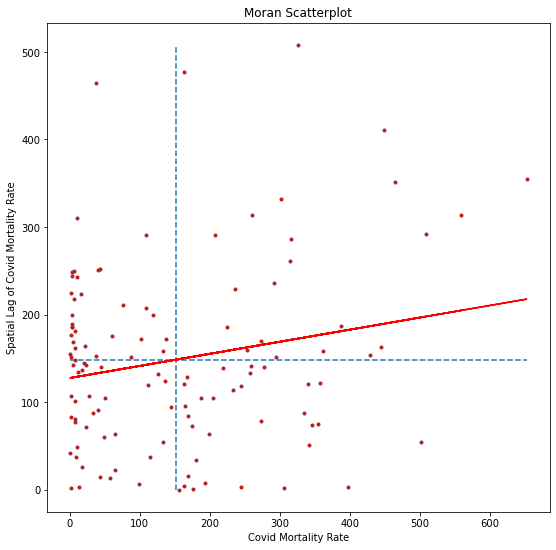

In [70]:
coviddeathrate = df['coviddeathrate'].values.reshape(-1)
lag_coviddeathrate = df['lag_coviddeathrate'].values.reshape(-1)
b, a = np.polyfit(coviddeathrate, lag_coviddeathrate, 1)
f, ax = plt.subplots(1, figsize=(9, 9))

plt.plot(coviddeathrate, lag_coviddeathrate, '.', color='firebrick')

 # dashed vert at mean of the price
plt.vlines(coviddeathrate.mean(), lag_coviddeathrate.min(), lag_coviddeathrate.max(), linestyle='--')
 # dashed horizontal at mean of lagged price 
plt.hlines(lag_coviddeathrate.mean(), coviddeathrate.min(), coviddeathrate.max(), linestyle='--')

# red line of best fit using global I as slope
plt.plot(coviddeathrate, a + b*coviddeathrate, 'r')
plt.title('Moran Scatterplot')
plt.ylabel('Spatial Lag of Covid Mortality Rate')
plt.xlabel('Covid Mortality Rate')
plt.show()

In [71]:
#instead of a single I statistic, there's an array of local Ii statistics, stored in the .Is attribute, and p-value from the simulation are in p_sim

In [72]:
#there might be spatial autocorrelation according to the graph,
#the positive slope means that neighbors of locations with large values have high values, and neighbors of locations
#with small values have small values

In [73]:
li = esda.moran.Moran_Local(y, wq)

In [74]:
li.q

array([3, 2, 1, 3, 3, 3, 1, 3, 3, 3, 3, 1, 4, 2, 1, 1, 1, 1, 1, 1, 1, 4,
       3, 3, 3, 3, 1, 1, 1, 1, 3, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 4, 3, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 4, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2,
       2, 1, 1, 1, 1, 2, 1, 1, 1, 3, 1, 2, 1, 2, 1, 3, 3, 1, 1, 1, 1, 1,
       3, 3, 3, 3, 3, 3, 1, 1, 1, 1])

In [75]:
#using conditional random permutations (different distributions for each focal location)

In [76]:
(li.p_sim < 0.05).sum()

47

In [77]:
#distinguishing the specific type of local spatial association reflected in the four quadrants of the Moran Scatterplot above:

In [78]:
sig = li.p_sim < 0.05
hotspot = sig * li.q==1
coldspot = sig * li.q==3
doughnut = sig * li.q==2
diamond = sig * li.q==4

In [79]:
spots = ['n.sig.', 'hot spot']
labels = [spots[i] for i in hotspot*1]

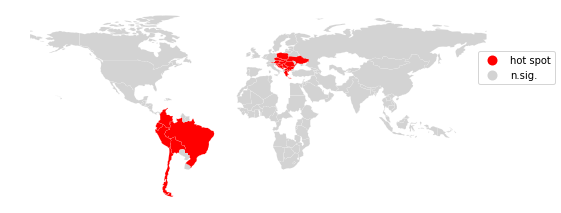

In [80]:
df = df
from matplotlib import colors
hmap = colors.ListedColormap(['red', 'lightgrey'])
f, ax = plt.subplots(1, figsize=(9, 9))
df.assign(cl=labels).plot(column='cl', categorical=True, \
        k=2, cmap=hmap, linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0., 1.1, .8))
plt.show()

In [81]:
spots = ['n.sig.', 'cold spot']
labels = [spots[i] for i in coldspot*1]

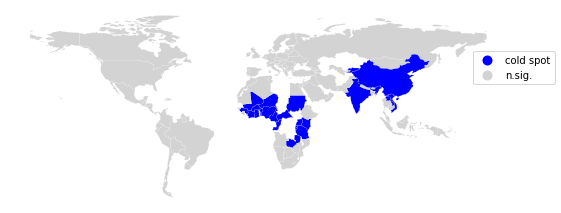

In [82]:
df = df
from matplotlib import colors
hmap = colors.ListedColormap(['blue', 'lightgrey'])
f, ax = plt.subplots(1, figsize=(9, 9))
df.assign(cl=labels).plot(column='cl', categorical=True, \
        k=2, cmap=hmap, linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0., 1.1, .8))
plt.show()

In [83]:
spots = ['n.sig.', 'doughnut']
labels = [spots[i] for i in doughnut*1]

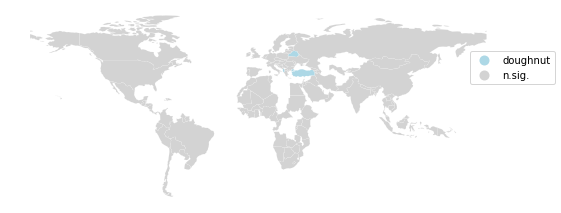

In [84]:
df = df
from matplotlib import colors
hmap = colors.ListedColormap(['lightblue', 'lightgrey'])
f, ax = plt.subplots(1, figsize=(9, 9))
df.assign(cl=labels).plot(column='cl', categorical=True, \
        k=2, cmap=hmap, linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0., 1.1, .8))
plt.show()

In [85]:
spots = ['n.sig.', 'diamond']
labels = [spots[i] for i in diamond*1]

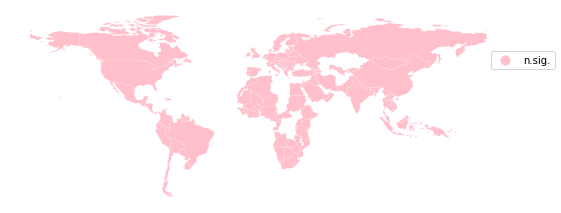

In [86]:
df = df
from matplotlib import colors
hmap = colors.ListedColormap(['pink', 'lightgrey'])
f, ax = plt.subplots(1, figsize=(9, 9))
df.assign(cl=labels).plot(column='cl', categorical=True, \
        k=2, cmap=hmap, linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0., 1.1, .8))
plt.show()

In [87]:
sig = 1 * (li.p_sim < 0.05)
hotspot = 1 * (sig * li.q==1)
coldspot = 3 * (sig * li.q==3)
doughnut = 2 * (sig * li.q==2)
diamond = 4 * (sig * li.q==4)
spots = hotspot + coldspot + doughnut + diamond
spots

array([3, 0, 0, 0, 0, 0, 1, 3, 3, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 0,
       3, 3, 3, 3, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 0, 3,
       0, 0, 0, 0, 3, 0, 0, 0, 2, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 2,
       2, 1, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0,
       0, 0, 0, 0, 3, 3, 1, 1, 1, 1])

In [88]:
spot_labels = [ '0 ns', '1 hot spot', '2 doughnut', '3 cold spot', '4 diamond']
labels = [spot_labels[i] for i in spots]

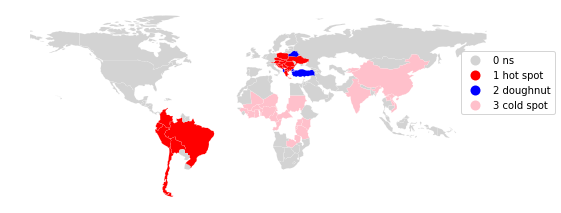

In [89]:
from matplotlib import colors
hmap = colors.ListedColormap([ 'lightgrey', 'red', 'lightblue', 'blue', 'pink'])
f, ax = plt.subplots(1, figsize=(9, 9))
df.assign(cl=labels).plot(column='cl', categorical=True, \
        k=2, cmap=hmap, linewidth=0.1, ax=ax, \
        edgecolor='white', legend=True)
ax.set_axis_off()
leg = ax.get_legend()
leg.set_bbox_to_anchor((0., 0., 1.1, .8))
plt.show()

# 9. Machine Learning

![](https://www.datacatchup.com/wp-content/uploads/2019/05/image.png)
![](https://static.javatpoint.com/tutorial/machine-learning/images/difference-between-supervised-and-unsupervised-learning.jpg)
![](https://miro.medium.com/max/1400/1*6iDmbHflsN6NULBLpVHA6A.png)
![](https://scikit-learn.org/stable/_static/ml_map.png)

In [1]:
import os
import pandas as pd

from sklearn import model_selection
from sklearn.metrics import accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC

import matplotlib.pyplot as plt

from pandas.plotting import scatter_matrix
from sklearn.metrics import confusion_matrix

In [2]:
#the model used below is classification, a subset of supervised learning 

## 9.1 Support Vector Classifier (SVC)

In [3]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [4]:
covidvisual.shape

(149, 43)

In [5]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,...,NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,...,NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,...,NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546


In [6]:
covidvisual.isnull().sum()

Country                                     0
Country Code                                0
Latitude                                    0
Longitude                                   0
HDI rank                                    0
Human Development Index 2021 (HDI)          0
Life expectancy at birth                    0
Expected years of schooling                 0
Mean years of schooling                     0
Gross national income (GNI) per capita      0
GDP 2021 (US$)                              0
GDP per capita 2021 (US$)                   0
GDP growth 2021 (annual %)                  0
Inflation Rate 2021 (%)                     0
Unemployment Rate 2021 (%)                  0
Region                                      0
IncomeGroup                                 0
total_vaccinations                          0
date                                        0
people_vaccinated                           0
people_fully_vaccinated                     0
daily_vaccinations_raw            

In [7]:
covidvisual.columns

Index(['Country', 'Country Code', 'Latitude', 'Longitude', 'HDI rank',
       'Human Development Index 2021 (HDI)', 'Life expectancy at birth',
       'Expected years of schooling', 'Mean years of schooling',
       'Gross national income (GNI) per capita', 'GDP 2021 (US$)',
       'GDP per capita 2021 (US$)', 'GDP growth 2021 (annual %)',
       'Inflation Rate 2021 (%)', 'Unemployment Rate 2021 (%)', 'Region',
       'IncomeGroup', 'total_vaccinations', 'date', 'people_vaccinated',
       'people_fully_vaccinated', 'daily_vaccinations_raw',
       'daily_vaccinations', 'total_vaccinations_per_hundred',
       'people_vaccinated_per_hundred', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'Country,Other', 'TotalCases',
       'NewCases', 'TotalDeaths', 'NewDeaths', 'TotalRecovered',
       'NewRecovered', 'ActiveCases', 'Serious,Critical', 'TotalTests',
       'Population', 'Continent', 'New Cases/1M pop', 'New Deaths/1M pop',
       'Active Cases/1M p

In [8]:
dataset = covidvisual.loc[:, ['total_vaccinations_per_hundred',
                              'daily_vaccinations_per_million','covid_mortality_rate (per 100000)',
                              'Human Development Index 2021 (HDI)','GDP per capita 2021 (US$)',
                              'IncomeGroup']]

In [9]:
dataset.head(3)

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2021 (HDI),GDP per capita 2021 (US$),IncomeGroup
0,108.03,6180,125.663992,0.796,6492.872012,Upper middle income
1,34.00,5722,15.173049,0.745,3690.627878,Lower middle income
2,69.88,5147,5.518546,0.586,1953.533757,Lower middle income


In [10]:
dataset = dataset.dropna()

In [11]:
dataset

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2021 (HDI),GDP per capita 2021 (US$),IncomeGroup
0,108.03,6180,125.663992,0.796,6492.872012,Upper middle income
1,34.00,5722,15.173049,0.745,3690.627878,Lower middle income
2,69.88,5147,5.518546,0.586,1953.533757,Lower middle income
3,77.45,6441,294.047778,0.759,4966.513471,Upper middle income
4,243.27,11302,76.167703,0.951,60443.109165,High income
...,...,...,...,...,...,...
144,218.04,12311,4.761201,0.727,1983.064723,Lower middle income
145,112.21,27064,4.350096,0.607,2996.621062,Lower middle income
146,271.40,17064,43.642703,0.703,3756.489121,Lower middle income
147,63.90,9006,20.842071,0.565,1137.343633,Low income


In [12]:
len(dataset)

149

In [13]:
dataset.shape

(149, 6)

In [14]:
dataset.describe()

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2021 (HDI),GDP per capita 2021 (US$)
count,149.000000,149.000000,149.000000,149.000000,149.000000
mean,147.465973,12556.147651,140.651667,0.737940,17043.642330
std,79.618981,11346.083328,140.407090,0.148244,23472.569989
min,0.280000,32.000000,0.300994,0.400000,221.477676
25%,77.450000,7465.000000,17.799897,0.627000,2535.623432
50%,147.860000,11268.000000,98.920361,0.751000,6104.136709
75%,213.920000,15163.000000,224.750550,0.858000,21391.925334
max,319.780000,117113.000000,652.641143,0.962000,133590.146976


In [15]:
print(dataset.groupby('IncomeGroup').size())

IncomeGroup
High income            49
Low income             16
Lower middle income    44
Upper middle income    40
dtype: int64


In [16]:
dataset.drop(dataset.loc[dataset['IncomeGroup']=='Low income'].index, inplace=True)

In [17]:
print(dataset.groupby('IncomeGroup').size())

IncomeGroup
High income            49
Lower middle income    44
Upper middle income    40
dtype: int64


In [18]:
dataset=dataset.groupby('IncomeGroup', as_index=False, group_keys=False).apply(lambda x: x.sample(n=39))

In [19]:
print(dataset.groupby('IncomeGroup').size())

IncomeGroup
High income            39
Lower middle income    39
Upper middle income    39
dtype: int64


In [20]:
len(dataset)

117

In [21]:
dataset

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2021 (HDI),GDP per capita 2021 (US$),IncomeGroup
59,167.56,12632,508.116635,0.846,18728.121895,High income
49,230.55,13774,204.055391,0.942,51203.554473,High income
69,309.24,13653,58.925903,0.925,39312.660373,High income
85,258.91,15359,187.373461,0.918,33486.671984,High income
142,202.85,10561,345.176169,0.921,70248.629000,High income
...,...,...,...,...,...,...
88,175.02,12927,253.532968,0.758,10045.680500,Upper middle income
116,68.37,10630,220.946125,0.715,9414.226231,Upper middle income
20,67.99,3987,559.112538,0.795,12221.496606,Upper middle income
135,190.06,18958,12.065077,0.745,4426.000637,Upper middle income


In [22]:
#datasetrand = dataset.sample(frac=1)
#The frac keyword argument specifies the fraction of rows to return in the random sample, so frac=1 means return all rows (in random order)
#but in order to work in my case it needs to be in order like it is and not shuffled, otherwise it won't run later

In [23]:
import statsmodels.api as sm
import statsmodels.formula.api as smf

In [24]:
dummie_class = pd.get_dummies(dataset['IncomeGroup'],prefix='IncomeGroup')

In [25]:
dummie_class

,IncomeGroup_High income,IncomeGroup_Lower middle income,IncomeGroup_Upper middle income
59,1,0,0
49,1,0,0
69,1,0,0
85,1,0,0
142,1,0,0
...,...,...,...
88,0,0,1
116,0,0,1
20,0,0,1
135,0,0,1


In [26]:
Y = dummie_class['IncomeGroup_High income']

In [27]:
Y.sample(n=10) # 1 is high income, 0 it's not

61     0
49     1
145    0
78     1
30     0
123    1
88     0
2      0
117    0
56     0
Name: IncomeGroup_High income, dtype: uint8

In [28]:
X = dataset[['total_vaccinations_per_hundred',
            'daily_vaccinations_per_million',
             'covid_mortality_rate (per 100000)',
            'Human Development Index 2021 (HDI)','GDP per capita 2021 (US$)']] 
X = sm.add_constant(X)

In [29]:
X

,const,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2021 (HDI),GDP per capita 2021 (US$)
59,1.0,167.56,12632,508.116635,0.846,18728.121895
49,1.0,230.55,13774,204.055391,0.942,51203.554473
69,1.0,309.24,13653,58.925903,0.925,39312.660373
85,1.0,258.91,15359,187.373461,0.918,33486.671984
142,1.0,202.85,10561,345.176169,0.921,70248.629000
...,...,...,...,...,...,...
88,1.0,175.02,12927,253.532968,0.758,10045.680500
116,1.0,68.37,10630,220.946125,0.715,9414.226231
20,1.0,67.99,3987,559.112538,0.795,12221.496606
135,1.0,190.06,18958,12.065077,0.745,4426.000637


In [30]:
probit_mod = sm.Probit(Y, X)

In [31]:
probit_res = probit_mod.fit()

         Current function value: 0.000000
         Iterations: 35


C:\Users\andre\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [32]:
print(probit_res.summary2())

                                            Results: Probit
Model:                        Probit                            Pseudo R-squared:           inf        
Dependent Variable:           IncomeGroup_High income           AIC:                        12.0000    
Date:                         2023-04-16 20:16                  BIC:                        28.5730    
No. Observations:             117                               Log-Likelihood:             -1.4877e-14
Df Model:                     5                                 LL-Null:                    0.0000     
Df Residuals:                 111                               LLR p-value:                1.0000     
Converged:                    0.0000                            Scale:                      1.0000     
No. Iterations:               35.0000                                                                  
-------------------------------------------------------------------------------------------------------
    

C:\Users\andre\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:3511: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - self.llf/self.llnull


In [33]:
print(probit_res.get_margeff(at='overall', method='dydx').summary())

         Probit Marginal Effects          
Dep. Variable:     IncomeGroup_High income
Method:                               dydx
At:                                overall
                                        dy/dx    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
total_vaccinations_per_hundred       1.58e-10      0.038   4.18e-09      1.000      -0.074       0.074
daily_vaccinations_per_million      2.227e-11      0.007   3.27e-09      1.000      -0.013       0.013
covid_mortality_rate (per 100000)   4.479e-10      0.134   3.35e-09      1.000      -0.262       0.262
Human Development Index 2021 (HDI)  4.908e-08     27.723   1.77e-09      1.000     -54.335      54.335
GDP per capita 2021 (US$)          -1.794e-13   6.76e-05  -2.65e-09      1.000      -0.000       0.000


In [34]:
X.head(3)

,const,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2021 (HDI),GDP per capita 2021 (US$)
59,1.0,167.56,12632,508.116635,0.846,18728.121895
49,1.0,230.55,13774,204.055391,0.942,51203.554473
69,1.0,309.24,13653,58.925903,0.925,39312.660373


In [35]:
predictions = probit_res.predict(X)
print(predictions[15:30])

143    1.0
25     1.0
112    1.0
119    1.0
105    1.0
67     1.0
60     1.0
34     1.0
11     1.0
45     1.0
42     1.0
19     1.0
79     1.0
51     1.0
111    1.0
dtype: float64


In [36]:
Y[15:30]

143    1
25     1
112    1
119    1
105    1
67     1
60     1
34     1
11     1
45     1
42     1
19     1
79     1
51     1
111    1
Name: IncomeGroup_High income, dtype: uint8

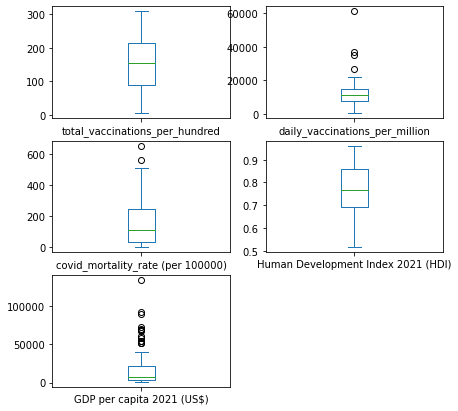

In [37]:
dataset.plot(kind='box', subplots=True, layout=(3,2), sharex=False, sharey=False, figsize=(7, 7))
plt.show()

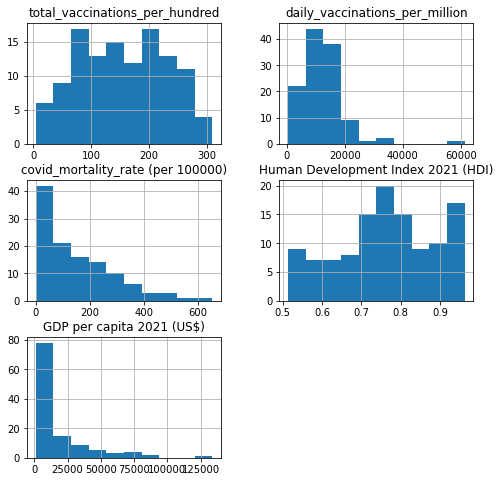

In [38]:
dataset.hist(figsize=(8, 8))
plt.show()

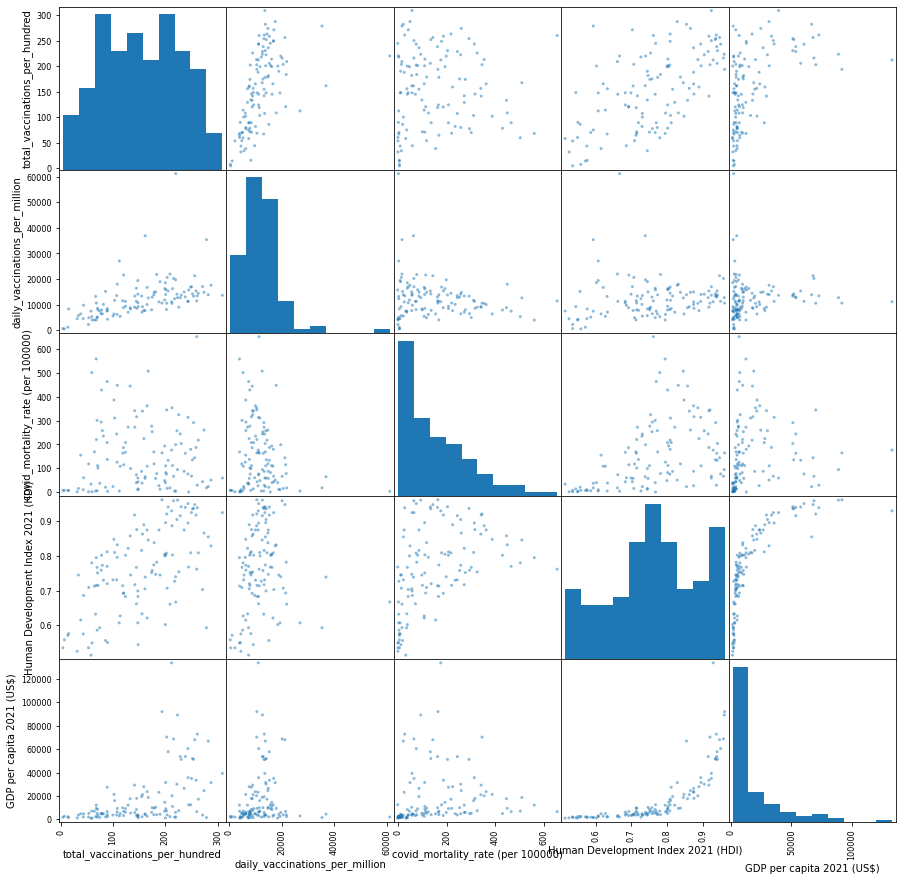

In [39]:
scatter_matrix(dataset, figsize=(15,15))
plt.show()

In [40]:
dataset

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2021 (HDI),GDP per capita 2021 (US$),IncomeGroup
59,167.56,12632,508.116635,0.846,18728.121895,High income
49,230.55,13774,204.055391,0.942,51203.554473,High income
69,309.24,13653,58.925903,0.925,39312.660373,High income
85,258.91,15359,187.373461,0.918,33486.671984,High income
142,202.85,10561,345.176169,0.921,70248.629000,High income
...,...,...,...,...,...,...
88,175.02,12927,253.532968,0.758,10045.680500,Upper middle income
116,68.37,10630,220.946125,0.715,9414.226231,Upper middle income
20,67.99,3987,559.112538,0.795,12221.496606,Upper middle income
135,190.06,18958,12.065077,0.745,4426.000637,Upper middle income


In [41]:
dataset.values

array([[167.56, 12632, 508.1166352062754, 0.846, 18728.12189486889,
        'High income'],
       [230.55, 13774, 204.0553912352542, 0.942, 51203.55447310433,
        'High income'],
       [309.24, 13653, 58.92590314126932, 0.925, 39312.66037306932,
        'High income'],
       [258.91, 15359, 187.3734609815036, 0.918, 33486.67198385498,
        'High income'],
       [202.85, 10561, 345.1761686582059, 0.921, 70248.62900022416,
        'High income'],
       [154.84, 13367, 86.9272367563218, 0.816, 19509.46646338666,
        'High income'],
       [165.28, 10041, 362.2486012740691, 0.875, 23723.34025103447,
        'High income'],
       [101.96, 6362, 386.7079423749307, 0.848, 21391.92533360423,
        'High income'],
       [228.73, 12715, 244.3775084898491, 0.916, 53637.70571098969,
        'High income'],
       [200.74, 13965, 110.2676422097014, 0.896, 31551.81640625,
        'High income'],
       [145.42, 8564, 316.3531535751992, 0.876, 17999.90994954462,
        'High inco

In [42]:
array = dataset.values

In [43]:
array

array([[167.56, 12632, 508.1166352062754, 0.846, 18728.12189486889,
        'High income'],
       [230.55, 13774, 204.0553912352542, 0.942, 51203.55447310433,
        'High income'],
       [309.24, 13653, 58.92590314126932, 0.925, 39312.66037306932,
        'High income'],
       [258.91, 15359, 187.3734609815036, 0.918, 33486.67198385498,
        'High income'],
       [202.85, 10561, 345.1761686582059, 0.921, 70248.62900022416,
        'High income'],
       [154.84, 13367, 86.9272367563218, 0.816, 19509.46646338666,
        'High income'],
       [165.28, 10041, 362.2486012740691, 0.875, 23723.34025103447,
        'High income'],
       [101.96, 6362, 386.7079423749307, 0.848, 21391.92533360423,
        'High income'],
       [228.73, 12715, 244.3775084898491, 0.916, 53637.70571098969,
        'High income'],
       [200.74, 13965, 110.2676422097014, 0.896, 31551.81640625,
        'High income'],
       [145.42, 8564, 316.3531535751992, 0.876, 17999.90994954462,
        'High inco

In [44]:
X = array[:,0:5]

In [45]:
X

array([[167.56, 12632, 508.1166352062754, 0.846, 18728.12189486889],
       [230.55, 13774, 204.0553912352542, 0.942, 51203.55447310433],
       [309.24, 13653, 58.92590314126932, 0.925, 39312.66037306932],
       [258.91, 15359, 187.3734609815036, 0.918, 33486.67198385498],
       [202.85, 10561, 345.1761686582059, 0.921, 70248.62900022416],
       [154.84, 13367, 86.9272367563218, 0.816, 19509.46646338666],
       [165.28, 10041, 362.2486012740691, 0.875, 23723.34025103447],
       [101.96, 6362, 386.7079423749307, 0.848, 21391.92533360423],
       [228.73, 12715, 244.3775084898491, 0.916, 53637.70571098969],
       [200.74, 13965, 110.2676422097014, 0.896, 31551.81640625],
       [145.42, 8564, 316.3531535751992, 0.876, 17999.90994954462],
       [223.5, 12724, 94.58628253955006, 0.961, 89154.2760934922],
       [193.77, 10594, 164.7207423785598, 0.962, 91991.60045835626],
       [256.36, 21284, 144.0800692379541, 0.948, 68007.75667329543],
       [205.56, 15350, 133.5855143382192, 

In [46]:
Y = array[:,5]

In [47]:
Y

array(['High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'High income',
       'High income', 'High income', 'High income', 'Lower middle income',
       'Lower middle income', 'Lower middle income',
       'Lower middle income', 'Lower middle income',
       'Lower middle income', 'Lower middle income',
       'Lower middle income', 'Lower middle income',
       'Lower middle income', 'Lower middle income',
       'Lower middle income', 'Lower middle income',
    

In [48]:
validation_size = 0.2 #it sets 80% to train 20% to test, the default is 75% train 25% test
seed = 8
X_train, X_validation, Y_train, Y_validation = model_selection.train_test_split(X, Y, test_size=validation_size, random_state=seed)

In [49]:
X_train[0:5]

array([[159.21, 7663, 224.7505503400383, 0.89, 27943.70121988203],
       [223.5, 12724, 94.58628253955006, 0.961, 89154.2760934922],
       [258.91, 15359, 187.3734609815036, 0.918, 33486.67198385498],
       [248.7, 16861, 179.6287941734586, 0.809, 12472.44372949542],
       [120.18, 8817, 186.5725157129497, 0.692, 3345.196588738308]],
      dtype=object)

In [50]:
Y_train[0:5]

array(['High income', 'High income', 'High income', 'Upper middle income',
       'Lower middle income'], dtype=object)

In [51]:
len(X_train)

93

In [52]:
len(X_validation)

24

In [53]:
len(Y_train)

93

In [54]:
len(Y_validation)

24

In [55]:
X[0:5]

array([[167.56, 12632, 508.1166352062754, 0.846, 18728.12189486889],
       [230.55, 13774, 204.0553912352542, 0.942, 51203.55447310433],
       [309.24, 13653, 58.92590314126932, 0.925, 39312.66037306932],
       [258.91, 15359, 187.3734609815036, 0.918, 33486.67198385498],
       [202.85, 10561, 345.1761686582059, 0.921, 70248.62900022416]],
      dtype=object)

In [56]:
Y[0:5]

array(['High income', 'High income', 'High income', 'High income',
       'High income'], dtype=object)

In [57]:
print('Training')
print('    X_training size:', len(X_train))
print('    Y_training size:', len(Y_train))
print('Validation')
print('    X_validation size:', len(X_validation))
print('    Y_validation size:', len(Y_validation))

Training
    X_training size: 93
    Y_training size: 93
Validation
    X_validation size: 24
    Y_validation size: 24


In [58]:
svm = SVC(probability=True) #training the model
#svm = SVC()
svm.fit(X_train, Y_train)

SVC(probability=True)

In [59]:
svm

SVC(probability=True)

In [60]:
predictions = svm.predict(X_validation) #making the predictions
print(predictions)

['Lower middle income' 'High income' 'High income' 'Lower middle income'
 'Upper middle income' 'Upper middle income' 'Lower middle income'
 'Upper middle income' 'High income' 'High income' 'Lower middle income'
 'Lower middle income' 'High income' 'Upper middle income' 'High income'
 'Lower middle income' 'High income' 'Upper middle income'
 'Lower middle income' 'Upper middle income' 'Upper middle income'
 'High income' 'Upper middle income' 'Lower middle income']


In [61]:
print(Y_validation) #what the true outcome is

['Upper middle income' 'High income' 'High income' 'Lower middle income'
 'Upper middle income' 'Upper middle income' 'Lower middle income'
 'Upper middle income' 'High income' 'High income' 'Lower middle income'
 'Lower middle income' 'High income' 'Upper middle income' 'High income'
 'Lower middle income' 'High income' 'Upper middle income'
 'Lower middle income' 'Upper middle income' 'Upper middle income'
 'High income' 'Upper middle income' 'Upper middle income']


In [62]:
#comparing the true outcome (validation) with the predictions
print(accuracy_score(Y_validation, predictions)) 

0.9166666666666666


In [63]:
dataset.head(3)

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2021 (HDI),GDP per capita 2021 (US$),IncomeGroup
59,167.56,12632,508.116635,0.846,18728.121895,High income
49,230.55,13774,204.055391,0.942,51203.554473,High income
69,309.24,13653,58.925903,0.925,39312.660373,High income


In [64]:
dataset.max()

total_vaccinations_per_hundred                     309.24
daily_vaccinations_per_million                      61197
covid_mortality_rate (per 100000)              652.641143
Human Development Index 2021 (HDI)                  0.962
GDP per capita 2021 (US$)                   133590.146976
IncomeGroup                           Upper middle income
dtype: object

In [65]:
dataset.min()

total_vaccinations_per_hundred               4.45
daily_vaccinations_per_million                512
covid_mortality_rate (per 100000)         0.36397
Human Development Index 2021 (HDI)          0.514
GDP per capita 2021 (US$)             1094.098185
IncomeGroup                           High income
dtype: object

In [66]:
dataset.describe() 

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2021 (HDI),GDP per capita 2021 (US$)
count,117.000000,117.000000,117.000000,117.000000,117.000000
mean,154.217265,12214.777778,153.945255,0.762513,17499.696475
std,74.862689,7535.319356,142.430879,0.120768,23173.542050
min,4.450000,512.000000,0.363970,0.514000,1094.098185
25%,88.970000,7773.000000,37.743780,0.692000,3698.834981
50%,155.700000,11297.000000,111.455109,0.767000,7055.044776
75%,213.920000,14945.000000,243.743990,0.858000,21391.925334
max,309.240000,61197.000000,652.641143,0.962000,133590.146976


In [67]:
svm.predict([[6.0, 600 , 60, 0.6, 6000]])

array(['Lower middle income'], dtype=object)

In [68]:
svm.predict_proba([[6.0, 600 , 60, 0.6, 6000]])

array([[0.05209198, 0.40758963, 0.54031839]])

In [69]:
dataset.IncomeGroup

59             High income
49             High income
69             High income
85             High income
142            High income
              ...         
88     Upper middle income
116    Upper middle income
20     Upper middle income
135    Upper middle income
55     Upper middle income
Name: IncomeGroup, Length: 117, dtype: object

In [70]:
labels = ['High income','Lower Middle income','Upper middle income']
cm = confusion_matrix(Y_validation, predictions)
print(cm)

[[8 0 0]
 [0 6 0]
 [0 2 8]]


<ipython-input-71-4eb4716b0a1e>:6: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] +labels)
<ipython-input-71-4eb4716b0a1e>:7: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + labels)


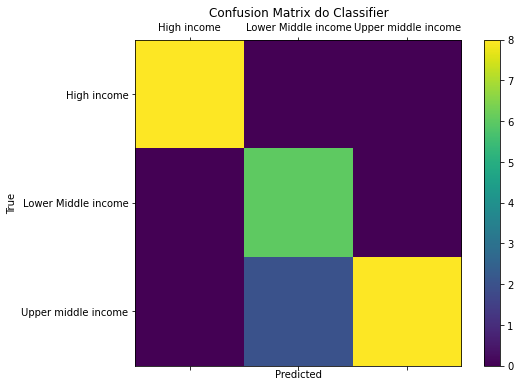

In [71]:
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111)
cax = ax.matshow(cm)
plt.title('Confusion Matrix do Classifier')
fig.colorbar(cax)
ax.set_xticklabels([''] +labels)
ax.set_yticklabels([''] + labels)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

In [72]:
probs = svm.predict_proba(X_validation)
print(probs)
#probability associated to each observation

[[0.02538851 0.51043988 0.46417161]
 [0.98668233 0.00243655 0.01088112]
 [0.96809934 0.02394082 0.00795985]
 [0.01165998 0.95789536 0.03044466]
 [0.0244778  0.16276879 0.81275341]
 [0.21772722 0.03474832 0.74752446]
 [0.0186639  0.95867404 0.02266207]
 [0.05220473 0.0164749  0.93132037]
 [0.99315657 0.00156341 0.00528003]
 [0.99366975 0.0041341  0.00219615]
 [0.0134359  0.9644229  0.0221412 ]
 [0.01661269 0.97040099 0.01298632]
 [0.87455414 0.01297444 0.11247142]
 [0.2834738  0.05118213 0.66534407]
 [0.962913   0.02898923 0.00809778]
 [0.02269131 0.83874111 0.13856758]
 [0.96119164 0.0066433  0.03216507]
 [0.05374301 0.01909737 0.92715962]
 [0.01365898 0.95008367 0.03625735]
 [0.04620222 0.09926521 0.85453257]
 [0.08425281 0.02018753 0.89555966]
 [0.99601426 0.00133787 0.00264787]
 [0.03227891 0.04600624 0.92171485]
 [0.02207919 0.69314615 0.28477466]]


In [73]:
#it's possible to make one prediction 

In [74]:
Data = [[7.0, 578 , 55, 0.6, 5000]]
pred_data = svm.predict(Data)
print(pred_data)

['Lower middle income']


In [75]:
#or many at once

In [76]:
Data = [[5.5, 550, 80, 0.59, 15000], [6.4, 400, 60, 0.57, 9500]]
pred_data = svm.predict(Data)
print(pred_data)

['High income' 'Upper middle income']


In [77]:
dataset.describe() 

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2021 (HDI),GDP per capita 2021 (US$)
count,117.000000,117.000000,117.000000,117.000000,117.000000
mean,154.217265,12214.777778,153.945255,0.762513,17499.696475
std,74.862689,7535.319356,142.430879,0.120768,23173.542050
min,4.450000,512.000000,0.363970,0.514000,1094.098185
25%,88.970000,7773.000000,37.743780,0.692000,3698.834981
50%,155.700000,11297.000000,111.455109,0.767000,7055.044776
75%,213.920000,14945.000000,243.743990,0.858000,21391.925334
max,309.240000,61197.000000,652.641143,0.962000,133590.146976


## 9.2 Logistic Regression, Decision Tree and Random Forest

In [78]:
#making predictions in a different ways, this will also be classification, but not SVC

In [79]:
covidvisual = pd.read_excel('covidvisualApril5th2023.xlsx')

In [80]:
covidvisual

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,...,NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,...,NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,...,NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546
3,Armenia,ARM,40.0,45.0,85,0.759,72.0431,13.116760,11.330300,13157.993900,...,NaN,"4,250",NaN,"3,242,901",2971966,Asia,NaN,NaN,"1,430",294.047778
4,Australia,AUS,-27.0,133.0,5,0.951,84.5265,21.054590,12.726820,49238.433350,...,NaN,"43,652",33,"78,835,048",26068792,Australia/Oceania,NaN,NaN,"1,674",76.167703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144,Uzbekistan,UZB,41.0,64.0,101,0.727,70.8616,12.477140,11.895590,7916.785725,...,NaN,"8,716",23,"1,377,915",34382084,Asia,NaN,NaN,254,4.761201
145,Vanuatu,VUT,-16.0,167.0,140,0.607,70.4490,11.535315,7.064846,3085.411633,...,NaN,24,NaN,"24,976",321832,Australia/Oceania,NaN,NaN,75,4.350096
146,Viet Nam,VNM,16.0,106.0,115,0.703,73.6181,12.951932,8.370280,7867.371345,...,+23,"869,254",7,"85,826,548",98953541,Asia,0.5,NaN,"8,784",43.642703
147,Zambia,ZMB,-15.0,30.0,154,0.565,61.2234,10.928760,7.187091,3217.767739,...,NaN,122,NaN,"3,994,061",19470234,Africa,NaN,NaN,6,20.842071


In [81]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,...,NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,...,NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,...,NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546


In [82]:
covidvisual.shape

(149, 43)

In [83]:
covidvisual.isna().sum()

Country                                     0
Country Code                                0
Latitude                                    0
Longitude                                   0
HDI rank                                    0
Human Development Index 2021 (HDI)          0
Life expectancy at birth                    0
Expected years of schooling                 0
Mean years of schooling                     0
Gross national income (GNI) per capita      0
GDP 2021 (US$)                              0
GDP per capita 2021 (US$)                   0
GDP growth 2021 (annual %)                  0
Inflation Rate 2021 (%)                     0
Unemployment Rate 2021 (%)                  0
Region                                      0
IncomeGroup                                 0
total_vaccinations                          0
date                                        0
people_vaccinated                           0
people_fully_vaccinated                     0
daily_vaccinations_raw            

In [84]:
import missingno as msno

<AxesSubplot:>

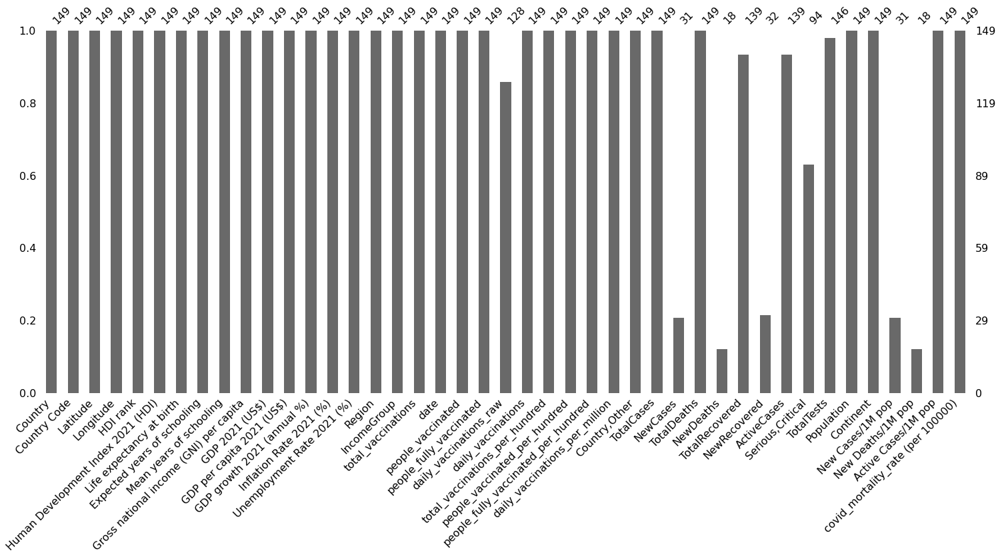

In [85]:
msno.bar(covidvisual)

In [86]:
covidvisual.nunique()

Country                                   149
Country Code                              149
Latitude                                  107
Longitude                                 111
HDI rank                                  128
Human Development Index 2021 (HDI)        128
Life expectancy at birth                  149
Expected years of schooling               149
Mean years of schooling                   149
Gross national income (GNI) per capita    149
GDP 2021 (US$)                            149
GDP per capita 2021 (US$)                 149
GDP growth 2021 (annual %)                149
Inflation Rate 2021 (%)                   149
Unemployment Rate 2021 (%)                145
Region                                      7
IncomeGroup                                 4
total_vaccinations                        149
date                                       75
people_vaccinated                         149
people_fully_vaccinated                   149
daily_vaccinations_raw            

In [87]:
covidvisual.dtypes

Country                                    object
Country Code                               object
Latitude                                  float64
Longitude                                 float64
HDI rank                                    int64
Human Development Index 2021 (HDI)        float64
Life expectancy at birth                  float64
Expected years of schooling               float64
Mean years of schooling                   float64
Gross national income (GNI) per capita    float64
GDP 2021 (US$)                            float64
GDP per capita 2021 (US$)                 float64
GDP growth 2021 (annual %)                float64
Inflation Rate 2021 (%)                   float64
Unemployment Rate 2021 (%)                float64
Region                                     object
IncomeGroup                                object
total_vaccinations                          int64
date                                       object
people_vaccinated                           int64


In [88]:
type(covidvisual)

pandas.core.frame.DataFrame

In [89]:
type(covidvisual['IncomeGroup'])

pandas.core.series.Series

In [90]:
covidvisual['IncomeGroup'].value_counts()

High income            49
Lower middle income    44
Upper middle income    40
Low income             16
Name: IncomeGroup, dtype: int64

In [91]:
covidvisual['IncomeGroup'].value_counts(normalize=True)

High income            0.328859
Lower middle income    0.295302
Upper middle income    0.268456
Low income             0.107383
Name: IncomeGroup, dtype: float64

In [92]:
import seaborn as sns

<AxesSubplot:xlabel='count', ylabel='IncomeGroup'>

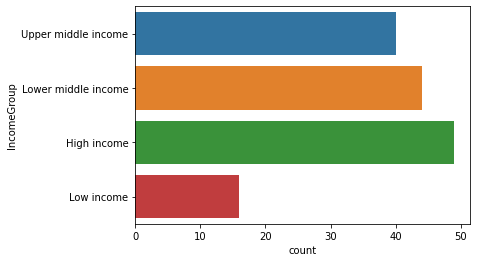

In [93]:
sns.countplot(data=covidvisual, y = 'IncomeGroup')

In [94]:
covidvisual.describe()

,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,GDP 2021 (US$),GDP per capita 2021 (US$),...,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,TotalDeaths,NewDeaths,Population,New Cases/1M pop,New Deaths/1M pop,covid_mortality_rate (per 100000)
count,149.000000,149.000000,149.000000,149.000000,149.000000,149.000000,149.000000,149.000000,1.490000e+02,149.000000,...,149.000000,149.000000,149.000000,149.000000,1.490000e+02,18.000000,1.490000e+02,31.000000,18.000000,149.000000
mean,20.568903,18.110738,89.590604,0.737940,72.099044,13.872340,9.282668,21483.297314,6.267643e+11,17043.642330,...,147.465973,61.090268,56.137584,12556.147651,4.424775e+04,10.222222,4.966243e+07,50.808065,0.331667,140.651667
std,24.937936,65.261616,55.154576,0.148244,7.600011,2.858387,3.145162,20484.572503,2.471488e+12,23472.569989,...,79.618981,23.674900,24.003123,11346.083328,1.286413e+05,14.901858,1.698311e+08,65.684372,0.317143,140.407090
min,-41.000000,-175.000000,1.000000,0.400000,52.676000,6.957112,2.114962,731.786709,4.692313e+08,221.477676,...,0.280000,0.260000,0.260000,32.000000,1.300000e+01,1.000000,1.077490e+05,0.050000,0.010000,0.300994
25%,4.500000,-8.000000,40.000000,0.627000,67.239800,12.087473,7.088480,5472.104781,1.609182e+10,2535.623432,...,77.450000,42.720000,37.800000,7465.000000,1.298000e+03,1.250000,3.249317e+06,3.000000,0.100000,17.799897
50%,20.000000,20.000000,89.000000,0.751000,72.614600,13.951780,9.827750,13157.993900,6.360510e+10,6104.136709,...,147.860000,65.550000,62.310000,11268.000000,7.100000e+03,4.500000,1.021897e+07,22.000000,0.200000,98.920361
75%,41.000000,45.000000,135.000000,0.858000,77.198200,15.928960,11.895590,32803.234230,3.661376e+11,21391.925334,...,213.920000,80.610000,75.190000,15163.000000,2.537500e+04,11.750000,3.502734e+07,78.500000,0.475000,224.750550
max,65.000000,175.000000,189.000000,0.962000,85.473400,21.054590,14.090967,90918.644710,2.331508e+13,133590.146976,...,319.780000,105.820000,105.820000,117113.000000,1.155668e+06,58.000000,1.448471e+09,282.000000,1.000000,652.641143


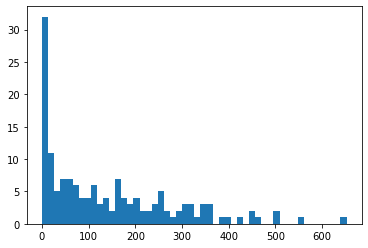

In [95]:
covidvisual['covid_mortality_rate (per 100000)'].hist(grid=False, bins=50);

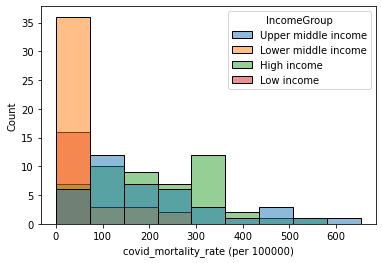

In [96]:
sns.histplot(data=covidvisual, x = 'covid_mortality_rate (per 100000)', hue='IncomeGroup');

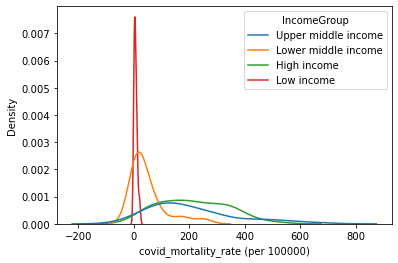

In [97]:
sns.kdeplot(data=covidvisual,x='covid_mortality_rate (per 100000)', hue='IncomeGroup');

In [98]:
pd.crosstab(covidvisual['Continent'], covidvisual['IncomeGroup'], margins=True)

IncomeGroup,High income,Low income,Lower middle income,Upper middle income,All
Continent,,,,,
Africa,0,16,17,4,37
Asia,11,0,17,10,38
Australia/Oceania,2,0,4,2,8
Europe,29,0,1,9,39
North America,5,0,4,8,17
South America,2,0,1,7,10
All,49,16,44,40,149


In [99]:
pd.crosstab(covidvisual['Continent'], covidvisual['IncomeGroup'], normalize='index')

IncomeGroup,High income,Low income,Lower middle income,Upper middle income
Continent,,,,
Africa,0.000000,0.432432,0.459459,0.108108
Asia,0.289474,0.000000,0.447368,0.263158
Australia/Oceania,0.250000,0.000000,0.500000,0.250000
Europe,0.743590,0.000000,0.025641,0.230769
North America,0.294118,0.000000,0.235294,0.470588
South America,0.200000,0.000000,0.100000,0.700000


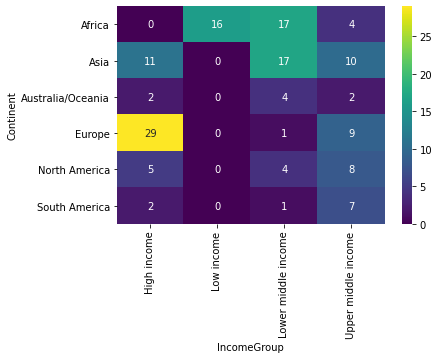

In [100]:
sns.heatmap(pd.crosstab(covidvisual['Continent'], covidvisual['IncomeGroup']), annot=True, fmt='.5g', cmap='viridis');

In [101]:
covidvisual = covidvisual.dropna(subset=['daily_vaccinations_per_million','covid_mortality_rate (per 100000)'])

In [102]:
incomegroupdummies = pd.get_dummies(covidvisual['IncomeGroup'], prefix='IncomeGroup')

In [103]:
incomegroupdummies 

,IncomeGroup_High income,IncomeGroup_Low income,IncomeGroup_Lower middle income,IncomeGroup_Upper middle income
0,0,0,0,1
1,0,0,1,0
2,0,0,1,0
3,0,0,0,1
4,1,0,0,0
...,...,...,...,...
144,0,0,1,0
145,0,0,1,0
146,0,0,1,0
147,0,1,0,0


In [104]:
covidvisual.shape

(149, 43)

In [105]:
covidvisual.isna().sum()

Country                                     0
Country Code                                0
Latitude                                    0
Longitude                                   0
HDI rank                                    0
Human Development Index 2021 (HDI)          0
Life expectancy at birth                    0
Expected years of schooling                 0
Mean years of schooling                     0
Gross national income (GNI) per capita      0
GDP 2021 (US$)                              0
GDP per capita 2021 (US$)                   0
GDP growth 2021 (annual %)                  0
Inflation Rate 2021 (%)                     0
Unemployment Rate 2021 (%)                  0
Region                                      0
IncomeGroup                                 0
total_vaccinations                          0
date                                        0
people_vaccinated                           0
people_fully_vaccinated                     0
daily_vaccinations_raw            

In [106]:
covidvisual.head(3)

,Country,Country Code,Latitude,Longitude,HDI rank,Human Development Index 2021 (HDI),Life expectancy at birth,Expected years of schooling,Mean years of schooling,Gross national income (GNI) per capita,...,NewRecovered,ActiveCases,"Serious,Critical",TotalTests,Population,Continent,New Cases/1M pop,New Deaths/1M pop,Active Cases/1M pop,covid_mortality_rate (per 100000)
0,Albania,ALB,41.0,20.0,67,0.796,76.4626,14.448000,11.286455,14131.110390,...,NaN,"1,709",NaN,"1,941,032",2866374,Europe,NaN,NaN,596,125.663992
1,Algeria,DZA,28.0,3.0,91,0.745,76.3767,14.626896,8.069284,10800.225460,...,NaN,"81,825",NaN,"230,861",45350148,Africa,0.1,NaN,"1,804",15.173049
2,Angola,AGO,-12.5,18.5,148,0.586,61.6434,12.172100,5.417391,5465.617791,...,NaN,41,NaN,"1,499,795",35027343,Africa,NaN,NaN,1,5.518546


In [107]:
from sklearn.model_selection import train_test_split

In [108]:
x = covidvisual[['total_vaccinations_per_hundred',
            'daily_vaccinations_per_million',
             'covid_mortality_rate (per 100000)',
            'Human Development Index 2021 (HDI)','GDP per capita 2021 (US$)']]
y = incomegroupdummies['IncomeGroup_High income']

In [109]:
x.head(3)

,total_vaccinations_per_hundred,daily_vaccinations_per_million,covid_mortality_rate (per 100000),Human Development Index 2021 (HDI),GDP per capita 2021 (US$)
0,108.03,6180,125.663992,0.796,6492.872012
1,34.00,5722,15.173049,0.745,3690.627878
2,69.88,5147,5.518546,0.586,1953.533757


In [110]:
x.isna().sum()

total_vaccinations_per_hundred        0
daily_vaccinations_per_million        0
covid_mortality_rate (per 100000)     0
Human Development Index 2021 (HDI)    0
GDP per capita 2021 (US$)             0
dtype: int64

In [111]:
y.head(10) #1 it's in the high income group, 0 it's not in the high income group

0    0
1    0
2    0
3    0
4    1
5    1
6    0
7    1
8    1
9    0
Name: IncomeGroup_High income, dtype: uint8

In [112]:
x_train, x_test, y_train, y_test = train_test_split(x, y, random_state=8) #by default from the library train is 75% test is 25%

In [113]:
x_train.shape, x_test.shape

((111, 5), (38, 5))

In [114]:
from sklearn.linear_model import LogisticRegression

In [115]:
lr = LogisticRegression(solver='liblinear')

In [116]:
lr.fit(x_train, y_train)

LogisticRegression(solver='liblinear')

In [117]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

def classification_results(classifier, x_test, y_test, cmap='Blues'):
    print('Model Results:', classifier.__class__.__name__)
    
    y_pred = classifier.predict(x_test)
    
    print(classification_report(y_test, y_pred))
    
    cm = confusion_matrix(y_test, y_pred)
    cmd = ConfusionMatrixDisplay(cm, display_labels=classifier.classes_)
    cmd.plot(cmap=cmap);

Model Results: LogisticRegression
              precision    recall  f1-score   support

           0       1.00      0.89      0.94        27
           1       0.79      1.00      0.88        11

    accuracy                           0.92        38
   macro avg       0.89      0.94      0.91        38
weighted avg       0.94      0.92      0.92        38



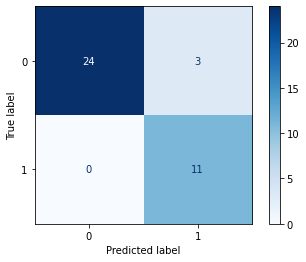

In [118]:
classification_results(lr, x_test, y_test)
plt.grid(False)

In [119]:
from sklearn.tree import DecisionTreeClassifier

In [120]:
dt = DecisionTreeClassifier()

In [121]:
dt.fit(x_train, y_train)

DecisionTreeClassifier()

In [122]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

def classification_results(classifier, x_test, y_test, cmap='Blues'):
    print('Model Results:', classifier.__class__.__name__)
    
    y_pred = classifier.predict(x_test)
    
    print(classification_report(y_test, y_pred))
    
    cm = confusion_matrix(y_test, y_pred)
    cmd = ConfusionMatrixDisplay(cm, display_labels=classifier.classes_)
    cmd.plot(cmap=cmap);

Model Results: DecisionTreeClassifier
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        27
           1       1.00      1.00      1.00        11

    accuracy                           1.00        38
   macro avg       1.00      1.00      1.00        38
weighted avg       1.00      1.00      1.00        38



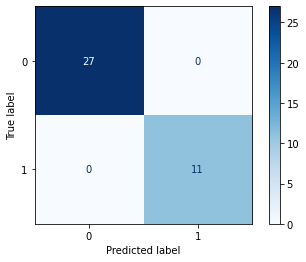

In [123]:
classification_results(dt, x_test, y_test)
plt.grid(False)

In [124]:
from sklearn.ensemble import RandomForestClassifier

Model Results: RandomForestClassifier
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        27
           1       1.00      1.00      1.00        11

    accuracy                           1.00        38
   macro avg       1.00      1.00      1.00        38
weighted avg       1.00      1.00      1.00        38



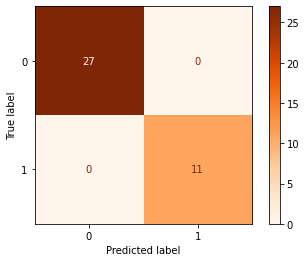

In [125]:
rf = RandomForestClassifier()
rf.fit(x_train, y_train)
classification_results(rf, x_test, y_test, cmap='Oranges')
plt.grid(False)